# Define Input Folder and Files

In [1]:
import os

# Define the folder path
input_folder = "Input_Folder_without_Nan_HourMean"

# Get the list of CSV file names in the folder
input_files = [file for file in os.listdir(input_folder) if file.endswith('.csv')]

# Print the results
print("Input Folder:", input_folder)
print(f"Input Files: {len(input_files)}")
print(input_files)


Input Folder: Input_Folder_without_Nan_HourMean
Input Files: 41
['UP002.csv', 'UP003.csv', 'UP004.csv', 'UP008.csv', 'UP009.csv', 'UP012.csv', 'UP014.csv', 'UP016.csv', 'UP017.csv', 'UP018.csv', 'UP019.csv', 'UP020.csv', 'UP021.csv', 'UP022.csv', 'UP023.csv', 'UP024.csv', 'UP025.csv', 'UP026.csv', 'UP028.csv', 'UP029.csv', 'UP030.csv', 'UP031.csv', 'UP032.csv', 'UP033.csv', 'UP034.csv', 'UP035.csv', 'UP036.csv', 'UP037.csv', 'UP038.csv', 'UP039.csv', 'UP040.csv', 'UP041.csv', 'UP042.csv', 'UP043.csv', 'UP044.csv', 'UP046.csv', 'UP048.csv', 'UP049.csv', 'UP050.csv', 'UP051.csv', 'UP052.csv']


In [2]:
import pandas as pd

dataframes_dictionary = {}  # Dictionary to store DataFrames
print(input_folder)
for file in input_files:
    file_path = os.path.join(input_folder, file)
    if os.path.exists(file_path):
        # Load the CSV file
        df = pd.read_csv(file_path)
        dataframes_dictionary[file] = df


Input_Folder_without_Nan_HourMean


# Add Additional columns to the dataframes

In [3]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn.functional as F
from torch_geometric.nn import GATConv
from torch_geometric.data import Data

from sklearn.preprocessing import LabelEncoder

# Initialize a label encoder
label_encoder = LabelEncoder()

# Load and process the data
dataframes = []
for file_name in input_files:
    df = dataframes_dictionary[file_name]
    
    # Convert 'From Date' to pandas datetime
    df['From Date'] = pd.to_datetime(df['From Date'])
    
    # Split 'From Date' into Year, Month, Day, Hour
    df['Year'] = df['From Date'].dt.year
    df['Month'] = df['From Date'].dt.month
    df['Day'] = df['From Date'].dt.day
    df['Hour'] = df['From Date'].dt.hour
    
    # Drop the original 'From Date' column
    df.drop('From Date', axis=1, inplace=True)
    
    dataframes.append(df)


# Split the data into training and test sets

In [4]:
train_dataframes = []
test_dataframes = []

split_ratio = 0.85  # 85% train, 15% test
train_size = int(len(dataframes[0]) * split_ratio)

for node_idx, df in enumerate(dataframes):
    # Split the dataframe into train and test sets

    train_df = df.iloc[:train_size]
    test_df = df.iloc[train_size:]
    
    # Append the train and test dataframes to the respective lists
    train_dataframes.append(train_df)
    test_dataframes.append(test_df)

print(f"Train dataframes shape: {train_dataframes[0].shape}")
print(f"Test dataframes shape: {test_dataframes[0].shape}")    

Train dataframes shape: (8343, 15)
Test dataframes shape: (1473, 15)


# Scale the Data

In [7]:
from sklearn.preprocessing import StandardScaler

scalers = {}

feature_scalers = {}

print(train_dataframes[0].dtypes)

# Apply StandardScaler to all numeric columns except 'Year', 'Month', 'Day', 'Hour'
for node_idx, df in enumerate(train_dataframes):

    print(f"Training Processing {input_files[node_idx]}, node index: {node_idx}")
    # Encode the 'Year' column
    df['Year'] = label_encoder.fit_transform(df['Year'])

    numeric_columns = df.select_dtypes(include=[np.number]).columns.tolist()
    columns_to_scale = [col for col in numeric_columns if col not in ['Year', 'Month', 'Day', 'Hour', 'AT (degree C)']]
    
    scaler = StandardScaler()
    df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
    feature_scalers[input_files[node_idx]] = scaler

    scaler1 = StandardScaler()
    df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
    
    # Save the scaler for the target column
    scalers[input_files[node_idx]] = scaler1


print(test_dataframes[0].dtypes)    

# Apply the same scaling to the test dataframes
for node_idx, df in enumerate(test_dataframes):

    print(f"Testing Processing {input_files[node_idx]}, node index: {node_idx}, shape: {df.shape}")
    # Encode the 'Year' column
    df['Year'] = label_encoder.fit_transform(df['Year'])

    numeric_columns = df.select_dtypes(include=[np.number]).columns.tolist()
    columns_to_scale = [col for col in numeric_columns if col not in ['Year', 'Month', 'Day', 'Hour', 'AT (degree C)']]
    
    scaler = feature_scalers[input_files[node_idx]]
    df[columns_to_scale] = scaler.transform(df[columns_to_scale])
    
    scaler1 = scalers[input_files[node_idx]]
    df['AT (degree C)'] = scaler1.transform(df[['AT (degree C)']])
 

PM2.5 (ug/m3)    float64
PM10 (ug/m3)     float64
NO (ug/m3)       float64
NO2 (ug/m3)      float64
SO2 (ug/m3)      float64
CO (mg/m3)       float64
Ozone (ug/m3)    float64
RH (%)           float64
WS (m/s)         float64
WD (degree)      float64
AT (degree C)    float64
Year               int32
Month              int32
Day                int32
Hour               int32
dtype: object
Training Processing UP002.csv, node index: 0
Training Processing UP003.csv, node index: 1
Training Processing UP004.csv, node index: 2
Training Processing UP008.csv, node index: 3
Training Processing UP009.csv, node index: 4
Training Processing UP012.csv, node index: 5
Training Processing UP014.csv, node index: 6
Training Processing UP016.csv, node index: 7
Training Processing UP017.csv, node index: 8
Training Processing UP018.csv, node index: 9
Training Processing UP019.csv, node index: 10
Training Processing UP020.csv, node index: 11
Training Processing UP021.csv, node index: 12
Training Processing UP0

C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

Training Processing UP023.csv, node index: 14
Training Processing UP024.csv, node index: 15
Training Processing UP025.csv, node index: 16
Training Processing UP026.csv, node index: 17
Training Processing UP028.csv, node index: 18
Training Processing UP029.csv, node index: 19
Training Processing UP030.csv, node index: 20
Training Processing UP031.csv, node index: 21
Training Processing UP032.csv, node index: 22


C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

Training Processing UP033.csv, node index: 23
Training Processing UP034.csv, node index: 24
Training Processing UP035.csv, node index: 25
Training Processing UP036.csv, node index: 26
Training Processing UP037.csv, node index: 27
Training Processing UP038.csv, node index: 28
Training Processing UP039.csv, node index: 29
Training Processing UP040.csv, node index: 30
Training Processing UP041.csv, node index: 31
Training Processing UP042.csv, node index: 32
Training Processing UP043.csv, node index: 33
Training Processing UP044.csv, node index: 34
Training Processing UP046.csv, node index: 35
Training Processing UP048.csv, node index: 36
Training Processing UP049.csv, node index: 37
Training Processing UP050.csv, node index: 38


C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

Training Processing UP051.csv, node index: 39
Training Processing UP052.csv, node index: 40
PM2.5 (ug/m3)    float64
PM10 (ug/m3)     float64
NO (ug/m3)       float64
NO2 (ug/m3)      float64
SO2 (ug/m3)      float64
CO (mg/m3)       float64
Ozone (ug/m3)    float64
RH (%)           float64
WS (m/s)         float64
WD (degree)      float64
AT (degree C)    float64
Year               int32
Month              int32
Day                int32
Hour               int32
dtype: object
Testing Processing UP002.csv, node index: 0, shape: (1473, 15)
Testing Processing UP003.csv, node index: 1, shape: (1473, 15)
Testing Processing UP004.csv, node index: 2, shape: (1473, 15)
Testing Processing UP008.csv, node index: 3, shape: (1473, 15)
Testing Processing UP009.csv, node index: 4, shape: (1473, 15)
Testing Processing UP012.csv, node index: 5, shape: (1473, 15)
Testing Processing UP014.csv, node index: 6, shape: (1473, 15)
Testing Processing UP016.csv, node index: 7, shape: (1473, 15)
Testing Process

C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .

Testing Processing UP028.csv, node index: 18, shape: (1473, 15)
Testing Processing UP029.csv, node index: 19, shape: (1473, 15)
Testing Processing UP030.csv, node index: 20, shape: (1473, 15)
Testing Processing UP031.csv, node index: 21, shape: (1473, 15)
Testing Processing UP032.csv, node index: 22, shape: (1473, 15)
Testing Processing UP033.csv, node index: 23, shape: (1473, 15)
Testing Processing UP034.csv, node index: 24, shape: (1473, 15)
Testing Processing UP035.csv, node index: 25, shape: (1473, 15)
Testing Processing UP036.csv, node index: 26, shape: (1473, 15)
Testing Processing UP037.csv, node index: 27, shape: (1473, 15)
Testing Processing UP038.csv, node index: 28, shape: (1473, 15)
Testing Processing UP039.csv, node index: 29, shape: (1473, 15)
Testing Processing UP040.csv, node index: 30, shape: (1473, 15)
Testing Processing UP041.csv, node index: 31, shape: (1473, 15)
Testing Processing UP042.csv, node index: 32, shape: (1473, 15)
Testing Processing UP043.csv, node index

C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\2524091884.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

# Modifying the csv to add latitude and longitude

In [8]:
import pandas as pd

# Load the CSV file
file_path = 'final.csv'  # Replace with your file path
df = pd.read_csv(file_path, header=None)

# Define the new column names
new_columns = ['file_name', 'state', 'city', 'agency', 'station_location', 
               'start_month', 'start_month_num', 'start_year', 'latitude', 'longitude']

# Assign the new column names to the dataframe
df.columns = new_columns

# Save the modified dataframe back to CSV
modified_file_path = 'final_modified.csv'  # Specify the output file path
df.to_csv(modified_file_path, index=False)

print(f"Modified file saved as {modified_file_path}")

Modified file saved as final_modified.csv


# Checking if all files have latitudes and longitudes

In [9]:
import pandas as pd

# Load the CSV file
df = pd.read_csv('final_modified.csv')

# Remove ".csv" extension from the files_with_at_column
files_without_extension = [file.replace('.csv', '') for file in input_files]

# Filter rows from the dataframe where the file_name is in the files_without_extension array
filtered_df = df[df['file_name'].isin(files_without_extension)]

# Extract latitude and longitude of the filtered rows
filtered_lat_long_positions = filtered_df[['latitude', 'longitude']].values.tolist()

# Find file names that do not have latitude and longitude information
missing_files = [file for file in files_without_extension if file not in filtered_df['file_name'].values]

# Print the results
print("Filtered latitude and longitude positions:", filtered_lat_long_positions)
print("Files without latitude and longitude information:", missing_files)


Filtered latitude and longitude positions: [[26.828687, 80.968257], [25.347671, 82.98085], [27.198724, 78.006069], [28.543866, 77.331016], [28.662102, 77.373283], [28.478246, 77.481831], [29.467858, 77.711593], [28.722131, 77.753682], [28.694105, 77.4549], [28.645805, 77.369211], [28.73341, 77.298604], [28.553622, 77.47128], [28.58997, 77.311681], [28.569039, 77.397499], [28.957922, 77.759078], [26.849806, 81.007399], [29.002044, 77.760152], [29.06265, 77.71476], [27.204282, 77.925518], [25.301191, 82.996499], [27.194169, 77.965192], [25.262166, 82.995247], [26.731409, 83.433118], [25.493404, 81.862706], [27.233706, 78.026988], [26.763279, 80.927821], [25.428788, 81.91389], [27.166823, 78.376626], [25.449042, 81.827394], [26.90648, 80.983889], [26.506816, 80.251968], [25.325445, 82.995173], [27.104555, 78.003352], [27.57421, 77.654082], [26.426674, 80.325968], [28.885193, 78.738921], [28.854246, 78.772174], [28.841239, 78.696695], [28.964466, 77.27869], [27.16446, 78.391286], [25.45357

# Calculating distances between the points

In [10]:
import math

# Function to calculate the Haversine distance between two points on the Earth
def haversine(lat1, lon1, lat2, lon2):
    # Radius of the Earth in kilometers
    R = 6371.0
    
    # Convert latitude and longitude from degrees to radians
    lat1_rad = math.radians(lat1)
    lon1_rad = math.radians(lon1)
    lat2_rad = math.radians(lat2)
    lon2_rad = math.radians(lon2)
    
    # Differences in coordinates
    dlat = lat2_rad - lat1_rad
    dlon = lon2_rad - lon1_rad
    
    # Haversine formula
    a = math.sin(dlat / 2)**2 + math.cos(lat1_rad) * math.cos(lat2_rad) * math.sin(dlon / 2)**2
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    
    # Distance in kilometers
    distance = R * c
    return distance

# Initialize a 2D array to store the distances
num_stations = len(filtered_lat_long_positions)
distance_matrix = [[0] * num_stations for _ in range(num_stations)]

# Iterate over the array to calculate distances between each pair of stations
for i in range(num_stations):
    for j in range(num_stations):
        lat1, lon1 = filtered_lat_long_positions[i]
        lat2, lon2 = filtered_lat_long_positions[j]
        
        # Check if any latitude or longitude is None
        if None in (lat1, lon1, lat2, lon2):
            distance_matrix[i][j] = -1
        else:
            # Calculate the distance using the Haversine formula
            distance_matrix[i][j] = haversine(lat1, lon1, lat2, lon2)

# Output the 2D distance array
for row in distance_matrix:
    print(row)

# Get the number of rows (length of the outer list)
rows = len(distance_matrix)

# Get the number of columns (length of the first inner list, assuming all rows have the same number of columns)
columns = len(distance_matrix[0]) if rows > 0 else 0

# Print the shape
print(f"Shape: ({rows}, {columns})")


[0.0, 259.831294268261, 296.3073062470489, 405.71967084165664, 408.2831201387903, 389.2780421976758, 433.6248093898384, 379.9022461663081, 403.1202784144766, 407.75269006951396, 418.5168023768209, 394.0985785077845, 409.75765217382735, 401.26086412872326, 394.3312597566813, 4.538336824596205, 397.16042095417515, 404.7358890189317, 304.28787362360157, 264.3631791522258, 300.25474049648807, 267.10222540161783, 244.91806957183363, 173.24469530741052, 294.77943248602156, 8.30691912317224, 182.0490886691721, 259.5051000084394, 175.75234561274783, 8.788059469298602, 79.66689357184394, 262.5205143903347, 295.4259311719268, 338.07059597527996, 77.93792481191839, 316.7232944225239, 311.9990131479505, 316.1633594061282, 433.3949665835895, 258.0326294852914, 281.95404023105255]
[259.831294268261, 0.0, 536.971001381933, 663.1333206367073, 666.5260268959933, 646.748508222628, 692.9632693541472, 639.2595346251944, 661.7347052324445, 665.8970511529196, 676.9228193417765, 652.0154437921375, 667.406227

# Plotting the points on the map

In [11]:
import folium

avg_lat = sum([pos[0] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
avg_long = sum([pos[1] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
my_map = folium.Map(location=[avg_lat, avg_long], zoom_start=5)
    
# Add markers for each position
for lat, long in filtered_lat_long_positions:
    folium.Marker(location=[lat, long]).add_to(my_map)
    
# Save the map to an HTML file
my_map.save("map.html")

# Display the map in the notebook
my_map


# Plotting the points in a plot

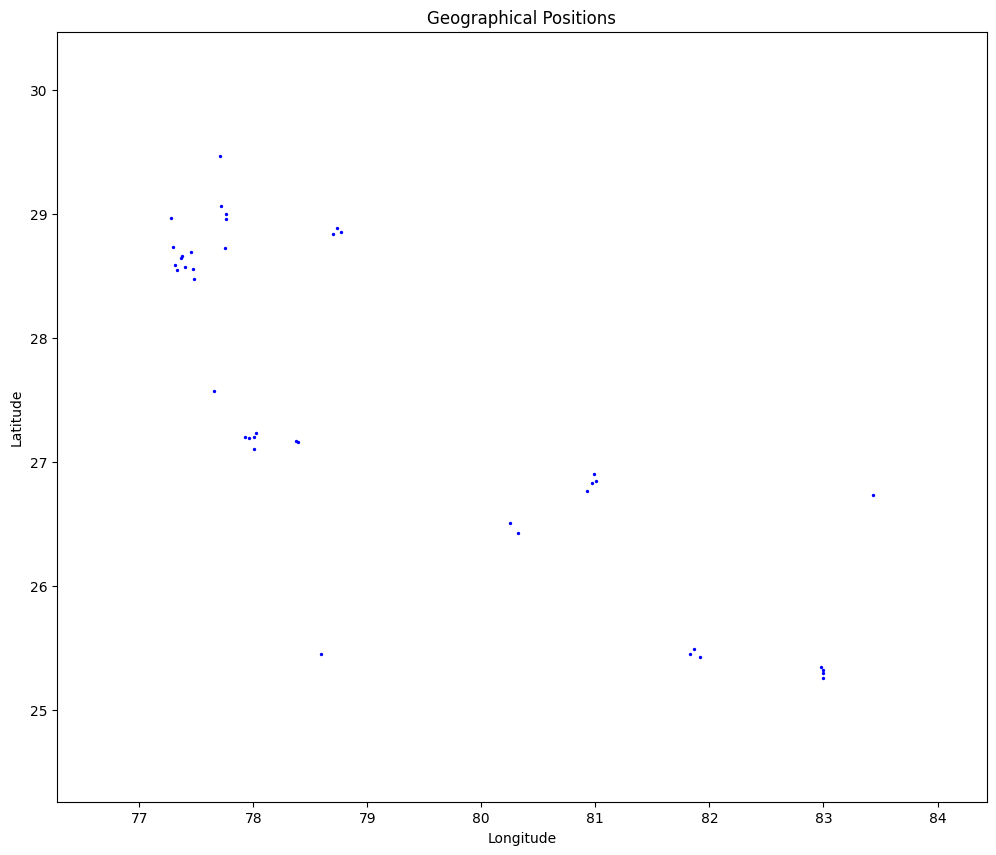

In [12]:
import matplotlib.pyplot as plt

# Split the latitude and longitude into separate lists
latitudes = [pos[0] for pos in filtered_lat_long_positions]
longitudes = [pos[1] for pos in filtered_lat_long_positions]

# Create a scatter plot with a larger figure size
plt.figure(figsize=(12, 10))  # Increase the figure size

# Plot the points with a larger marker size
plt.scatter(longitudes, latitudes, color='blue', marker='o', s=2)

# Label the axes
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Title of the plot
plt.title('Geographical Positions')

# Set the axis limits to zoom in and create more space between points
plt.xlim(min(longitudes) - 1, max(longitudes) + 1)
plt.ylim(min(latitudes) - 1, max(latitudes) + 1)

# Save the plot as an image file
output_image = 'positions_plot_large.png'
plt.savefig(output_image, dpi=300)  # Increase dpi for better resolution

# Show the plot
plt.show()


# Determine the k nearest neighbours

In [13]:
import numpy as np

k = 8  # Number of nearest neighbors

# Initialize adjacency matrix (with all zeros)
adjacency_matrix = np.zeros((len(input_files), len(input_files)), dtype=int)

# Loop through each entry to find k nearest neighbors
for i in range(len(input_files)):
    # Get distances for the i-th entry
    distances = distance_matrix[i]
    
    # Find the indices of the k smallest distances, excluding the distance to itself (i.e., index i)
    nearest_neighbors = np.argsort(distances)[1:k+1]  # 1:k+1 because argsort includes self-distance at position 0
    
    # Print the k nearest neighbors for the current file
    print(f"\nFile: {input_files[i]}")
    print(f"K-nearest neighbors: {[input_files[j] for j in nearest_neighbors]}")
    
    # Update the adjacency matrix to represent edges
    for neighbor in nearest_neighbors:
        adjacency_matrix[i][neighbor] = 1
        adjacency_matrix[neighbor][i] = 1  # Ensure undirected edge

# Print the adjacency matrix
print("\nAdjacency Matrix:")
print(adjacency_matrix)

# Print neighbors for each file based on the adjacency matrix
for i in range(len(input_files)):
    neighbors = [input_files[j] for j in range(len(input_files)) if adjacency_matrix[i][j] == 1]
    print(f"\nNeighbors of {input_files[i]} based on adjacency matrix: {neighbors}")


File: UP002.csv
K-nearest neighbors: ['UP024.csv', 'UP035.csv', 'UP039.csv', 'UP044.csv', 'UP040.csv', 'UP033.csv', 'UP038.csv', 'UP036.csv']

File: UP003.csv
K-nearest neighbors: ['UP041.csv', 'UP029.csv', 'UP031.csv', 'UP036.csv', 'UP033.csv', 'UP038.csv', 'UP032.csv', 'UP024.csv']

File: UP004.csv
K-nearest neighbors: ['UP030.csv', 'UP034.csv', 'UP028.csv', 'UP042.csv', 'UP037.csv', 'UP051.csv', 'UP043.csv', 'UP012.csv']

File: UP008.csv
K-nearest neighbors: ['UP021.csv', 'UP022.csv', 'UP018.csv', 'UP020.csv', 'UP009.csv', 'UP012.csv', 'UP017.csv', 'UP019.csv']

File: UP009.csv
K-nearest neighbors: ['UP018.csv', 'UP017.csv', 'UP021.csv', 'UP022.csv', 'UP019.csv', 'UP008.csv', 'UP020.csv', 'UP012.csv']

File: UP012.csv
K-nearest neighbors: ['UP020.csv', 'UP022.csv', 'UP008.csv', 'UP021.csv', 'UP018.csv', 'UP009.csv', 'UP017.csv', 'UP019.csv']

File: UP014.csv
K-nearest neighbors: ['UP026.csv', 'UP025.csv', 'UP023.csv', 'UP050.csv', 'UP016.csv', 'UP017.csv', 'UP019.csv', 'UP009.csv']

# Plotting the edges on the map

In [14]:
import folium

# Create a Folium map centered at the average of the coordinates
center_lat = sum([pos[0] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
center_long = sum([pos[1] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)

# Initialize the map
m = folium.Map(location=[center_lat, center_long], zoom_start=5)

# Add markers for each position
for idx, (lat, long) in enumerate(filtered_lat_long_positions):
    folium.Marker([lat, long], tooltip=f'Point {idx + 1}').add_to(m)

# Add edges based on adjacency matrix
for i in range(len(adjacency_matrix)):
    for j in range(i + 1, len(adjacency_matrix)):  # Only check upper triangle to avoid duplicate edges
        if adjacency_matrix[i][j] == 1:
            # Draw a line between point i and point j
            folium.PolyLine([filtered_lat_long_positions[i], filtered_lat_long_positions[j]], color="blue").add_to(m)

# Save the map to an HTML file or display in Jupyter notebook
m.save("map_with_edges.html")

# To display directly in Jupyter notebook
m


# Change the diagonal elements to 1

In [15]:
# Change the diagonal elements to 1
np.fill_diagonal(adjacency_matrix, 1)
adjacency_matrix

array([[1, 0, 0, ..., 0, 0, 0],
       [0, 1, 0, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 1, 1],
       ...,
       [0, 0, 0, ..., 1, 0, 0],
       [0, 0, 1, ..., 0, 1, 1],
       [0, 0, 1, ..., 0, 1, 1]])

# Prepare Graph Data for GNN

In [16]:
# Prepare graph data for each timestamp
def prepare_graph_data_for_timestamp(dataframes, adjacency_matrix, timestamp_index):
    # Extract the row corresponding to the timestamp index from all CSV files
    features = np.stack([df.iloc[timestamp_index].values for df in dataframes], axis=0)  # shape (num_nodes, num_features)
    
    # Create node features (tensor)
    node_features = torch.tensor(features, dtype=torch.float)
    
    # Create edge index (adjacency matrix)
    edge_index = torch.tensor(np.array(np.nonzero(adjacency_matrix)), dtype=torch.long)
    
    # Create target tensor (for 'AT (degree C)')
    target_values = torch.tensor([df.iloc[timestamp_index]['AT (degree C)'] for df in dataframes], dtype=torch.float)
    
    graph_data = Data(x=node_features, edge_index=edge_index, y=target_values)
    print(f"Graph data for timestamp {timestamp_index} created.")
    print(graph_data)
    return graph_data

# Get the number of timestamps
train_num_timestamps = len(train_dataframes[0])
test_num_timestamps = len(test_dataframes[0])

# Prepare graph data for each timestamp
train_graph_data_list = [prepare_graph_data_for_timestamp(train_dataframes, adjacency_matrix, i) for i in range(train_num_timestamps)]
test_graph_data_list = [prepare_graph_data_for_timestamp(test_dataframes, adjacency_matrix, i) for i in range(test_num_timestamps)]

print(f"Number of graph data objects created for training: {len(train_graph_data_list)}")
print(f"Number of graph data objects created for testing: {len(test_graph_data_list)}")
print("Sample training graph data object:")
print(train_graph_data_list[0])
print("Sample testing graph data object:")
print(test_graph_data_list[0])

Graph data for timestamp 0 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 1 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 2 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 3 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 4 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 5 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 6 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 7 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 8 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 9 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 10 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 11 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for

# GAT Implementation

Epoch 0, Loss: 0.3296446973092012
Epoch 1, Loss: 0.16245444175170742
Epoch 2, Loss: 0.1559181098554859
Epoch 3, Loss: 0.15183249993416548
Epoch 4, Loss: 0.15073508004714073
Epoch 5, Loss: 0.1478202075719919
Epoch 6, Loss: 0.14761133773075324
Epoch 7, Loss: 0.14808769820919537
Epoch 8, Loss: 0.14786417542047103
Epoch 9, Loss: 0.14763046118812453
Epoch 10, Loss: 0.1469243125336779
Epoch 11, Loss: 0.14662013596822843
Epoch 12, Loss: 0.1464316281249467
Epoch 13, Loss: 0.14647686701742604
Epoch 14, Loss: 0.1469931095338671
Epoch 15, Loss: 0.14633562363807862
Epoch 16, Loss: 0.14618404279471364
Epoch 17, Loss: 0.14648543706226946
Epoch 18, Loss: 0.14622113577421855
Epoch 19, Loss: 0.14627706387505449
Epoch 20, Loss: 0.14627536559667442
Epoch 21, Loss: 0.1459831873221312
Epoch 22, Loss: 0.1460901073651326
Epoch 23, Loss: 0.14625305397531801
Epoch 24, Loss: 0.1458915636328757
Epoch 25, Loss: 0.14611240206975062
Epoch 26, Loss: 0.14575999217141605
Epoch 27, Loss: 0.14570818499246832
Epoch 28, L

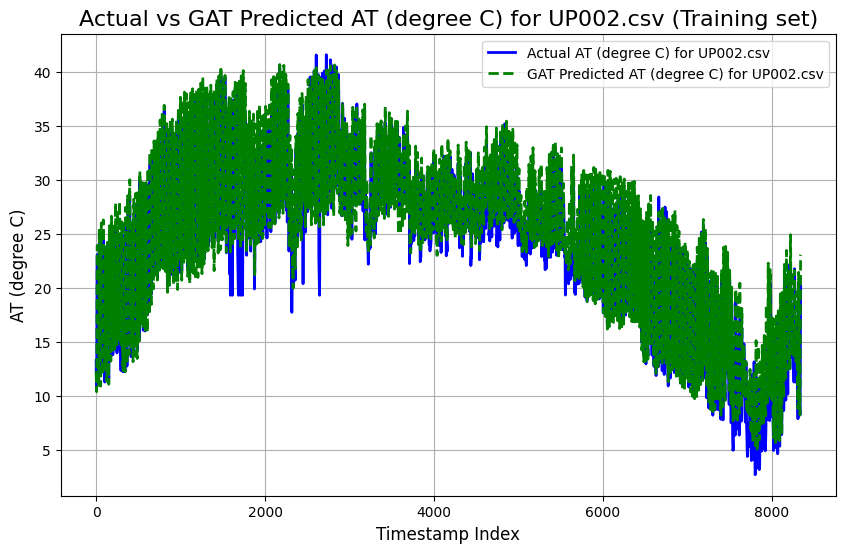

UP003.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3174
Mean Squared Error (MSE): 3.0015
Root Mean Squared Error (RMSE): 1.7325
Pearson Correlation Coefficient: 0.9831
R-squared (R²): 0.9604

----------------------------------------



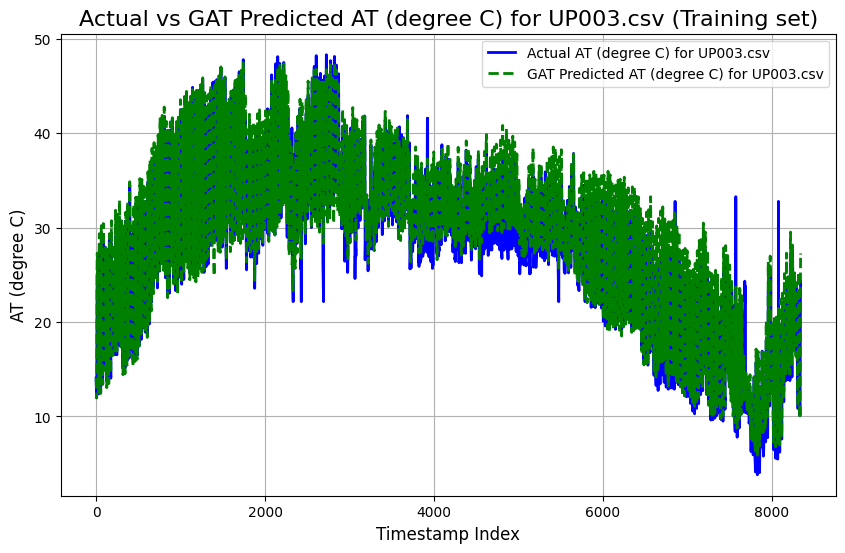

UP004.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5834
Mean Squared Error (MSE): 4.0515
Root Mean Squared Error (RMSE): 2.0128
Pearson Correlation Coefficient: 0.9778
R-squared (R²): 0.9513

----------------------------------------



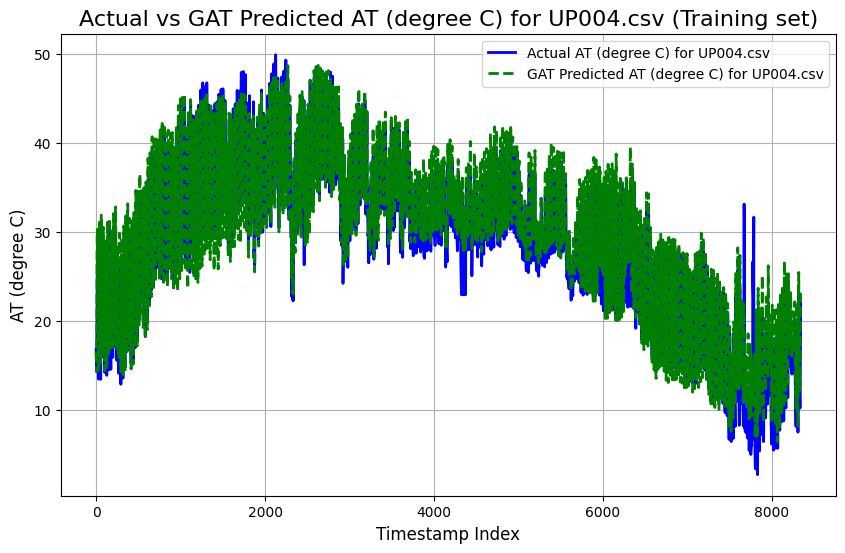

UP008.csv (Training set) Metrics:
Mean Absolute Error (MAE): 5.5809
Mean Squared Error (MSE): 63.1386
Root Mean Squared Error (RMSE): 7.9460
Pearson Correlation Coefficient: 0.7626
R-squared (R²): 0.5458

----------------------------------------



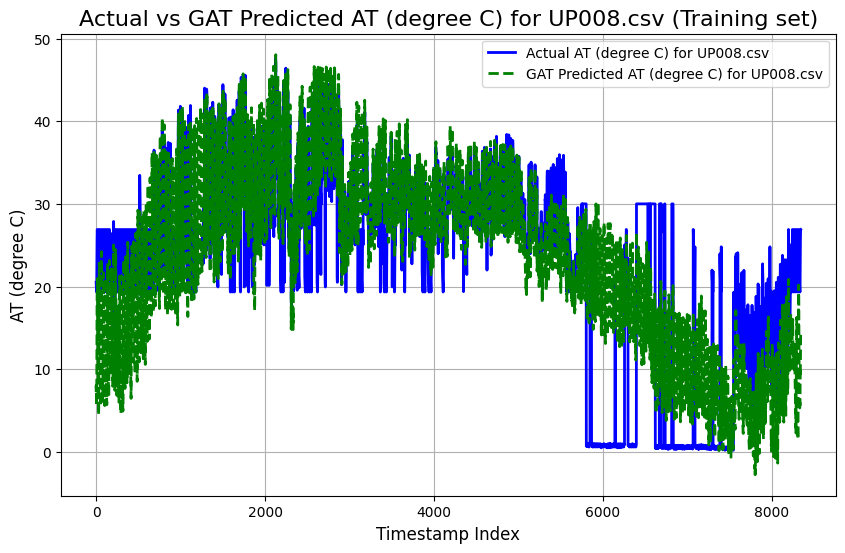

UP009.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3133
Mean Squared Error (MSE): 3.2556
Root Mean Squared Error (RMSE): 1.8043
Pearson Correlation Coefficient: 0.9748
R-squared (R²): 0.9455

----------------------------------------



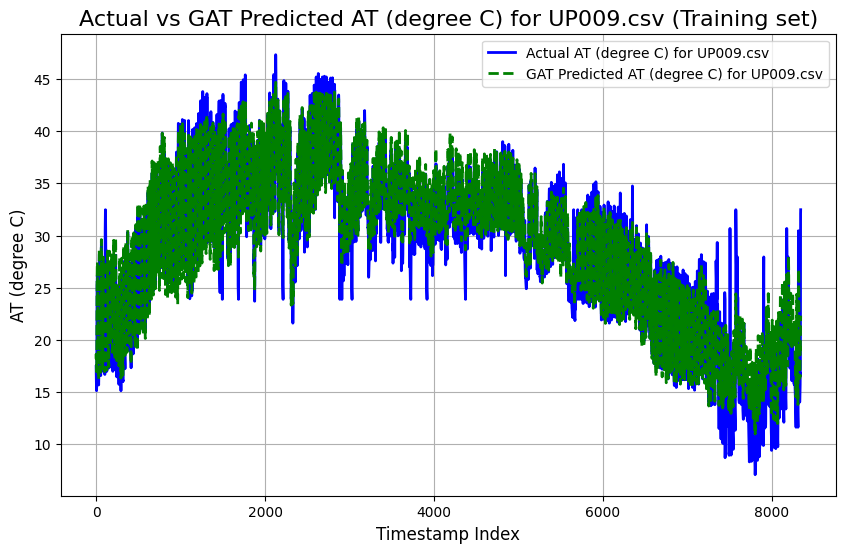

UP012.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.7958
Mean Squared Error (MSE): 8.3969
Root Mean Squared Error (RMSE): 2.8977
Pearson Correlation Coefficient: 0.9619
R-squared (R²): 0.9210

----------------------------------------



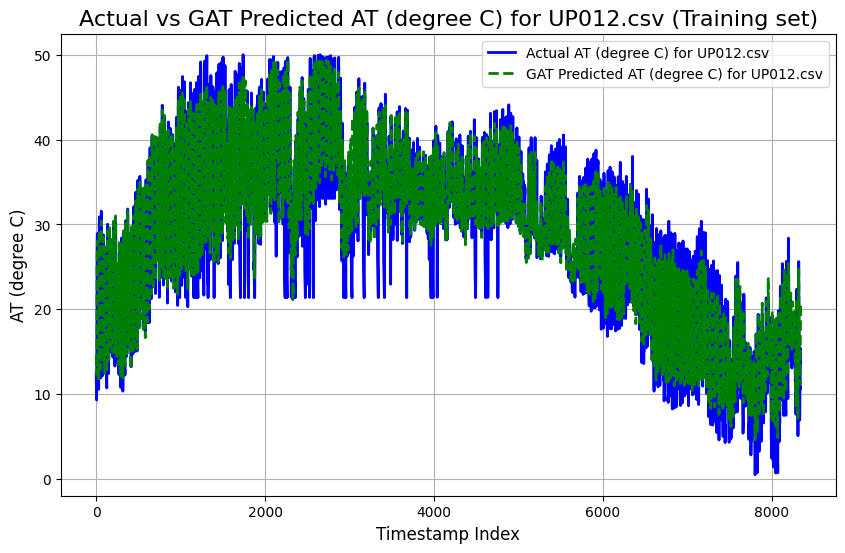

UP014.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.2906
Mean Squared Error (MSE): 17.1378
Root Mean Squared Error (RMSE): 4.1398
Pearson Correlation Coefficient: 0.9352
R-squared (R²): 0.8680

----------------------------------------



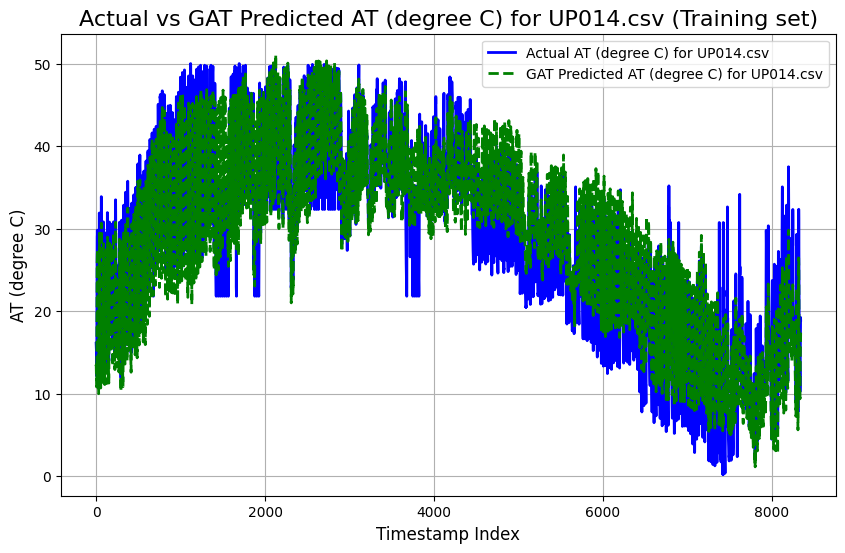

UP016.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.3367
Mean Squared Error (MSE): 20.3201
Root Mean Squared Error (RMSE): 4.5078
Pearson Correlation Coefficient: 0.9228
R-squared (R²): 0.8442

----------------------------------------



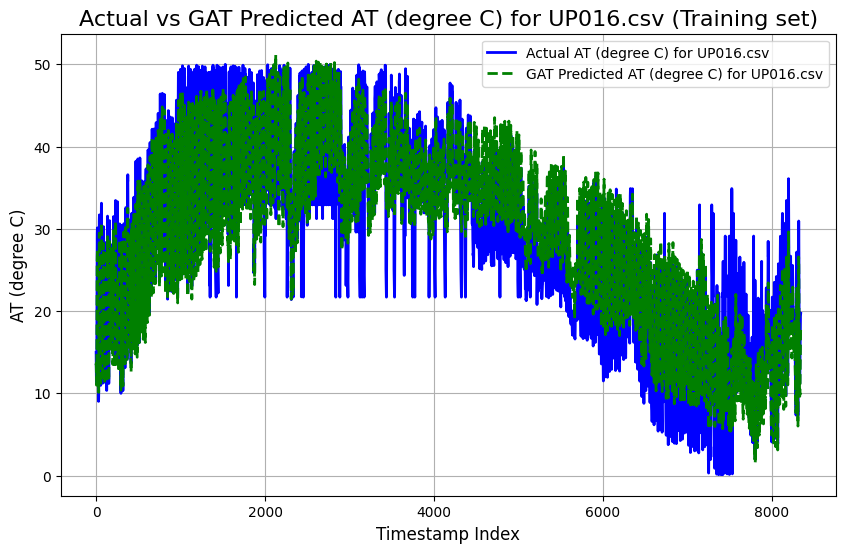

UP017.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.9062
Mean Squared Error (MSE): 1.2323
Root Mean Squared Error (RMSE): 1.1101
Pearson Correlation Coefficient: 0.9833
R-squared (R²): 0.9622

----------------------------------------



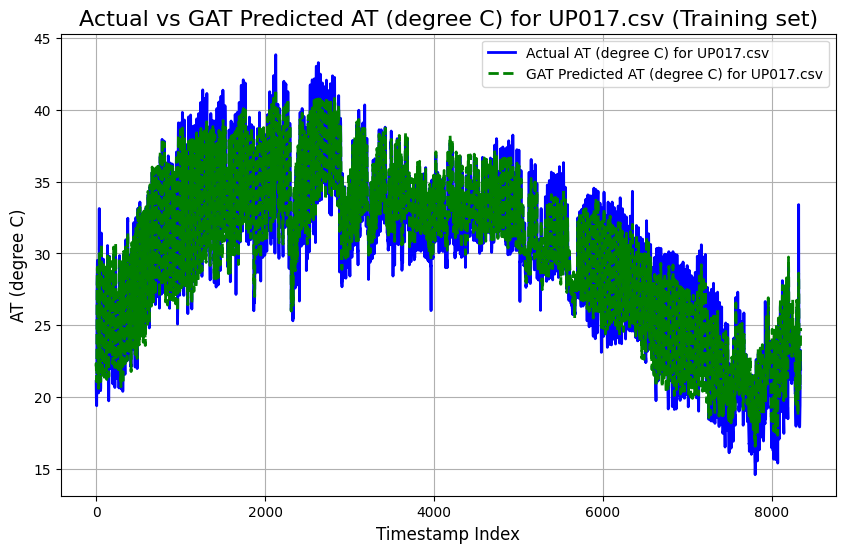

UP018.csv (Training set) Metrics:
Mean Absolute Error (MAE): 4.3455
Mean Squared Error (MSE): 40.7933
Root Mean Squared Error (RMSE): 6.3870
Pearson Correlation Coefficient: 0.4866
R-squared (R²): 0.0226

----------------------------------------



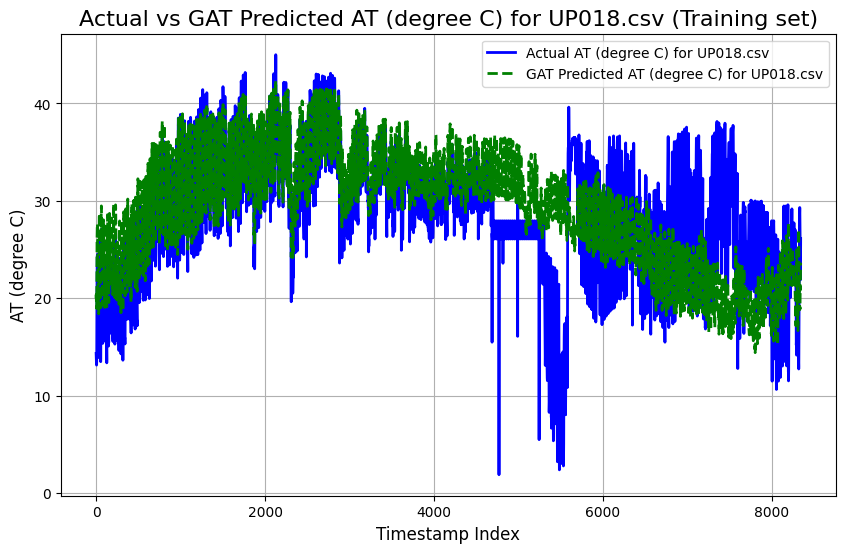

UP019.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.7609
Mean Squared Error (MSE): 6.3100
Root Mean Squared Error (RMSE): 2.5120
Pearson Correlation Coefficient: 0.9103
R-squared (R²): 0.8226

----------------------------------------



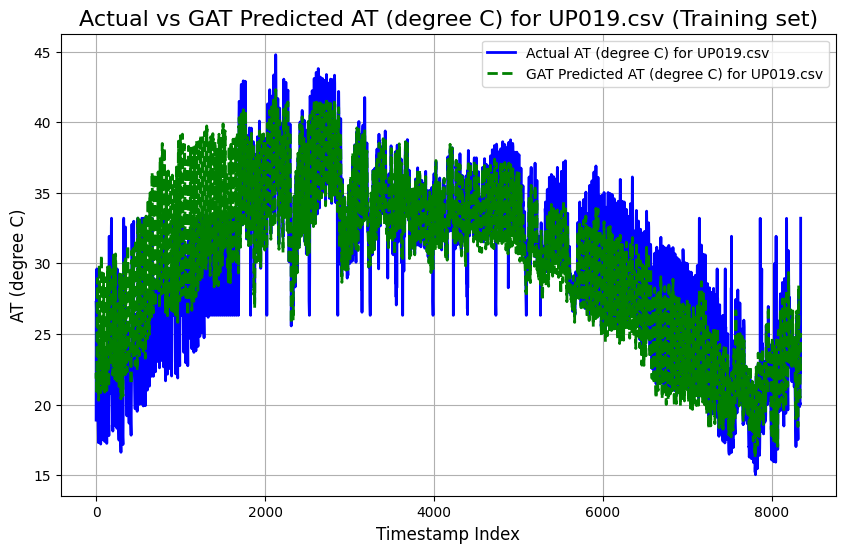

UP020.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3103
Mean Squared Error (MSE): 2.7572
Root Mean Squared Error (RMSE): 1.6605
Pearson Correlation Coefficient: 0.9781
R-squared (R²): 0.9513

----------------------------------------



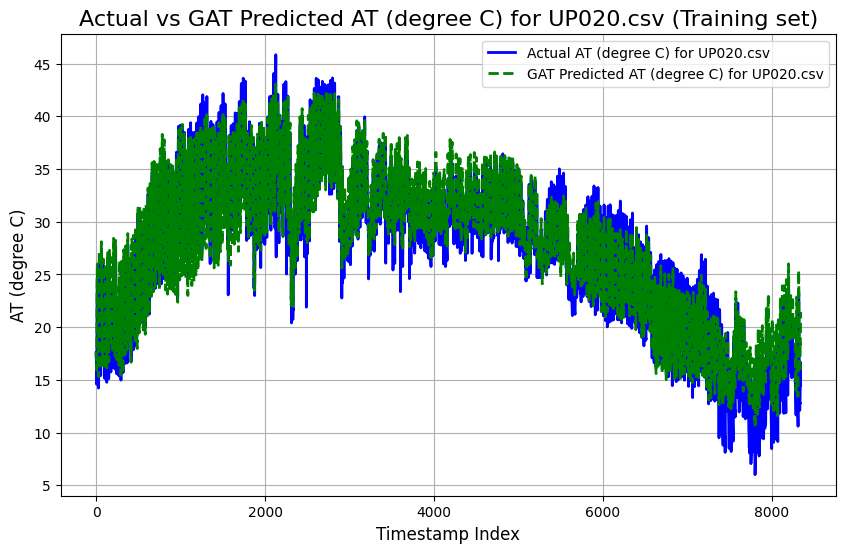

UP021.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.6281
Mean Squared Error (MSE): 23.3530
Root Mean Squared Error (RMSE): 4.8325
Pearson Correlation Coefficient: 0.8437
R-squared (R²): 0.6983

----------------------------------------



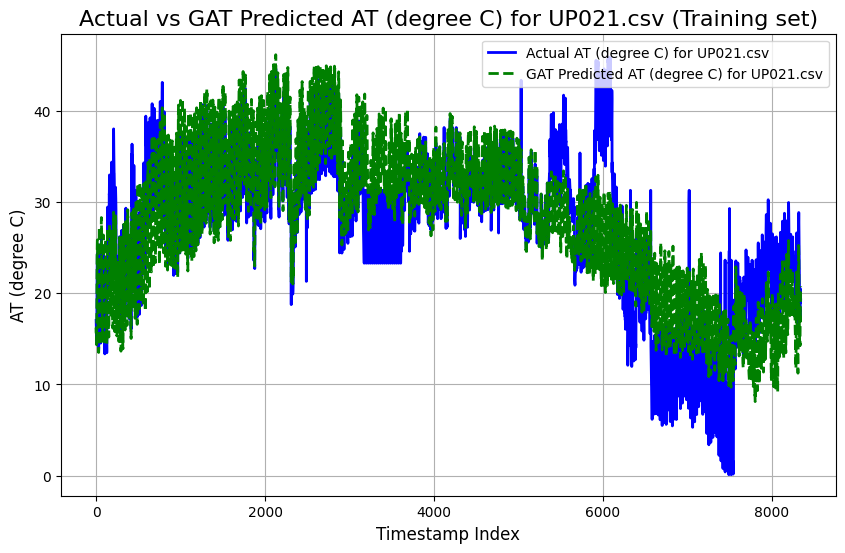

UP022.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3147
Mean Squared Error (MSE): 3.0845
Root Mean Squared Error (RMSE): 1.7563
Pearson Correlation Coefficient: 0.9751
R-squared (R²): 0.9455

----------------------------------------



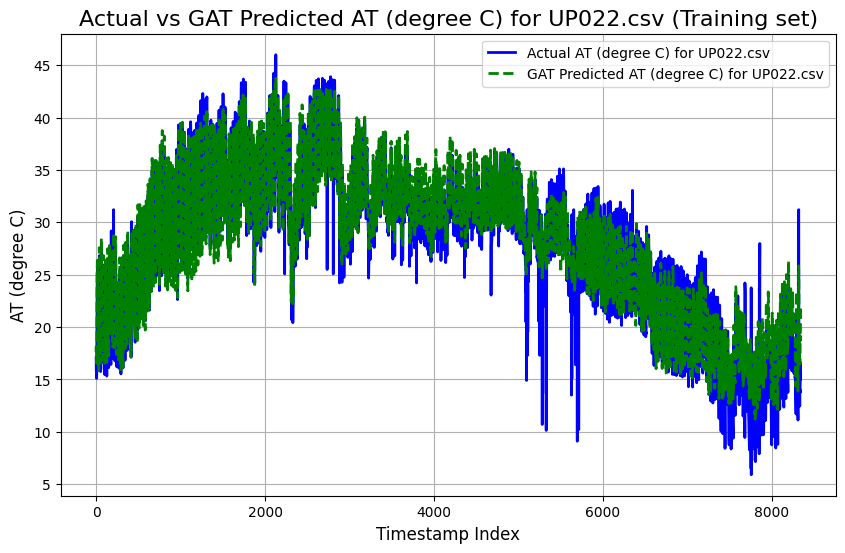

UP023.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.0332
Mean Squared Error (MSE): 8.7514
Root Mean Squared Error (RMSE): 2.9583
Pearson Correlation Coefficient: 0.9121
R-squared (R²): 0.8231

----------------------------------------



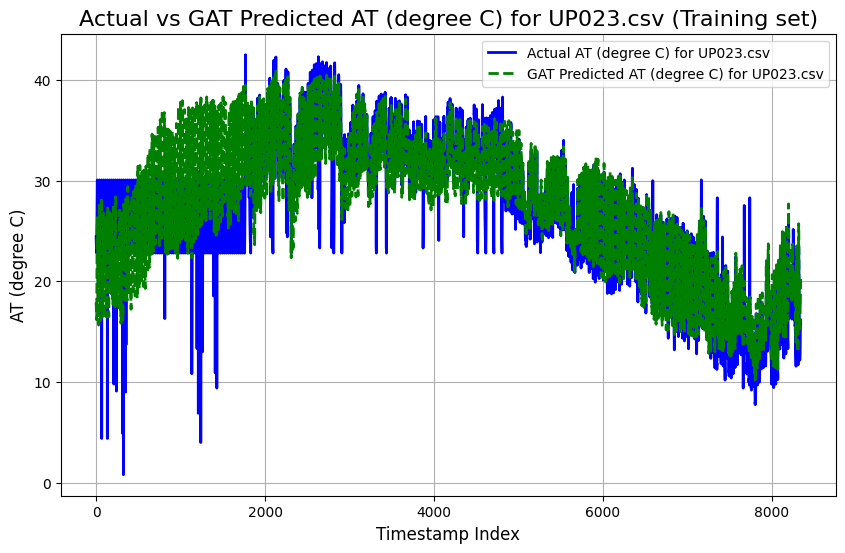

UP024.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.6427
Mean Squared Error (MSE): 13.4068
Root Mean Squared Error (RMSE): 3.6615
Pearson Correlation Coefficient: 0.8288
R-squared (R²): 0.6491

----------------------------------------



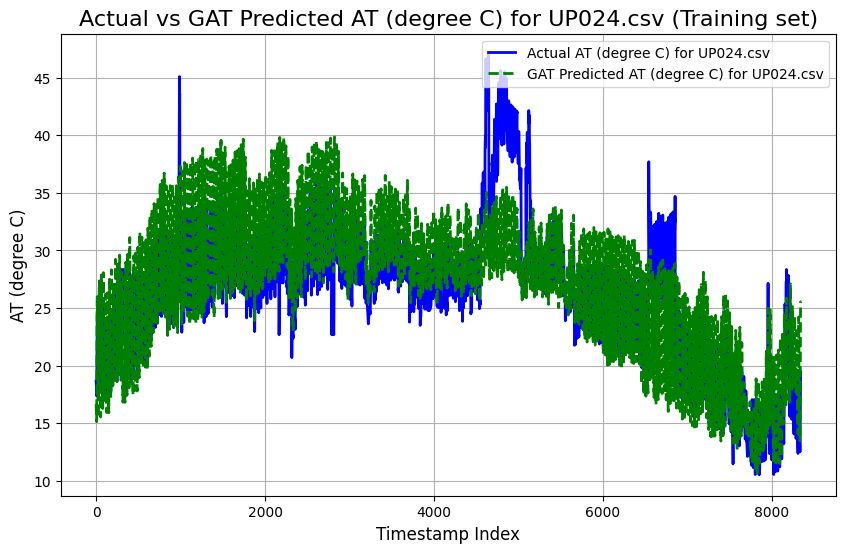

UP025.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2058
Mean Squared Error (MSE): 2.8777
Root Mean Squared Error (RMSE): 1.6964
Pearson Correlation Coefficient: 0.9774
R-squared (R²): 0.9508

----------------------------------------



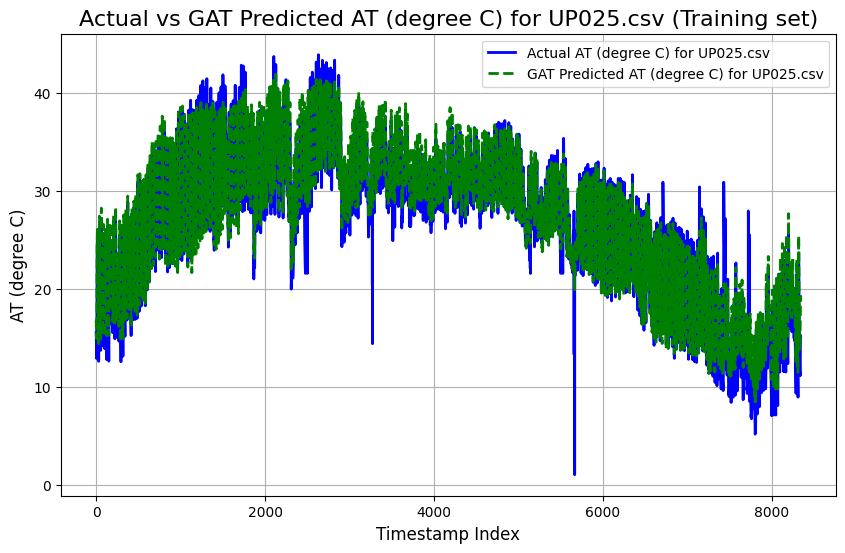

UP026.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1892
Mean Squared Error (MSE): 3.0017
Root Mean Squared Error (RMSE): 1.7325
Pearson Correlation Coefficient: 0.9799
R-squared (R²): 0.9557

----------------------------------------



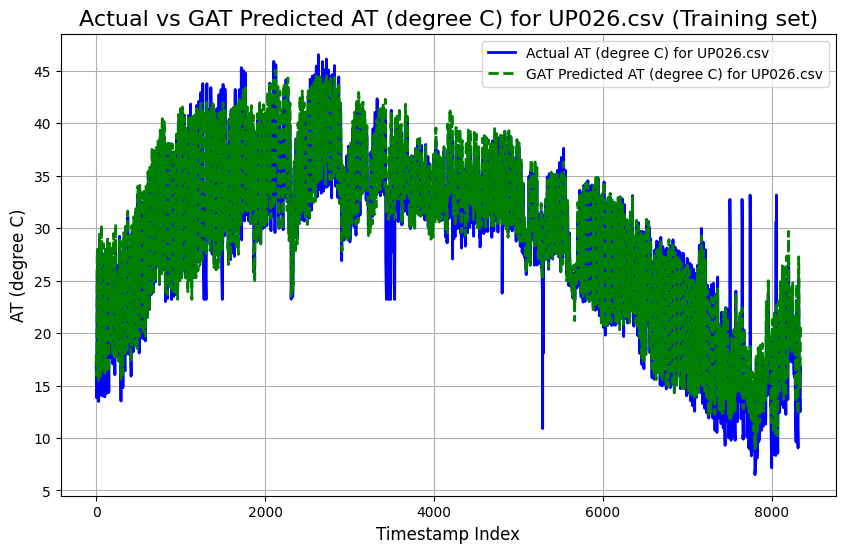

UP028.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.7280
Mean Squared Error (MSE): 4.8434
Root Mean Squared Error (RMSE): 2.2008
Pearson Correlation Coefficient: 0.9761
R-squared (R²): 0.9479

----------------------------------------



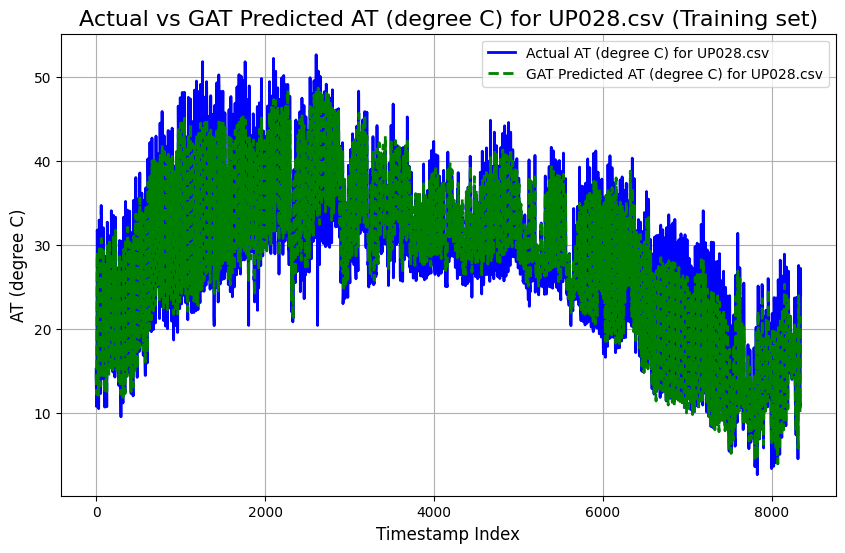

UP029.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1308
Mean Squared Error (MSE): 2.9569
Root Mean Squared Error (RMSE): 1.7196
Pearson Correlation Coefficient: 0.9781
R-squared (R²): 0.9504

----------------------------------------



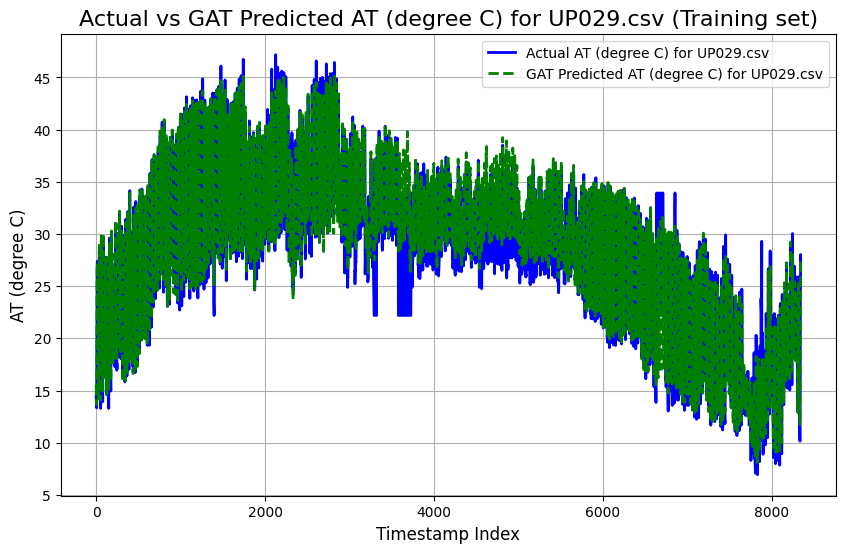

UP030.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3040
Mean Squared Error (MSE): 2.7919
Root Mean Squared Error (RMSE): 1.6709
Pearson Correlation Coefficient: 0.9851
R-squared (R²): 0.9658

----------------------------------------



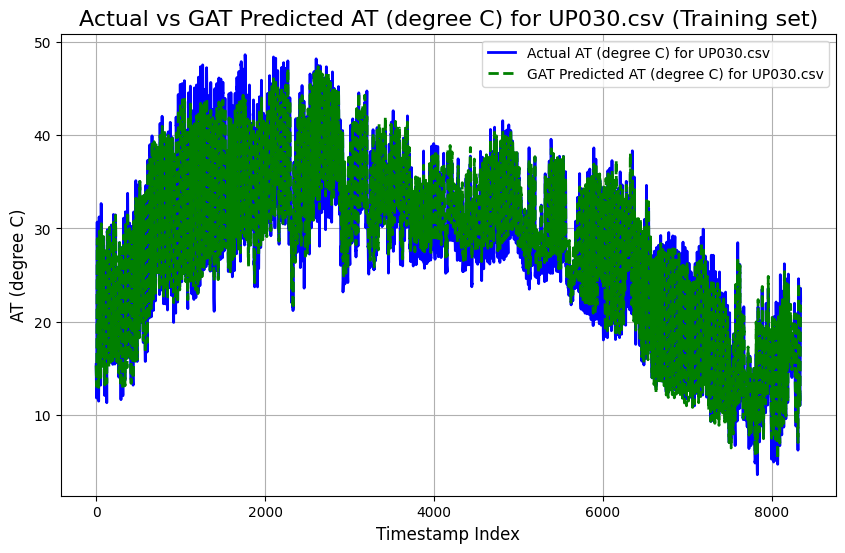

UP031.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5446
Mean Squared Error (MSE): 4.2001
Root Mean Squared Error (RMSE): 2.0494
Pearson Correlation Coefficient: 0.9723
R-squared (R²): 0.9386

----------------------------------------



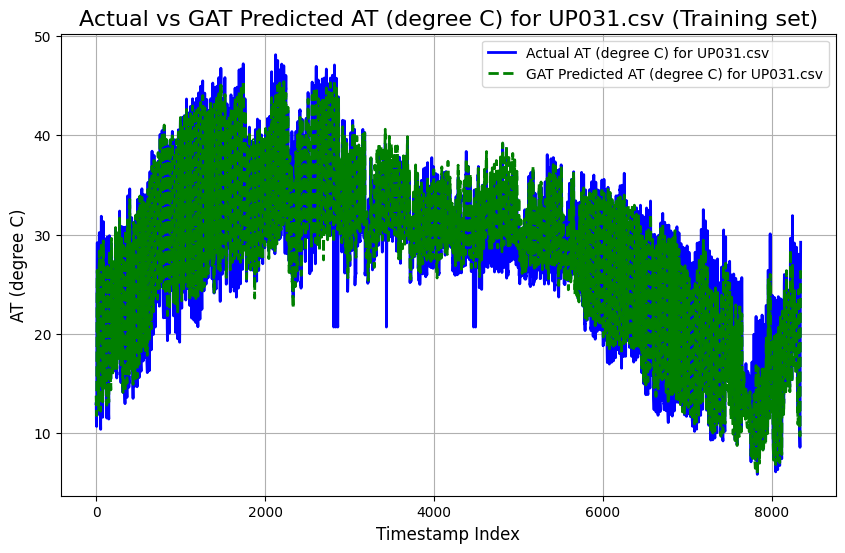

UP032.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4504
Mean Squared Error (MSE): 3.7515
Root Mean Squared Error (RMSE): 1.9369
Pearson Correlation Coefficient: 0.9680
R-squared (R²): 0.9299

----------------------------------------



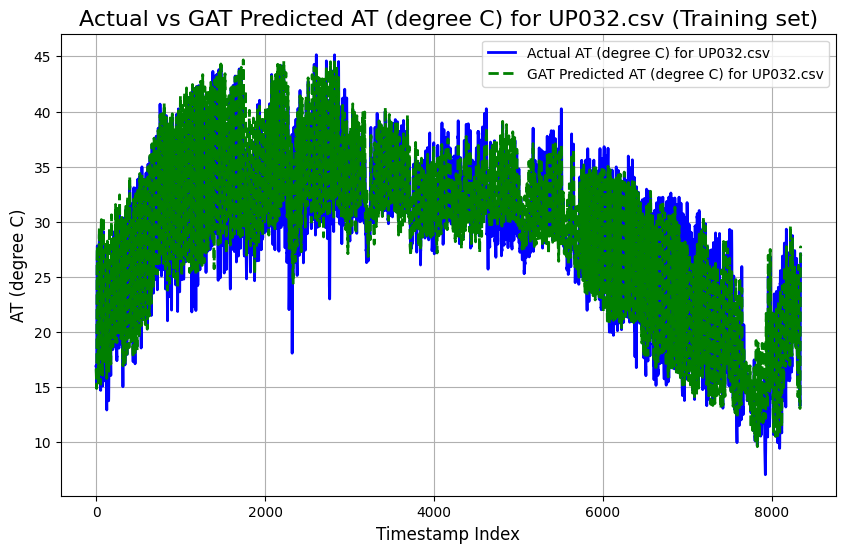

UP033.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0511
Mean Squared Error (MSE): 2.7766
Root Mean Squared Error (RMSE): 1.6663
Pearson Correlation Coefficient: 0.9806
R-squared (R²): 0.9558

----------------------------------------



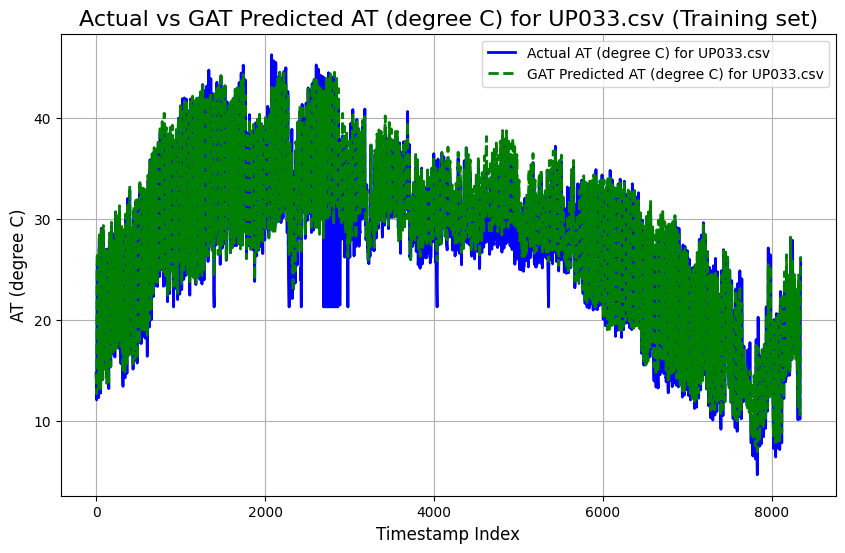

UP034.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.6259
Mean Squared Error (MSE): 5.7172
Root Mean Squared Error (RMSE): 2.3911
Pearson Correlation Coefficient: 0.9708
R-squared (R²): 0.9375

----------------------------------------



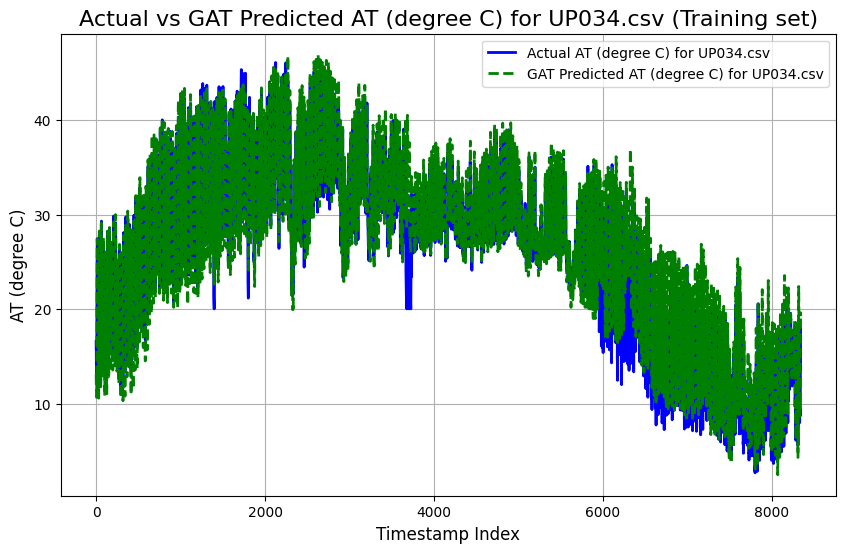

UP035.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1489
Mean Squared Error (MSE): 2.6079
Root Mean Squared Error (RMSE): 1.6149
Pearson Correlation Coefficient: 0.9840
R-squared (R²): 0.9625

----------------------------------------



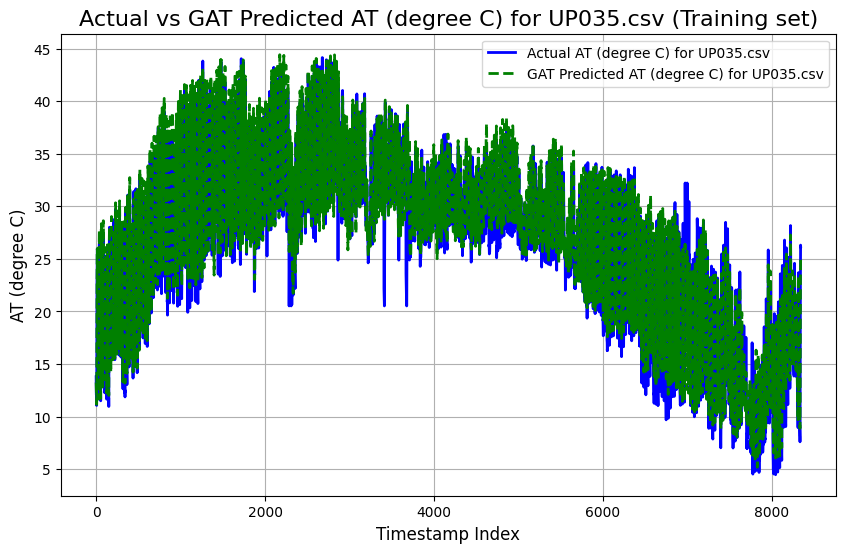

UP036.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1807
Mean Squared Error (MSE): 2.9503
Root Mean Squared Error (RMSE): 1.7176
Pearson Correlation Coefficient: 0.9789
R-squared (R²): 0.9520

----------------------------------------



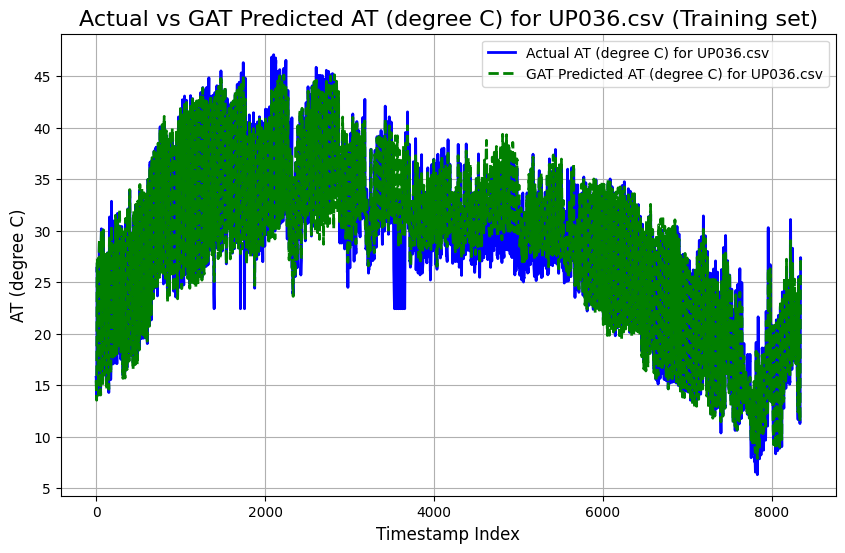

UP037.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3423
Mean Squared Error (MSE): 3.7232
Root Mean Squared Error (RMSE): 1.9296
Pearson Correlation Coefficient: 0.9779
R-squared (R²): 0.9515

----------------------------------------



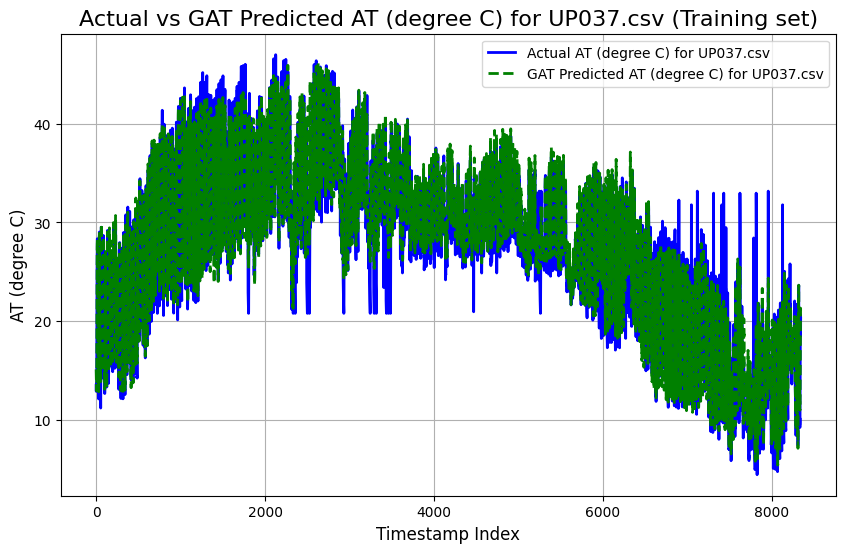

UP038.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2517
Mean Squared Error (MSE): 4.2541
Root Mean Squared Error (RMSE): 2.0626
Pearson Correlation Coefficient: 0.9659
R-squared (R²): 0.9260

----------------------------------------



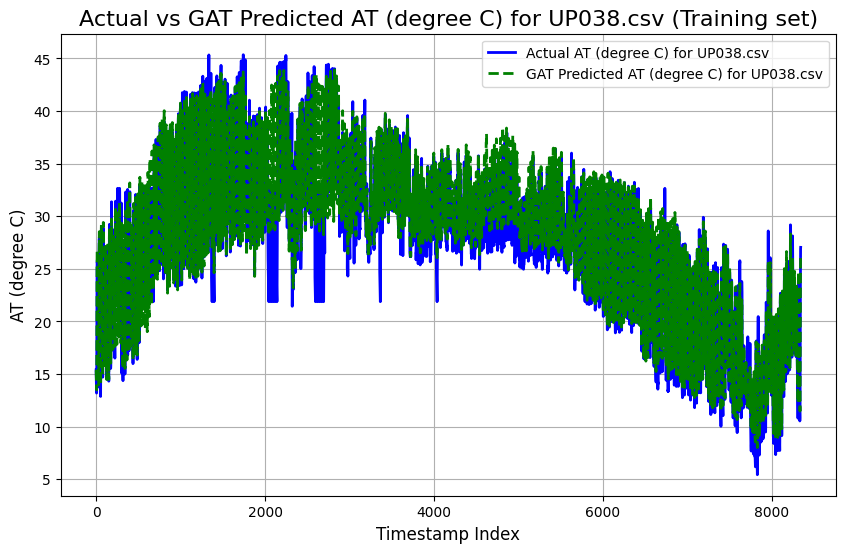

UP039.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.6993
Mean Squared Error (MSE): 5.3243
Root Mean Squared Error (RMSE): 2.3074
Pearson Correlation Coefficient: 0.9692
R-squared (R²): 0.9326

----------------------------------------



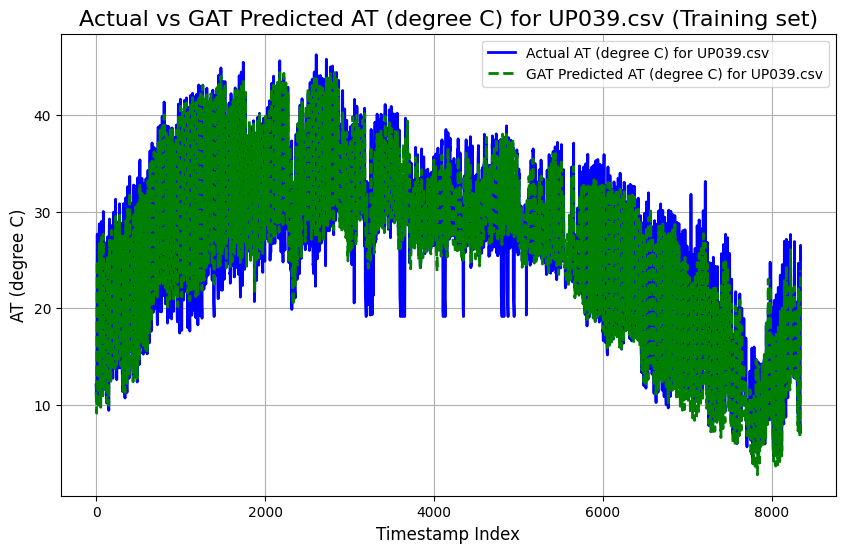

UP040.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3607
Mean Squared Error (MSE): 3.3435
Root Mean Squared Error (RMSE): 1.8285
Pearson Correlation Coefficient: 0.9816
R-squared (R²): 0.9582

----------------------------------------



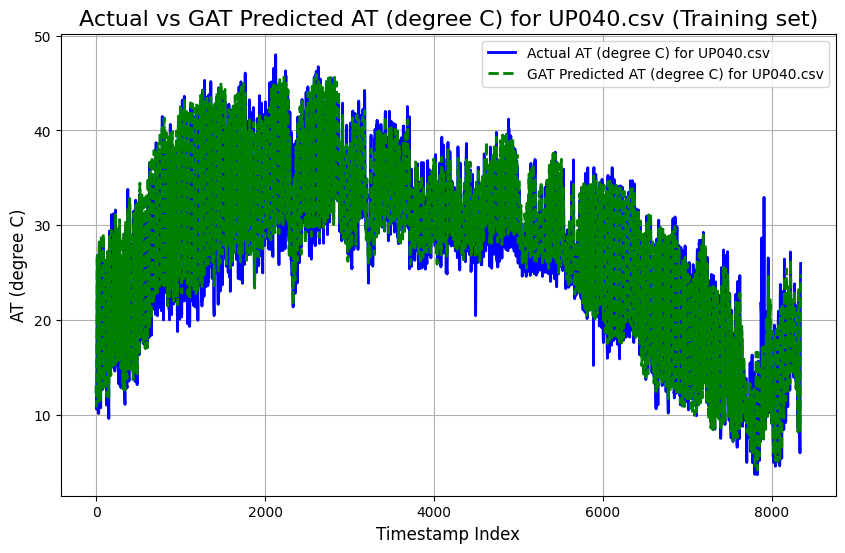

UP041.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2370
Mean Squared Error (MSE): 3.7338
Root Mean Squared Error (RMSE): 1.9323
Pearson Correlation Coefficient: 0.9703
R-squared (R²): 0.9345

----------------------------------------



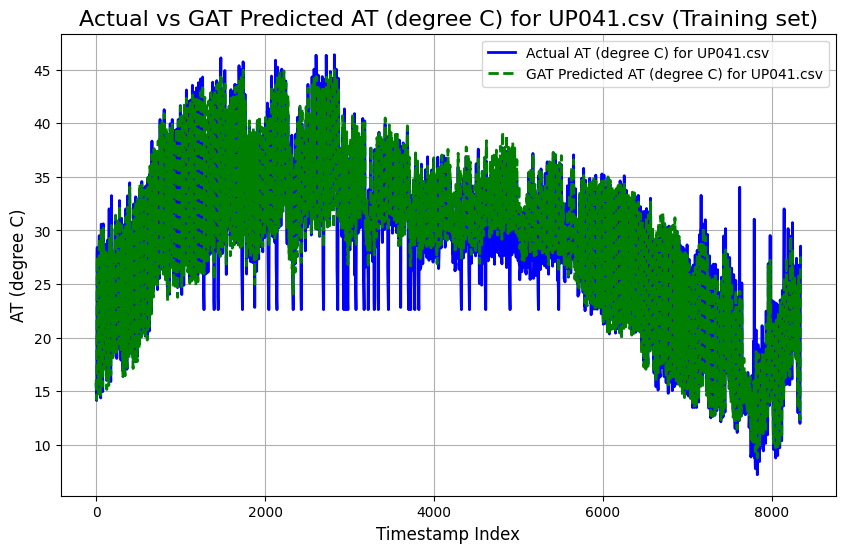

UP042.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.2864
Mean Squared Error (MSE): 11.0974
Root Mean Squared Error (RMSE): 3.3313
Pearson Correlation Coefficient: 0.8990
R-squared (R²): 0.7950

----------------------------------------



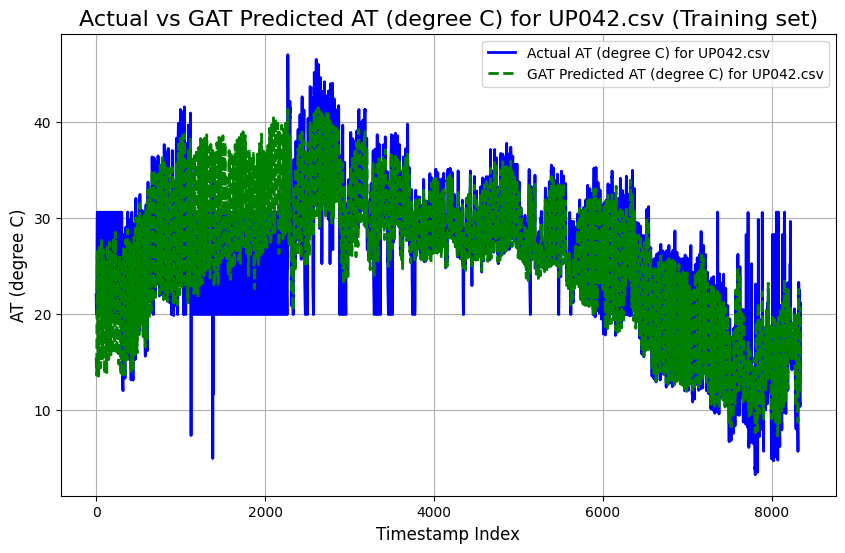

UP043.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.1758
Mean Squared Error (MSE): 11.4783
Root Mean Squared Error (RMSE): 3.3880
Pearson Correlation Coefficient: 0.9108
R-squared (R²): 0.8185

----------------------------------------



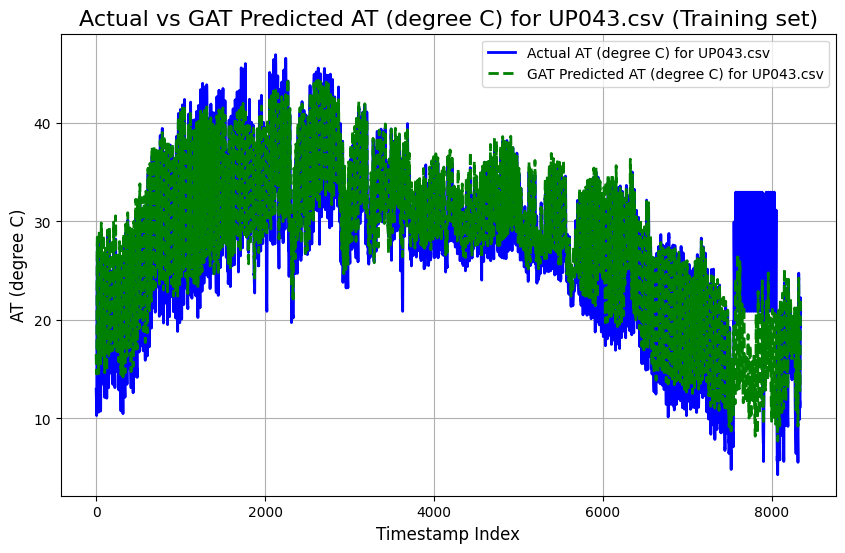

UP044.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2698
Mean Squared Error (MSE): 3.5806
Root Mean Squared Error (RMSE): 1.8922
Pearson Correlation Coefficient: 0.9794
R-squared (R²): 0.9535

----------------------------------------



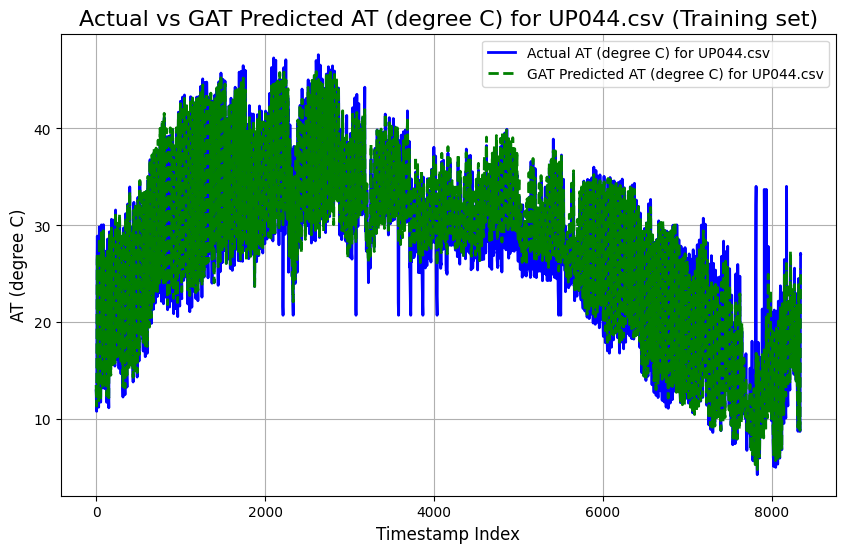

UP046.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4628
Mean Squared Error (MSE): 4.2827
Root Mean Squared Error (RMSE): 2.0695
Pearson Correlation Coefficient: 0.9710
R-squared (R²): 0.9377

----------------------------------------



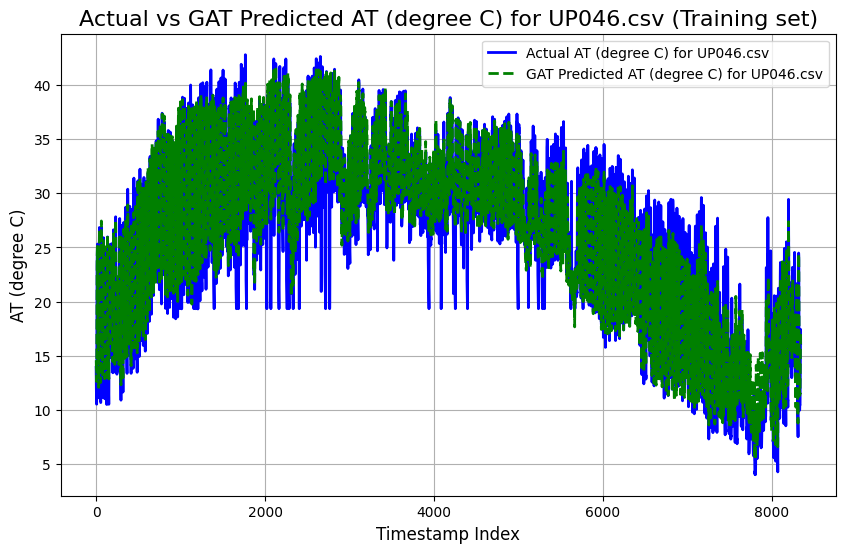

UP048.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5973
Mean Squared Error (MSE): 5.1418
Root Mean Squared Error (RMSE): 2.2676
Pearson Correlation Coefficient: 0.9631
R-squared (R²): 0.9219

----------------------------------------



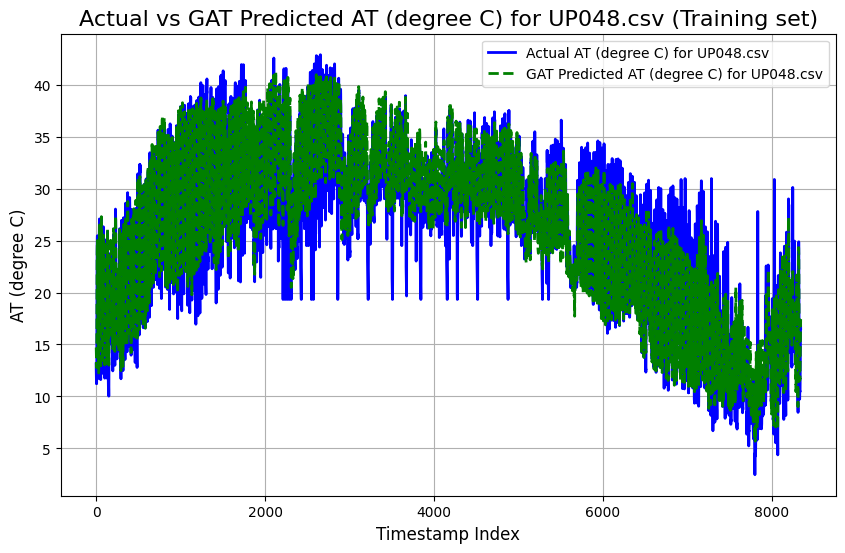

UP049.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4078
Mean Squared Error (MSE): 4.2140
Root Mean Squared Error (RMSE): 2.0528
Pearson Correlation Coefficient: 0.9721
R-squared (R²): 0.9398

----------------------------------------



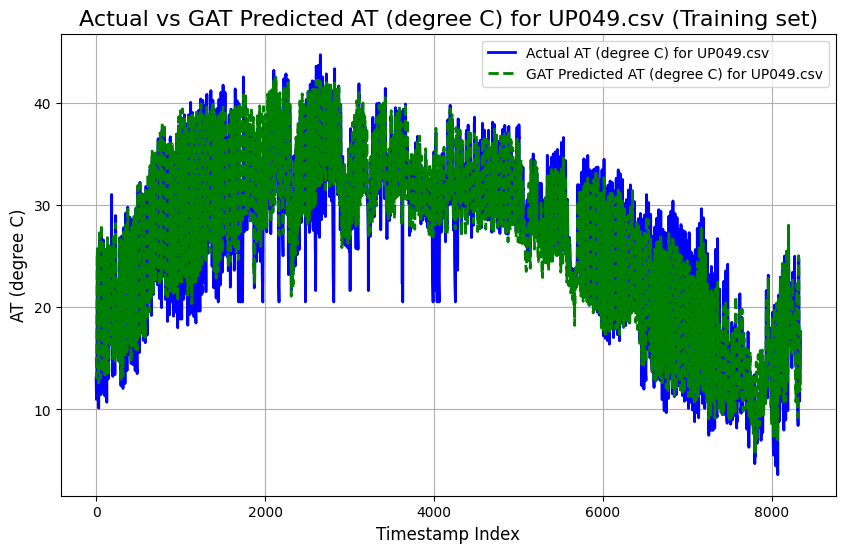

UP050.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.6154
Mean Squared Error (MSE): 12.3536
Root Mean Squared Error (RMSE): 3.5148
Pearson Correlation Coefficient: 0.8584
R-squared (R²): 0.7226

----------------------------------------



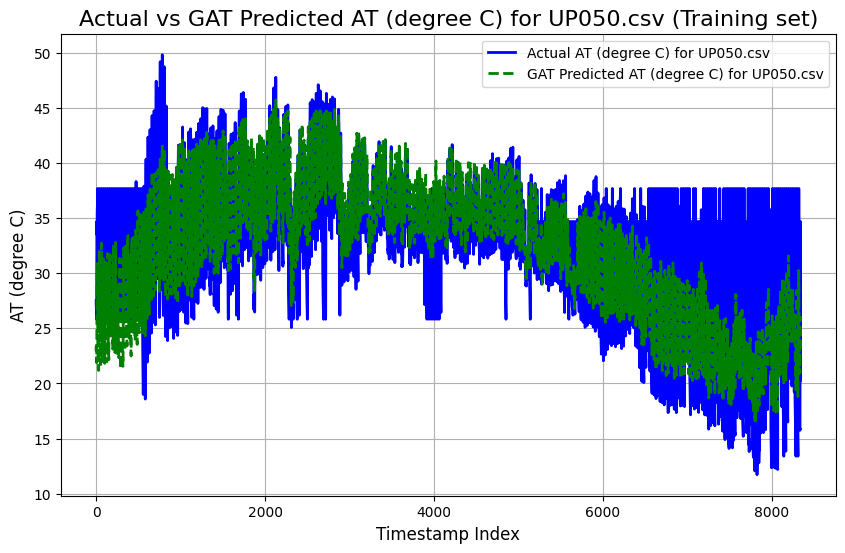

UP051.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.5890
Mean Squared Error (MSE): 23.6231
Root Mean Squared Error (RMSE): 4.8604
Pearson Correlation Coefficient: 0.7946
R-squared (R²): 0.5883

----------------------------------------



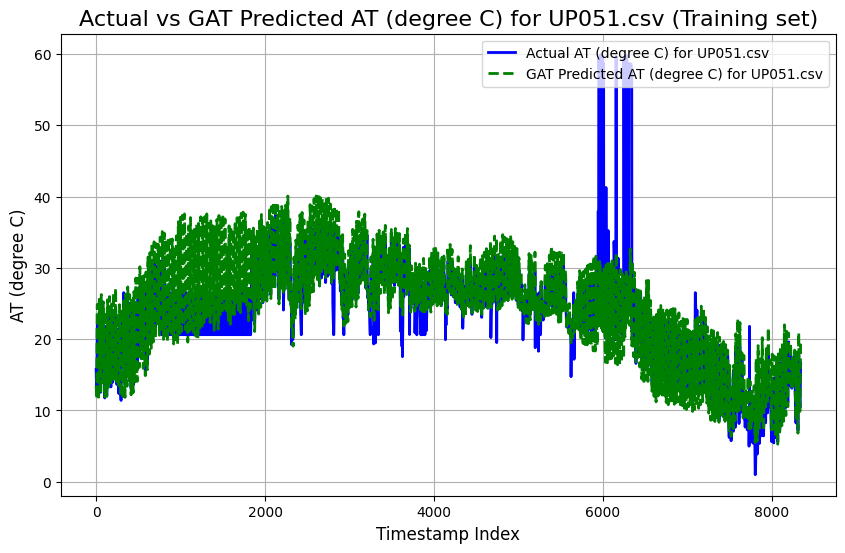

UP052.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.1349
Mean Squared Error (MSE): 8.9874
Root Mean Squared Error (RMSE): 2.9979
Pearson Correlation Coefficient: 0.9350
R-squared (R²): 0.8662

----------------------------------------



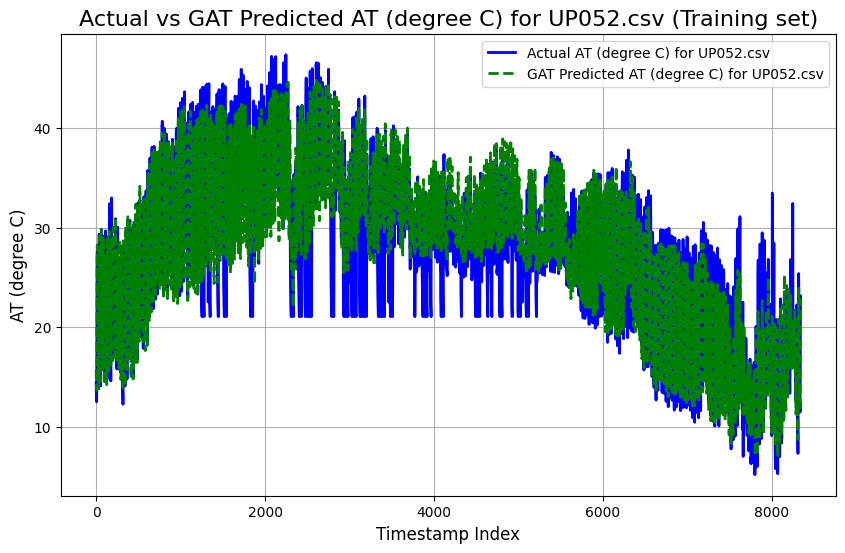

UP002.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1747
Mean Squared Error (MSE): 2.1994
Root Mean Squared Error (RMSE): 1.4830
Pearson Correlation Coefficient: 0.9701
R-squared (R²): 0.9216

----------------------------------------



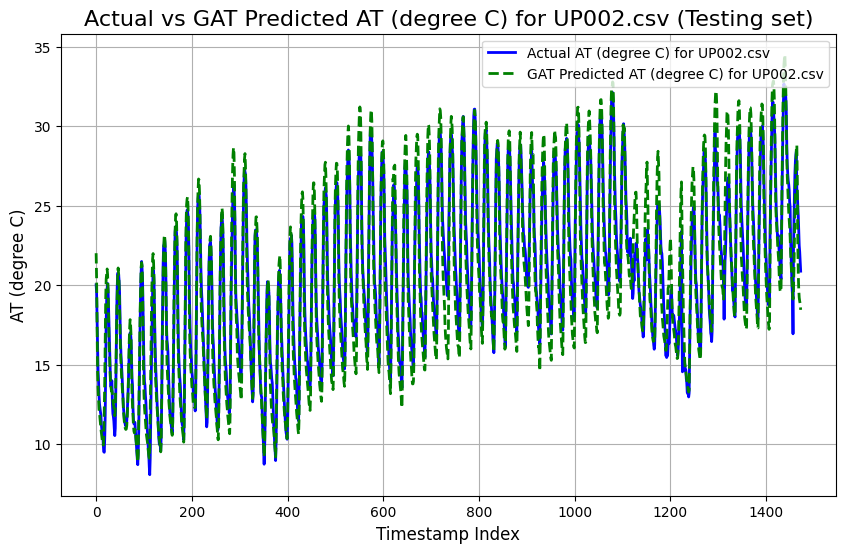

UP003.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3630
Mean Squared Error (MSE): 2.6744
Root Mean Squared Error (RMSE): 1.6354
Pearson Correlation Coefficient: 0.9747
R-squared (R²): 0.9287

----------------------------------------



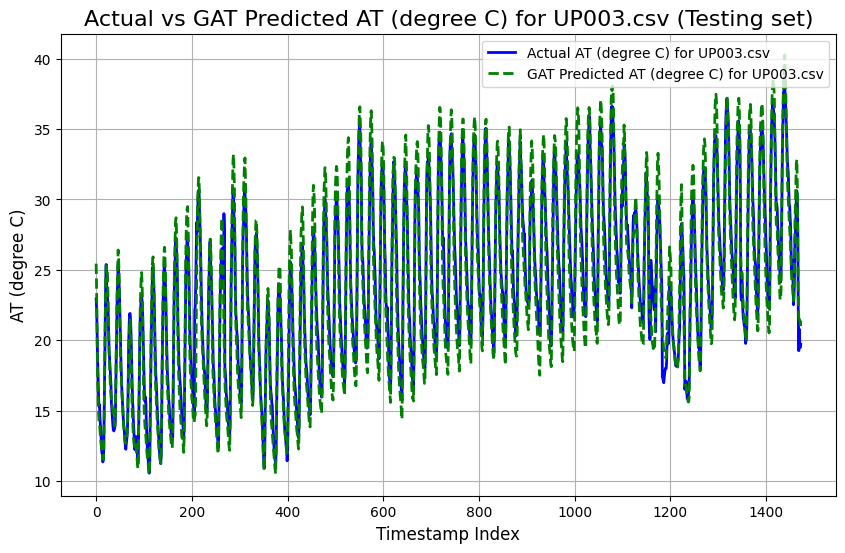

UP004.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3925
Mean Squared Error (MSE): 3.0556
Root Mean Squared Error (RMSE): 1.7480
Pearson Correlation Coefficient: 0.9673
R-squared (R²): 0.9110

----------------------------------------



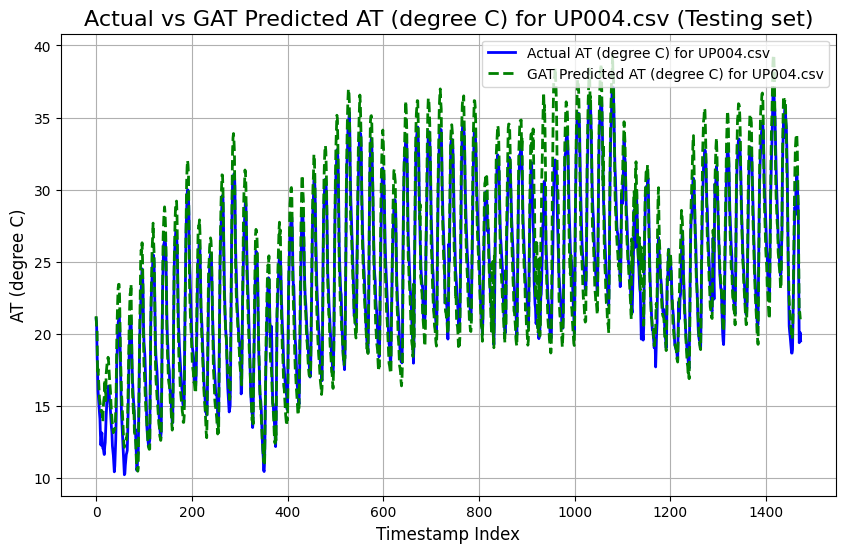

UP008.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 5.2567
Mean Squared Error (MSE): 37.8301
Root Mean Squared Error (RMSE): 6.1506
Pearson Correlation Coefficient: 0.8167
R-squared (R²): -1.1923

----------------------------------------



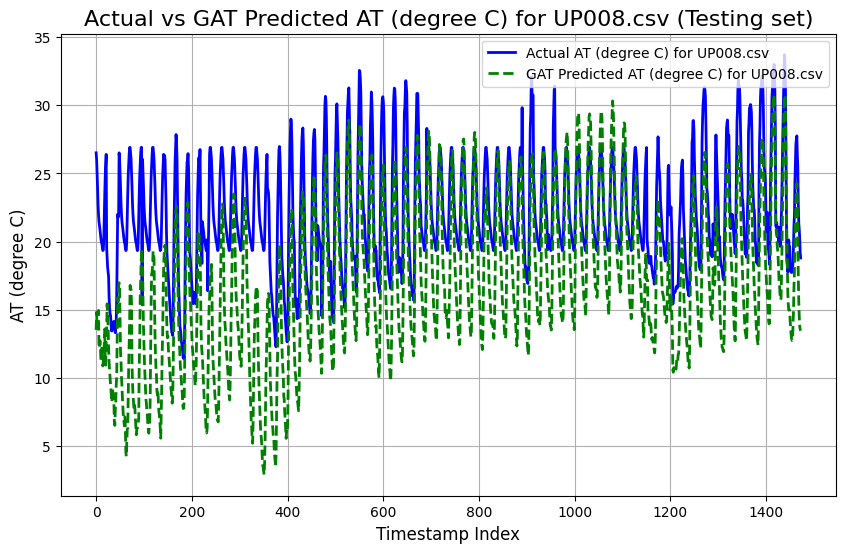

UP009.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1288
Mean Squared Error (MSE): 2.8986
Root Mean Squared Error (RMSE): 1.7025
Pearson Correlation Coefficient: 0.9333
R-squared (R²): 0.8590

----------------------------------------



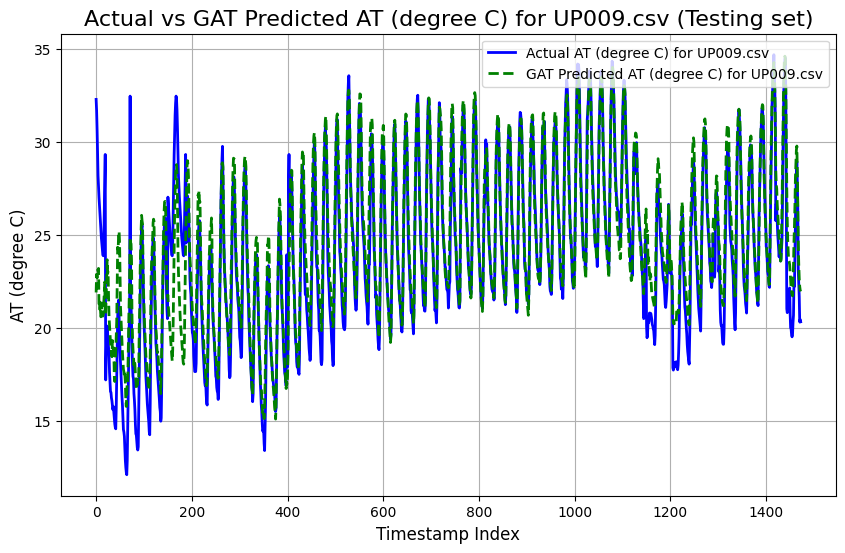

UP012.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4256
Mean Squared Error (MSE): 3.6912
Root Mean Squared Error (RMSE): 1.9213
Pearson Correlation Coefficient: 0.9597
R-squared (R²): 0.9185

----------------------------------------



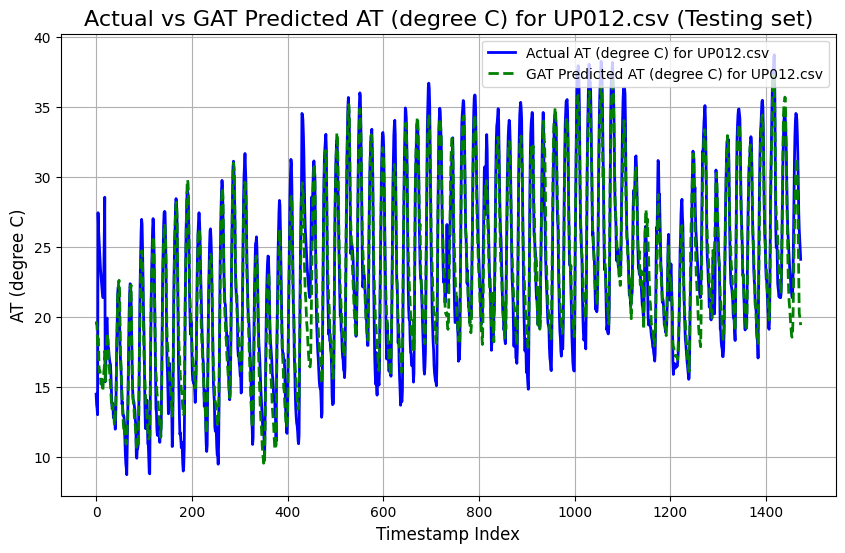

UP014.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 5.4320
Mean Squared Error (MSE): 33.4211
Root Mean Squared Error (RMSE): 5.7811
Pearson Correlation Coefficient: 0.9701
R-squared (R²): 0.4709

----------------------------------------



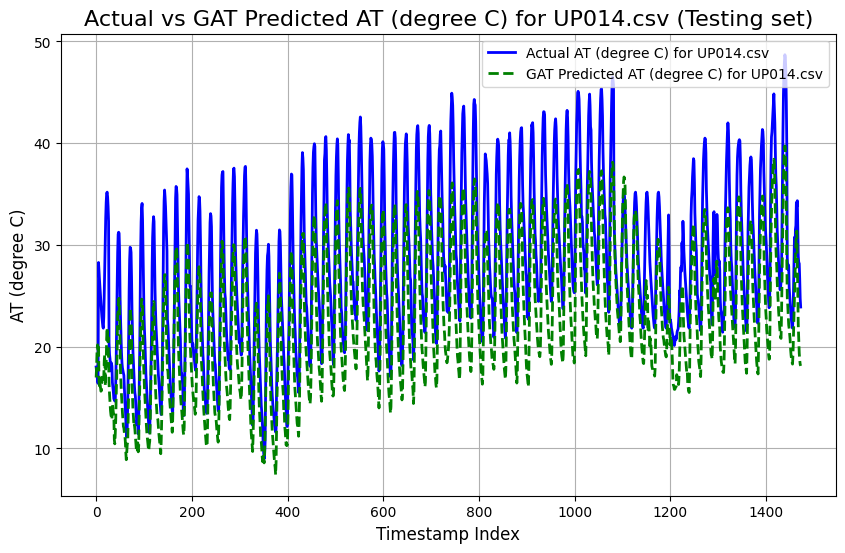

UP016.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 4.4323
Mean Squared Error (MSE): 22.1029
Root Mean Squared Error (RMSE): 4.7014
Pearson Correlation Coefficient: 0.9817
R-squared (R²): 0.6342

----------------------------------------



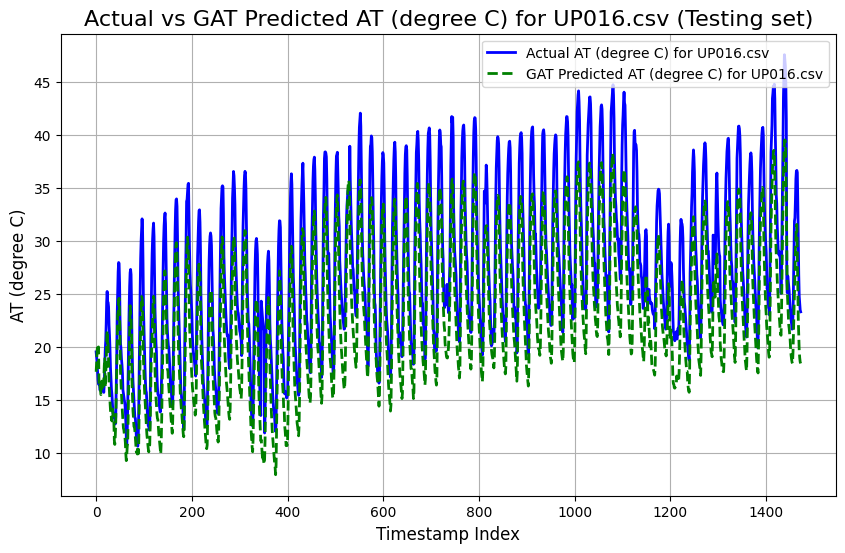

UP017.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8042
Mean Squared Error (MSE): 1.1927
Root Mean Squared Error (RMSE): 1.0921
Pearson Correlation Coefficient: 0.9651
R-squared (R²): 0.9107

----------------------------------------



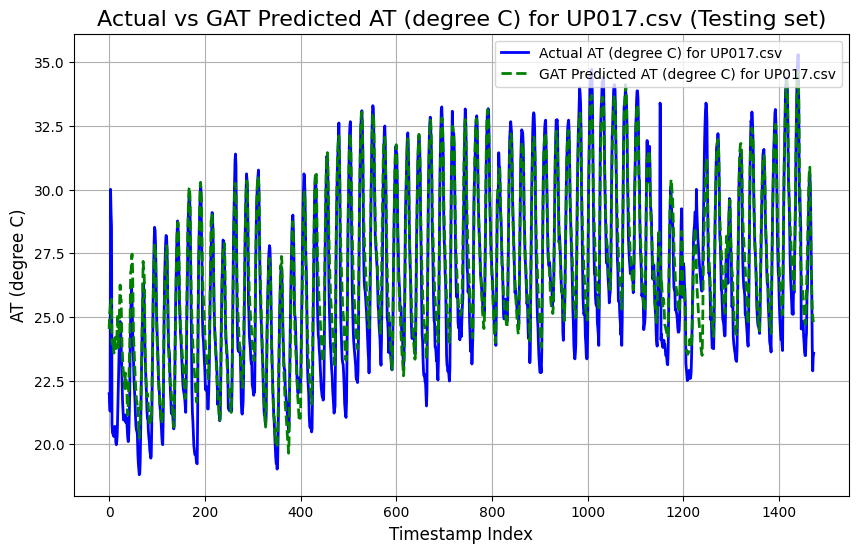

UP018.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 7.9796
Mean Squared Error (MSE): 99.0701
Root Mean Squared Error (RMSE): 9.9534
Pearson Correlation Coefficient: -0.6806
R-squared (R²): -2.5098

----------------------------------------



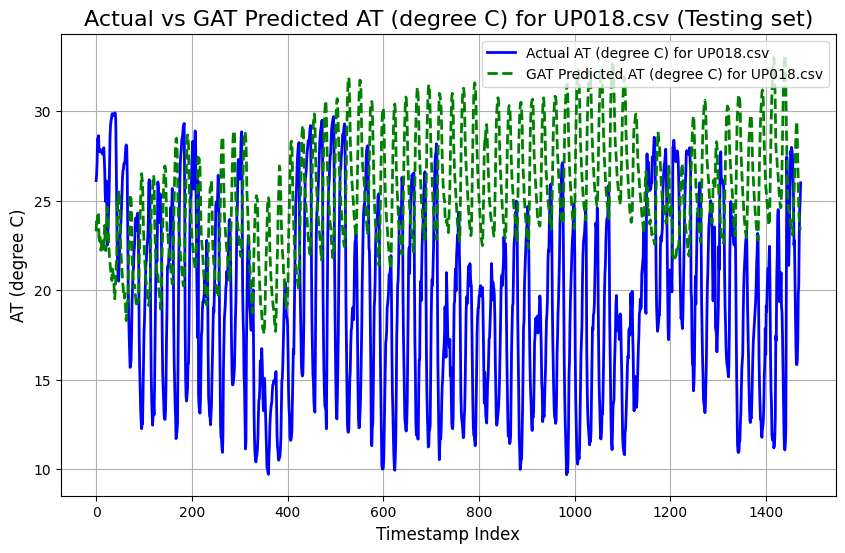

UP019.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.8619
Mean Squared Error (MSE): 4.4509
Root Mean Squared Error (RMSE): 2.1097
Pearson Correlation Coefficient: 0.9553
R-squared (R²): 0.6938

----------------------------------------



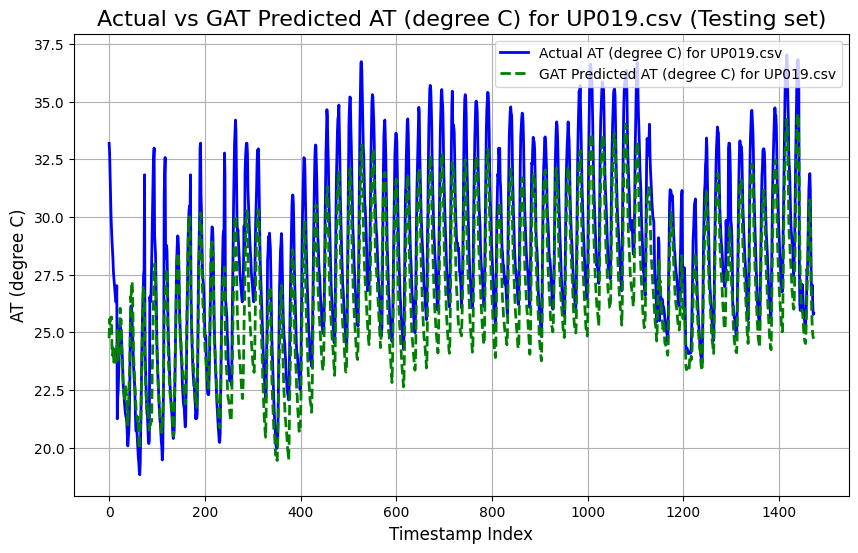

UP020.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0835
Mean Squared Error (MSE): 2.3450
Root Mean Squared Error (RMSE): 1.5313
Pearson Correlation Coefficient: 0.9565
R-squared (R²): 0.8845

----------------------------------------



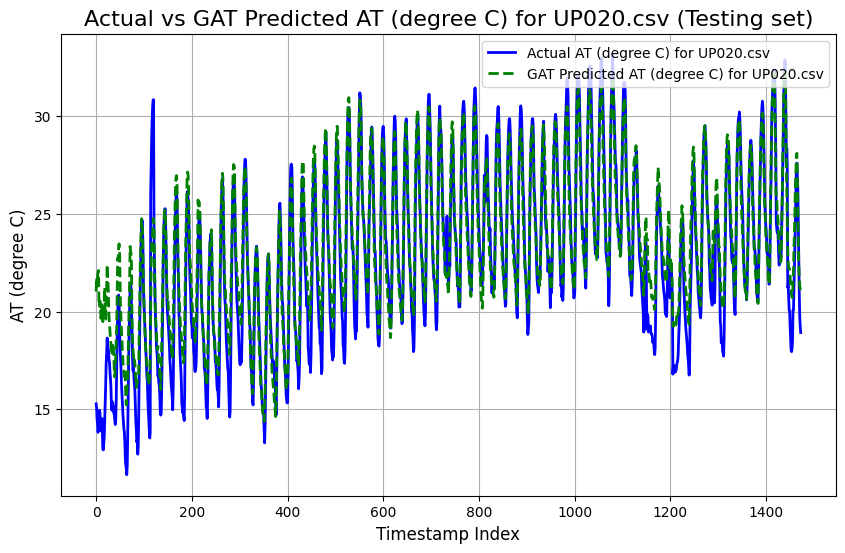

UP021.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 2.9290
Mean Squared Error (MSE): 12.6045
Root Mean Squared Error (RMSE): 3.5503
Pearson Correlation Coefficient: 0.8803
R-squared (R²): 0.3219

----------------------------------------



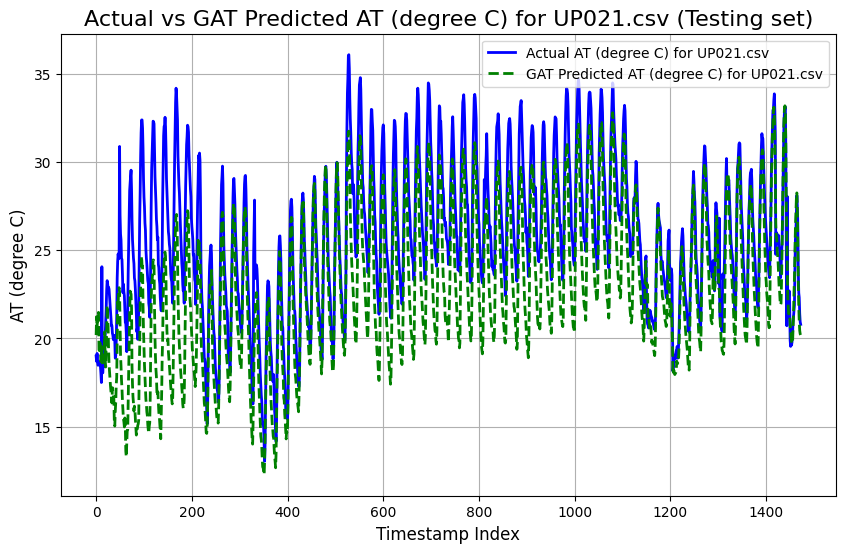

UP022.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0876
Mean Squared Error (MSE): 2.4283
Root Mean Squared Error (RMSE): 1.5583
Pearson Correlation Coefficient: 0.9540
R-squared (R²): 0.8759

----------------------------------------



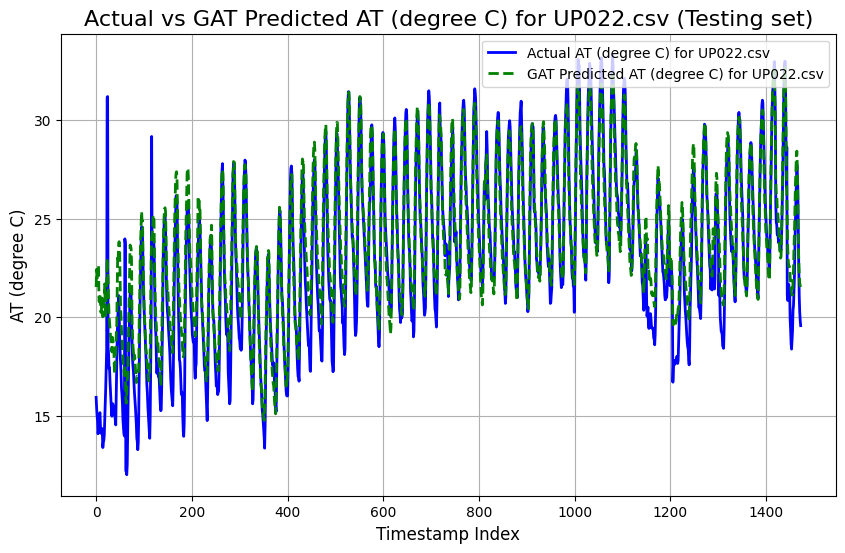

UP023.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.5089
Mean Squared Error (MSE): 3.4241
Root Mean Squared Error (RMSE): 1.8504
Pearson Correlation Coefficient: 0.9423
R-squared (R²): 0.8054

----------------------------------------



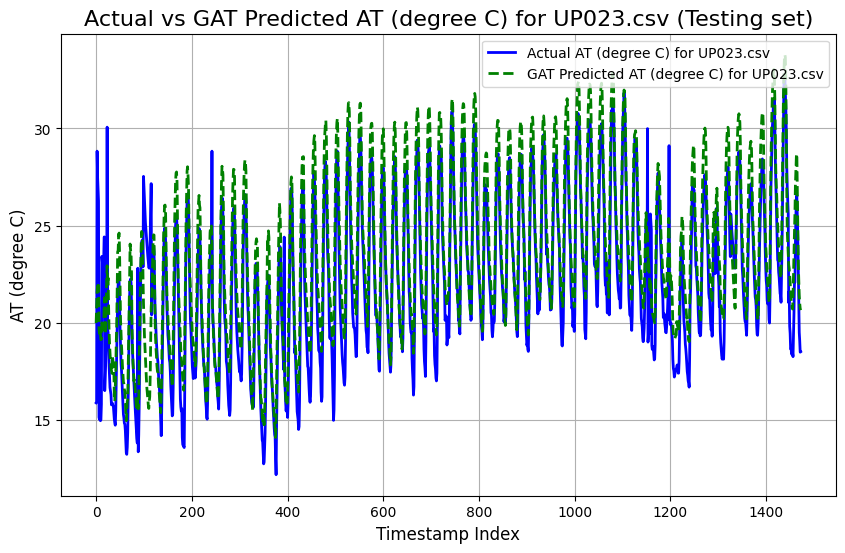

UP024.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.5157
Mean Squared Error (MSE): 16.6272
Root Mean Squared Error (RMSE): 4.0776
Pearson Correlation Coefficient: 0.9584
R-squared (R²): -0.8488

----------------------------------------



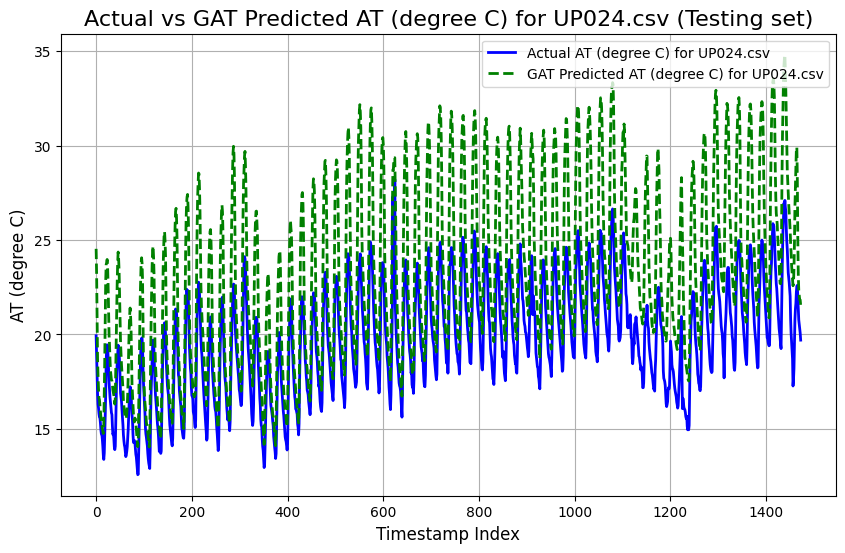

UP025.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.9852
Mean Squared Error (MSE): 1.7417
Root Mean Squared Error (RMSE): 1.3197
Pearson Correlation Coefficient: 0.9769
R-squared (R²): 0.9269

----------------------------------------



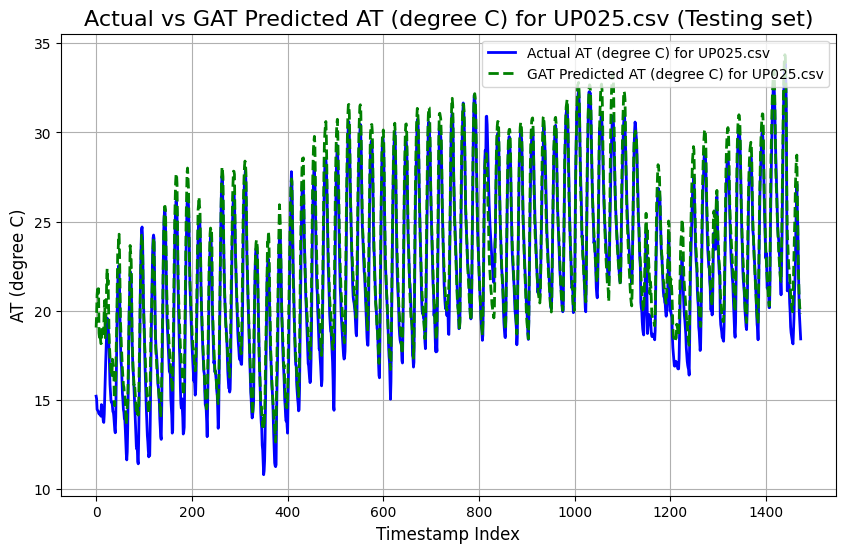

UP026.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.6077
Mean Squared Error (MSE): 3.9701
Root Mean Squared Error (RMSE): 1.9925
Pearson Correlation Coefficient: 0.9430
R-squared (R²): 0.8534

----------------------------------------



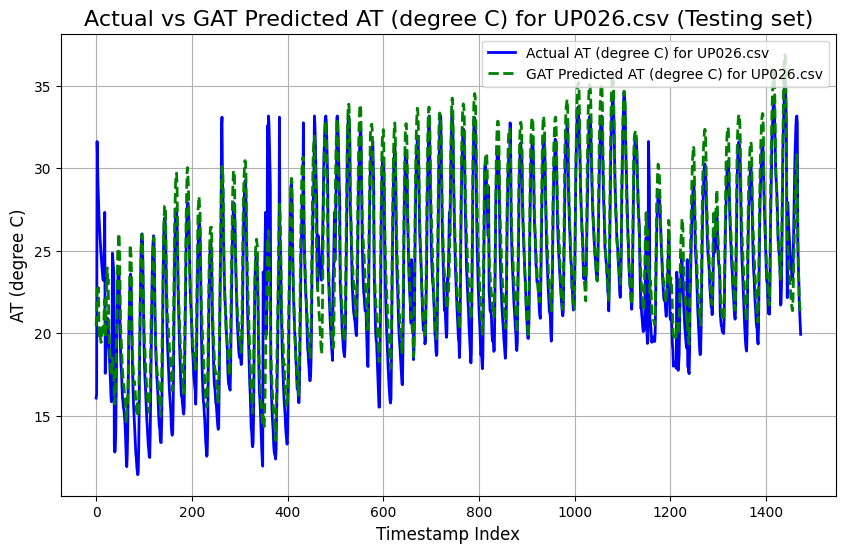

UP028.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2706
Mean Squared Error (MSE): 3.4033
Root Mean Squared Error (RMSE): 1.8448
Pearson Correlation Coefficient: 0.9730
R-squared (R²): 0.9416

----------------------------------------



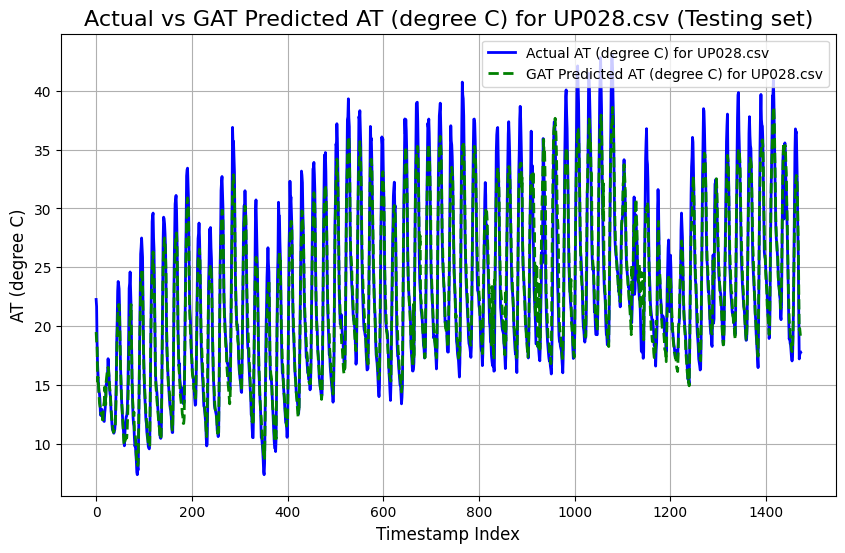

UP029.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.6939
Mean Squared Error (MSE): 0.9573
Root Mean Squared Error (RMSE): 0.9784
Pearson Correlation Coefficient: 0.9883
R-squared (R²): 0.9742

----------------------------------------



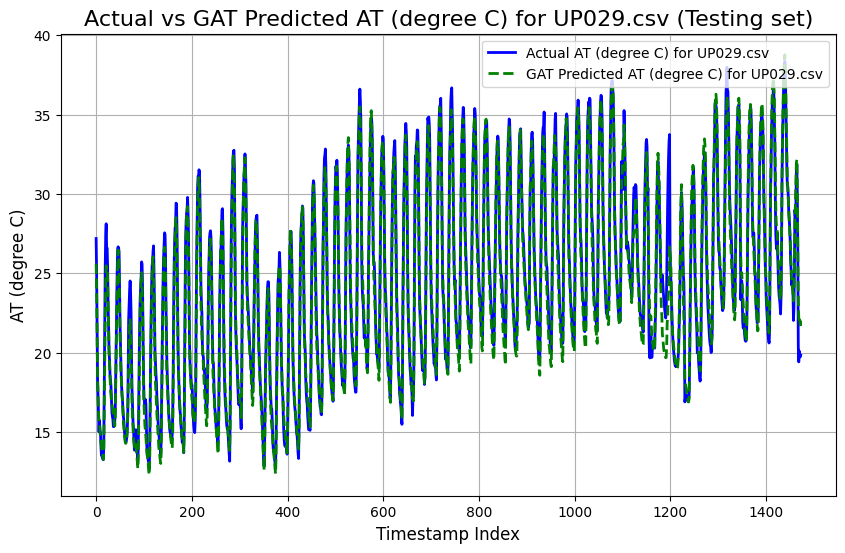

UP030.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0223
Mean Squared Error (MSE): 2.1786
Root Mean Squared Error (RMSE): 1.4760
Pearson Correlation Coefficient: 0.9757
R-squared (R²): 0.9507

----------------------------------------



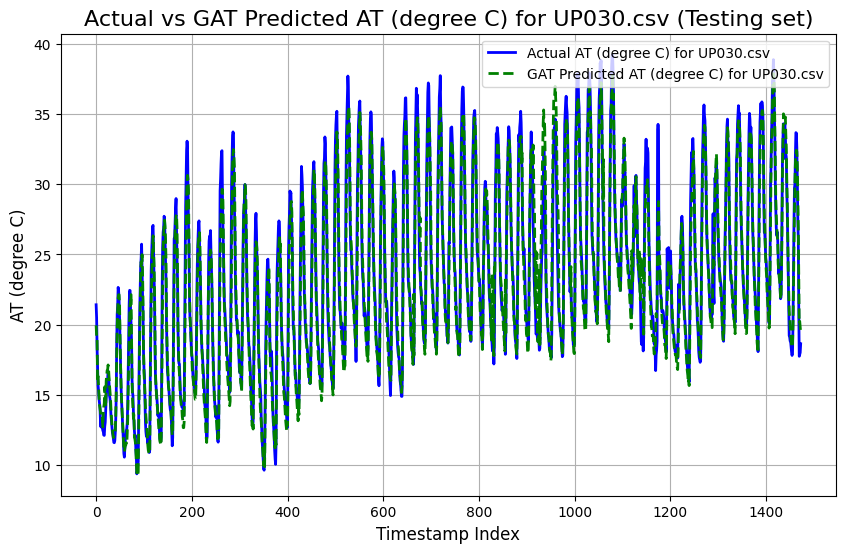

UP031.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4521
Mean Squared Error (MSE): 3.5285
Root Mean Squared Error (RMSE): 1.8784
Pearson Correlation Coefficient: 0.9649
R-squared (R²): 0.9277

----------------------------------------



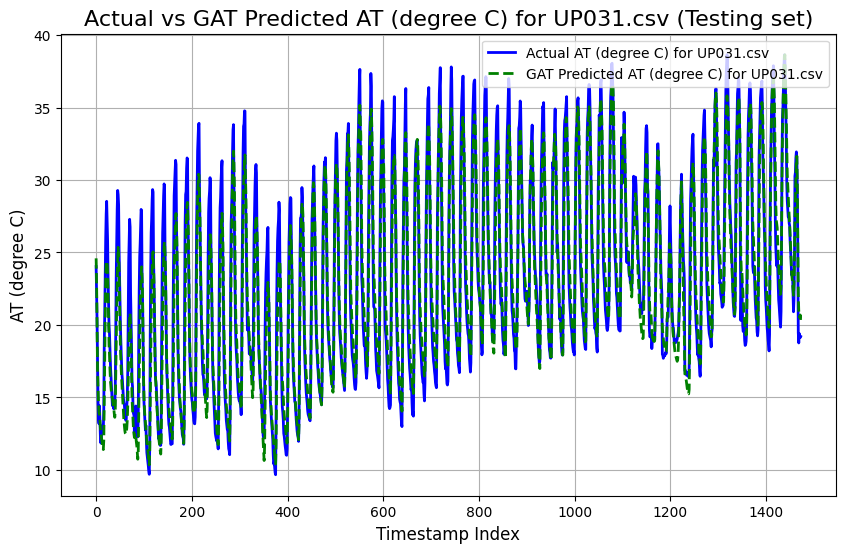

UP032.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1128
Mean Squared Error (MSE): 2.0172
Root Mean Squared Error (RMSE): 1.4203
Pearson Correlation Coefficient: 0.9704
R-squared (R²): 0.9412

----------------------------------------



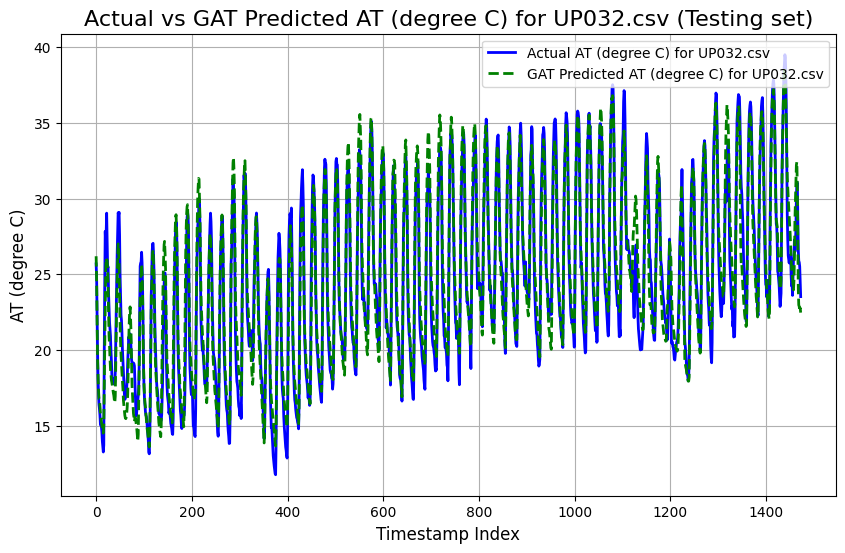

UP033.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7048
Mean Squared Error (MSE): 0.8182
Root Mean Squared Error (RMSE): 0.9046
Pearson Correlation Coefficient: 0.9905
R-squared (R²): 0.9776

----------------------------------------



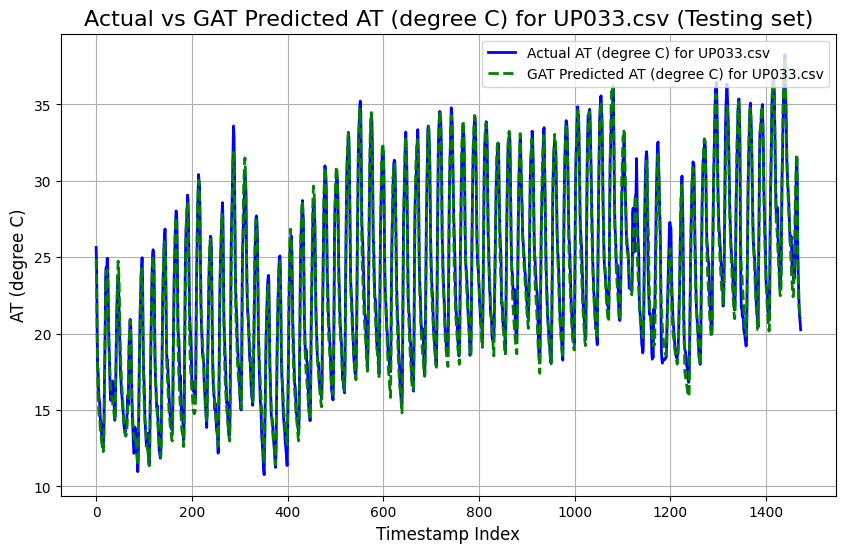

UP034.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 4.1600
Mean Squared Error (MSE): 26.7687
Root Mean Squared Error (RMSE): 5.1738
Pearson Correlation Coefficient: 0.8845
R-squared (R²): -0.1865

----------------------------------------



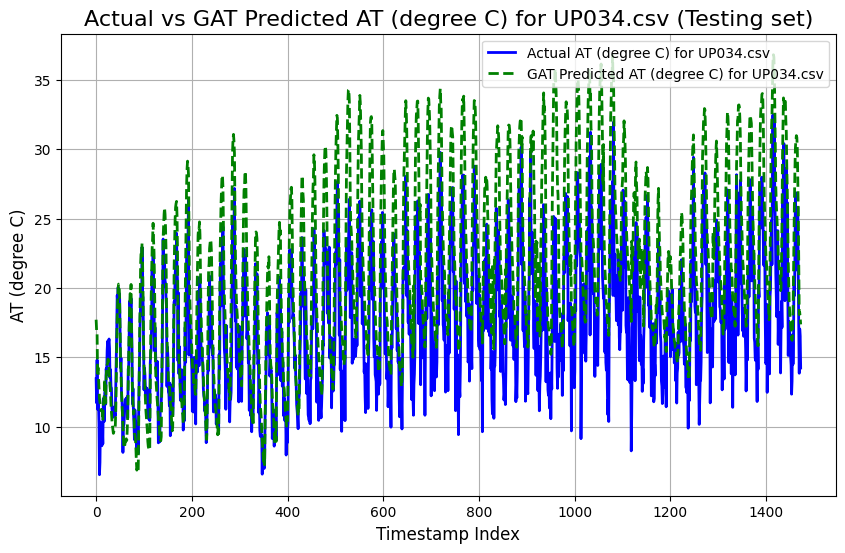

UP035.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0326
Mean Squared Error (MSE): 1.8313
Root Mean Squared Error (RMSE): 1.3533
Pearson Correlation Coefficient: 0.9776
R-squared (R²): 0.9533

----------------------------------------



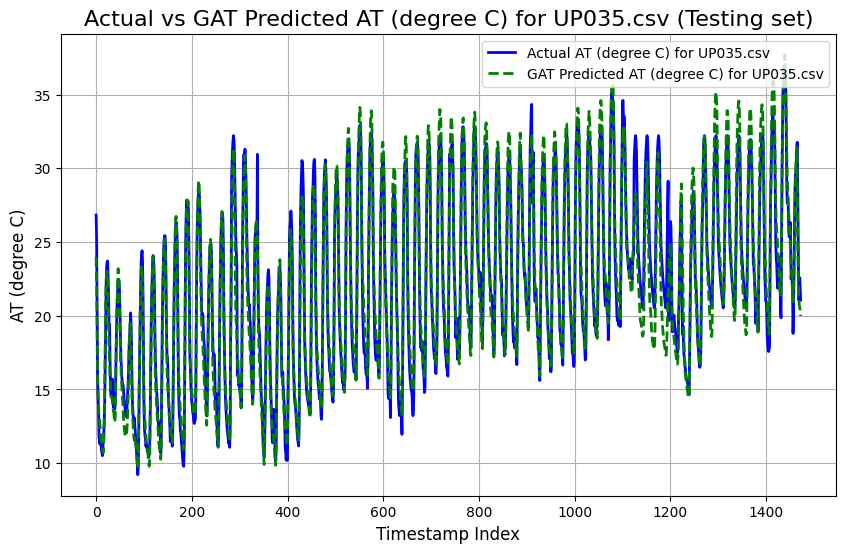

UP036.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1252
Mean Squared Error (MSE): 2.5112
Root Mean Squared Error (RMSE): 1.5847
Pearson Correlation Coefficient: 0.9682
R-squared (R²): 0.9253

----------------------------------------



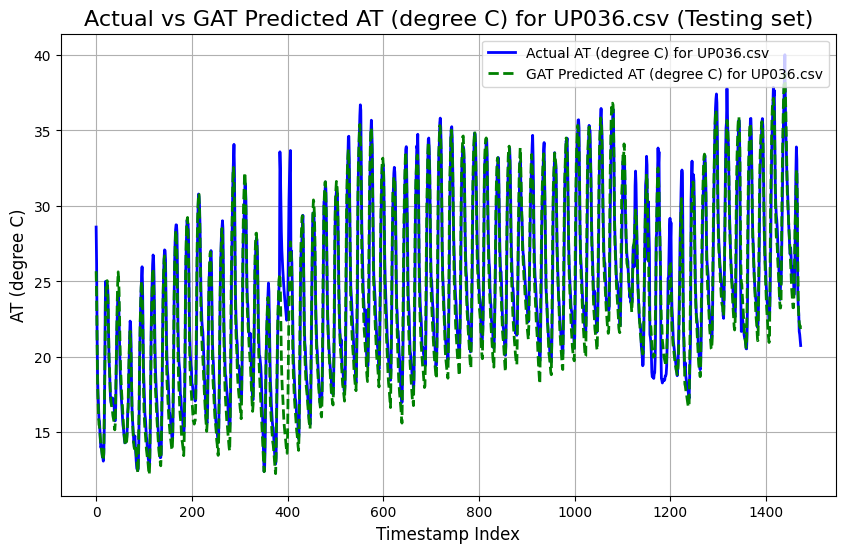

UP037.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1100
Mean Squared Error (MSE): 2.5414
Root Mean Squared Error (RMSE): 1.5942
Pearson Correlation Coefficient: 0.9677
R-squared (R²): 0.9356

----------------------------------------



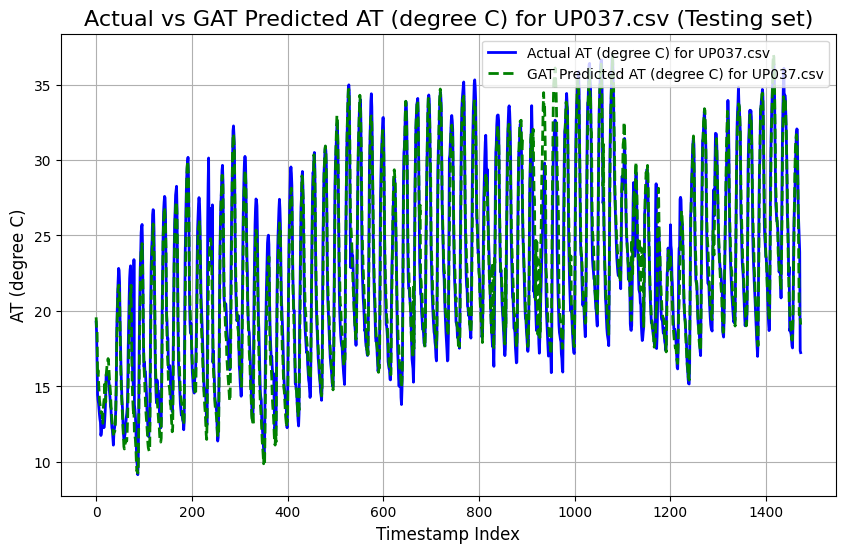

UP038.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8220
Mean Squared Error (MSE): 1.0111
Root Mean Squared Error (RMSE): 1.0055
Pearson Correlation Coefficient: 0.9893
R-squared (R²): 0.9691

----------------------------------------



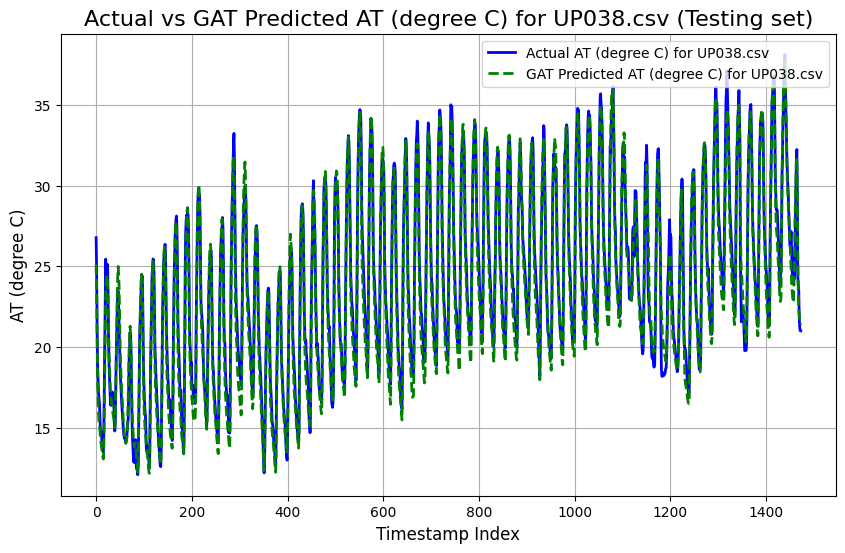

UP039.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4394
Mean Squared Error (MSE): 3.2730
Root Mean Squared Error (RMSE): 1.8091
Pearson Correlation Coefficient: 0.9712
R-squared (R²): 0.9368

----------------------------------------



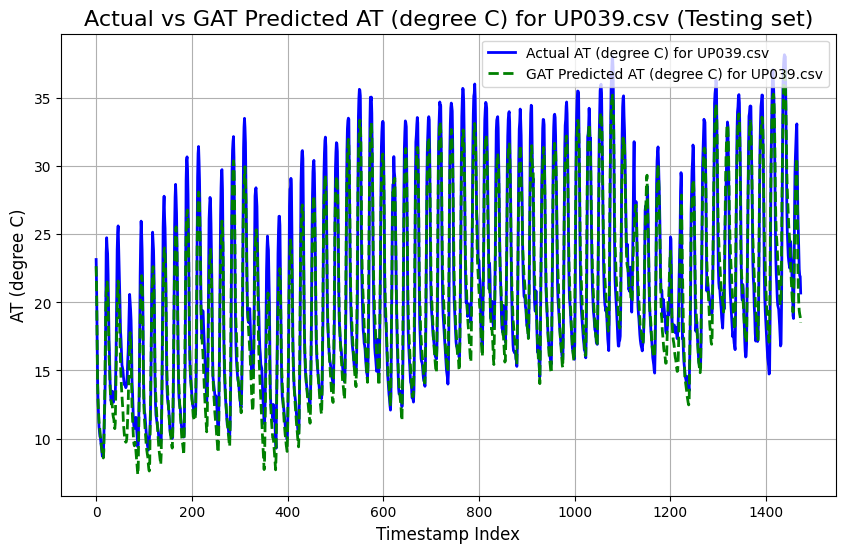

UP040.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1362
Mean Squared Error (MSE): 1.9792
Root Mean Squared Error (RMSE): 1.4069
Pearson Correlation Coefficient: 0.9784
R-squared (R²): 0.9533

----------------------------------------



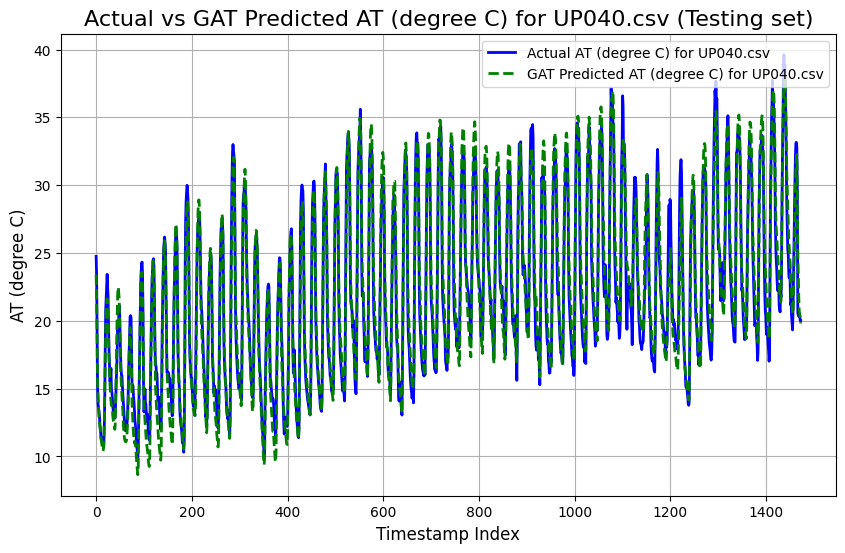

UP041.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1291
Mean Squared Error (MSE): 2.0140
Root Mean Squared Error (RMSE): 1.4191
Pearson Correlation Coefficient: 0.9782
R-squared (R²): 0.9409

----------------------------------------



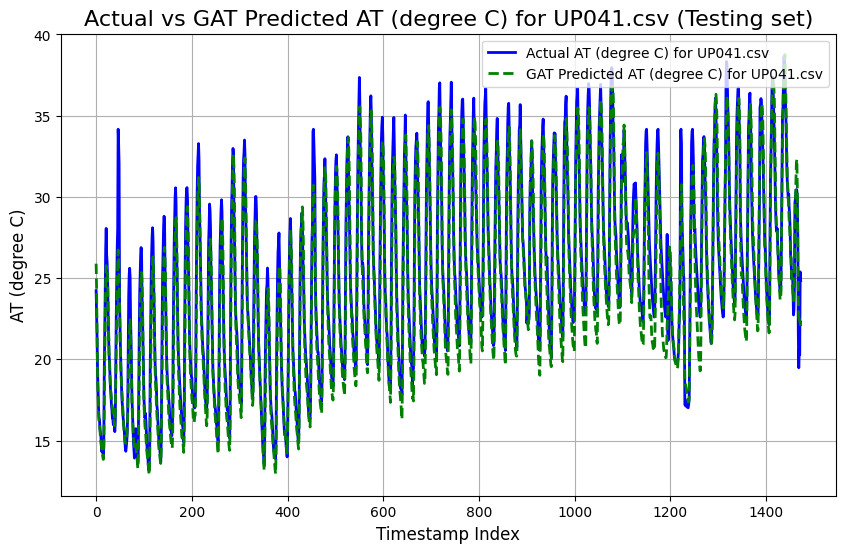

UP042.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2876
Mean Squared Error (MSE): 3.2198
Root Mean Squared Error (RMSE): 1.7944
Pearson Correlation Coefficient: 0.9586
R-squared (R²): 0.8989

----------------------------------------



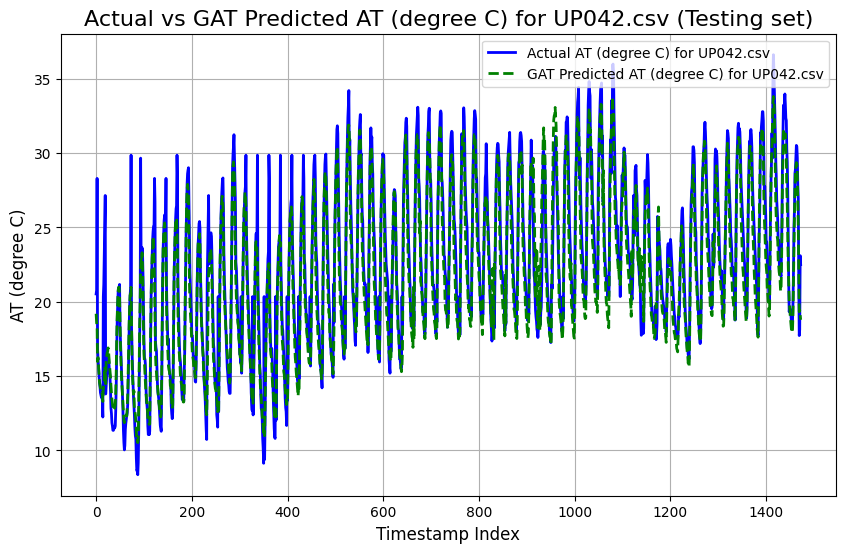

UP043.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.8200
Mean Squared Error (MSE): 4.6888
Root Mean Squared Error (RMSE): 2.1654
Pearson Correlation Coefficient: 0.9788
R-squared (R²): 0.8718

----------------------------------------



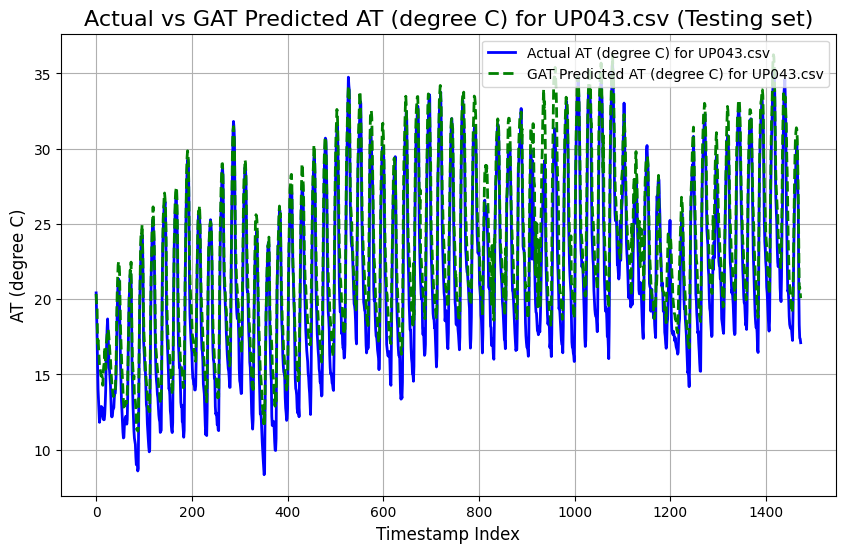

UP044.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8954
Mean Squared Error (MSE): 1.4942
Root Mean Squared Error (RMSE): 1.2224
Pearson Correlation Coefficient: 0.9864
R-squared (R²): 0.9664

----------------------------------------



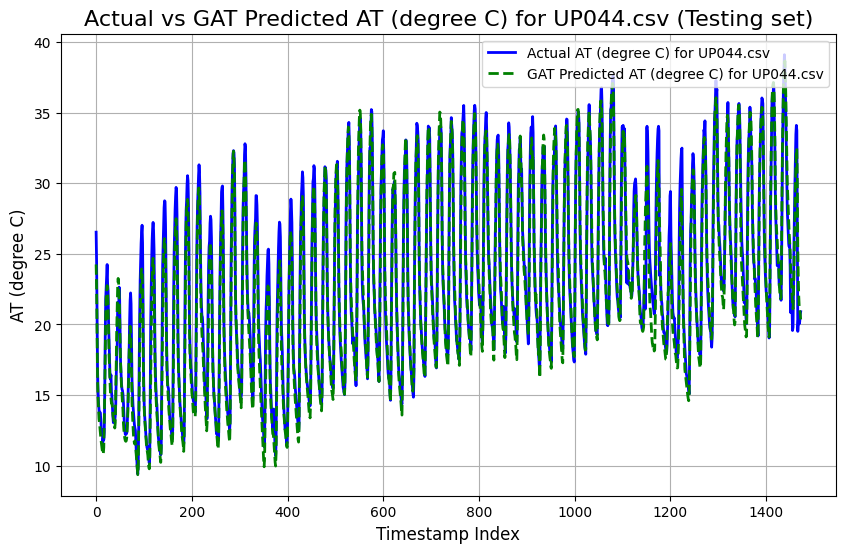

UP046.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2269
Mean Squared Error (MSE): 2.6222
Root Mean Squared Error (RMSE): 1.6193
Pearson Correlation Coefficient: 0.9716
R-squared (R²): 0.9268

----------------------------------------



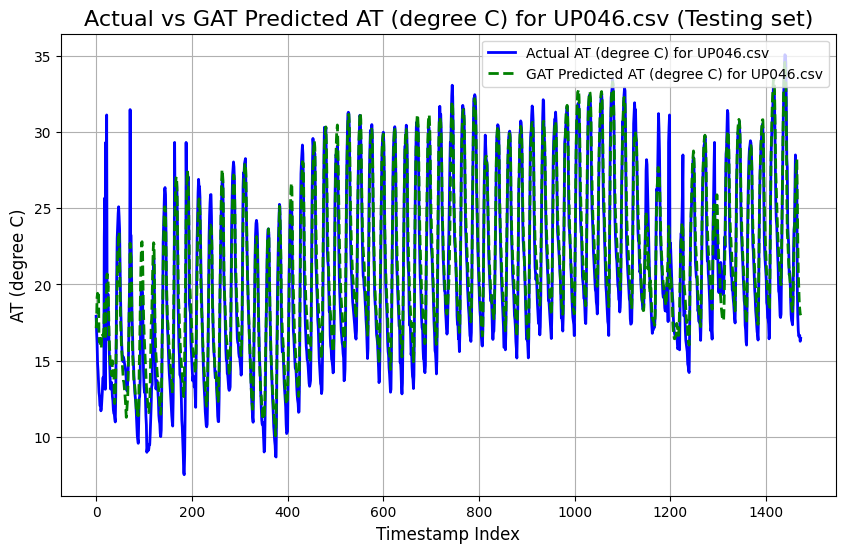

UP048.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4269
Mean Squared Error (MSE): 3.5539
Root Mean Squared Error (RMSE): 1.8852
Pearson Correlation Coefficient: 0.9617
R-squared (R²): 0.9036

----------------------------------------



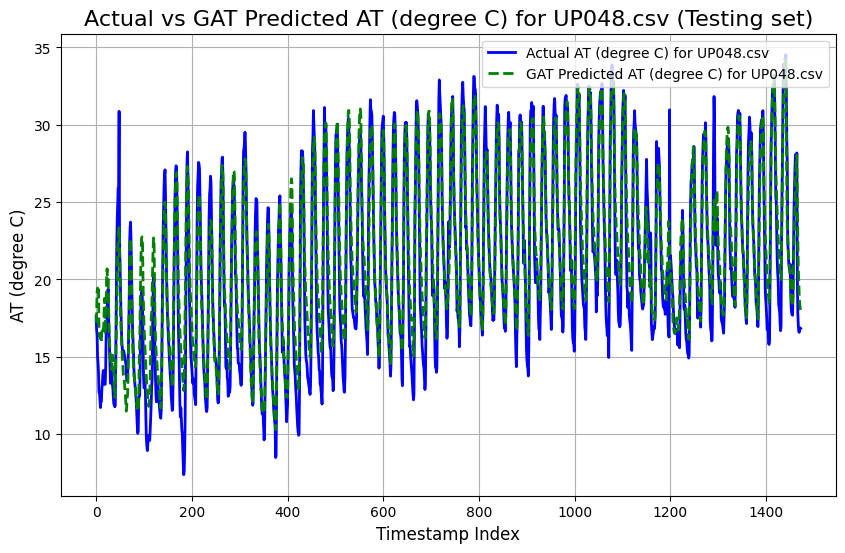

UP049.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3677
Mean Squared Error (MSE): 3.1614
Root Mean Squared Error (RMSE): 1.7780
Pearson Correlation Coefficient: 0.9582
R-squared (R²): 0.9007

----------------------------------------



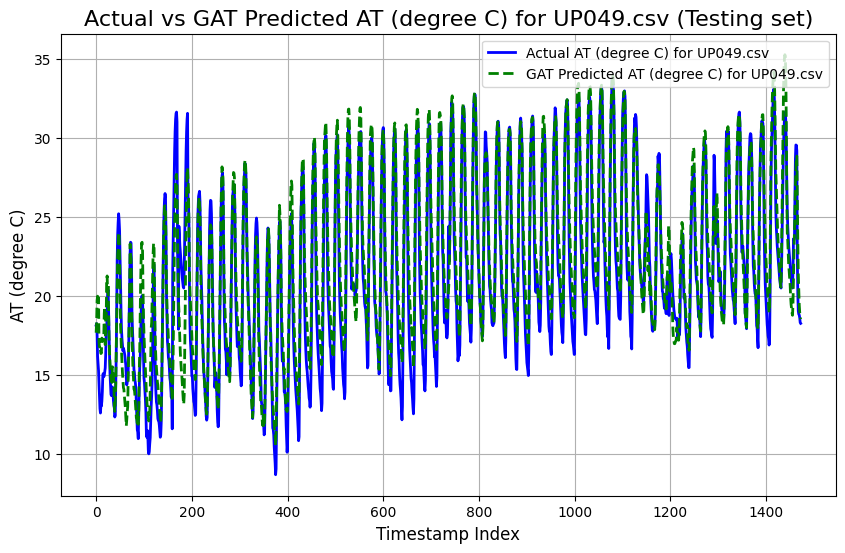

UP050.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 2.7407
Mean Squared Error (MSE): 11.1361
Root Mean Squared Error (RMSE): 3.3371
Pearson Correlation Coefficient: 0.7738
R-squared (R²): 0.5687

----------------------------------------



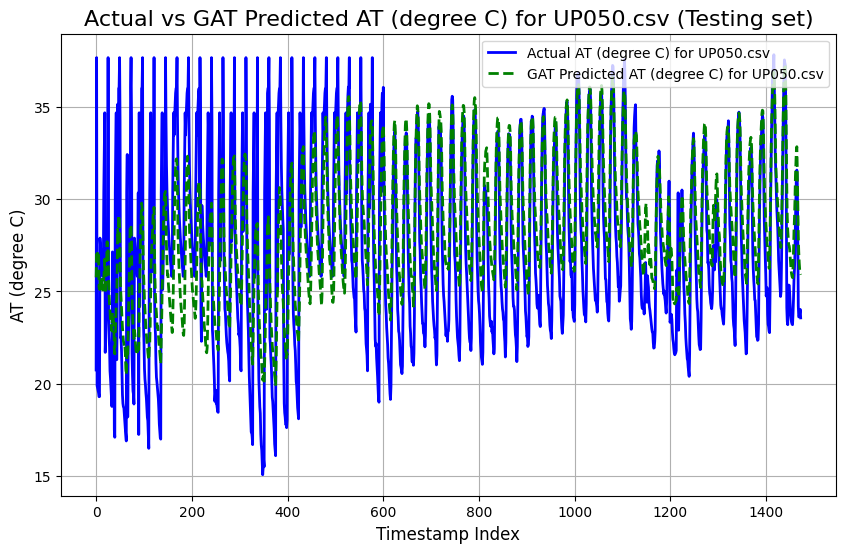

UP051.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.2259
Mean Squared Error (MSE): 43.2946
Root Mean Squared Error (RMSE): 6.5799
Pearson Correlation Coefficient: 0.6110
R-squared (R²): 0.3197

----------------------------------------



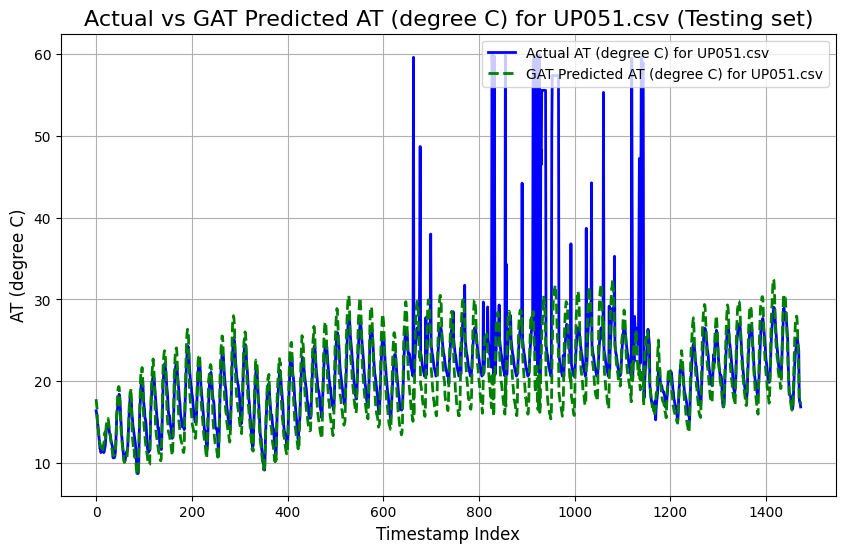

UP052.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.5987
Mean Squared Error (MSE): 4.1654
Root Mean Squared Error (RMSE): 2.0409
Pearson Correlation Coefficient: 0.9602
R-squared (R²): 0.8867

----------------------------------------



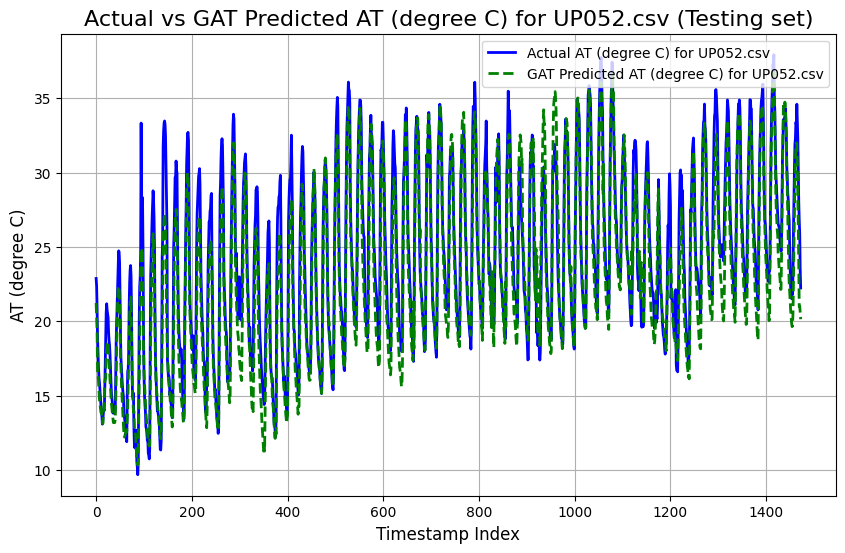

Train GNN Imputed HourMean.csv
CSV file 'Train GNN Imputed HourMean.csv' created successfully.
Test GNN Imputed HourMean.csv
CSV file 'Test GNN Imputed HourMean.csv' created successfully.
UP002.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2632
Mean Squared Error (MSE): 3.1029
Root Mean Squared Error (RMSE): 1.7615
Pearson Correlation Coefficient: 0.9745
R-squared (R²): 0.9438

----------------------------------------



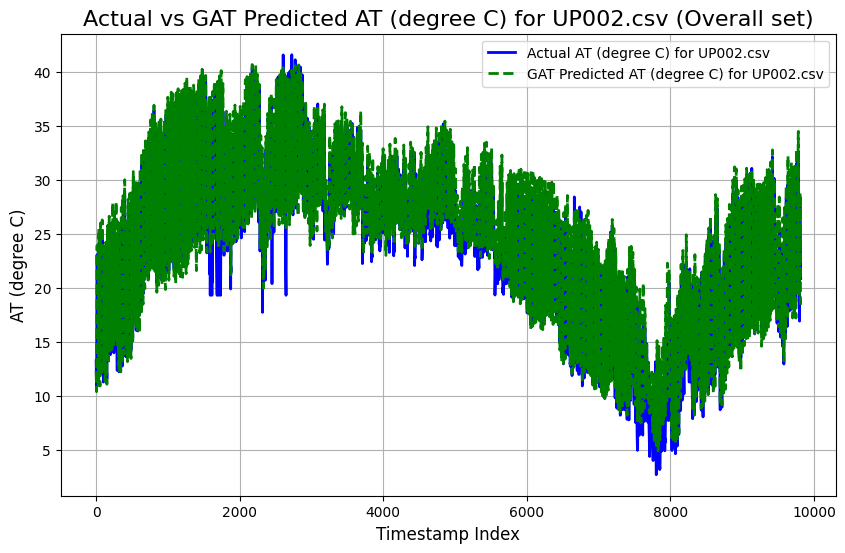

UP003.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3243
Mean Squared Error (MSE): 2.9524
Root Mean Squared Error (RMSE): 1.7183
Pearson Correlation Coefficient: 0.9821
R-squared (R²): 0.9591

----------------------------------------



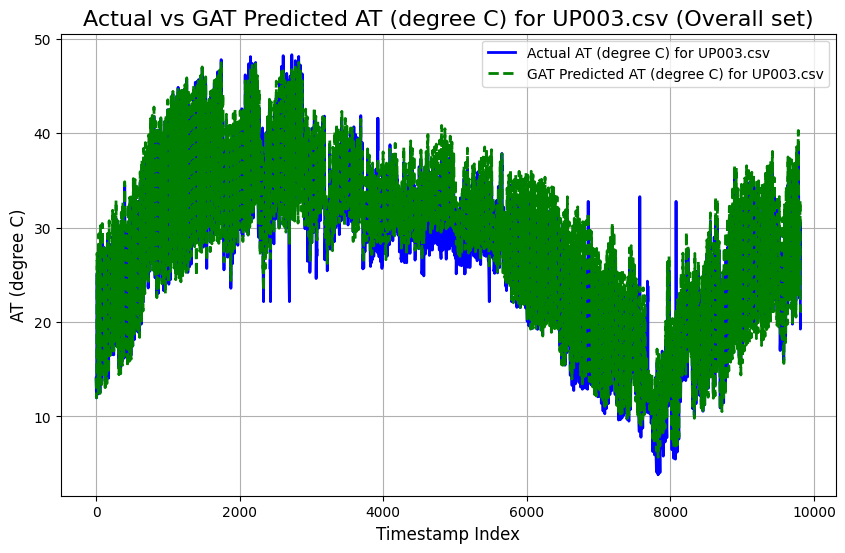

UP004.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5547
Mean Squared Error (MSE): 3.9020
Root Mean Squared Error (RMSE): 1.9754
Pearson Correlation Coefficient: 0.9773
R-squared (R²): 0.9504

----------------------------------------



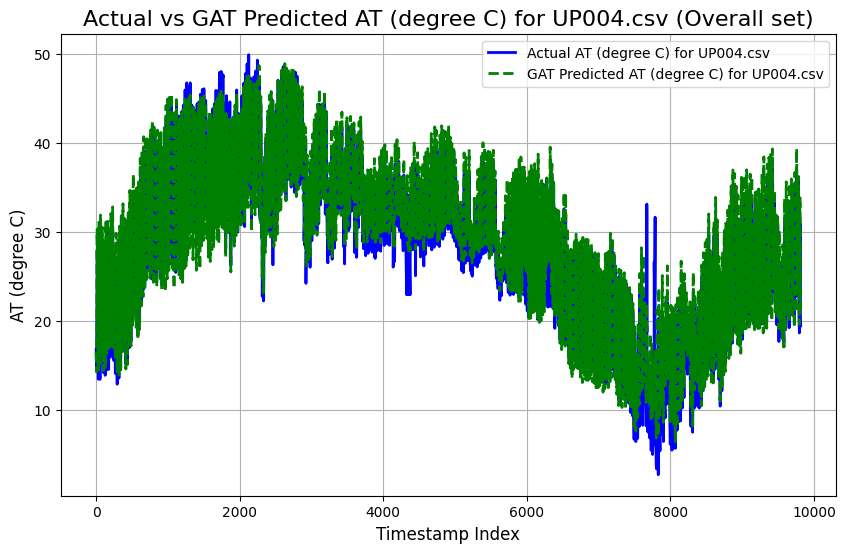

UP008.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 5.5323
Mean Squared Error (MSE): 59.3408
Root Mean Squared Error (RMSE): 7.7033
Pearson Correlation Coefficient: 0.7488
R-squared (R²): 0.5088

----------------------------------------



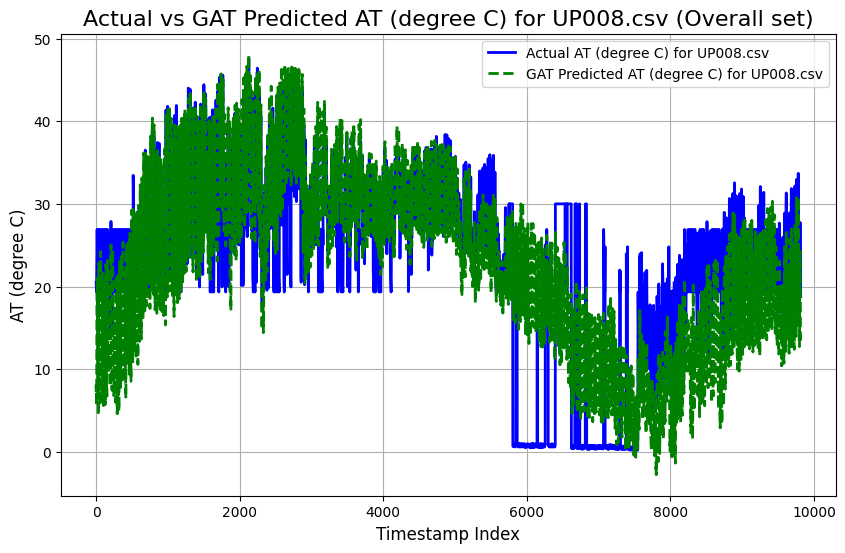

UP009.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2856
Mean Squared Error (MSE): 3.2020
Root Mean Squared Error (RMSE): 1.7894
Pearson Correlation Coefficient: 0.9736
R-squared (R²): 0.9430

----------------------------------------



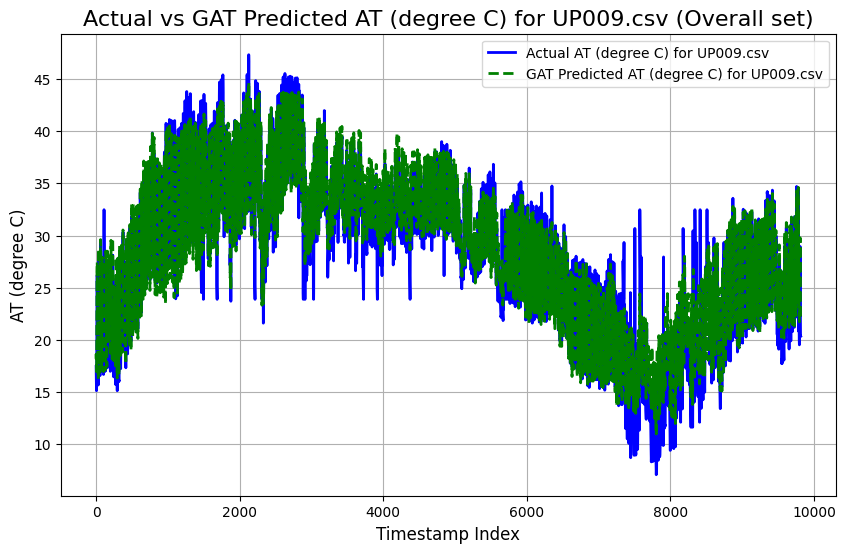

UP012.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.7402
Mean Squared Error (MSE): 7.6908
Root Mean Squared Error (RMSE): 2.7732
Pearson Correlation Coefficient: 0.9625
R-squared (R²): 0.9233

----------------------------------------



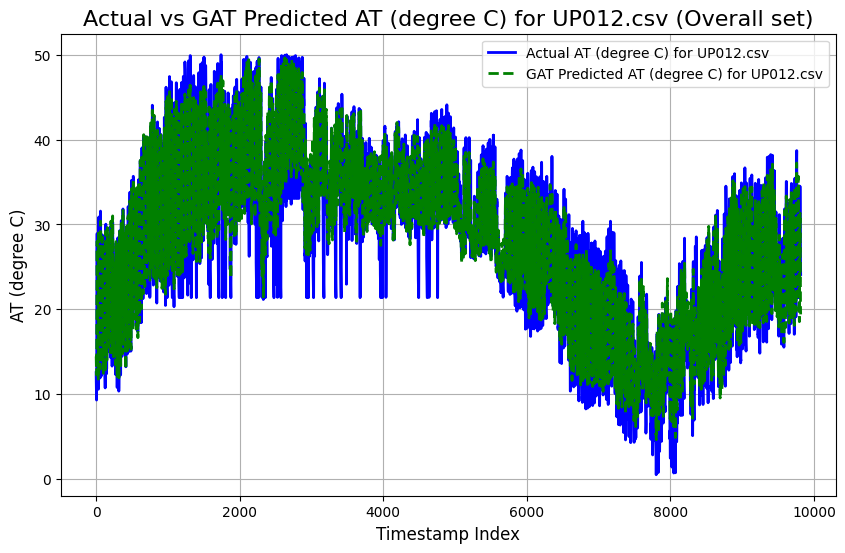

UP014.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.6119
Mean Squared Error (MSE): 19.5813
Root Mean Squared Error (RMSE): 4.4251
Pearson Correlation Coefficient: 0.9179
R-squared (R²): 0.8366

----------------------------------------



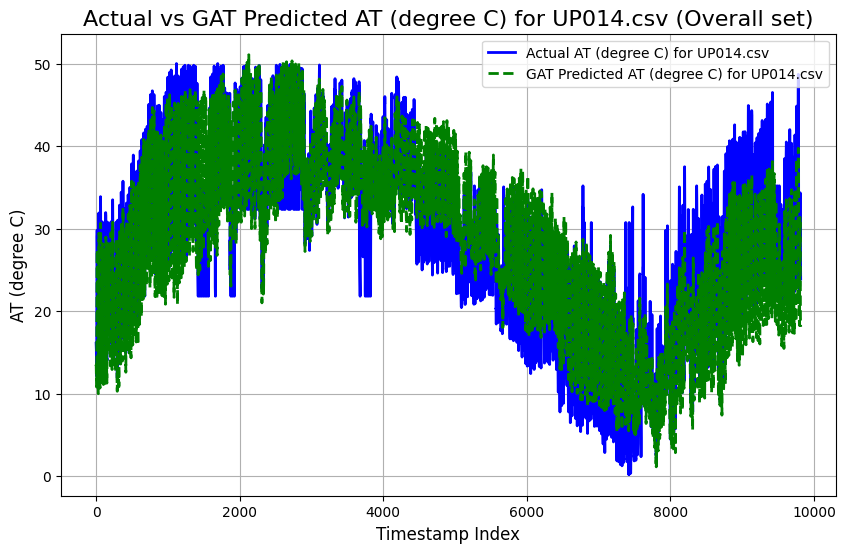

UP016.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.5011
Mean Squared Error (MSE): 20.5876
Root Mean Squared Error (RMSE): 4.5374
Pearson Correlation Coefficient: 0.9134
R-squared (R²): 0.8285

----------------------------------------



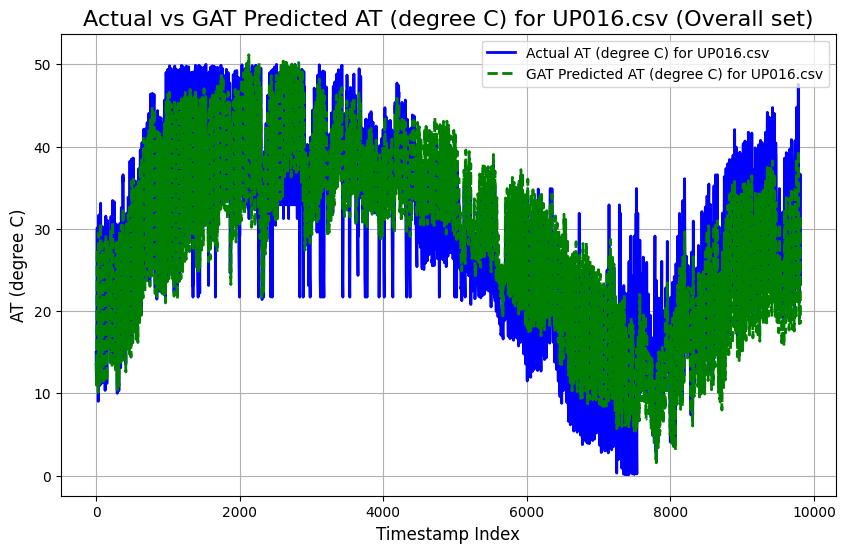

UP017.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.8909
Mean Squared Error (MSE): 1.2264
Root Mean Squared Error (RMSE): 1.1074
Pearson Correlation Coefficient: 0.9827
R-squared (R²): 0.9604

----------------------------------------



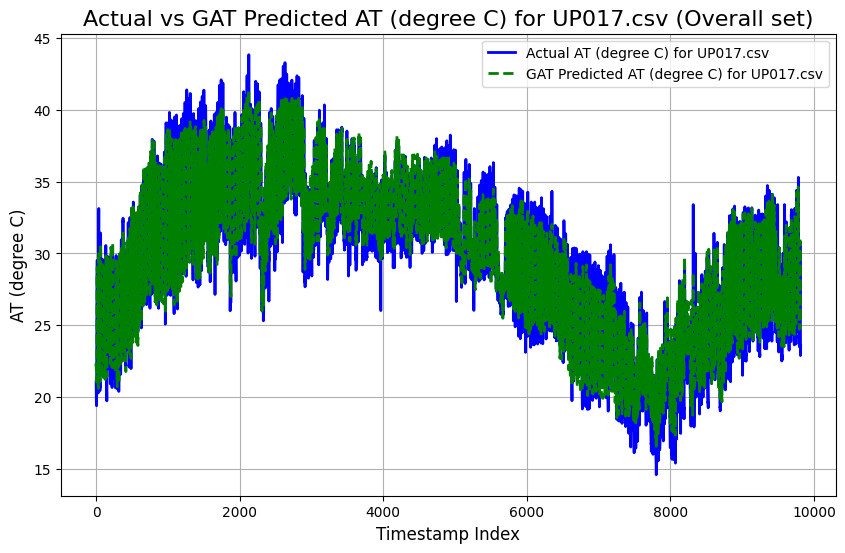

UP018.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 4.8909
Mean Squared Error (MSE): 49.5384
Root Mean Squared Error (RMSE): 7.0384
Pearson Correlation Coefficient: 0.4484
R-squared (R²): 0.0236

----------------------------------------



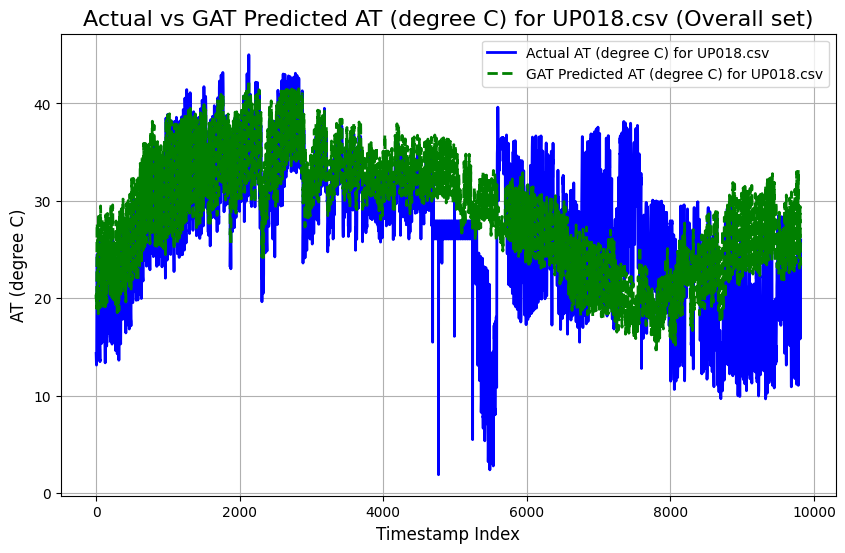

UP019.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.7761
Mean Squared Error (MSE): 6.0310
Root Mean Squared Error (RMSE): 2.4558
Pearson Correlation Coefficient: 0.9049
R-squared (R²): 0.8149

----------------------------------------



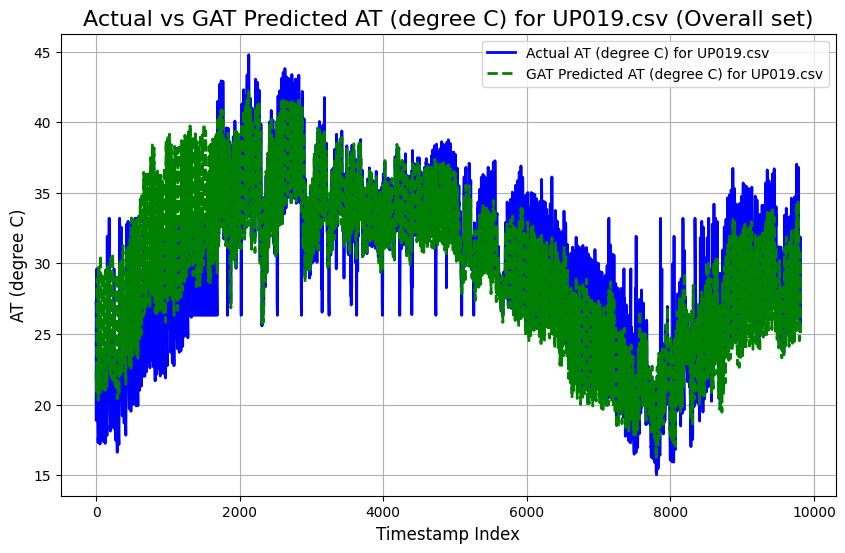

UP020.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2762
Mean Squared Error (MSE): 2.6953
Root Mean Squared Error (RMSE): 1.6417
Pearson Correlation Coefficient: 0.9776
R-squared (R²): 0.9496

----------------------------------------



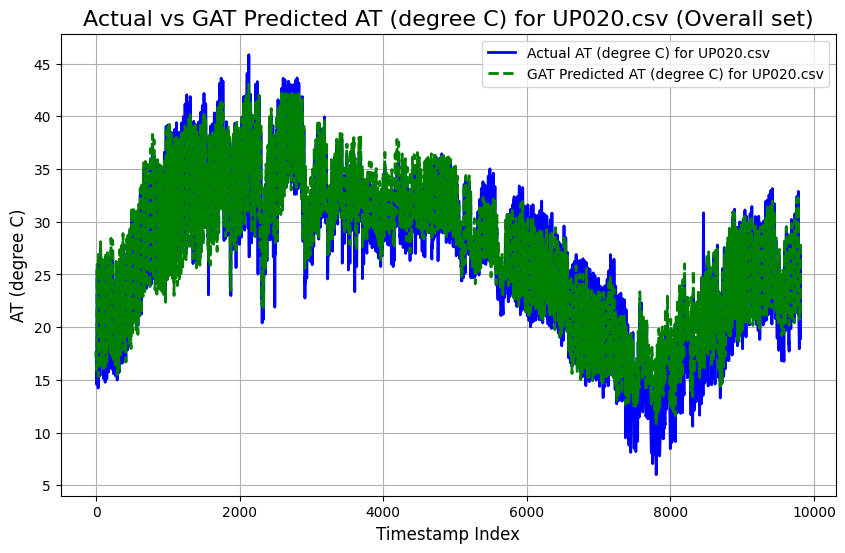

UP021.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.5232
Mean Squared Error (MSE): 21.7401
Root Mean Squared Error (RMSE): 4.6626
Pearson Correlation Coefficient: 0.8372
R-squared (R²): 0.6844

----------------------------------------



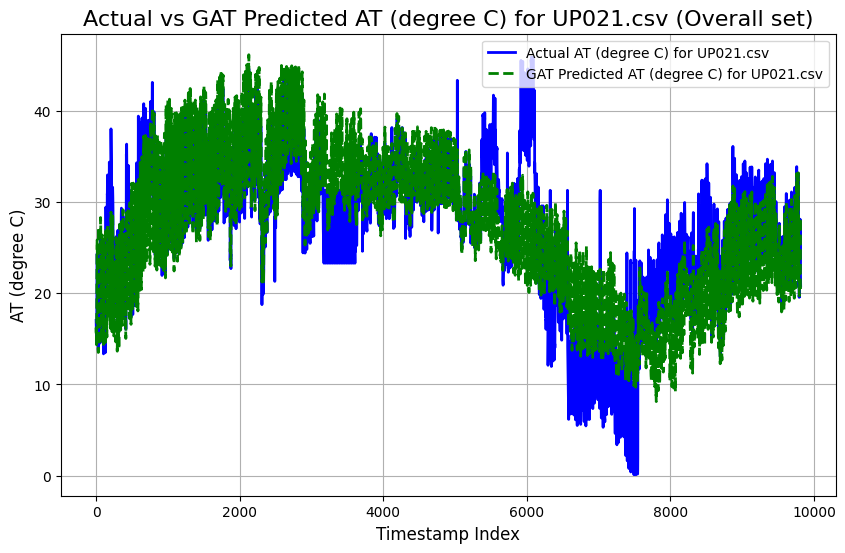

UP022.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2806
Mean Squared Error (MSE): 2.9860
Root Mean Squared Error (RMSE): 1.7280
Pearson Correlation Coefficient: 0.9749
R-squared (R²): 0.9442

----------------------------------------



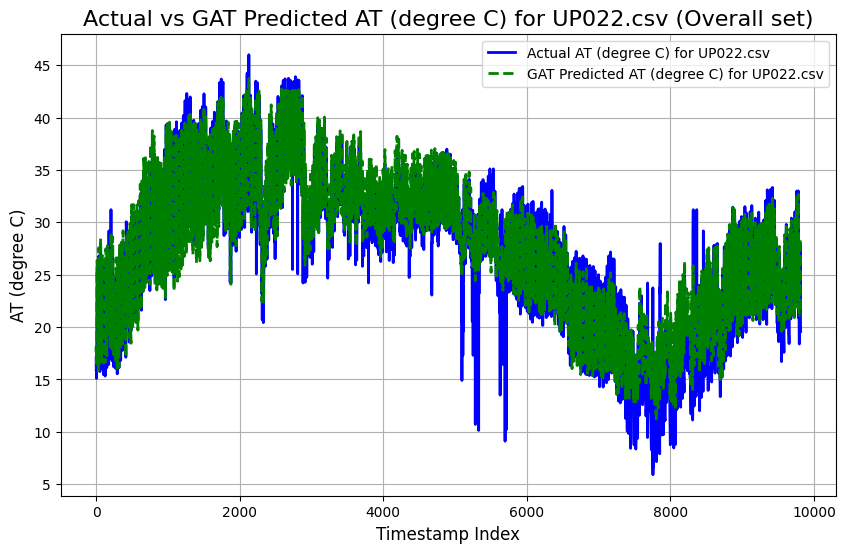

UP023.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.9546
Mean Squared Error (MSE): 7.9520
Root Mean Squared Error (RMSE): 2.8199
Pearson Correlation Coefficient: 0.9175
R-squared (R²): 0.8317

----------------------------------------



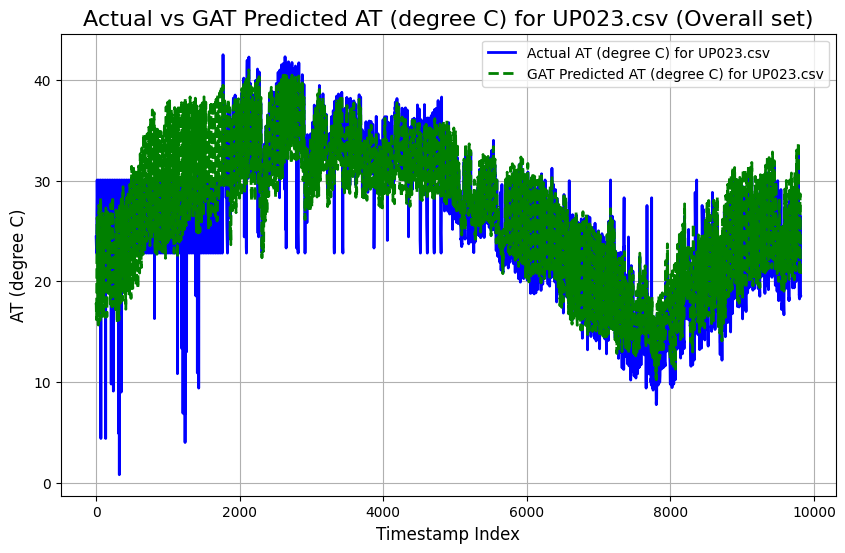

UP024.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.7737
Mean Squared Error (MSE): 13.8900
Root Mean Squared Error (RMSE): 3.7269
Pearson Correlation Coefficient: 0.8315
R-squared (R²): 0.6478

----------------------------------------



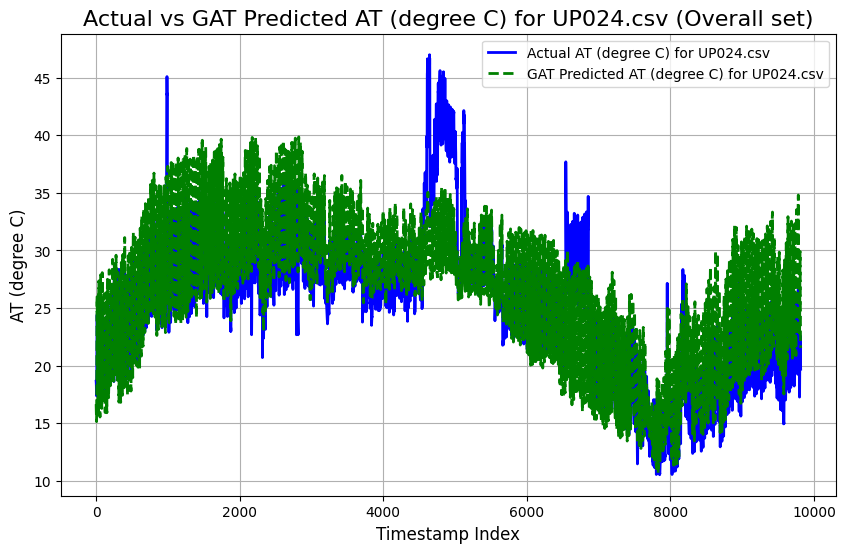

UP025.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1727
Mean Squared Error (MSE): 2.7072
Root Mean Squared Error (RMSE): 1.6454
Pearson Correlation Coefficient: 0.9783
R-squared (R²): 0.9515

----------------------------------------



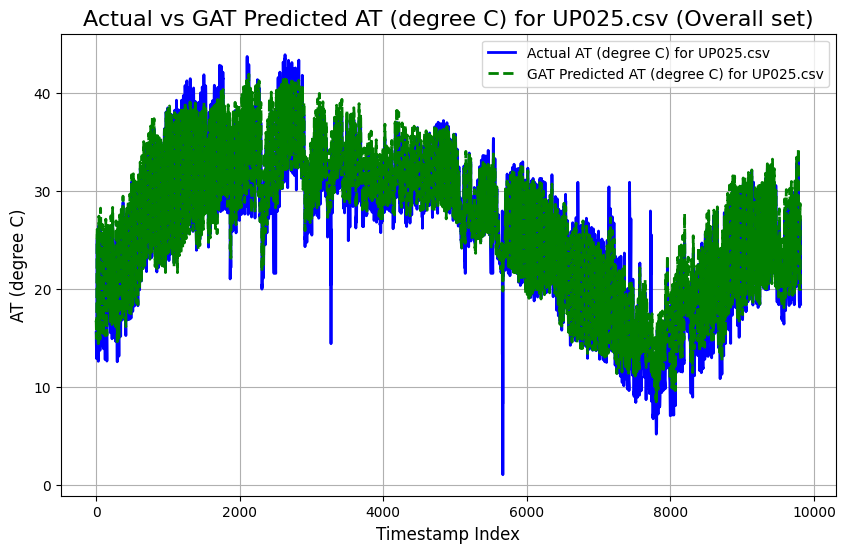

UP026.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2520
Mean Squared Error (MSE): 3.1470
Root Mean Squared Error (RMSE): 1.7740
Pearson Correlation Coefficient: 0.9784
R-squared (R²): 0.9514

----------------------------------------



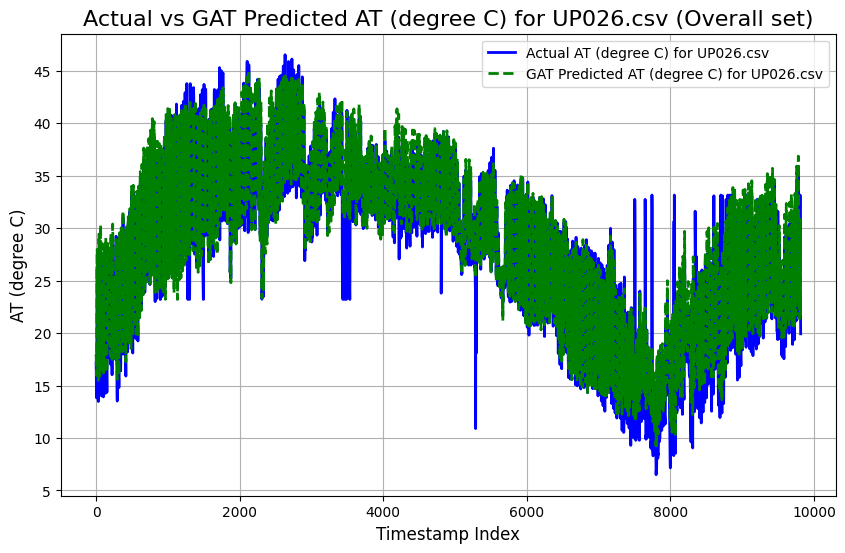

UP028.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.6594
Mean Squared Error (MSE): 4.6273
Root Mean Squared Error (RMSE): 2.1511
Pearson Correlation Coefficient: 0.9757
R-squared (R²): 0.9487

----------------------------------------



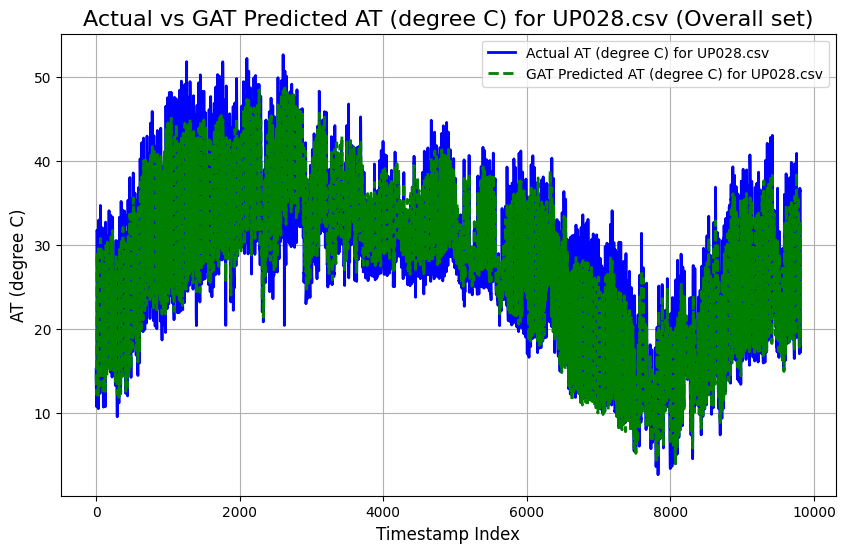

UP029.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0652
Mean Squared Error (MSE): 2.6568
Root Mean Squared Error (RMSE): 1.6300
Pearson Correlation Coefficient: 0.9791
R-squared (R²): 0.9540

----------------------------------------



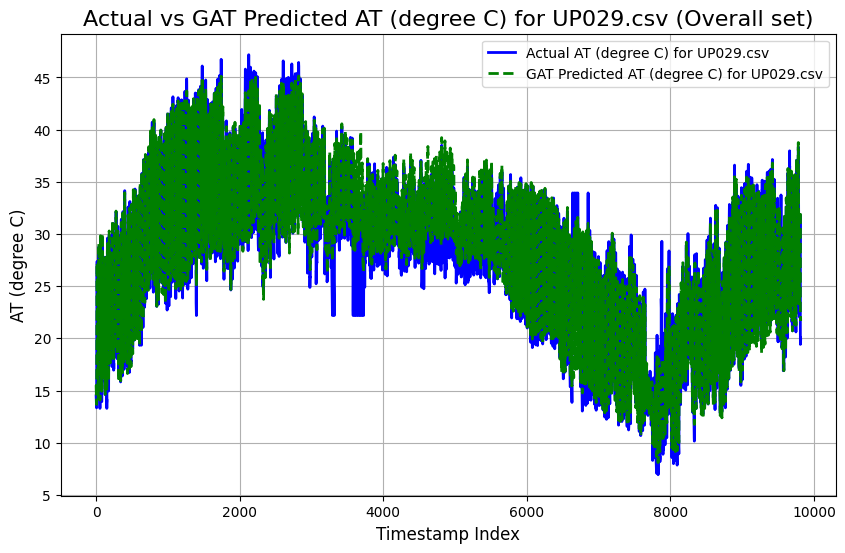

UP030.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2618
Mean Squared Error (MSE): 2.6998
Root Mean Squared Error (RMSE): 1.6431
Pearson Correlation Coefficient: 0.9842
R-squared (R²): 0.9654

----------------------------------------



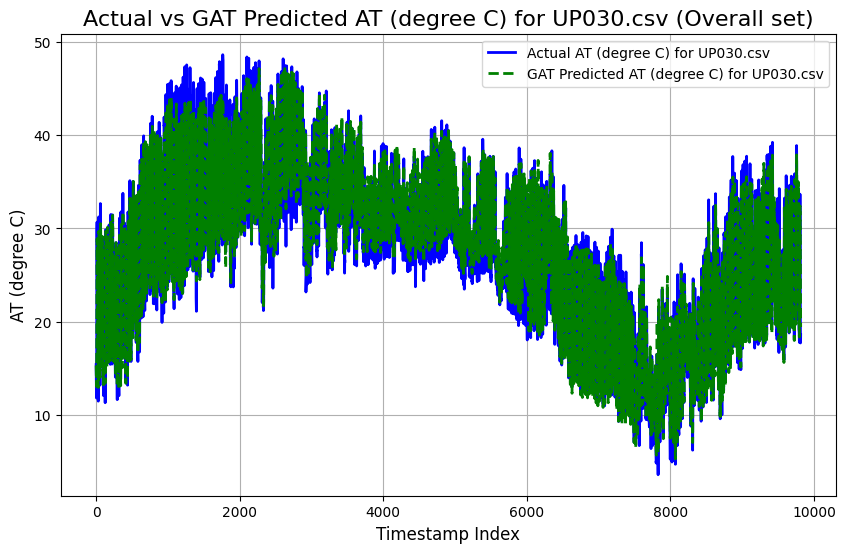

UP031.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5307
Mean Squared Error (MSE): 4.0993
Root Mean Squared Error (RMSE): 2.0247
Pearson Correlation Coefficient: 0.9714
R-squared (R²): 0.9390

----------------------------------------



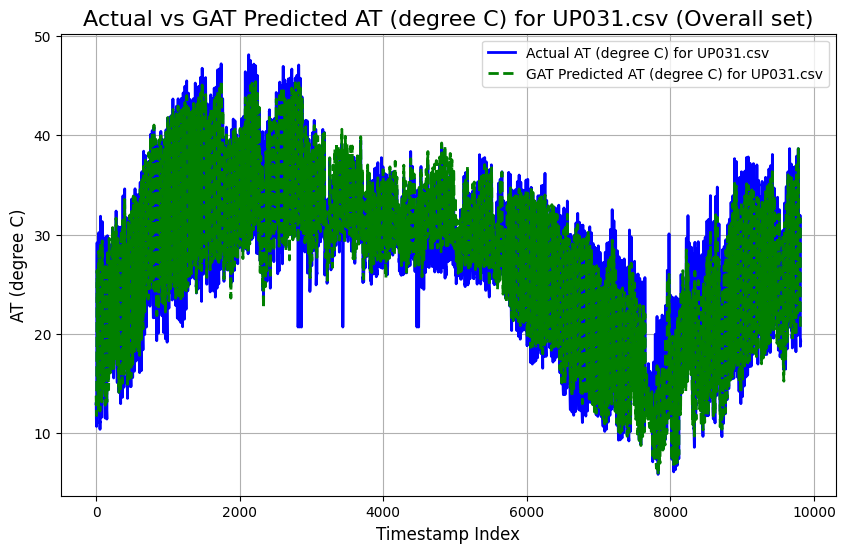

UP032.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3997
Mean Squared Error (MSE): 3.4913
Root Mean Squared Error (RMSE): 1.8685
Pearson Correlation Coefficient: 0.9692
R-squared (R²): 0.9333

----------------------------------------



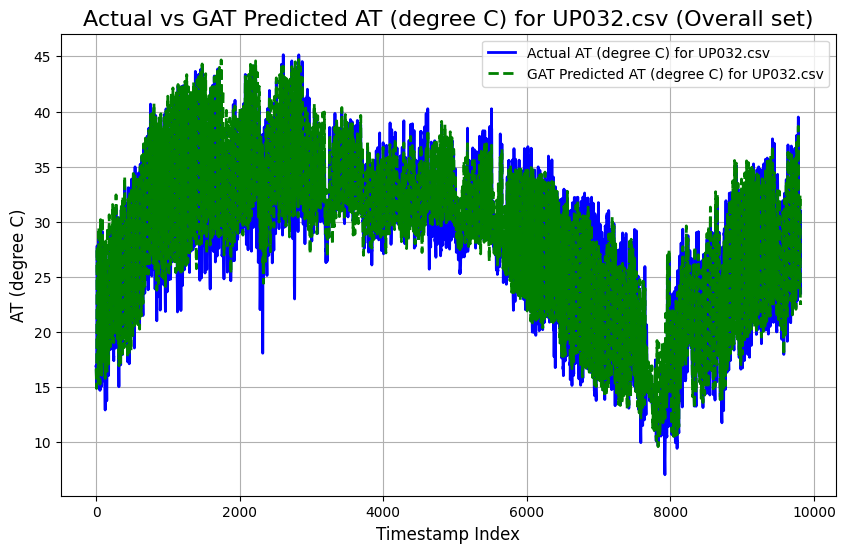

UP033.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9991
Mean Squared Error (MSE): 2.4827
Root Mean Squared Error (RMSE): 1.5757
Pearson Correlation Coefficient: 0.9815
R-squared (R²): 0.9590

----------------------------------------



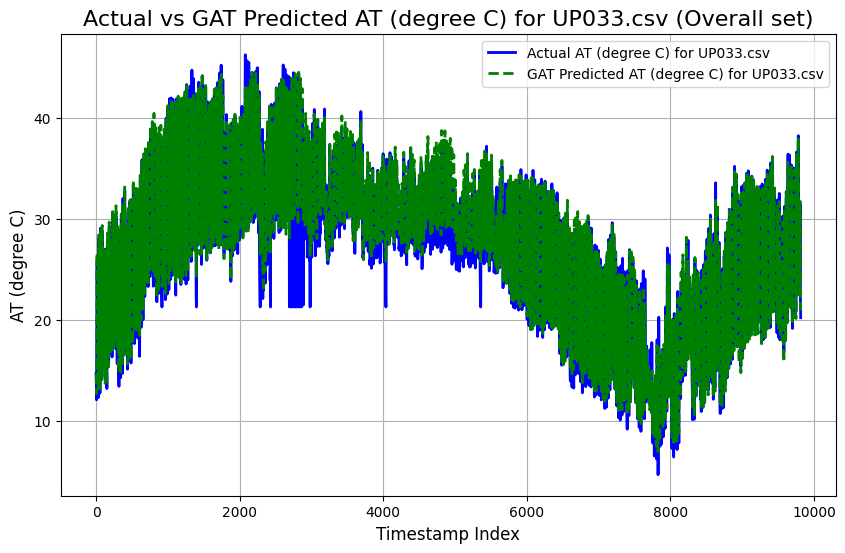

UP034.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.0061
Mean Squared Error (MSE): 8.8762
Root Mean Squared Error (RMSE): 2.9793
Pearson Correlation Coefficient: 0.9574
R-squared (R²): 0.9018

----------------------------------------



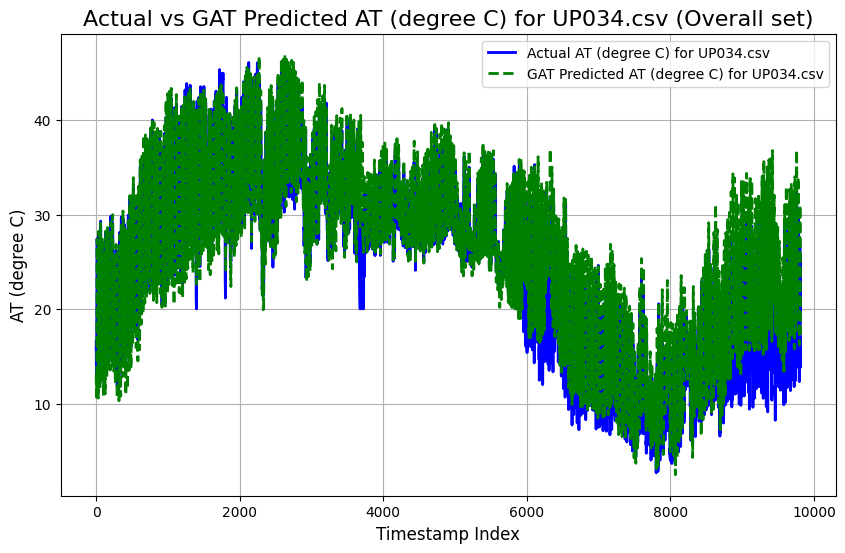

UP035.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1315
Mean Squared Error (MSE): 2.4913
Root Mean Squared Error (RMSE): 1.5784
Pearson Correlation Coefficient: 0.9837
R-squared (R²): 0.9629

----------------------------------------



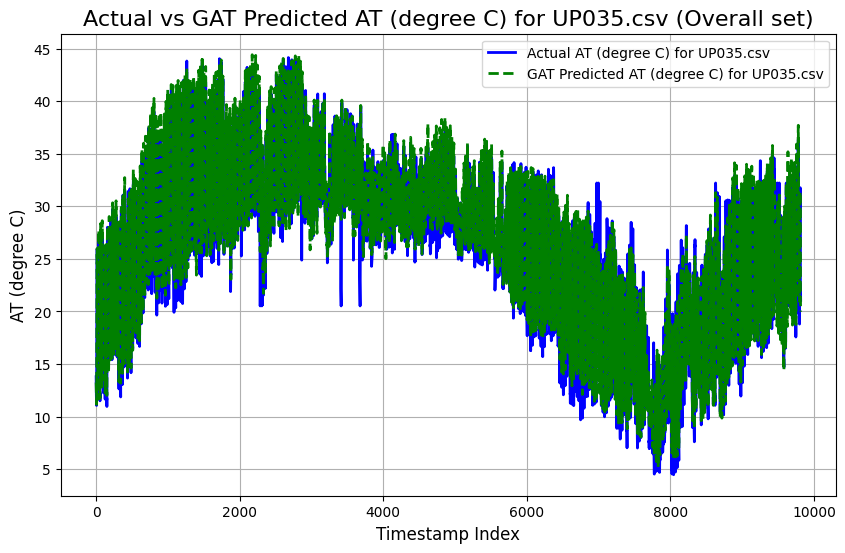

UP036.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1724
Mean Squared Error (MSE): 2.8844
Root Mean Squared Error (RMSE): 1.6984
Pearson Correlation Coefficient: 0.9777
R-squared (R²): 0.9510

----------------------------------------



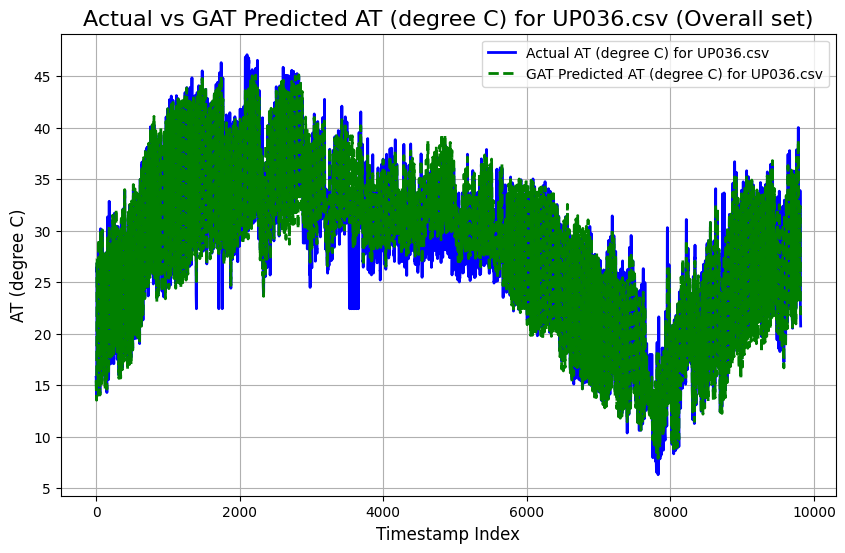

UP037.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3074
Mean Squared Error (MSE): 3.5459
Root Mean Squared Error (RMSE): 1.8830
Pearson Correlation Coefficient: 0.9775
R-squared (R²): 0.9517

----------------------------------------



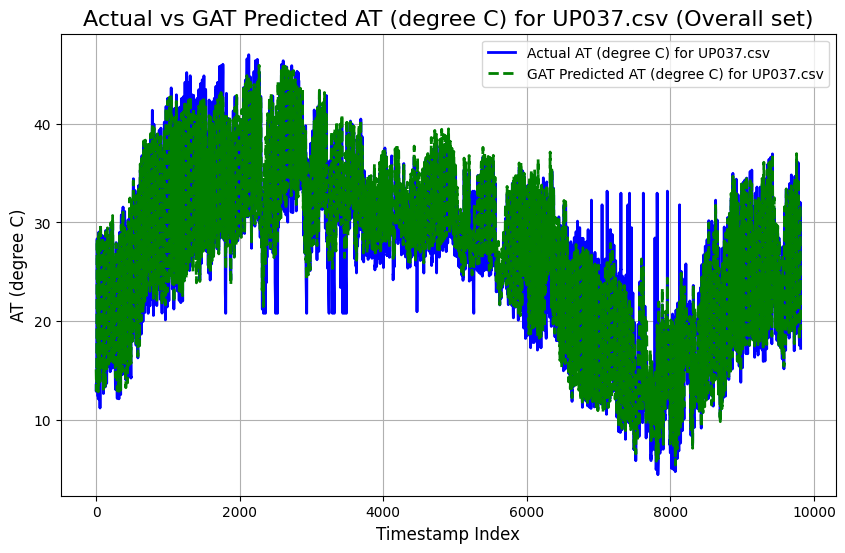

UP038.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1872
Mean Squared Error (MSE): 3.7675
Root Mean Squared Error (RMSE): 1.9410
Pearson Correlation Coefficient: 0.9680
R-squared (R²): 0.9316

----------------------------------------



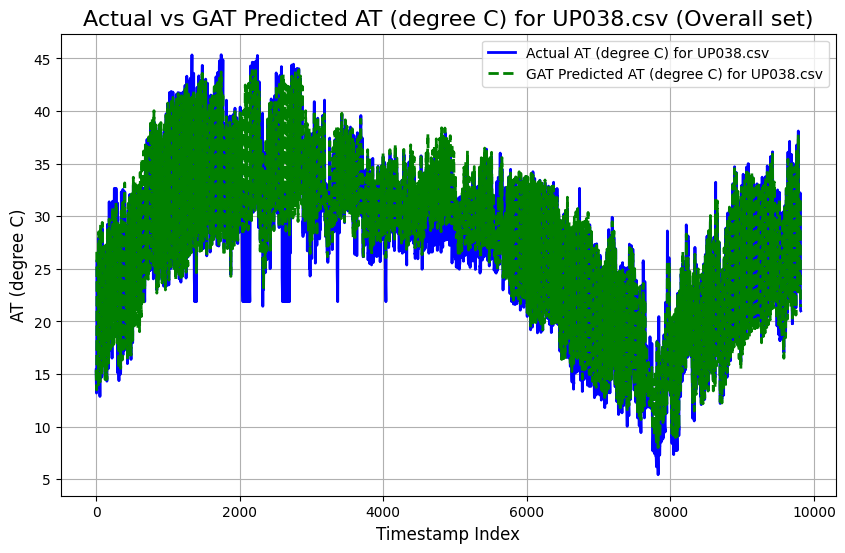

UP039.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.6603
Mean Squared Error (MSE): 5.0165
Root Mean Squared Error (RMSE): 2.2397
Pearson Correlation Coefficient: 0.9692
R-squared (R²): 0.9348

----------------------------------------



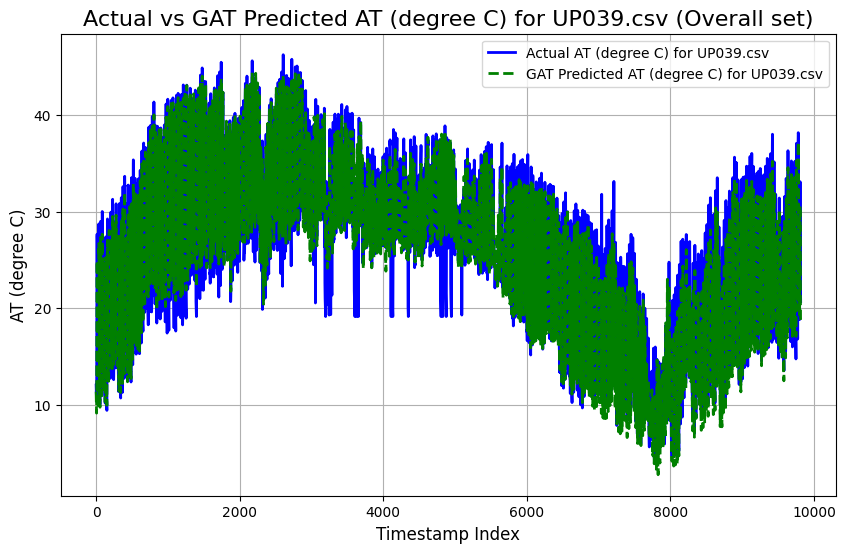

UP040.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3270
Mean Squared Error (MSE): 3.1388
Root Mean Squared Error (RMSE): 1.7717
Pearson Correlation Coefficient: 0.9818
R-squared (R²): 0.9592

----------------------------------------



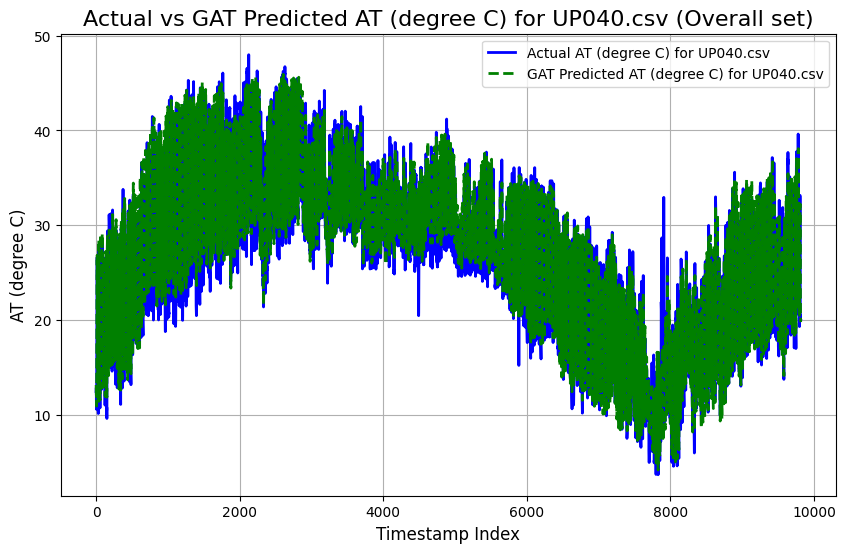

UP041.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2208
Mean Squared Error (MSE): 3.4757
Root Mean Squared Error (RMSE): 1.8643
Pearson Correlation Coefficient: 0.9703
R-squared (R²): 0.9364

----------------------------------------



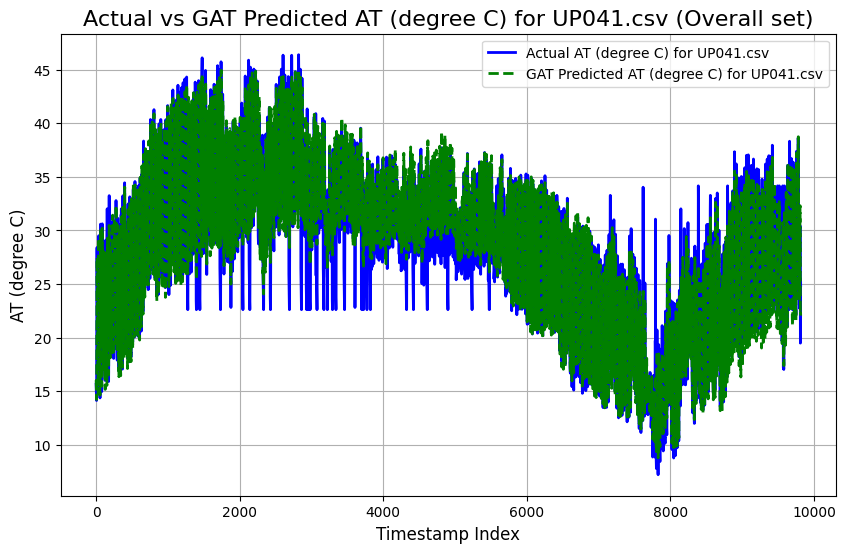

UP042.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.1365
Mean Squared Error (MSE): 9.9153
Root Mean Squared Error (RMSE): 3.1489
Pearson Correlation Coefficient: 0.9049
R-squared (R²): 0.8084

----------------------------------------



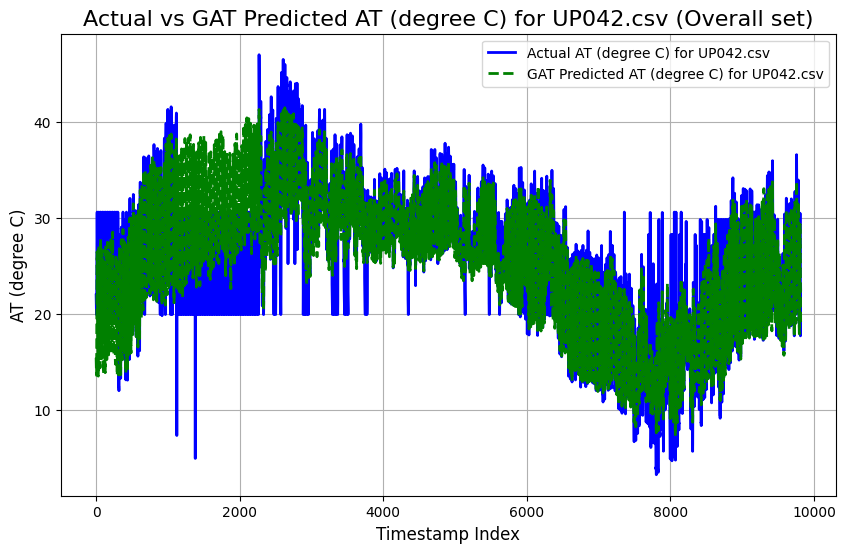

UP043.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.1224
Mean Squared Error (MSE): 10.4595
Root Mean Squared Error (RMSE): 3.2341
Pearson Correlation Coefficient: 0.9197
R-squared (R²): 0.8346

----------------------------------------



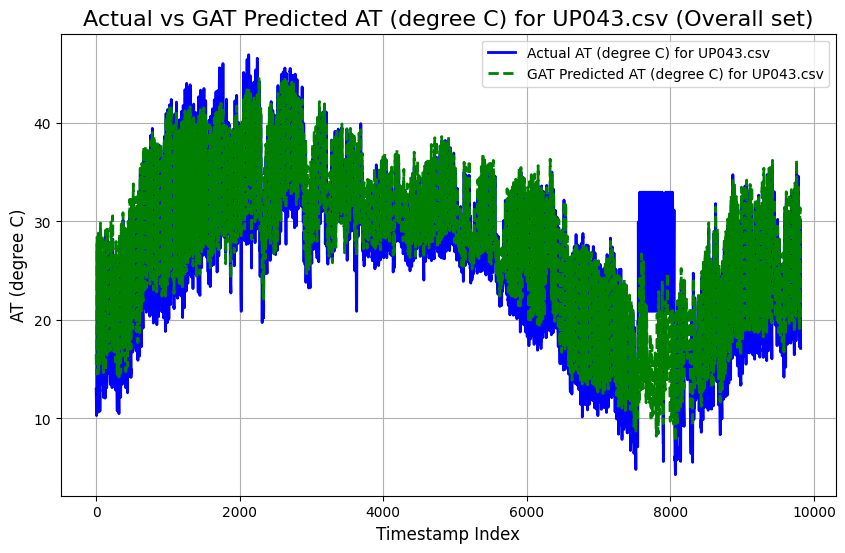

UP044.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2136
Mean Squared Error (MSE): 3.2675
Root Mean Squared Error (RMSE): 1.8076
Pearson Correlation Coefficient: 0.9797
R-squared (R²): 0.9558

----------------------------------------



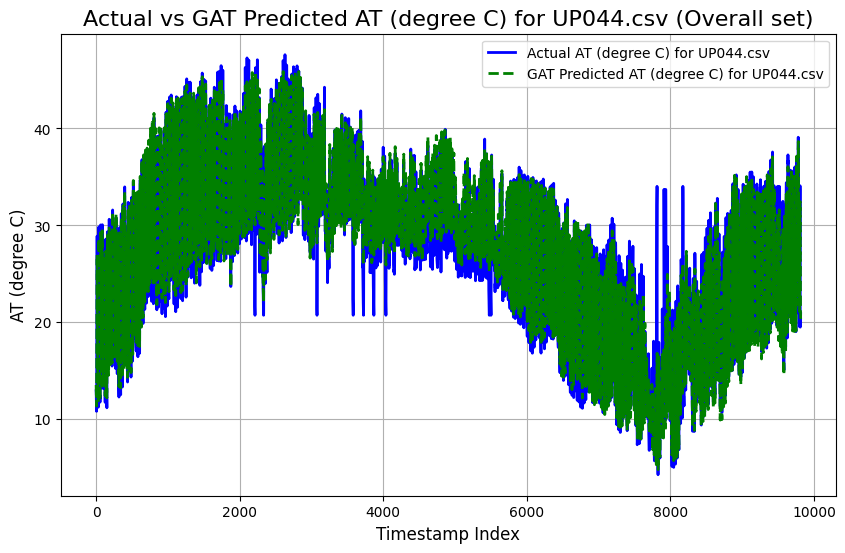

UP046.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4274
Mean Squared Error (MSE): 4.0335
Root Mean Squared Error (RMSE): 2.0084
Pearson Correlation Coefficient: 0.9718
R-squared (R²): 0.9392

----------------------------------------



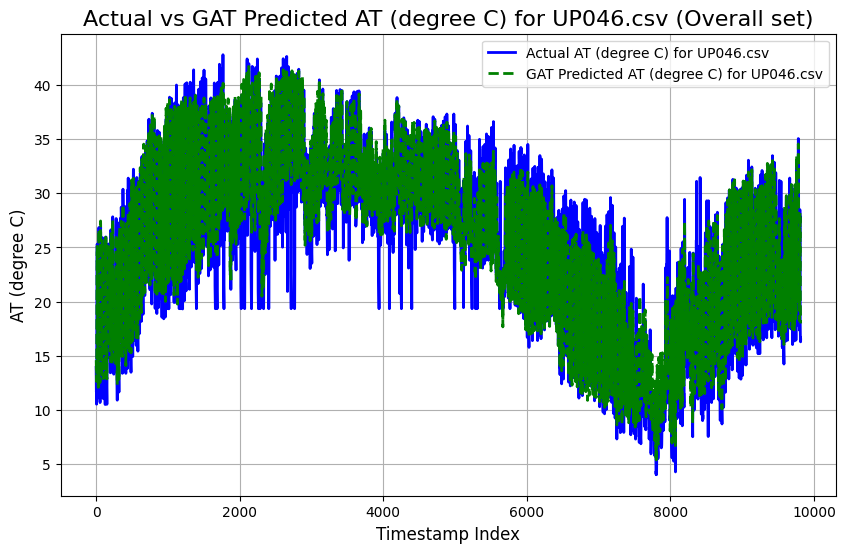

UP048.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5718
Mean Squared Error (MSE): 4.9035
Root Mean Squared Error (RMSE): 2.2144
Pearson Correlation Coefficient: 0.9637
R-squared (R²): 0.9233

----------------------------------------



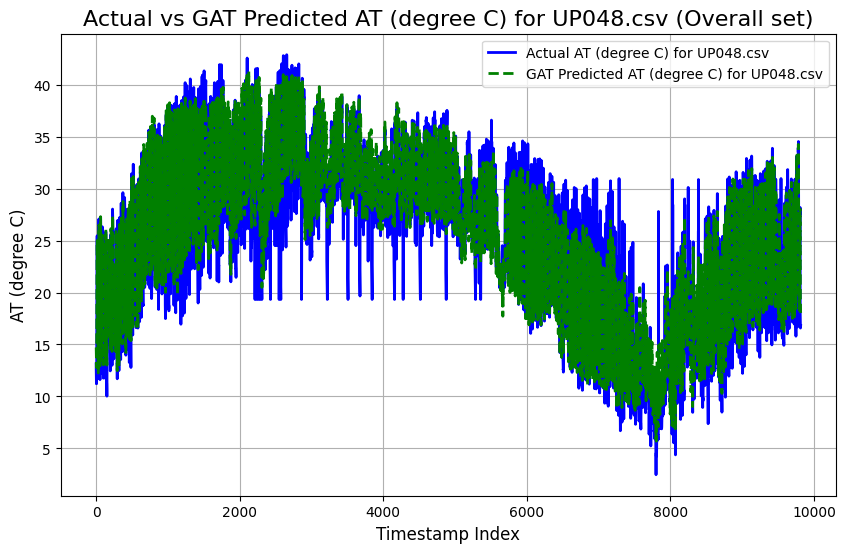

UP049.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4018
Mean Squared Error (MSE): 4.0561
Root Mean Squared Error (RMSE): 2.0140
Pearson Correlation Coefficient: 0.9721
R-squared (R²): 0.9394

----------------------------------------



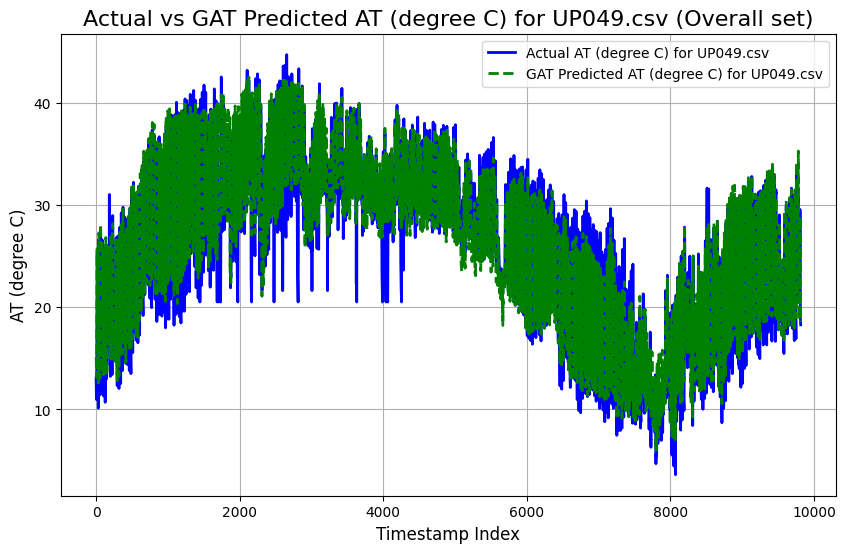

UP050.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.6342
Mean Squared Error (MSE): 12.1709
Root Mean Squared Error (RMSE): 3.4887
Pearson Correlation Coefficient: 0.8571
R-squared (R²): 0.7224

----------------------------------------



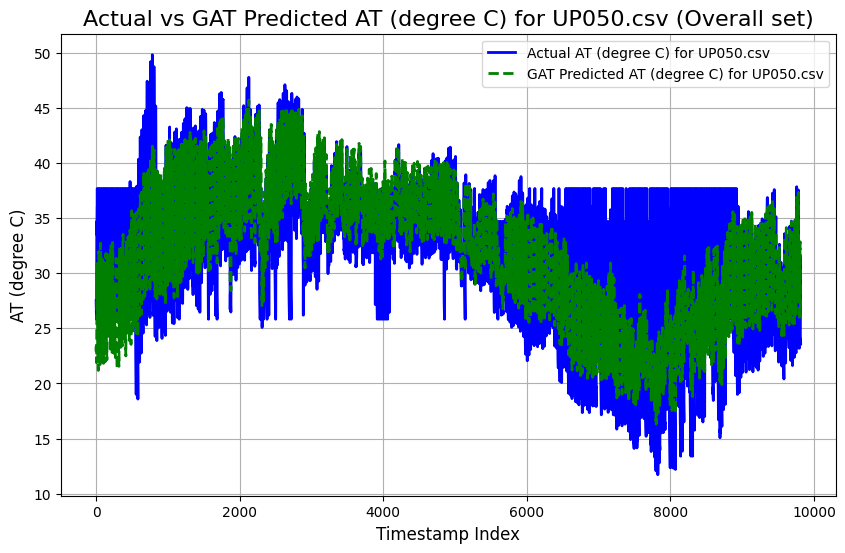

UP051.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.6846
Mean Squared Error (MSE): 26.5751
Root Mean Squared Error (RMSE): 5.1551
Pearson Correlation Coefficient: 0.7661
R-squared (R²): 0.5478

----------------------------------------



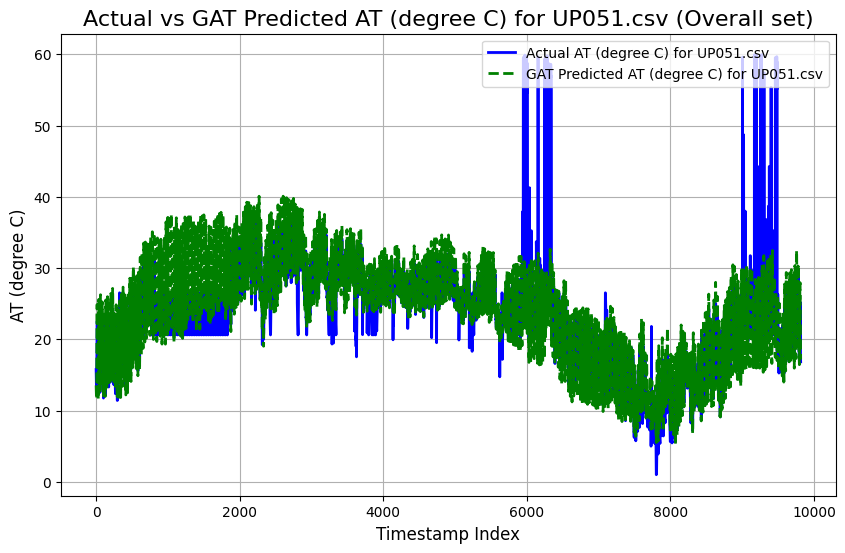

UP052.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.0545
Mean Squared Error (MSE): 8.2638
Root Mean Squared Error (RMSE): 2.8747
Pearson Correlation Coefficient: 0.9362
R-squared (R²): 0.8701

----------------------------------------



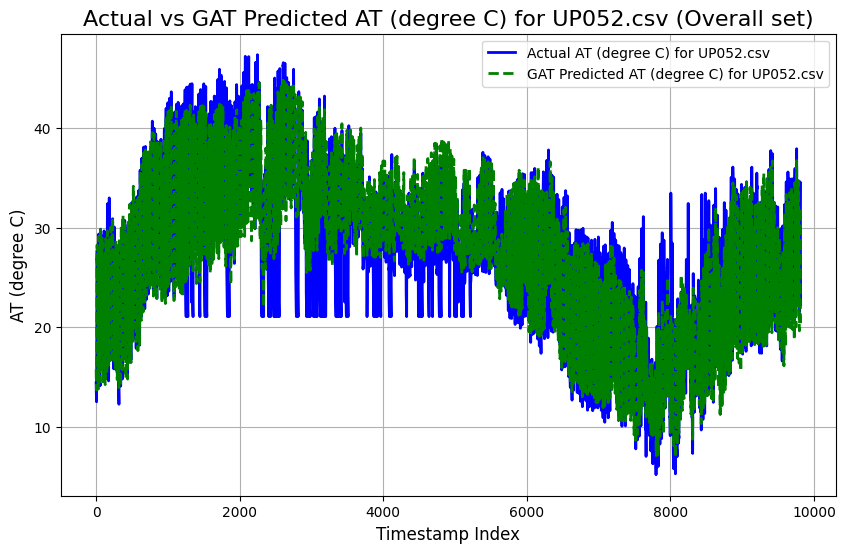

Overall GNN Imputed HourMean.csv
CSV file 'Overall GNN Imputed HourMean.csv' created successfully.
Shape of gat_outputs: (9816, 41)
Shape of actual_values: (9816, 41)


In [17]:

from torch.optim.lr_scheduler import StepLR
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from scipy.stats import pearsonr

# Define the GAT model
class GATModel(torch.nn.Module):
    def __init__(self, in_channels, out_channels):
        super(GATModel, self).__init__()
        self.conv1 = GATConv(in_channels, 8, heads=8, dropout=0.2)
        self.conv2 = GATConv(8 * 8, out_channels, heads=1, concat=False, dropout=0.2)
        
    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        # First GAT layer followed by ELU activation
        x = self.conv1(x, edge_index)
        x = F.elu(x)
        # Dropout
        x = F.dropout(x, p=0.2, training=self.training)
        
        # Second GAT layer followed by ELU activation
        x = self.conv2(x, edge_index)
        return x

# Initialize the model and optimizer
in_channels = train_graph_data_list[0].x.size(-1)  # Number of input features (depends on the number of columns)
out_channels = 1  # Predicting a single value ('AT (degree C)')
model = GATModel(in_channels, out_channels)

optimizer = torch.optim.Adam(model.parameters(), lr=0.0005, weight_decay=5e-4)
loss_fn = torch.nn.MSELoss()

# StepLR: Reduces the learning rate by gamma every step_size epochs
scheduler = StepLR(optimizer, step_size=5, gamma=0.5)

# Train the GAT model on the training set
def train_gat(graph_data_list, epochs=30):
    model.train()
    for epoch in range(epochs):
        epoch_loss = 0
        for graph_data in graph_data_list:
            optimizer.zero_grad()
            out = model(graph_data)
            loss = loss_fn(out.squeeze(), graph_data.y)
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
        scheduler.step()
        print(f"Epoch {epoch}, Loss: {epoch_loss/len(graph_data_list)}")

# Train the model using the training dataset
train_gat(train_graph_data_list)

# Evaluate the model on the training and testing sets
def evaluate_gat(graph_data_list):
    model.eval()
    gat_outputs = []
    actual_values = []
    with torch.no_grad():
        for graph_data in graph_data_list:
            gat_output = model(graph_data)
            gat_outputs.append(gat_output.squeeze().numpy())
            actual_values.append(graph_data.y.squeeze().numpy())
    return np.array(gat_outputs), np.array(actual_values)

# Get GAT predictions for training and testing sets
train_gat_outputs, train_actual_values = evaluate_gat(train_graph_data_list)
test_gat_outputs, test_actual_values = evaluate_gat(test_graph_data_list)

train_gnn_mae_list = []
train_gnn_mse_list = []
train_gnn_rmse_list = []
train_gnn_pearson_corr_list = []
train_gnn_r_squared_list = []

test_gnn_mae_list = []
test_gnn_mse_list = []
test_gnn_rmse_list = []
test_gnn_pearson_corr_list = []
test_gnn_r_squared_list = []

overall_gnn_mae_list = []
overall_gnn_mse_list = []
overall_gnn_rmse_list = []
overall_gnn_pearson_corr_list = []
overall_gnn_r_squared_list = []

# Apply inverse scaling and calculate performance metrics for training and testing sets
def inverse_scale_and_evaluate(gat_outputs, actual_values, set_type):
    gat_outputs_inverse_scaled = []
    actual_values_inverse_scaled = []
    for node_idx in range(gat_outputs.shape[1]):
        gat_node_values = gat_outputs[:, node_idx].reshape(-1, 1)
        actual_node_values = actual_values[:, node_idx].reshape(-1, 1)
        gat_node_inverse_scaled = scalers[input_files[node_idx]].inverse_transform(gat_node_values).flatten()
        actual_node_inverse_scaled = scalers[input_files[node_idx]].inverse_transform(actual_node_values).flatten()
        gat_outputs_inverse_scaled.append(gat_node_inverse_scaled)
        actual_values_inverse_scaled.append(actual_node_inverse_scaled)
    
    # Evaluate performance metrics for each node
    num_nodes = gat_outputs.shape[1]
    for node_idx in range(num_nodes):
        actual = actual_values_inverse_scaled[node_idx]
        predicted = gat_outputs_inverse_scaled[node_idx]
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        rmse = np.sqrt(mse)
        pearson_corr, _ = pearsonr(actual, predicted)
        r_squared = r2_score(actual, predicted)
        
        print(f"{input_files[node_idx]} ({set_type} set) Metrics:")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
        print(f"Pearson Correlation Coefficient: {pearson_corr:.4f}")
        print(f"R-squared (R²): {r_squared:.4f}")
        print("\n" + "-"*40 + "\n")

        if(set_type == 'Training'):
            train_gnn_mae_list.append(mae)
            train_gnn_mse_list.append(mse)
            train_gnn_rmse_list.append(rmse)
            train_gnn_pearson_corr_list.append(pearson_corr)
            train_gnn_r_squared_list.append(r_squared)

        if(set_type == 'Testing'):
            test_gnn_mae_list.append(mae)
            test_gnn_mse_list.append(mse)
            test_gnn_rmse_list.append(rmse)
            test_gnn_pearson_corr_list.append(pearson_corr)
            test_gnn_r_squared_list.append(r_squared)

        if(set_type == 'Overall'):
            overall_gnn_mae_list.append(mae)
            overall_gnn_mse_list.append(mse)
            overall_gnn_rmse_list.append(rmse)
            overall_gnn_pearson_corr_list.append(pearson_corr)
            overall_gnn_r_squared_list.append(r_squared)        
        
        # Plot actual vs predicted values for this node
        plt.figure(figsize=(10, 6))
        plt.plot(actual, label=f'Actual AT (degree C) for {input_files[node_idx]}', color='blue', linewidth=2)
        plt.plot(predicted, label=f'GAT Predicted AT (degree C) for {input_files[node_idx]}', color='green', linestyle='--', linewidth=2)
        plt.title(f'Actual vs GAT Predicted AT (degree C) for {input_files[node_idx]} ({set_type} set)', fontsize=16)
        plt.xlabel('Timestamp Index', fontsize=12)
        plt.ylabel('AT (degree C)', fontsize=12)
        plt.legend(loc='upper right')
        plt.grid(True)
        plt.show()

# Evaluate and plot for both training and testing sets
inverse_scale_and_evaluate(train_gat_outputs, train_actual_values, 'Training')
inverse_scale_and_evaluate(test_gat_outputs, test_actual_values, 'Testing')

def create_metrics_gnn_csv(file_name, input_files, mae_list, mse_list, rmse_list, r2_list, corr_list):
    metrics_df = pd.DataFrame({
        "File Name": input_files,
        "MAE": mae_list,
        "MSE": mse_list,
        "RMSE": rmse_list,
        "R2": r2_list,
        "CorrCoeff": corr_list
    })
    metrics_df.to_csv(file_name, index=False)
    print(f"CSV file '{file_name}' created successfully.")


# Create CSV for training set
file_name = "Train GNN Imputed HourMean.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, train_gnn_mae_list, train_gnn_mse_list, train_gnn_rmse_list, train_gnn_r_squared_list, train_gnn_pearson_corr_list)

# Create CSV for training set
file_name = "Test GNN Imputed HourMean.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, test_gnn_mae_list, test_gnn_mse_list, test_gnn_rmse_list, test_gnn_r_squared_list, test_gnn_pearson_corr_list)

# Concatenate training and testing outputs
gat_outputs = np.concatenate([train_gat_outputs, test_gat_outputs], axis=0)
actual_values = np.concatenate([train_actual_values, test_actual_values], axis=0)
inverse_scale_and_evaluate(gat_outputs, actual_values, 'Overall')

# Create CSV for overall set
file_name = "Overall GNN Imputed HourMean.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, overall_gnn_mae_list, overall_gnn_mse_list, overall_gnn_rmse_list, overall_gnn_r_squared_list, overall_gnn_pearson_corr_list)

# Print the shapes of gat_outputs and actual_values
print(f"Shape of gat_outputs: {gat_outputs.shape}")
print(f"Shape of actual_values: {actual_values.shape}")


# Showing the GAT outputs and actual outputs

In [18]:
gat_outputs_without_inverse_scaled = []
actual_values_without_inverse_scaled = []

for node_idx in range(gat_outputs.shape[1]):
    # Extract predictions and actual values for the current node across all timestamps
    gat_node_values = gat_outputs[:, node_idx].reshape(-1, 1)
    actual_node_values = actual_values[:, node_idx].reshape(-1, 1)
    
    # Append the inverse scaled values for this node
    gat_outputs_without_inverse_scaled.append(gat_node_values)
    actual_values_without_inverse_scaled.append(actual_node_values)

# Plot the actual vs predicted values for each node
num_nodes = gat_outputs.shape[1]
print(gat_outputs_without_inverse_scaled)
print(actual_values_without_inverse_scaled)


[array([[-1.5492927],
       [-1.5877972],
       [-1.6298923],
       ...,
       [-0.6740317],
       [-0.6944105],
       [-0.7449194]], dtype=float32), array([[-1.5945028 ],
       [-1.6214149 ],
       [-1.6667445 ],
       ...,
       [-0.78190714],
       [-0.75408244],
       [-0.7960735 ]], dtype=float32), array([[-1.3371761 ],
       [-1.3880779 ],
       [-1.4539386 ],
       ...,
       [-0.7943971 ],
       [-0.8338884 ],
       [-0.88166445]], dtype=float32), array([[-1.3208107 ],
       [-1.2512289 ],
       [-1.308963  ],
       ...,
       [-0.7628349 ],
       [-0.78434795],
       [-0.79161465]], dtype=float32), array([[-1.3230969 ],
       [-1.2644212 ],
       [-1.327777  ],
       ...,
       [-0.79894835],
       [-0.82516605],
       [-0.83392674]], dtype=float32), array([[-1.3310821 ],
       [-1.3266217 ],
       [-1.3893417 ],
       ...,
       [-0.7808609 ],
       [-0.8124634 ],
       [-0.84073585]], dtype=float32), array([[-1.2978611 ],
       [-1.285276

# Adding the GNN predicted values as a new column

In [19]:
train_gat_outputs_without_inverse_scaled = []
test_gat_outputs_without_inverse_scaled = []
train_size = train_dataframes[0].shape[0]

for node_idx in range(num_nodes):
    train1 = gat_outputs_without_inverse_scaled[node_idx][:train_size]
    test1 = gat_outputs_without_inverse_scaled[node_idx][train_size:]
    train_gat_outputs_without_inverse_scaled.append(train1)
    test_gat_outputs_without_inverse_scaled.append(test1)

# Add predicted values as a new column in each dataframe and print column and row details
for node_idx, df in enumerate(train_dataframes):
    # Extract the predicted values for the current node (inverse scaled)
    predicted_values = train_gat_outputs_without_inverse_scaled[node_idx].flatten()
    print(df.shape)
    print(len(predicted_values))

    # Add a new column for the predicted values
    df['Predicted AT (degree C)'] = predicted_values

    # Print column numbers and names
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}: Columns")
    for col_idx, col_name in enumerate(df.columns):
        print(f"Column {col_idx + 1}: {col_name}")

    print(f"Row numbers total: {len(df)}")    

# Optionally print the first few rows to verify the predicted column was added correctly
    print(df.head(10))  # Display the first few rows of the dataframe for verification
    print("\n" + "="*60 + "\n")


# Add predicted values as a new column in each dataframe and print column and row details
for node_idx, df in enumerate(test_dataframes):
    # Extract the predicted values for the current node (inverse scaled)
    predicted_values = test_gat_outputs_without_inverse_scaled[node_idx].flatten()

    # Add a new column for the predicted values
    df['Predicted AT (degree C)'] = predicted_values

    # Print column numbers and names
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}: Columns")
    for col_idx, col_name in enumerate(df.columns):
        print(f"Column {col_idx + 1}: {col_name}")

    print(f"Row numbers total: {len(df)}")    

# Optionally print the first few rows to verify the predicted column was added correctly
    print(df.head(10))  # Display the first few rows of the dataframe for verification
    print("\n" + "="*60 + "\n")


(8343, 15)
8343
DataFrame 1 - UP002.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       0.024148      0.447298    0.106174     0.432277    -0.852980   
1       0.104592      0.347540    0.070287     0.342051    -0.300730   
2       0.077043      0.250598    0.191239     0.638988     0.123089   
3       0.084757      0.239469    0.091885     0.592529     0.187304   
4      -0.179718      0.095062    0.042042     0.200652     0.232255   
5      -0.090017      0.002276    0.082914     0.335318    -0.063135   
6      -0.175972     -0.006171    0.203533     0.893169    -0.093102   
7       0.0

C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

(8343, 15)
8343
DataFrame 19 - UP028.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       2.753436      2.154030    0.921791     2.969629    -0.265698   
1       2.196494      1.399108    0.038000     2.259772    -0.518285   
2       1.896822      1.024510    0.034648     1.557639    -0.598653   
3       2.047677      0.990314    0.023475     1.323595    -0.705811   
4       1.591034      0.549581    0.040235     1.060971    -0.796385   
5       1.299516      0.457754    0.020123     0.809933    -0.811694   
6       1.338249      0.378426    0.111742     0.922707    -0.696882   
7       1.

C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

      PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
8343      -0.299295     -0.375024   -0.366483    -0.434657    -0.145066   
8344      -0.385972     -0.393371   -0.394534    -0.388263    -0.070738   
8345      -0.342226     -0.327217   -0.352374    -0.165391     0.037553   
8346      -0.234202     -0.085403   -0.146322     0.194279    -0.046430   
8347      -0.102466      0.218306    0.143961     0.446719     0.109498   
8348       0.108876      0.423411    0.316918     0.498520     0.262352   
8349       0.167472      0.464129    0.382409     0.441858     0.370148   
8350       0.194396      0.406171    0.310657     0.349655     0.376451   
8351       0.206474      0.314808    0.216980     0.230271     0.305995   
8352       0.148835      0.161242    0.155983     0.113441     0.098705   

      CO (mg/m3)  Ozone (ug/m3)    RH (%)  WS (m/s)  WD (degree)  \
8343   -0.449397       0.901020 -0.742081  0.407736     0.017027   
8344   -0.444842       0.771927 -0.663

C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

DataFrame 33 - UP042.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 1473
      PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
8343      -0.750956     -0.595334    0.001070    -0.119902     0.958213   
8344      -0.631004     -0.522319   -0.000097    -0.123741     0.989521   
8345      -0.439153     -0.379392    0.352644    -0.194456     0.398195   
8346      -0.320753     -0.315421    2.168695    -0.103586     0.616669   
8347      -0.172372     -0.179424   -0.008849    -0.112224     0.766094   
8348      -0.177978     -0.259041    0.001070    -0.131419     0.734786   
8349      -0.322195     -0.340502   -0.009433    -0.122781     0.686401   
83

C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_22064\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

# Creating feature and target lists

In [20]:
# Initialize lists to store features and target for each dataframe
train_features_list = []
train_target_list = []

test_features_list = []
test_target_list = []

# Iterate over each dataframe to separate features and target
for node_idx, (df1, df2) in enumerate(zip(train_dataframes, test_dataframes)):
    # Features include all columns except 'AT (degree C)'
    trainfeatures1 = df1.drop(columns=['AT (degree C)'])
    testfeatures1 = df2.drop(columns=['AT (degree C)'])
    
    # Target is the 'AT (degree C)' column
    traintarget1 = df1['AT (degree C)']
    testtarget1 = df2['AT (degree C)']
    
    # Append the features and target to the respective lists
    train_features_list.append(trainfeatures1)
    train_target_list.append(traintarget1)
    test_features_list.append(testfeatures1)
    test_target_list.append(testtarget1)
    
    # Print the columns of features and target, and number of rows
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}:")
    print(f"Features columns: {len(trainfeatures1.columns)}")
    print(trainfeatures1.columns)
    
    print("\nTarget column:")
    print(traintarget1.name)
    
    print(f"\nNumber of rows in training features: {trainfeatures1.shape[0]}")
    print(f"Number of rows in training target: {traintarget1.shape[0]}")
    print(f"\nNumber of rows in testing features: {testfeatures1.shape[0]}")
    print(f"Number of rows in testing target: {testtarget1.shape[0]}")
    print("\n" + "="*60 + "\n")

DataFrame 1 - UP002.csv:
Features columns: 15
Index(['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)',
       'SO2 (ug/m3)', 'CO (mg/m3)', 'Ozone (ug/m3)', 'RH (%)', 'WS (m/s)',
       'WD (degree)', 'Year', 'Month', 'Day', 'Hour',
       'Predicted AT (degree C)'],
      dtype='object')

Target column:
AT (degree C)

Number of rows in training features: 8343
Number of rows in training target: 8343

Number of rows in testing features: 1473
Number of rows in testing target: 1473


DataFrame 2 - UP003.csv:
Features columns: 15
Index(['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)',
       'SO2 (ug/m3)', 'CO (mg/m3)', 'Ozone (ug/m3)', 'RH (%)', 'WS (m/s)',
       'WD (degree)', 'Year', 'Month', 'Day', 'Hour',
       'Predicted AT (degree C)'],
      dtype='object')

Target column:
AT (degree C)

Number of rows in training features: 8343
Number of rows in training target: 8343

Number of rows in testing features: 1473
Number of rows in testing target: 1473


DataFr

# LSTM Model Implementation

For Batch Size= 3 and Sequence Length = 3
Processing node 1...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1010
Epoch [2/50], Train Loss: 0.0672
Epoch [3/50], Train Loss: 0.0606
Epoch [4/50], Train Loss: 0.0579
Epoch [5/50], Train Loss: 0.0561
Epoch [6/50], Train Loss: 0.0532
Epoch [7/50], Train Loss: 0.0509
Epoch [8/50], Train Loss: 0.0498
Epoch [9/50], Train Loss: 0.0493
Epoch [10/50], Train Loss: 0.0490
Epoch [11/50], Train Loss: 0.0470
Epoch [12/50], Train Loss: 0.0464
Epoch [13/50], Train Loss: 0.0457
Epoch [14/50], Train Loss: 0.0454
Epoch [15/50], Train Loss: 0.0446
Epoch [16/50], Train Loss: 0.0446
Epoch [17/50], Train Loss: 0.0432
Epoch [18/50], Train Loss: 0.0414
Epoch [19/50], Train Loss: 0.0415
Epoch [20/50], Train Loss: 0.0419
Epoch [21/50], Train Loss: 0.0403
Epoch [22/50], Train Loss: 0.0395
Epoch [23/50], Train Loss: 0.0390
Epoch [24/50], Train Loss: 0.0388
Epoch [25/50], Train Loss: 0.0383
Epoch [26/50], Train Loss: 0.0373
Epoch [27/50], Train Loss: 0.0369
Epoch [28/50], Train Loss: 0.0359
Epoch [29/50], Train Loss: 0.0361
Epoch [30/50], Train Lo

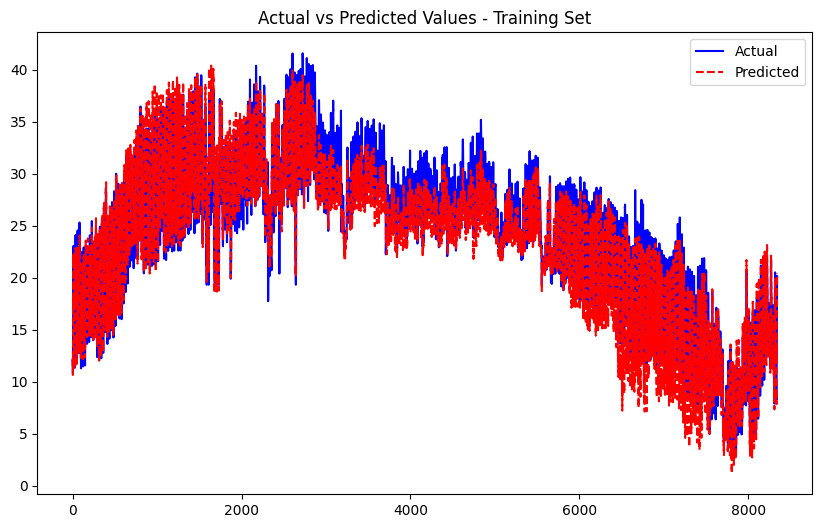

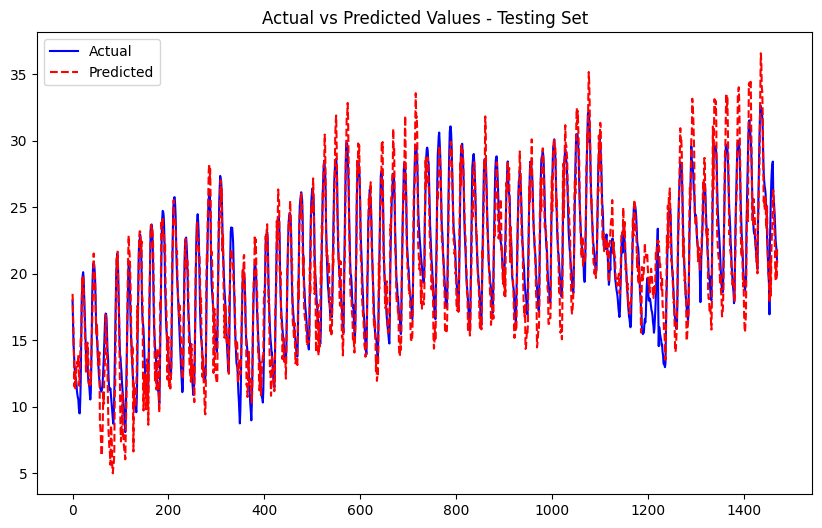

Processing node 2...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0491
Epoch [2/50], Train Loss: 0.0406
Epoch [3/50], Train Loss: 0.0379
Epoch [4/50], Train Loss: 0.0361
Epoch [5/50], Train Loss: 0.0345
Epoch [6/50], Train Loss: 0.0334
Epoch [7/50], Train Loss: 0.0323
Epoch [8/50], Train Loss: 0.0315
Epoch [9/50], Train Loss: 0.0305
Epoch [10/50], Train Loss: 0.0295
Epoch [11/50], Train Loss: 0.0294
Epoch [12/50], Train Loss: 0.0284
Epoch [13/50], Train Loss: 0.0285
Epoch [14/50], Train Loss: 0.0282
Epoch [15/50], Train Loss: 0.0276
Epoch [16/50], Train Loss: 0.0274
Epoch [17/50], Train Loss: 0.0269
Epoch [18/50], Train Loss: 0.0268
Epoch [19/50], Train Loss: 0.0264
Epoch [20/50], Train Loss: 0.0262
Epoch [21/50], Train Loss: 0.0261
Epoch [22/50], Train Loss: 0.0254
Epoch [23/50], Train Loss: 0.0260
Epoch [24/50], Train Loss: 0.0254
Epoch [25/50], Train Loss: 0.0251
Epoch [26/50], Train Loss: 0.0250
Epoch [27/50], Train Loss: 0.0248
Epoch [28/50], Train Loss: 0.0248
Epoch [29/50], Train Loss: 0.0246
Epoch [30/50], Train Lo

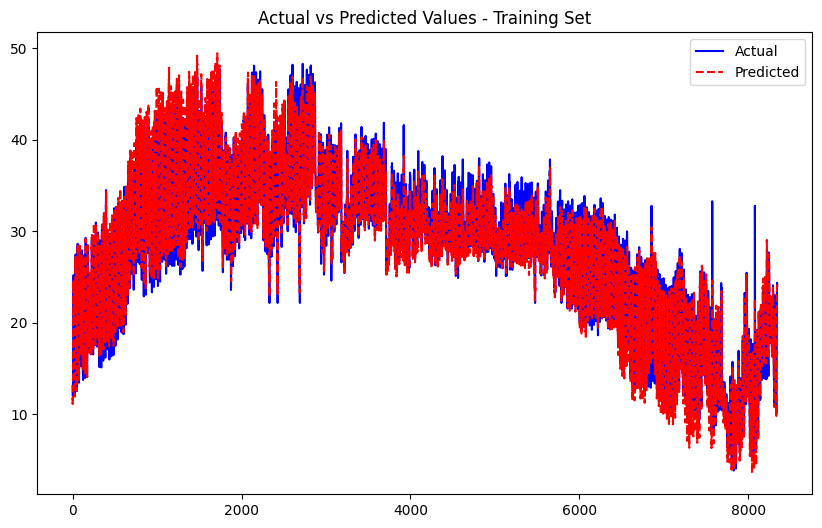

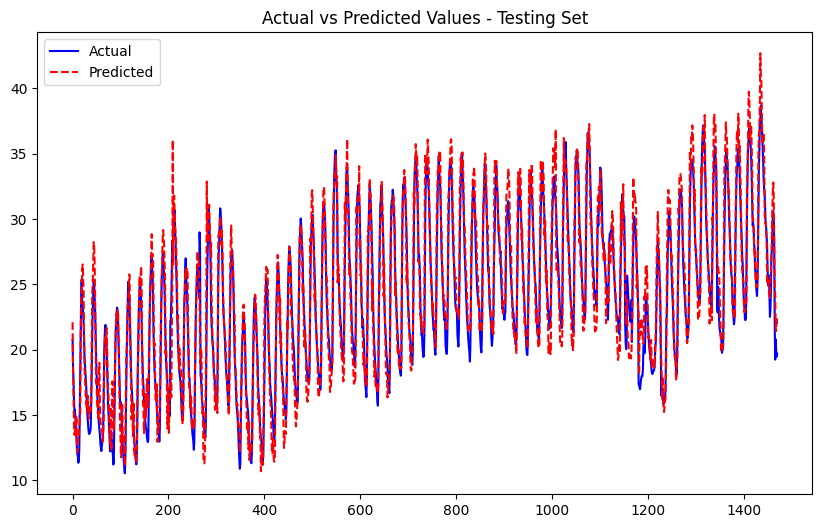

Processing node 3...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0446
Epoch [2/50], Train Loss: 0.0362
Epoch [3/50], Train Loss: 0.0323
Epoch [4/50], Train Loss: 0.0307
Epoch [5/50], Train Loss: 0.0290
Epoch [6/50], Train Loss: 0.0284
Epoch [7/50], Train Loss: 0.0268
Epoch [8/50], Train Loss: 0.0261
Epoch [9/50], Train Loss: 0.0258
Epoch [10/50], Train Loss: 0.0253
Epoch [11/50], Train Loss: 0.0247
Epoch [12/50], Train Loss: 0.0242
Epoch [13/50], Train Loss: 0.0240
Epoch [14/50], Train Loss: 0.0238
Epoch [15/50], Train Loss: 0.0240
Epoch [16/50], Train Loss: 0.0236
Epoch [17/50], Train Loss: 0.0232
Epoch [18/50], Train Loss: 0.0232
Epoch [19/50], Train Loss: 0.0228
Epoch [20/50], Train Loss: 0.0227
Epoch [21/50], Train Loss: 0.0224
Epoch [22/50], Train Loss: 0.0225
Epoch [23/50], Train Loss: 0.0226
Epoch [24/50], Train Loss: 0.0224
Epoch [25/50], Train Loss: 0.0220
Epoch [26/50], Train Loss: 0.0219
Epoch [27/50], Train Loss: 0.0217
Epoch [28/50], Train Loss: 0.0215
Epoch [29/50], Train Loss: 0.0217
Epoch [30/50], Train Lo

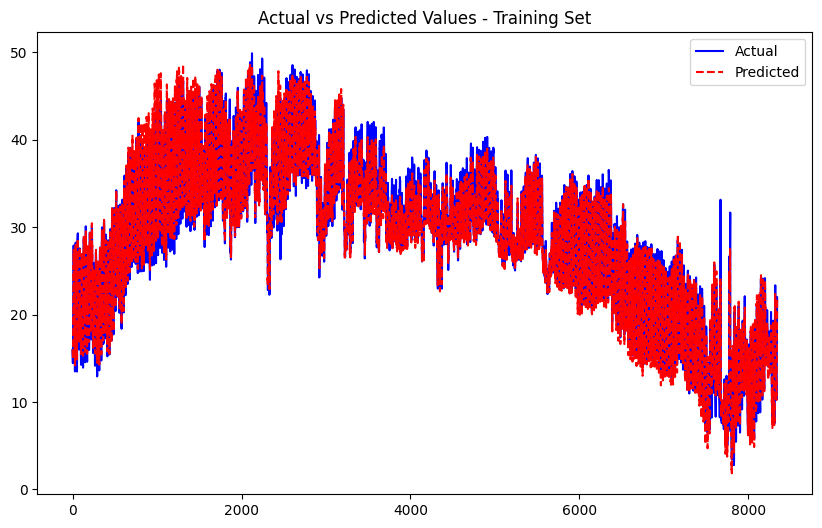

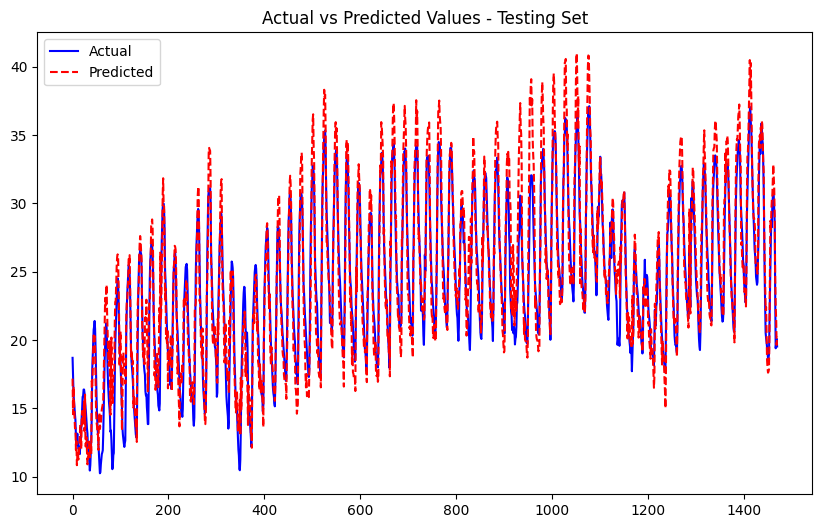

Processing node 4...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2703
Epoch [2/50], Train Loss: 0.2400
Epoch [3/50], Train Loss: 0.2084
Epoch [4/50], Train Loss: 0.1799
Epoch [5/50], Train Loss: 0.1589
Epoch [6/50], Train Loss: 0.1459
Epoch [7/50], Train Loss: 0.1325
Epoch [8/50], Train Loss: 0.1195
Epoch [9/50], Train Loss: 0.1116
Epoch [10/50], Train Loss: 0.1049
Epoch [11/50], Train Loss: 0.0990
Epoch [12/50], Train Loss: 0.0920
Epoch [13/50], Train Loss: 0.0889
Epoch [14/50], Train Loss: 0.0859
Epoch [15/50], Train Loss: 0.0799
Epoch [16/50], Train Loss: 0.0744
Epoch [17/50], Train Loss: 0.0688
Epoch [18/50], Train Loss: 0.0656
Epoch [19/50], Train Loss: 0.0634
Epoch [20/50], Train Loss: 0.0603
Epoch [21/50], Train Loss: 0.0653
Epoch [22/50], Train Loss: 0.0562
Epoch [23/50], Train Loss: 0.0564
Epoch [24/50], Train Loss: 0.0640
Epoch [25/50], Train Loss: 0.0537
Epoch [26/50], Train Loss: 0.0541
Epoch [27/50], Train Loss: 0.0481
Epoch [28/50], Train Loss: 0.0481
Epoch [29/50], Train Loss: 0.0507
Epoch [30/50], Train Lo

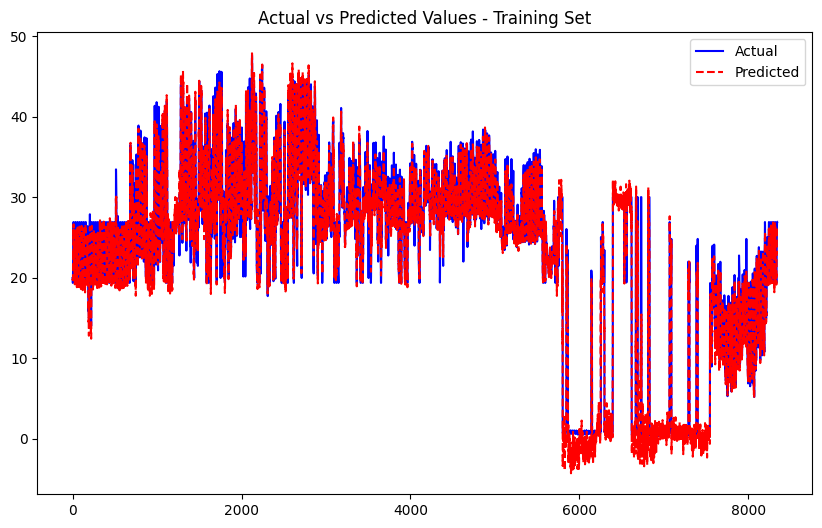

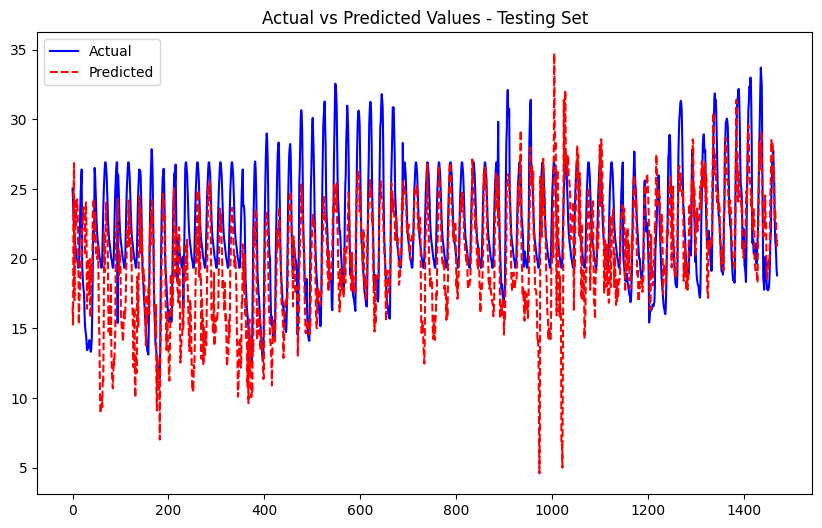

Processing node 5...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0820
Epoch [2/50], Train Loss: 0.0592
Epoch [3/50], Train Loss: 0.0482
Epoch [4/50], Train Loss: 0.0432
Epoch [5/50], Train Loss: 0.0402
Epoch [6/50], Train Loss: 0.0371
Epoch [7/50], Train Loss: 0.0355
Epoch [8/50], Train Loss: 0.0336
Epoch [9/50], Train Loss: 0.0326
Epoch [10/50], Train Loss: 0.0314
Epoch [11/50], Train Loss: 0.0309
Epoch [12/50], Train Loss: 0.0301
Epoch [13/50], Train Loss: 0.0299
Epoch [14/50], Train Loss: 0.0288
Epoch [15/50], Train Loss: 0.0286
Epoch [16/50], Train Loss: 0.0280
Epoch [17/50], Train Loss: 0.0269
Epoch [18/50], Train Loss: 0.0272
Epoch [19/50], Train Loss: 0.0270
Epoch [20/50], Train Loss: 0.0262
Epoch [21/50], Train Loss: 0.0263
Epoch [22/50], Train Loss: 0.0261
Epoch [23/50], Train Loss: 0.0263
Epoch [24/50], Train Loss: 0.0254
Epoch [25/50], Train Loss: 0.0256
Epoch [26/50], Train Loss: 0.0252
Epoch [27/50], Train Loss: 0.0252
Epoch [28/50], Train Loss: 0.0246
Epoch [29/50], Train Loss: 0.0251
Epoch [30/50], Train Lo

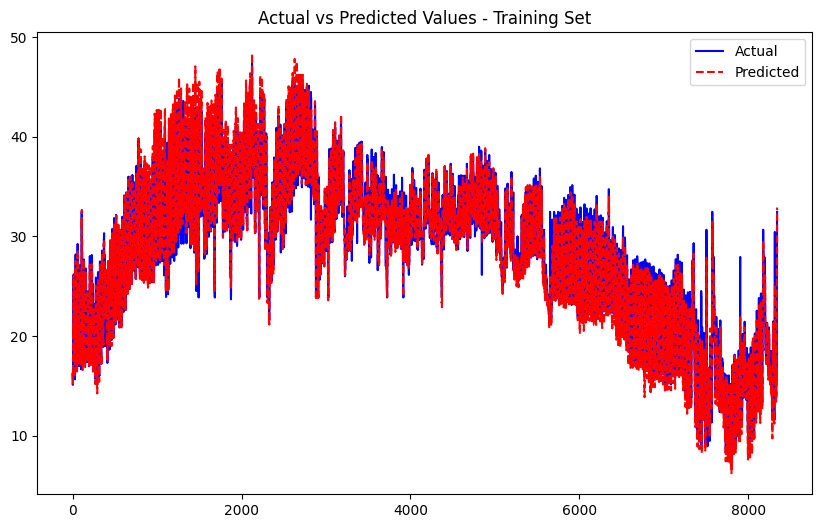

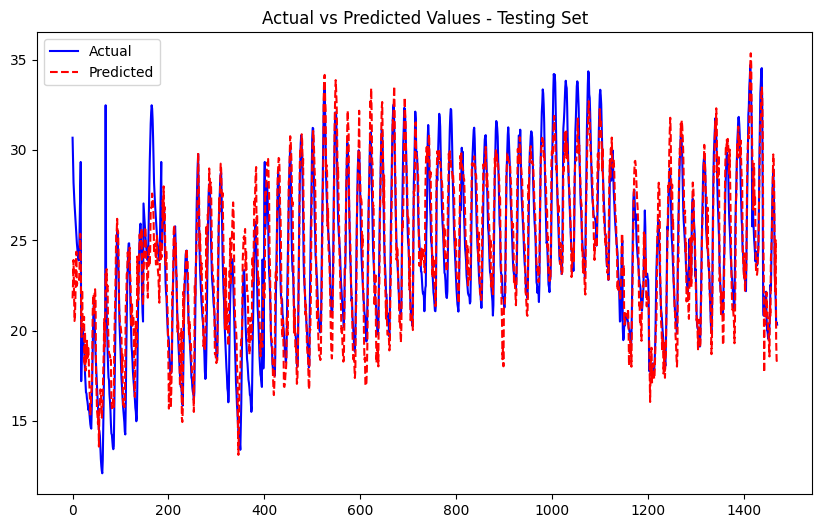

Processing node 6...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0793
Epoch [2/50], Train Loss: 0.0662
Epoch [3/50], Train Loss: 0.0603
Epoch [4/50], Train Loss: 0.0561
Epoch [5/50], Train Loss: 0.0535
Epoch [6/50], Train Loss: 0.0508
Epoch [7/50], Train Loss: 0.0499
Epoch [8/50], Train Loss: 0.0471
Epoch [9/50], Train Loss: 0.0459
Epoch [10/50], Train Loss: 0.0442
Epoch [11/50], Train Loss: 0.0436
Epoch [12/50], Train Loss: 0.0434
Epoch [13/50], Train Loss: 0.0419
Epoch [14/50], Train Loss: 0.0418
Epoch [15/50], Train Loss: 0.0408
Epoch [16/50], Train Loss: 0.0406
Epoch [17/50], Train Loss: 0.0400
Epoch [18/50], Train Loss: 0.0400
Epoch [19/50], Train Loss: 0.0400
Epoch [20/50], Train Loss: 0.0390
Epoch [21/50], Train Loss: 0.0383
Epoch [22/50], Train Loss: 0.0389
Epoch [23/50], Train Loss: 0.0384
Epoch [24/50], Train Loss: 0.0376
Epoch [25/50], Train Loss: 0.0372
Epoch [26/50], Train Loss: 0.0379
Epoch [27/50], Train Loss: 0.0376
Epoch [28/50], Train Loss: 0.0372
Epoch [29/50], Train Loss: 0.0376
Epoch [30/50], Train Lo

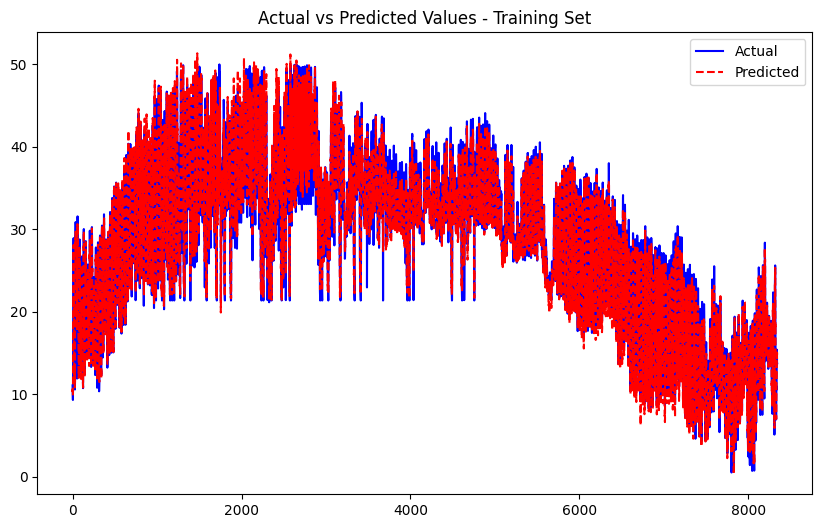

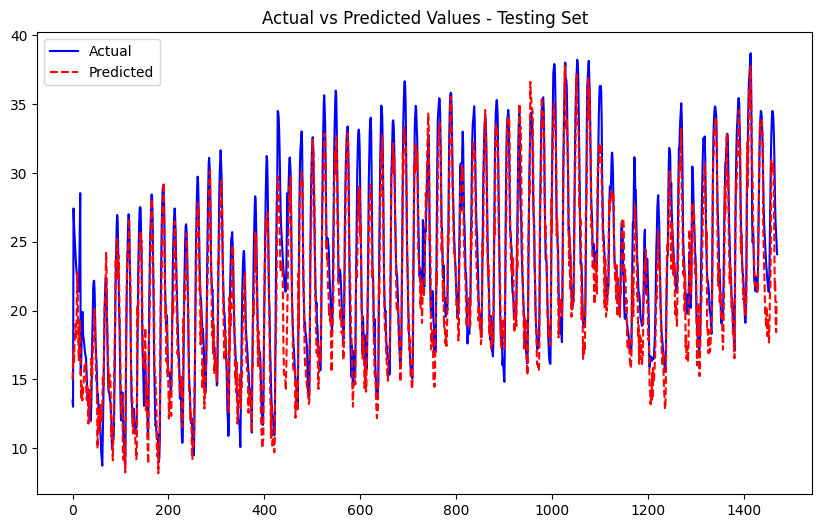

Processing node 7...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0819
Epoch [2/50], Train Loss: 0.0656
Epoch [3/50], Train Loss: 0.0556
Epoch [4/50], Train Loss: 0.0509
Epoch [5/50], Train Loss: 0.0467
Epoch [6/50], Train Loss: 0.0439
Epoch [7/50], Train Loss: 0.0423
Epoch [8/50], Train Loss: 0.0396
Epoch [9/50], Train Loss: 0.0384
Epoch [10/50], Train Loss: 0.0374
Epoch [11/50], Train Loss: 0.0363
Epoch [12/50], Train Loss: 0.0353
Epoch [13/50], Train Loss: 0.0353
Epoch [14/50], Train Loss: 0.0346
Epoch [15/50], Train Loss: 0.0338
Epoch [16/50], Train Loss: 0.0338
Epoch [17/50], Train Loss: 0.0331
Epoch [18/50], Train Loss: 0.0331
Epoch [19/50], Train Loss: 0.0328
Epoch [20/50], Train Loss: 0.0320
Epoch [21/50], Train Loss: 0.0324
Epoch [22/50], Train Loss: 0.0316
Epoch [23/50], Train Loss: 0.0319
Epoch [24/50], Train Loss: 0.0311
Epoch [25/50], Train Loss: 0.0309
Epoch [26/50], Train Loss: 0.0313
Epoch [27/50], Train Loss: 0.0306
Epoch [28/50], Train Loss: 0.0312
Epoch [29/50], Train Loss: 0.0309
Epoch [30/50], Train Lo

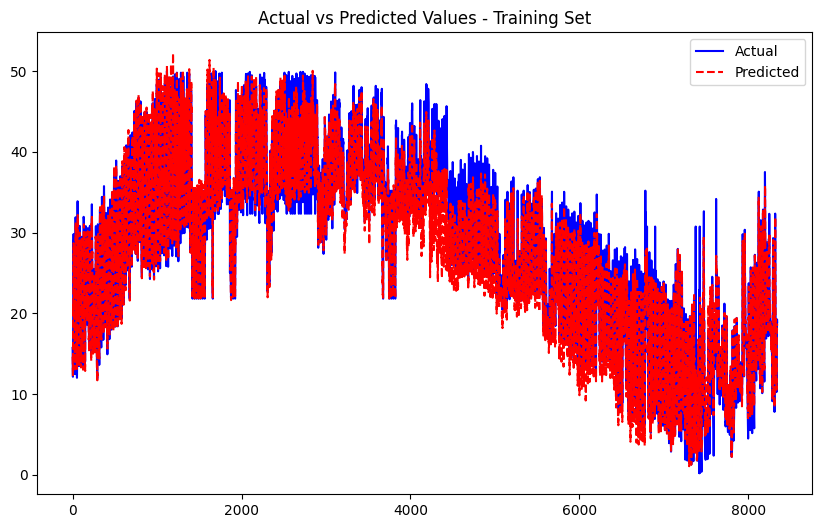

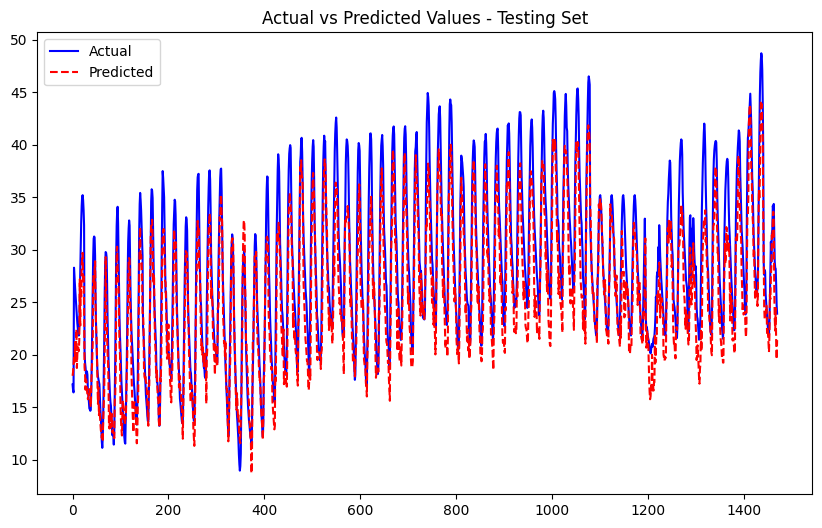

Processing node 8...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1198
Epoch [2/50], Train Loss: 0.0968
Epoch [3/50], Train Loss: 0.0848
Epoch [4/50], Train Loss: 0.0781
Epoch [5/50], Train Loss: 0.0729
Epoch [6/50], Train Loss: 0.0677
Epoch [7/50], Train Loss: 0.0648
Epoch [8/50], Train Loss: 0.0612
Epoch [9/50], Train Loss: 0.0588
Epoch [10/50], Train Loss: 0.0573
Epoch [11/50], Train Loss: 0.0557
Epoch [12/50], Train Loss: 0.0544
Epoch [13/50], Train Loss: 0.0528
Epoch [14/50], Train Loss: 0.0518
Epoch [15/50], Train Loss: 0.0521
Epoch [16/50], Train Loss: 0.0505
Epoch [17/50], Train Loss: 0.0496
Epoch [18/50], Train Loss: 0.0489
Epoch [19/50], Train Loss: 0.0482
Epoch [20/50], Train Loss: 0.0486
Epoch [21/50], Train Loss: 0.0483
Epoch [22/50], Train Loss: 0.0475
Epoch [23/50], Train Loss: 0.0469
Epoch [24/50], Train Loss: 0.0465
Epoch [25/50], Train Loss: 0.0464
Epoch [26/50], Train Loss: 0.0461
Epoch [27/50], Train Loss: 0.0466
Epoch [28/50], Train Loss: 0.0471
Epoch [29/50], Train Loss: 0.0452
Epoch [30/50], Train Lo

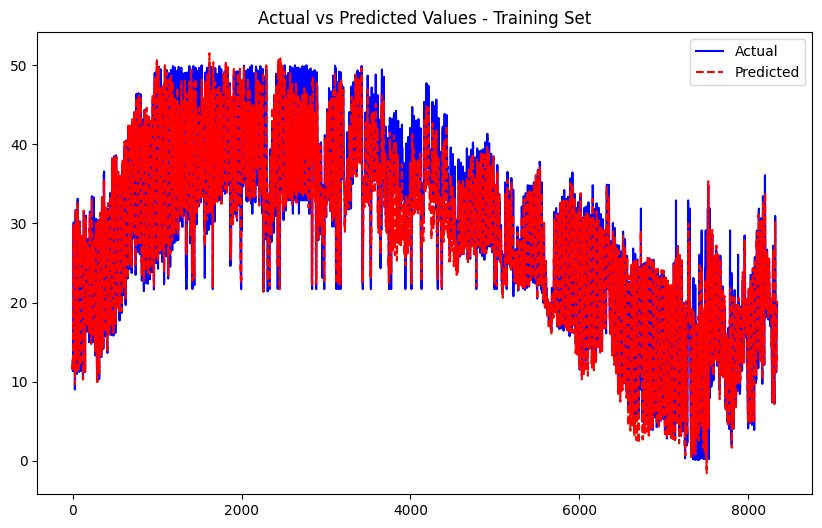

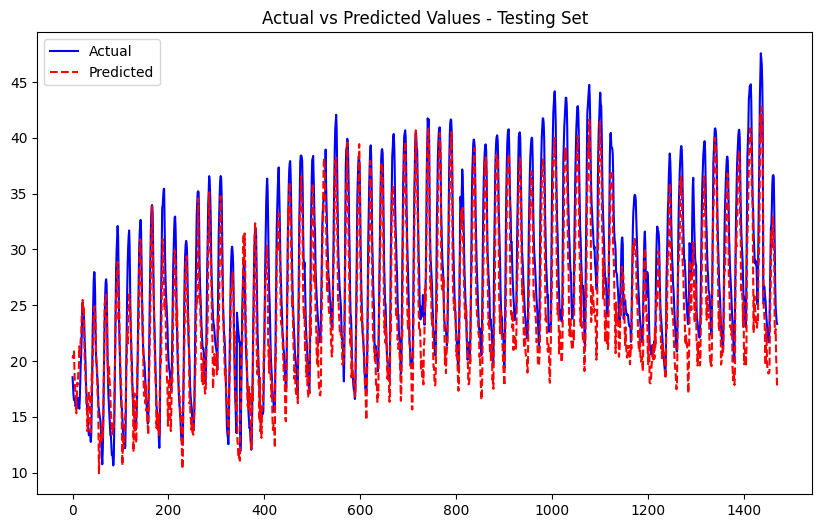

Processing node 9...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0519
Epoch [2/50], Train Loss: 0.0416
Epoch [3/50], Train Loss: 0.0368
Epoch [4/50], Train Loss: 0.0337
Epoch [5/50], Train Loss: 0.0321
Epoch [6/50], Train Loss: 0.0308
Epoch [7/50], Train Loss: 0.0293
Epoch [8/50], Train Loss: 0.0285
Epoch [9/50], Train Loss: 0.0286
Epoch [10/50], Train Loss: 0.0275
Epoch [11/50], Train Loss: 0.0270
Epoch [12/50], Train Loss: 0.0268
Epoch [13/50], Train Loss: 0.0265
Epoch [14/50], Train Loss: 0.0263
Epoch [15/50], Train Loss: 0.0259
Epoch [16/50], Train Loss: 0.0258
Epoch [17/50], Train Loss: 0.0257
Epoch [18/50], Train Loss: 0.0251
Epoch [19/50], Train Loss: 0.0256
Epoch [20/50], Train Loss: 0.0250
Epoch [21/50], Train Loss: 0.0251
Epoch [22/50], Train Loss: 0.0246
Epoch [23/50], Train Loss: 0.0244
Epoch [24/50], Train Loss: 0.0242
Epoch [25/50], Train Loss: 0.0242
Epoch [26/50], Train Loss: 0.0242
Epoch [27/50], Train Loss: 0.0241
Epoch [28/50], Train Loss: 0.0239
Epoch [29/50], Train Loss: 0.0238
Epoch [30/50], Train Lo

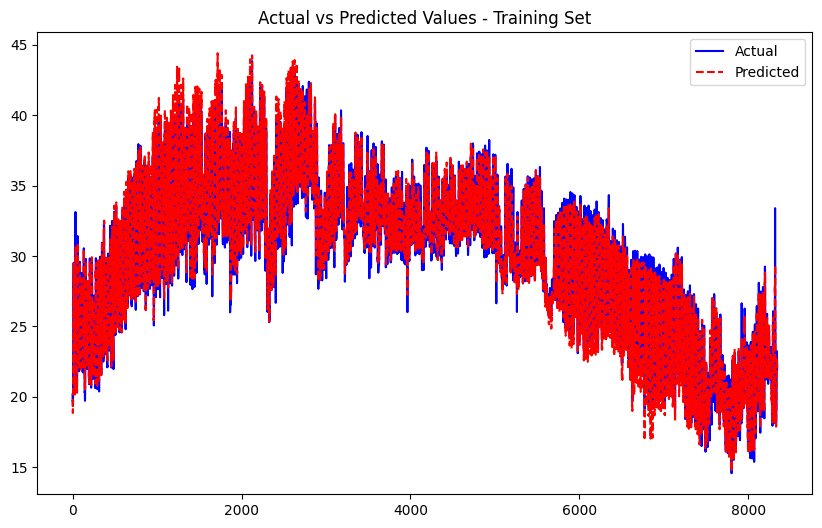

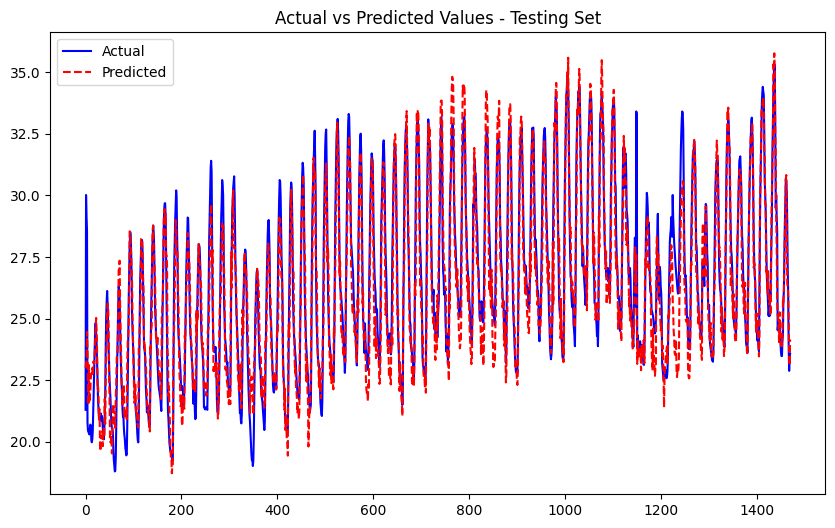

Processing node 10...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2866
Epoch [2/50], Train Loss: 0.2375
Epoch [3/50], Train Loss: 0.1762
Epoch [4/50], Train Loss: 0.1435
Epoch [5/50], Train Loss: 0.1251
Epoch [6/50], Train Loss: 0.1090
Epoch [7/50], Train Loss: 0.0983
Epoch [8/50], Train Loss: 0.0951
Epoch [9/50], Train Loss: 0.0842
Epoch [10/50], Train Loss: 0.0772
Epoch [11/50], Train Loss: 0.0713
Epoch [12/50], Train Loss: 0.0676
Epoch [13/50], Train Loss: 0.0653
Epoch [14/50], Train Loss: 0.0618
Epoch [15/50], Train Loss: 0.0607
Epoch [16/50], Train Loss: 0.0584
Epoch [17/50], Train Loss: 0.0583
Epoch [18/50], Train Loss: 0.0549
Epoch [19/50], Train Loss: 0.0547
Epoch [20/50], Train Loss: 0.0538
Epoch [21/50], Train Loss: 0.0540
Epoch [22/50], Train Loss: 0.0529
Epoch [23/50], Train Loss: 0.0512
Epoch [24/50], Train Loss: 0.0518
Epoch [25/50], Train Loss: 0.0494
Epoch [26/50], Train Loss: 0.0486
Epoch [27/50], Train Loss: 0.0494
Epoch [28/50], Train Loss: 0.0484
Epoch [29/50], Train Loss: 0.0475
Epoch [30/50], Train Lo

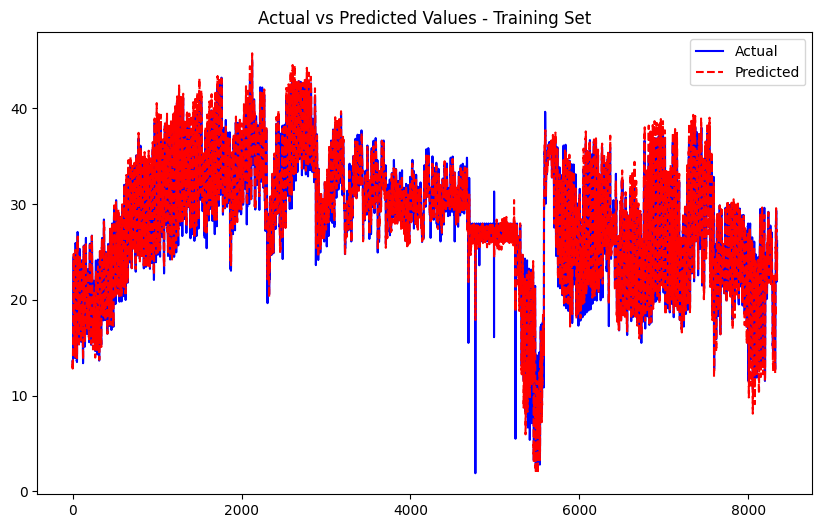

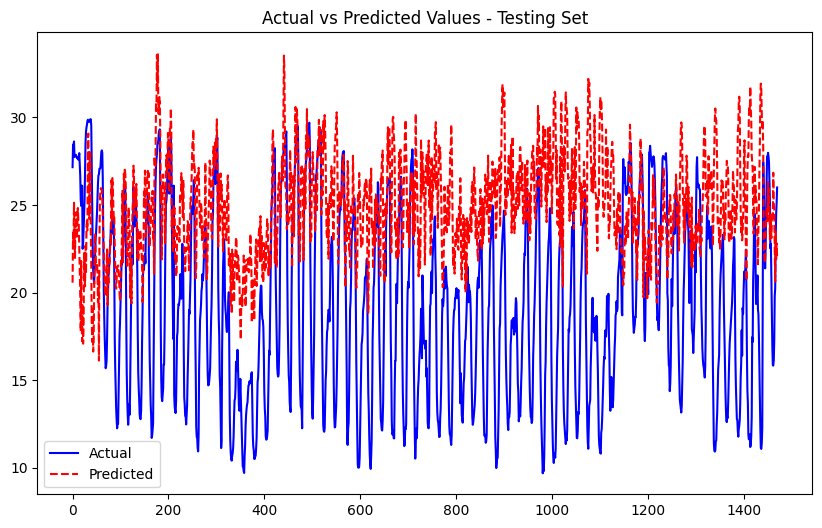

Processing node 11...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0961
Epoch [2/50], Train Loss: 0.0800
Epoch [3/50], Train Loss: 0.0629
Epoch [4/50], Train Loss: 0.0526
Epoch [5/50], Train Loss: 0.0470
Epoch [6/50], Train Loss: 0.0420
Epoch [7/50], Train Loss: 0.0391
Epoch [8/50], Train Loss: 0.0376
Epoch [9/50], Train Loss: 0.0353
Epoch [10/50], Train Loss: 0.0350
Epoch [11/50], Train Loss: 0.0338
Epoch [12/50], Train Loss: 0.0335
Epoch [13/50], Train Loss: 0.0321
Epoch [14/50], Train Loss: 0.0320
Epoch [15/50], Train Loss: 0.0321
Epoch [16/50], Train Loss: 0.0308
Epoch [17/50], Train Loss: 0.0306
Epoch [18/50], Train Loss: 0.0309
Epoch [19/50], Train Loss: 0.0301
Epoch [20/50], Train Loss: 0.0299
Epoch [21/50], Train Loss: 0.0301
Epoch [22/50], Train Loss: 0.0294
Epoch [23/50], Train Loss: 0.0296
Epoch [24/50], Train Loss: 0.0294
Epoch [25/50], Train Loss: 0.0290
Epoch [26/50], Train Loss: 0.0287
Epoch [27/50], Train Loss: 0.0283
Epoch [28/50], Train Loss: 0.0285
Epoch [29/50], Train Loss: 0.0286
Epoch [30/50], Train Lo

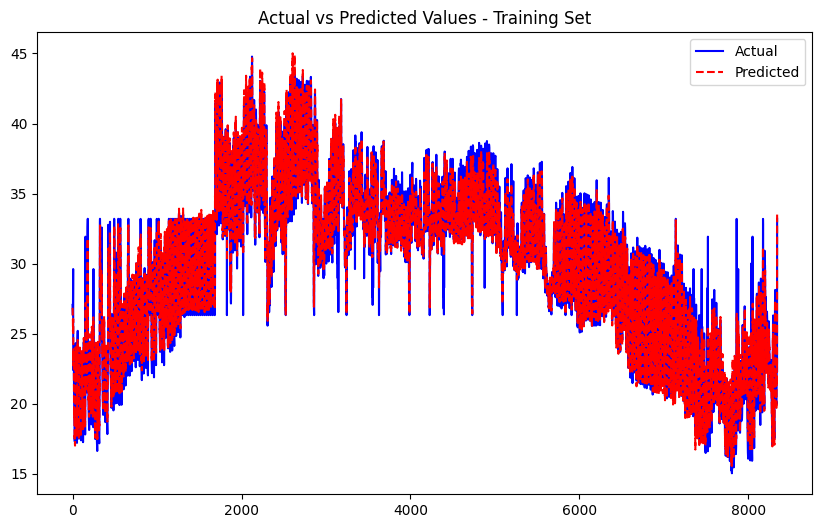

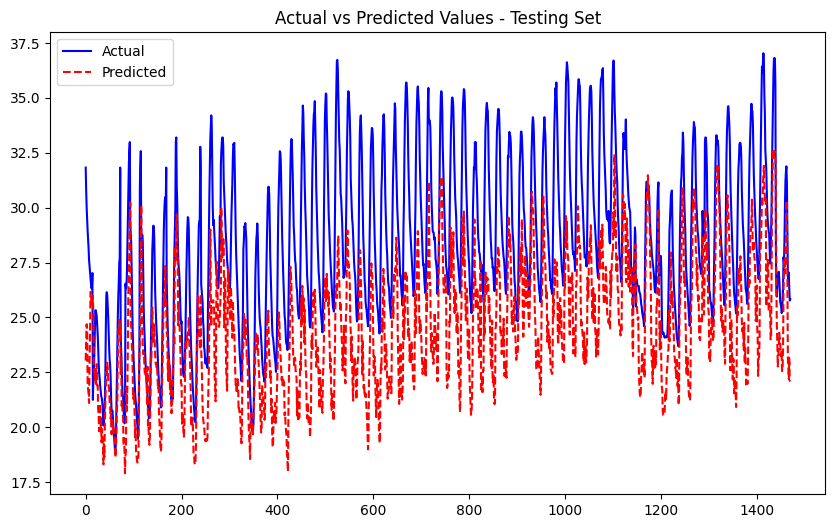

Processing node 12...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0427
Epoch [2/50], Train Loss: 0.0339
Epoch [3/50], Train Loss: 0.0295
Epoch [4/50], Train Loss: 0.0274
Epoch [5/50], Train Loss: 0.0258
Epoch [6/50], Train Loss: 0.0248
Epoch [7/50], Train Loss: 0.0238
Epoch [8/50], Train Loss: 0.0231
Epoch [9/50], Train Loss: 0.0225
Epoch [10/50], Train Loss: 0.0217
Epoch [11/50], Train Loss: 0.0219
Epoch [12/50], Train Loss: 0.0212
Epoch [13/50], Train Loss: 0.0208
Epoch [14/50], Train Loss: 0.0206
Epoch [15/50], Train Loss: 0.0207
Epoch [16/50], Train Loss: 0.0206
Epoch [17/50], Train Loss: 0.0196
Epoch [18/50], Train Loss: 0.0197
Epoch [19/50], Train Loss: 0.0198
Epoch [20/50], Train Loss: 0.0197
Epoch [21/50], Train Loss: 0.0196
Epoch [22/50], Train Loss: 0.0195
Epoch [23/50], Train Loss: 0.0189
Epoch [24/50], Train Loss: 0.0190
Epoch [25/50], Train Loss: 0.0188
Epoch [26/50], Train Loss: 0.0186
Epoch [27/50], Train Loss: 0.0186
Epoch [28/50], Train Loss: 0.0189
Epoch [29/50], Train Loss: 0.0185
Epoch [30/50], Train Lo

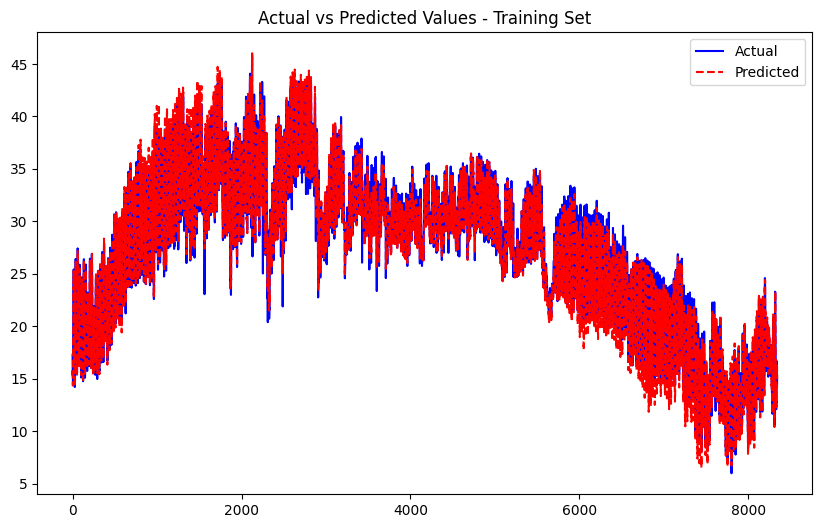

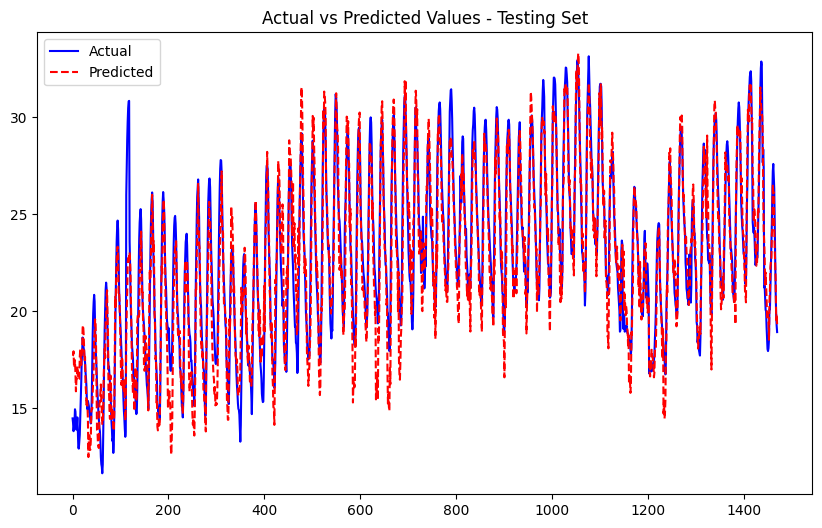

Processing node 13...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1404
Epoch [2/50], Train Loss: 0.1153
Epoch [3/50], Train Loss: 0.0916
Epoch [4/50], Train Loss: 0.0767
Epoch [5/50], Train Loss: 0.0653
Epoch [6/50], Train Loss: 0.0597
Epoch [7/50], Train Loss: 0.0542
Epoch [8/50], Train Loss: 0.0487
Epoch [9/50], Train Loss: 0.0439
Epoch [10/50], Train Loss: 0.0413
Epoch [11/50], Train Loss: 0.0379
Epoch [12/50], Train Loss: 0.0369
Epoch [13/50], Train Loss: 0.0345
Epoch [14/50], Train Loss: 0.0315
Epoch [15/50], Train Loss: 0.0309
Epoch [16/50], Train Loss: 0.0300
Epoch [17/50], Train Loss: 0.0293
Epoch [18/50], Train Loss: 0.0288
Epoch [19/50], Train Loss: 0.0290
Epoch [20/50], Train Loss: 0.0264
Epoch [21/50], Train Loss: 0.0258
Epoch [22/50], Train Loss: 0.0266
Epoch [23/50], Train Loss: 0.0255
Epoch [24/50], Train Loss: 0.0248
Epoch [25/50], Train Loss: 0.0246
Epoch [26/50], Train Loss: 0.0254
Epoch [27/50], Train Loss: 0.0248
Epoch [28/50], Train Loss: 0.0251
Epoch [29/50], Train Loss: 0.0233
Epoch [30/50], Train Lo

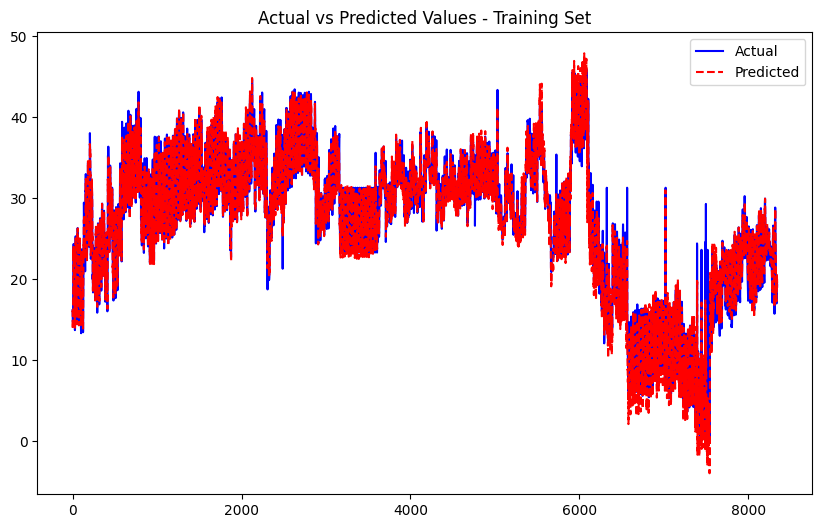

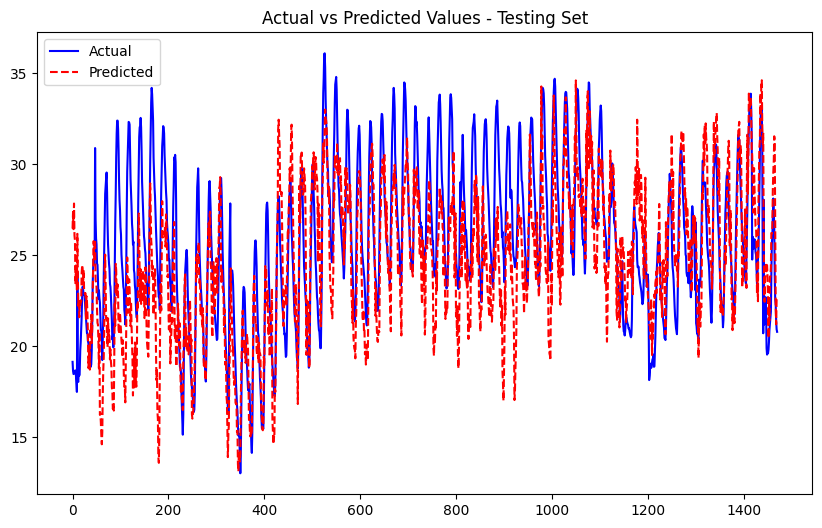

Processing node 14...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0575
Epoch [2/50], Train Loss: 0.0426
Epoch [3/50], Train Loss: 0.0367
Epoch [4/50], Train Loss: 0.0331
Epoch [5/50], Train Loss: 0.0310
Epoch [6/50], Train Loss: 0.0289
Epoch [7/50], Train Loss: 0.0279
Epoch [8/50], Train Loss: 0.0271
Epoch [9/50], Train Loss: 0.0262
Epoch [10/50], Train Loss: 0.0258
Epoch [11/50], Train Loss: 0.0256
Epoch [12/50], Train Loss: 0.0250
Epoch [13/50], Train Loss: 0.0254
Epoch [14/50], Train Loss: 0.0248
Epoch [15/50], Train Loss: 0.0241
Epoch [16/50], Train Loss: 0.0241
Epoch [17/50], Train Loss: 0.0237
Epoch [18/50], Train Loss: 0.0237
Epoch [19/50], Train Loss: 0.0238
Epoch [20/50], Train Loss: 0.0233
Epoch [21/50], Train Loss: 0.0232
Epoch [22/50], Train Loss: 0.0230
Epoch [23/50], Train Loss: 0.0229
Epoch [24/50], Train Loss: 0.0232
Epoch [25/50], Train Loss: 0.0228
Epoch [26/50], Train Loss: 0.0228
Epoch [27/50], Train Loss: 0.0222
Epoch [28/50], Train Loss: 0.0223
Epoch [29/50], Train Loss: 0.0225
Epoch [30/50], Train Lo

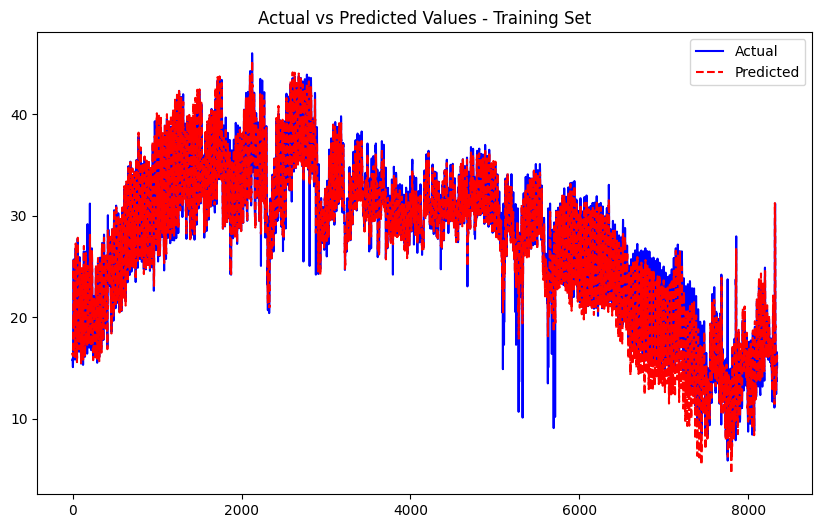

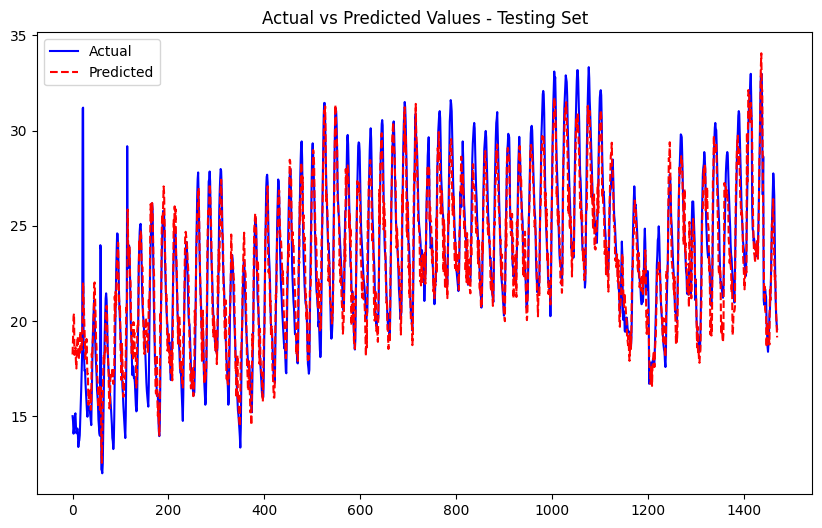

Processing node 15...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0786
Epoch [2/50], Train Loss: 0.0645
Epoch [3/50], Train Loss: 0.0560
Epoch [4/50], Train Loss: 0.0512
Epoch [5/50], Train Loss: 0.0475
Epoch [6/50], Train Loss: 0.0443
Epoch [7/50], Train Loss: 0.0425
Epoch [8/50], Train Loss: 0.0409
Epoch [9/50], Train Loss: 0.0396
Epoch [10/50], Train Loss: 0.0382
Epoch [11/50], Train Loss: 0.0380
Epoch [12/50], Train Loss: 0.0373
Epoch [13/50], Train Loss: 0.0365
Epoch [14/50], Train Loss: 0.0364
Epoch [15/50], Train Loss: 0.0352
Epoch [16/50], Train Loss: 0.0350
Epoch [17/50], Train Loss: 0.0355
Epoch [18/50], Train Loss: 0.0346
Epoch [19/50], Train Loss: 0.0343
Epoch [20/50], Train Loss: 0.0342
Epoch [21/50], Train Loss: 0.0338
Epoch [22/50], Train Loss: 0.0337
Epoch [23/50], Train Loss: 0.0340
Epoch [24/50], Train Loss: 0.0336
Epoch [25/50], Train Loss: 0.0335
Epoch [26/50], Train Loss: 0.0332
Epoch [27/50], Train Loss: 0.0331
Epoch [28/50], Train Loss: 0.0333
Epoch [29/50], Train Loss: 0.0331
Epoch [30/50], Train Lo

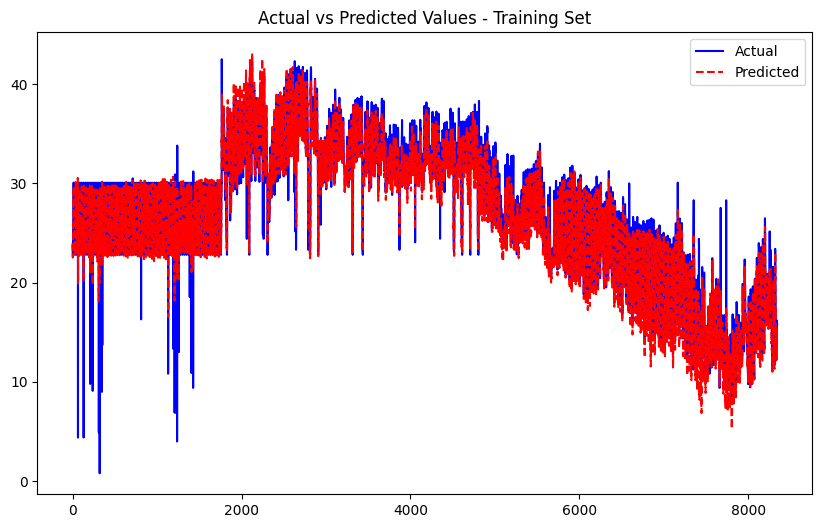

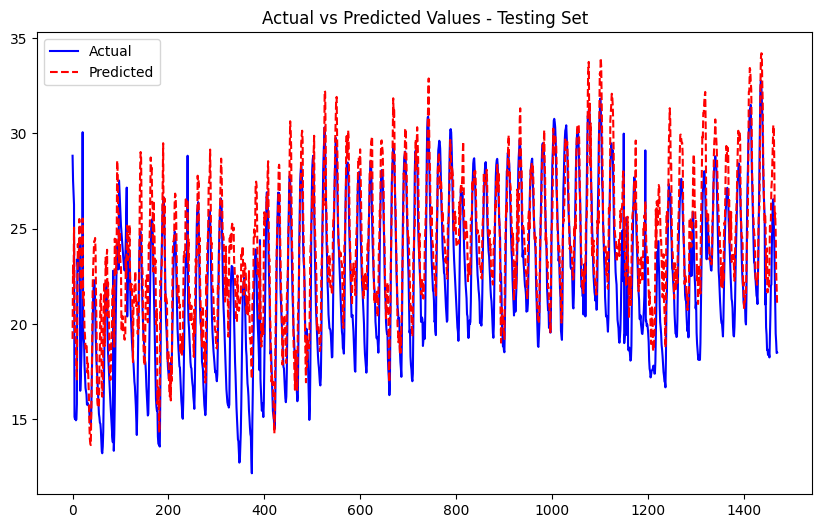

Processing node 16...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1430
Epoch [2/50], Train Loss: 0.1209
Epoch [3/50], Train Loss: 0.1022
Epoch [4/50], Train Loss: 0.0913
Epoch [5/50], Train Loss: 0.0804
Epoch [6/50], Train Loss: 0.0720
Epoch [7/50], Train Loss: 0.0646
Epoch [8/50], Train Loss: 0.0582
Epoch [9/50], Train Loss: 0.0545
Epoch [10/50], Train Loss: 0.0489
Epoch [11/50], Train Loss: 0.0473
Epoch [12/50], Train Loss: 0.0448
Epoch [13/50], Train Loss: 0.0429
Epoch [14/50], Train Loss: 0.0409
Epoch [15/50], Train Loss: 0.0397
Epoch [16/50], Train Loss: 0.0381
Epoch [17/50], Train Loss: 0.0385
Epoch [18/50], Train Loss: 0.0359
Epoch [19/50], Train Loss: 0.0363
Epoch [20/50], Train Loss: 0.0344
Epoch [21/50], Train Loss: 0.0328
Epoch [22/50], Train Loss: 0.0339
Epoch [23/50], Train Loss: 0.0328
Epoch [24/50], Train Loss: 0.0302
Epoch [25/50], Train Loss: 0.0308
Epoch [26/50], Train Loss: 0.0299
Epoch [27/50], Train Loss: 0.0306
Epoch [28/50], Train Loss: 0.0301
Epoch [29/50], Train Loss: 0.0289
Epoch [30/50], Train Lo

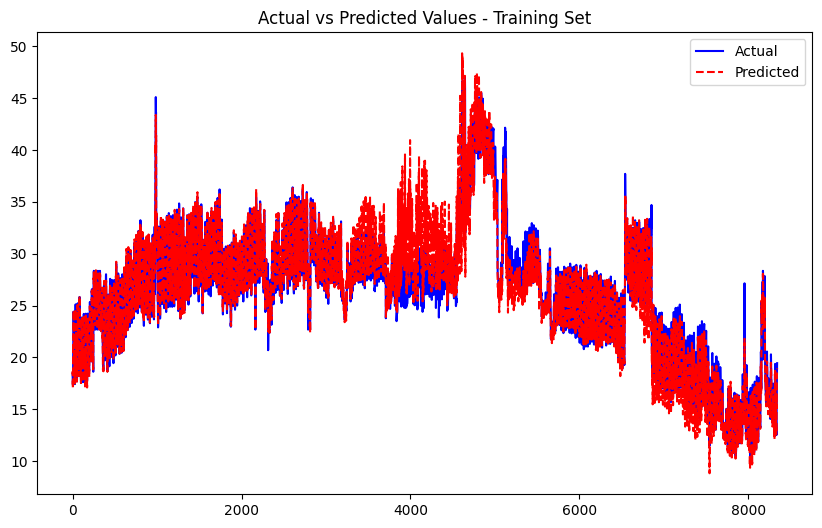

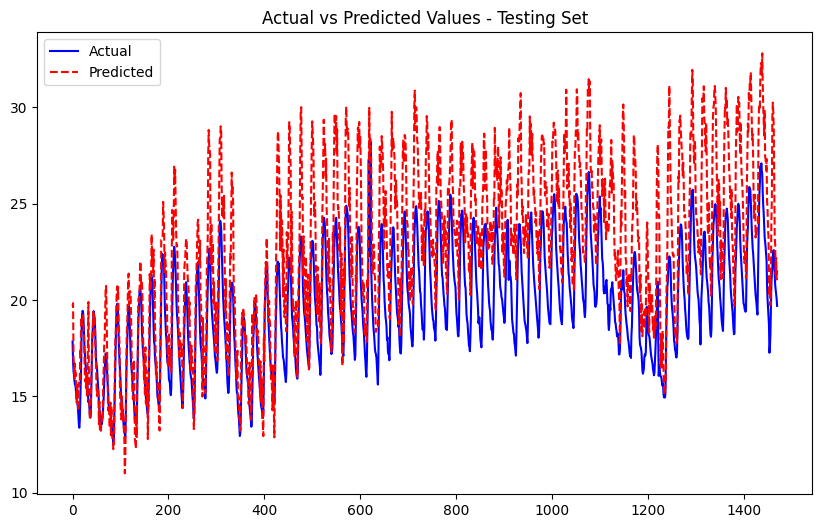

Processing node 17...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0747
Epoch [2/50], Train Loss: 0.0530
Epoch [3/50], Train Loss: 0.0447
Epoch [4/50], Train Loss: 0.0391
Epoch [5/50], Train Loss: 0.0353
Epoch [6/50], Train Loss: 0.0326
Epoch [7/50], Train Loss: 0.0308
Epoch [8/50], Train Loss: 0.0295
Epoch [9/50], Train Loss: 0.0282
Epoch [10/50], Train Loss: 0.0273
Epoch [11/50], Train Loss: 0.0265
Epoch [12/50], Train Loss: 0.0261
Epoch [13/50], Train Loss: 0.0255
Epoch [14/50], Train Loss: 0.0249
Epoch [15/50], Train Loss: 0.0244
Epoch [16/50], Train Loss: 0.0241
Epoch [17/50], Train Loss: 0.0238
Epoch [18/50], Train Loss: 0.0240
Epoch [19/50], Train Loss: 0.0241
Epoch [20/50], Train Loss: 0.0243
Epoch [21/50], Train Loss: 0.0229
Epoch [22/50], Train Loss: 0.0230
Epoch [23/50], Train Loss: 0.0232
Epoch [24/50], Train Loss: 0.0225
Epoch [25/50], Train Loss: 0.0225
Epoch [26/50], Train Loss: 0.0225
Epoch [27/50], Train Loss: 0.0223
Epoch [28/50], Train Loss: 0.0220
Epoch [29/50], Train Loss: 0.0219
Epoch [30/50], Train Lo

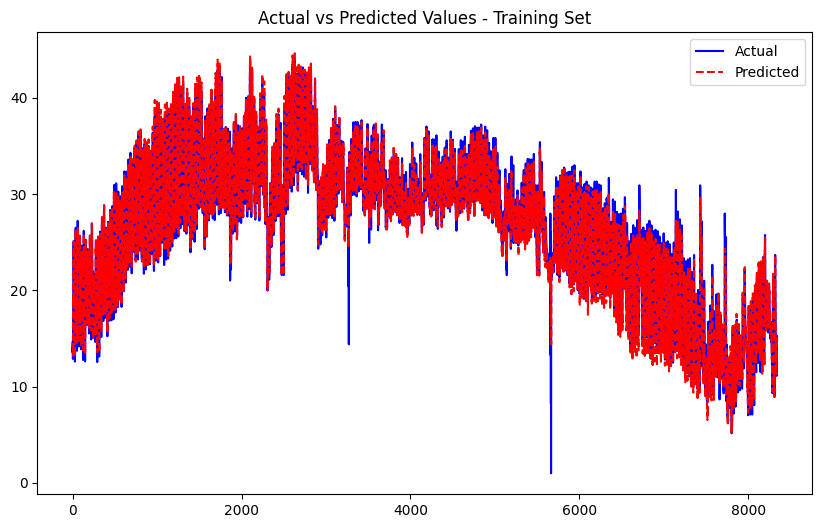

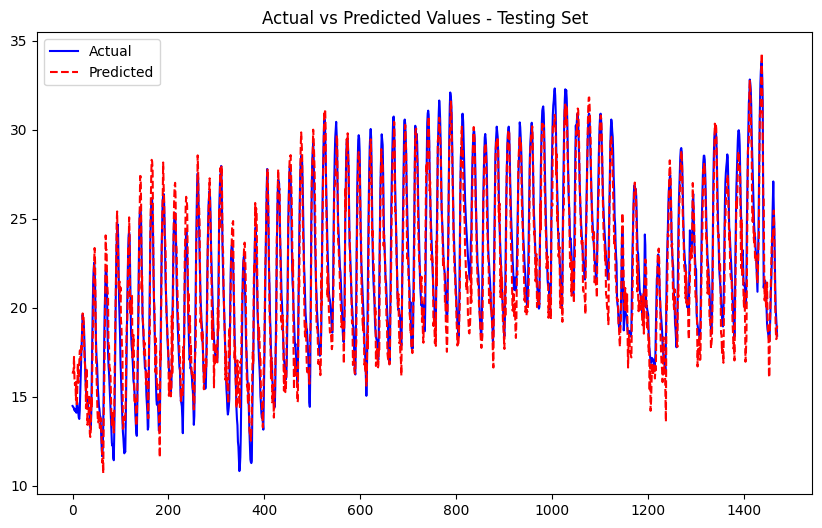

Processing node 18...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0545
Epoch [2/50], Train Loss: 0.0428
Epoch [3/50], Train Loss: 0.0379
Epoch [4/50], Train Loss: 0.0347
Epoch [5/50], Train Loss: 0.0321
Epoch [6/50], Train Loss: 0.0306
Epoch [7/50], Train Loss: 0.0296
Epoch [8/50], Train Loss: 0.0278
Epoch [9/50], Train Loss: 0.0270
Epoch [10/50], Train Loss: 0.0263
Epoch [11/50], Train Loss: 0.0260
Epoch [12/50], Train Loss: 0.0253
Epoch [13/50], Train Loss: 0.0248
Epoch [14/50], Train Loss: 0.0246
Epoch [15/50], Train Loss: 0.0245
Epoch [16/50], Train Loss: 0.0240
Epoch [17/50], Train Loss: 0.0238
Epoch [18/50], Train Loss: 0.0233
Epoch [19/50], Train Loss: 0.0232
Epoch [20/50], Train Loss: 0.0232
Epoch [21/50], Train Loss: 0.0235
Epoch [22/50], Train Loss: 0.0234
Epoch [23/50], Train Loss: 0.0228
Epoch [24/50], Train Loss: 0.0228
Epoch [25/50], Train Loss: 0.0227
Epoch [26/50], Train Loss: 0.0226
Epoch [27/50], Train Loss: 0.0224
Epoch [28/50], Train Loss: 0.0227
Epoch [29/50], Train Loss: 0.0224
Epoch [30/50], Train Lo

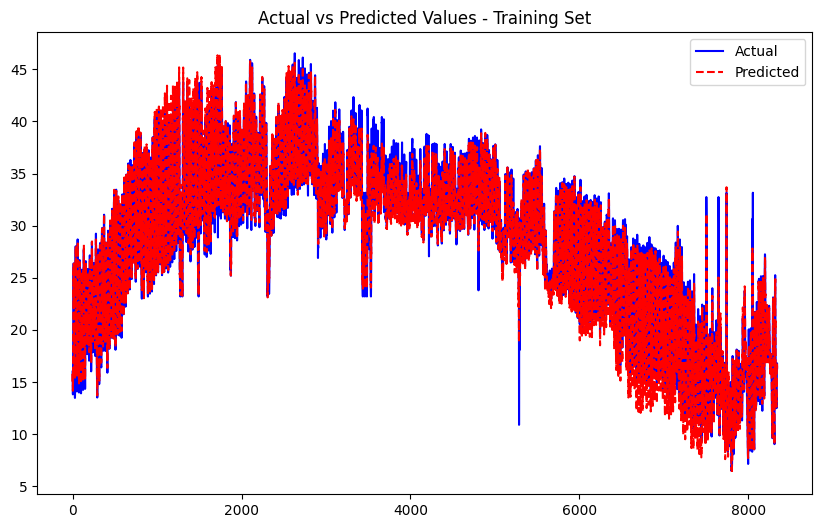

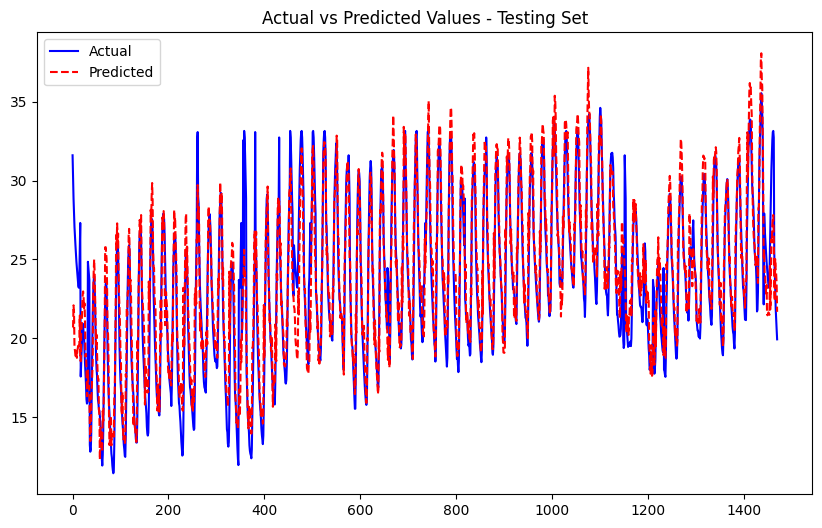

Processing node 19...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0689
Epoch [2/50], Train Loss: 0.0554
Epoch [3/50], Train Loss: 0.0491
Epoch [4/50], Train Loss: 0.0462
Epoch [5/50], Train Loss: 0.0440
Epoch [6/50], Train Loss: 0.0422
Epoch [7/50], Train Loss: 0.0407
Epoch [8/50], Train Loss: 0.0399
Epoch [9/50], Train Loss: 0.0392
Epoch [10/50], Train Loss: 0.0385
Epoch [11/50], Train Loss: 0.0385
Epoch [12/50], Train Loss: 0.0374
Epoch [13/50], Train Loss: 0.0371
Epoch [14/50], Train Loss: 0.0365
Epoch [15/50], Train Loss: 0.0364
Epoch [16/50], Train Loss: 0.0360
Epoch [17/50], Train Loss: 0.0356
Epoch [18/50], Train Loss: 0.0355
Epoch [19/50], Train Loss: 0.0357
Epoch [20/50], Train Loss: 0.0352
Epoch [21/50], Train Loss: 0.0354
Epoch [22/50], Train Loss: 0.0347
Epoch [23/50], Train Loss: 0.0351
Epoch [24/50], Train Loss: 0.0348
Epoch [25/50], Train Loss: 0.0343
Epoch [26/50], Train Loss: 0.0344
Epoch [27/50], Train Loss: 0.0343
Epoch [28/50], Train Loss: 0.0342
Epoch [29/50], Train Loss: 0.0341
Epoch [30/50], Train Lo

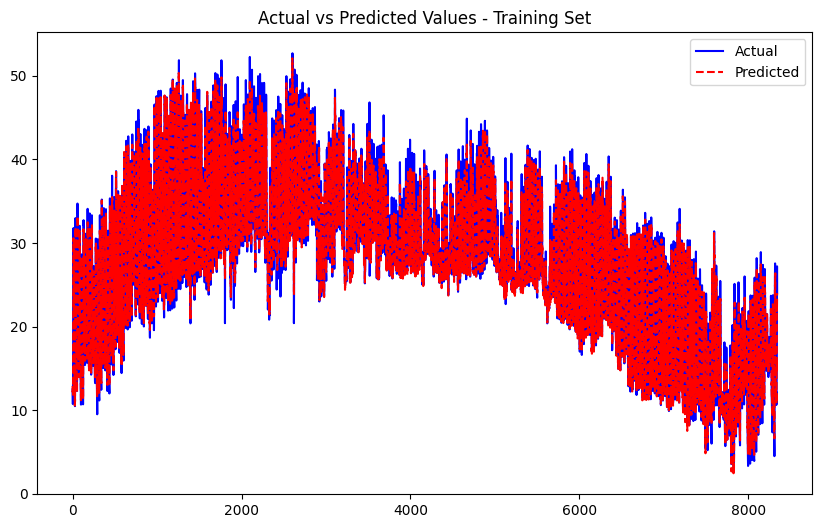

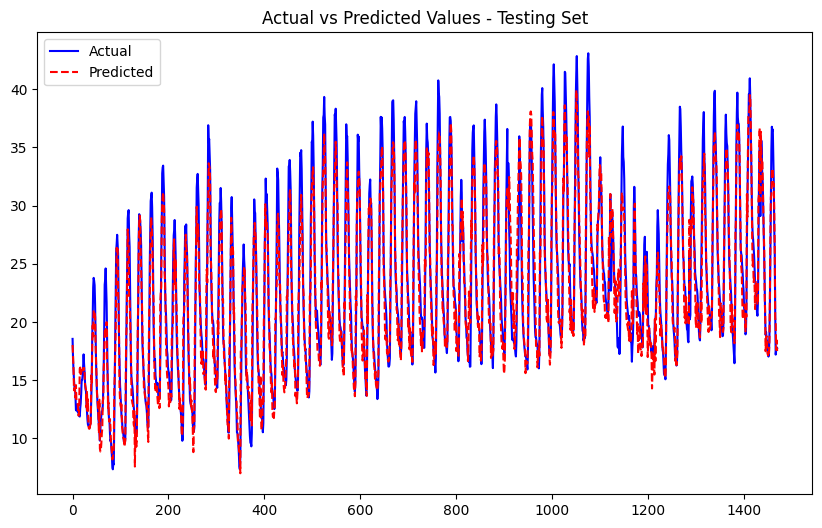

Processing node 20...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0623
Epoch [2/50], Train Loss: 0.0498
Epoch [3/50], Train Loss: 0.0444
Epoch [4/50], Train Loss: 0.0398
Epoch [5/50], Train Loss: 0.0378
Epoch [6/50], Train Loss: 0.0355
Epoch [7/50], Train Loss: 0.0338
Epoch [8/50], Train Loss: 0.0326
Epoch [9/50], Train Loss: 0.0322
Epoch [10/50], Train Loss: 0.0310
Epoch [11/50], Train Loss: 0.0307
Epoch [12/50], Train Loss: 0.0301
Epoch [13/50], Train Loss: 0.0299
Epoch [14/50], Train Loss: 0.0290
Epoch [15/50], Train Loss: 0.0289
Epoch [16/50], Train Loss: 0.0289
Epoch [17/50], Train Loss: 0.0283
Epoch [18/50], Train Loss: 0.0282
Epoch [19/50], Train Loss: 0.0282
Epoch [20/50], Train Loss: 0.0280
Epoch [21/50], Train Loss: 0.0276
Epoch [22/50], Train Loss: 0.0279
Epoch [23/50], Train Loss: 0.0274
Epoch [24/50], Train Loss: 0.0276
Epoch [25/50], Train Loss: 0.0273
Epoch [26/50], Train Loss: 0.0274
Epoch [27/50], Train Loss: 0.0274
Epoch [28/50], Train Loss: 0.0272
Epoch [29/50], Train Loss: 0.0272
Epoch [30/50], Train Lo

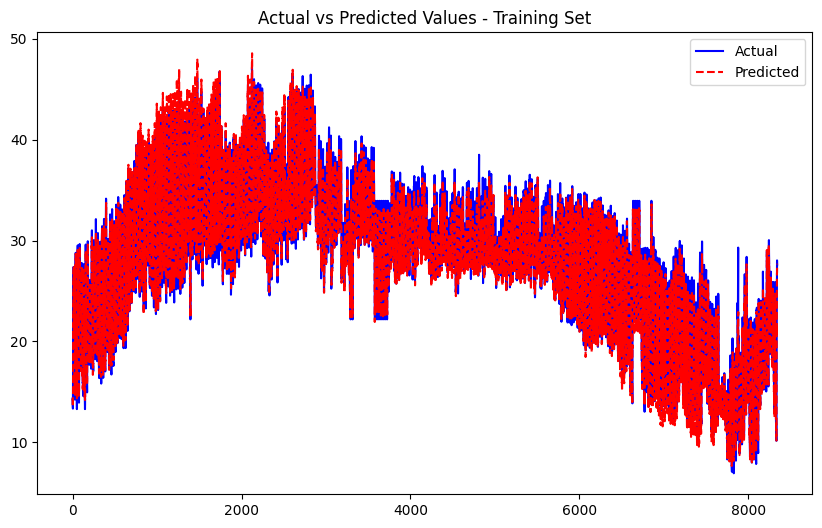

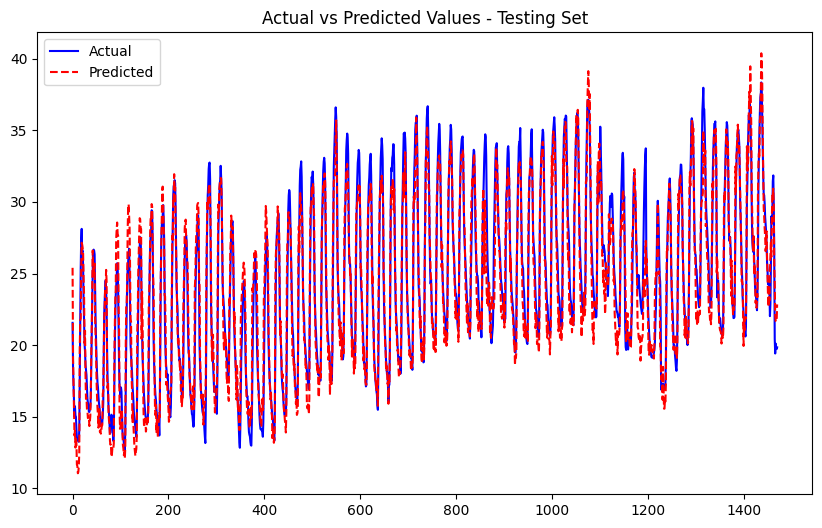

Processing node 21...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0464
Epoch [2/50], Train Loss: 0.0396
Epoch [3/50], Train Loss: 0.0360
Epoch [4/50], Train Loss: 0.0343
Epoch [5/50], Train Loss: 0.0328
Epoch [6/50], Train Loss: 0.0315
Epoch [7/50], Train Loss: 0.0311
Epoch [8/50], Train Loss: 0.0302
Epoch [9/50], Train Loss: 0.0298
Epoch [10/50], Train Loss: 0.0292
Epoch [11/50], Train Loss: 0.0290
Epoch [12/50], Train Loss: 0.0286
Epoch [13/50], Train Loss: 0.0282
Epoch [14/50], Train Loss: 0.0280
Epoch [15/50], Train Loss: 0.0279
Epoch [16/50], Train Loss: 0.0276
Epoch [17/50], Train Loss: 0.0278
Epoch [18/50], Train Loss: 0.0273
Epoch [19/50], Train Loss: 0.0275
Epoch [20/50], Train Loss: 0.0271
Epoch [21/50], Train Loss: 0.0272
Epoch [22/50], Train Loss: 0.0268
Epoch [23/50], Train Loss: 0.0272
Epoch [24/50], Train Loss: 0.0270
Epoch [25/50], Train Loss: 0.0267
Epoch [26/50], Train Loss: 0.0265
Epoch [27/50], Train Loss: 0.0265
Epoch [28/50], Train Loss: 0.0263
Epoch [29/50], Train Loss: 0.0265
Epoch [30/50], Train Lo

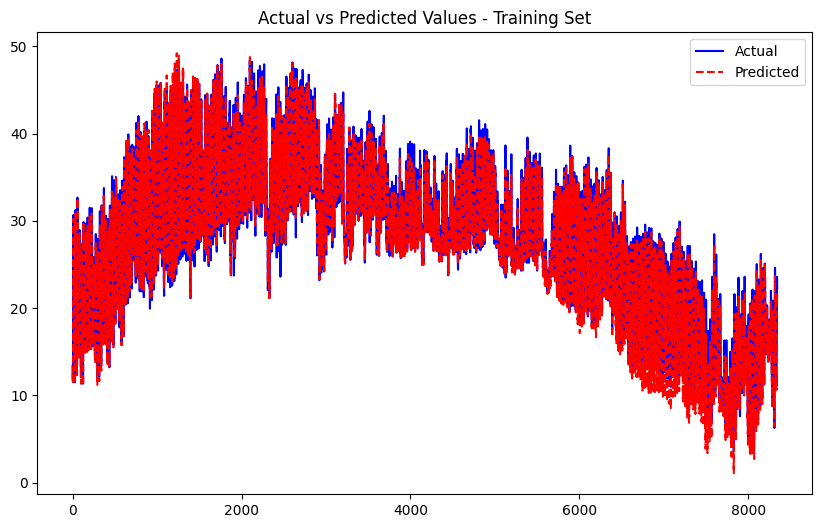

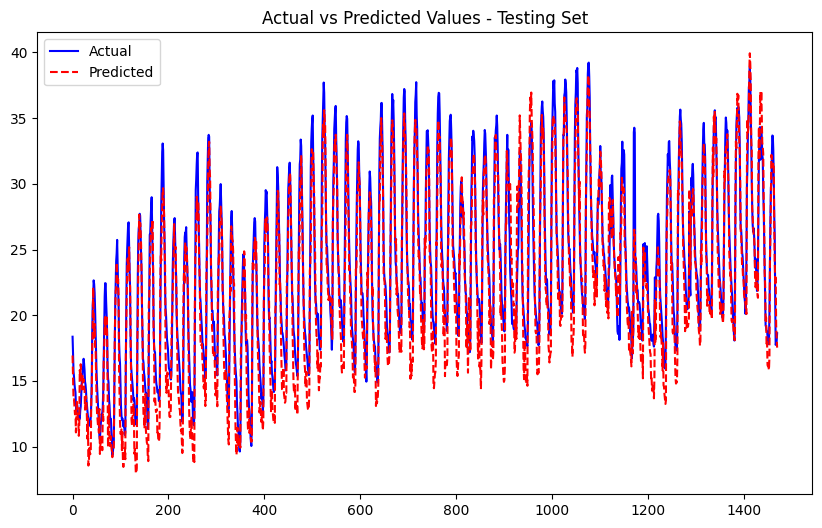

Processing node 22...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0597
Epoch [2/50], Train Loss: 0.0509
Epoch [3/50], Train Loss: 0.0455
Epoch [4/50], Train Loss: 0.0431
Epoch [5/50], Train Loss: 0.0413
Epoch [6/50], Train Loss: 0.0396
Epoch [7/50], Train Loss: 0.0384
Epoch [8/50], Train Loss: 0.0376
Epoch [9/50], Train Loss: 0.0367
Epoch [10/50], Train Loss: 0.0365
Epoch [11/50], Train Loss: 0.0358
Epoch [12/50], Train Loss: 0.0354
Epoch [13/50], Train Loss: 0.0354
Epoch [14/50], Train Loss: 0.0349
Epoch [15/50], Train Loss: 0.0346
Epoch [16/50], Train Loss: 0.0345
Epoch [17/50], Train Loss: 0.0343
Epoch [18/50], Train Loss: 0.0343
Epoch [19/50], Train Loss: 0.0342
Epoch [20/50], Train Loss: 0.0340
Epoch [21/50], Train Loss: 0.0337
Epoch [22/50], Train Loss: 0.0334
Epoch [23/50], Train Loss: 0.0336
Epoch [24/50], Train Loss: 0.0335
Epoch [25/50], Train Loss: 0.0334
Epoch [26/50], Train Loss: 0.0331
Epoch [27/50], Train Loss: 0.0331
Epoch [28/50], Train Loss: 0.0329
Epoch [29/50], Train Loss: 0.0329
Epoch [30/50], Train Lo

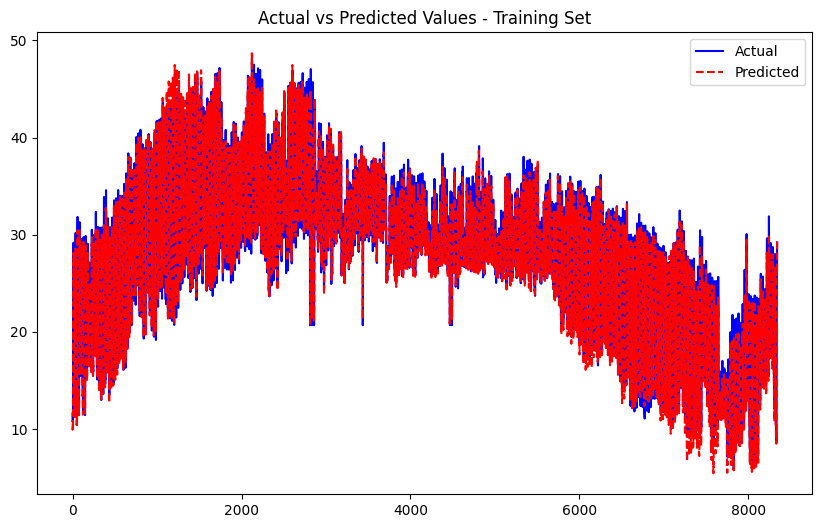

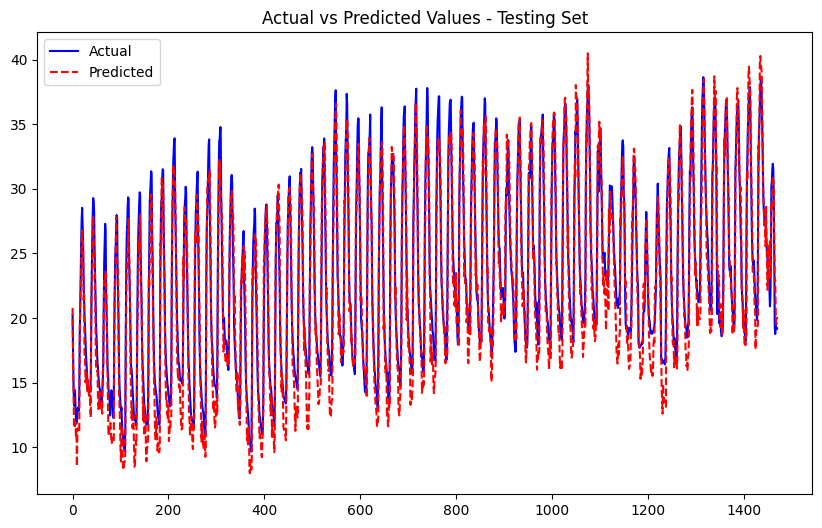

Processing node 23...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0624
Epoch [2/50], Train Loss: 0.0529
Epoch [3/50], Train Loss: 0.0473
Epoch [4/50], Train Loss: 0.0437
Epoch [5/50], Train Loss: 0.0410
Epoch [6/50], Train Loss: 0.0383
Epoch [7/50], Train Loss: 0.0373
Epoch [8/50], Train Loss: 0.0357
Epoch [9/50], Train Loss: 0.0343
Epoch [10/50], Train Loss: 0.0339
Epoch [11/50], Train Loss: 0.0331
Epoch [12/50], Train Loss: 0.0320
Epoch [13/50], Train Loss: 0.0314
Epoch [14/50], Train Loss: 0.0315
Epoch [15/50], Train Loss: 0.0313
Epoch [16/50], Train Loss: 0.0304
Epoch [17/50], Train Loss: 0.0298
Epoch [18/50], Train Loss: 0.0299
Epoch [19/50], Train Loss: 0.0299
Epoch [20/50], Train Loss: 0.0296
Epoch [21/50], Train Loss: 0.0294
Epoch [22/50], Train Loss: 0.0287
Epoch [23/50], Train Loss: 0.0291
Epoch [24/50], Train Loss: 0.0287
Epoch [25/50], Train Loss: 0.0286
Epoch [26/50], Train Loss: 0.0285
Epoch [27/50], Train Loss: 0.0284
Epoch [28/50], Train Loss: 0.0285
Epoch [29/50], Train Loss: 0.0282
Epoch [30/50], Train Lo

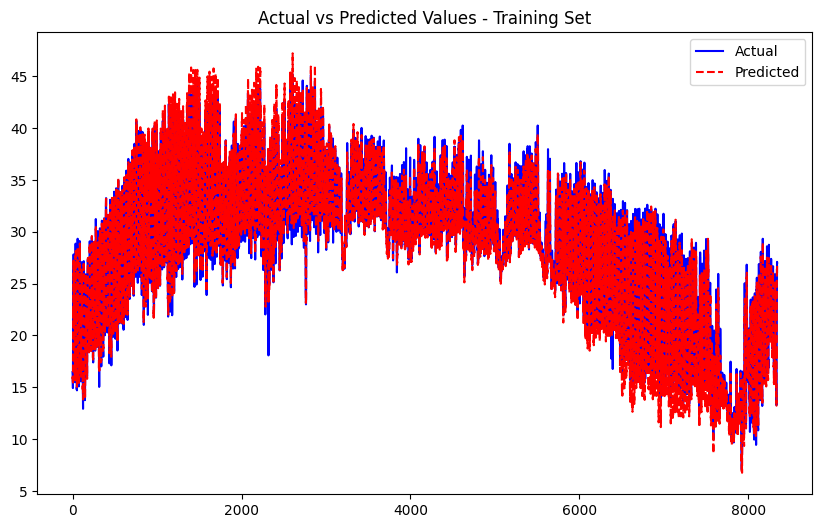

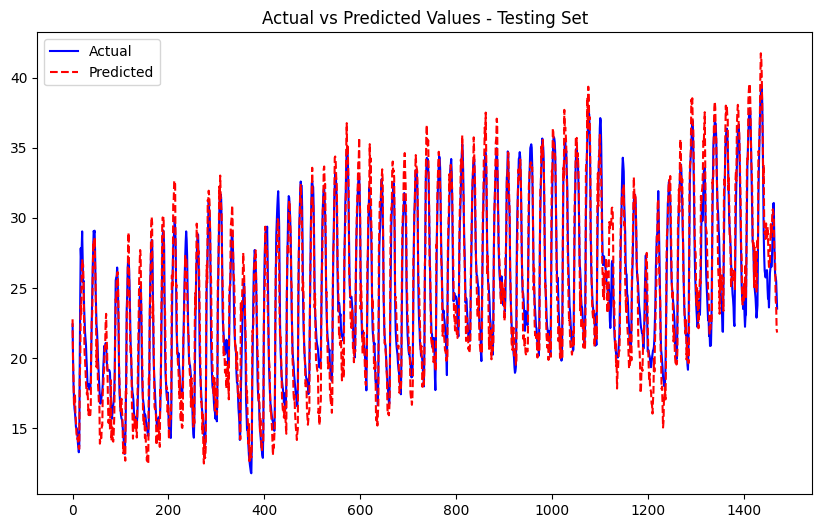

Processing node 24...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0560
Epoch [2/50], Train Loss: 0.0450
Epoch [3/50], Train Loss: 0.0398
Epoch [4/50], Train Loss: 0.0361
Epoch [5/50], Train Loss: 0.0344
Epoch [6/50], Train Loss: 0.0328
Epoch [7/50], Train Loss: 0.0317
Epoch [8/50], Train Loss: 0.0312
Epoch [9/50], Train Loss: 0.0303
Epoch [10/50], Train Loss: 0.0296
Epoch [11/50], Train Loss: 0.0294
Epoch [12/50], Train Loss: 0.0289
Epoch [13/50], Train Loss: 0.0287
Epoch [14/50], Train Loss: 0.0286
Epoch [15/50], Train Loss: 0.0281
Epoch [16/50], Train Loss: 0.0278
Epoch [17/50], Train Loss: 0.0275
Epoch [18/50], Train Loss: 0.0277
Epoch [19/50], Train Loss: 0.0274
Epoch [20/50], Train Loss: 0.0272
Epoch [21/50], Train Loss: 0.0271
Epoch [22/50], Train Loss: 0.0271
Epoch [23/50], Train Loss: 0.0267
Epoch [24/50], Train Loss: 0.0270
Epoch [25/50], Train Loss: 0.0269
Epoch [26/50], Train Loss: 0.0268
Epoch [27/50], Train Loss: 0.0267
Epoch [28/50], Train Loss: 0.0265
Epoch [29/50], Train Loss: 0.0264
Epoch [30/50], Train Lo

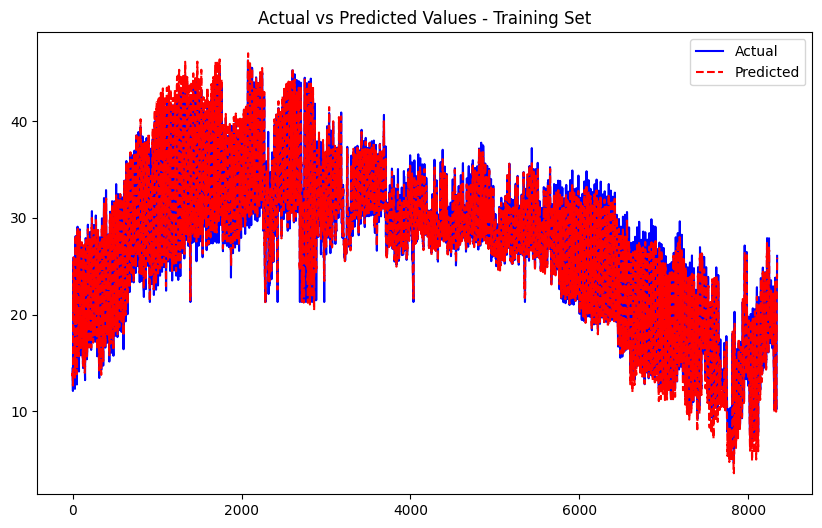

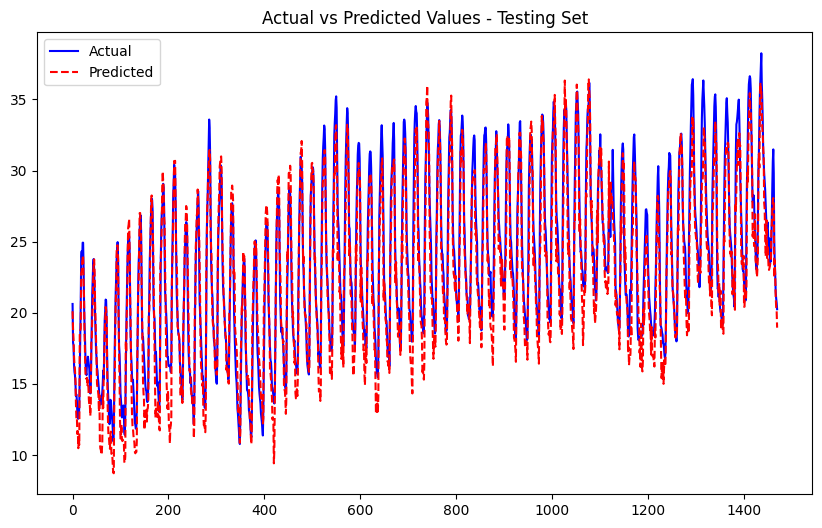

Processing node 25...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0507
Epoch [2/50], Train Loss: 0.0442
Epoch [3/50], Train Loss: 0.0378
Epoch [4/50], Train Loss: 0.0342
Epoch [5/50], Train Loss: 0.0324
Epoch [6/50], Train Loss: 0.0306
Epoch [7/50], Train Loss: 0.0291
Epoch [8/50], Train Loss: 0.0283
Epoch [9/50], Train Loss: 0.0275
Epoch [10/50], Train Loss: 0.0266
Epoch [11/50], Train Loss: 0.0264
Epoch [12/50], Train Loss: 0.0261
Epoch [13/50], Train Loss: 0.0254
Epoch [14/50], Train Loss: 0.0250
Epoch [15/50], Train Loss: 0.0248
Epoch [16/50], Train Loss: 0.0246
Epoch [17/50], Train Loss: 0.0243
Epoch [18/50], Train Loss: 0.0240
Epoch [19/50], Train Loss: 0.0240
Epoch [20/50], Train Loss: 0.0241
Epoch [21/50], Train Loss: 0.0237
Epoch [22/50], Train Loss: 0.0237
Epoch [23/50], Train Loss: 0.0234
Epoch [24/50], Train Loss: 0.0233
Epoch [25/50], Train Loss: 0.0233
Epoch [26/50], Train Loss: 0.0232
Epoch [27/50], Train Loss: 0.0233
Epoch [28/50], Train Loss: 0.0228
Epoch [29/50], Train Loss: 0.0229
Epoch [30/50], Train Lo

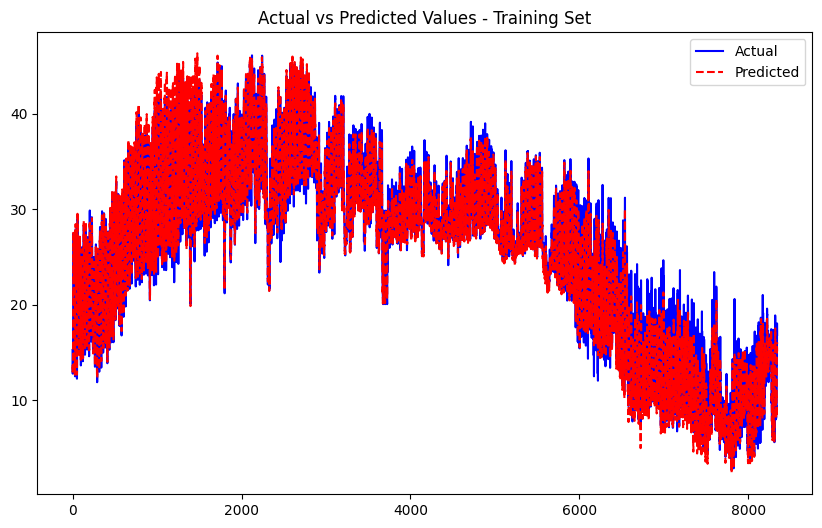

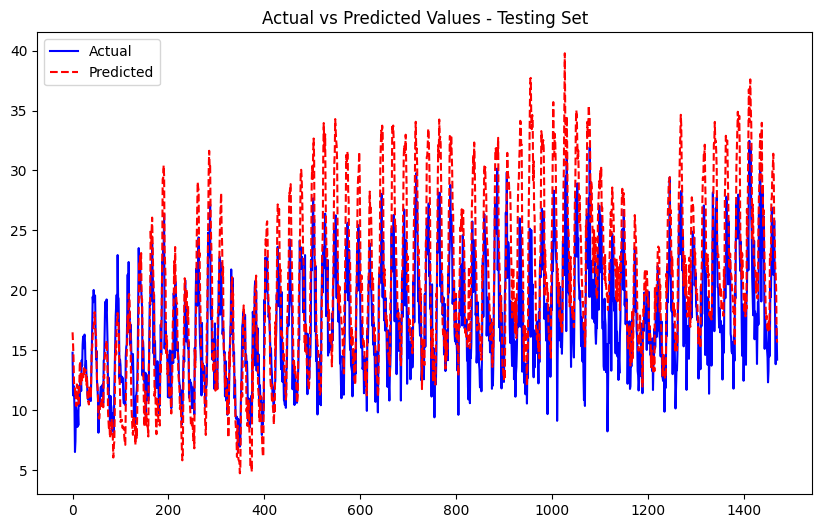

Processing node 26...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0560
Epoch [2/50], Train Loss: 0.0452
Epoch [3/50], Train Loss: 0.0401
Epoch [4/50], Train Loss: 0.0370
Epoch [5/50], Train Loss: 0.0344
Epoch [6/50], Train Loss: 0.0327
Epoch [7/50], Train Loss: 0.0313
Epoch [8/50], Train Loss: 0.0304
Epoch [9/50], Train Loss: 0.0296
Epoch [10/50], Train Loss: 0.0287
Epoch [11/50], Train Loss: 0.0282
Epoch [12/50], Train Loss: 0.0278
Epoch [13/50], Train Loss: 0.0275
Epoch [14/50], Train Loss: 0.0272
Epoch [15/50], Train Loss: 0.0270
Epoch [16/50], Train Loss: 0.0267
Epoch [17/50], Train Loss: 0.0266
Epoch [18/50], Train Loss: 0.0263
Epoch [19/50], Train Loss: 0.0263
Epoch [20/50], Train Loss: 0.0259
Epoch [21/50], Train Loss: 0.0260
Epoch [22/50], Train Loss: 0.0260
Epoch [23/50], Train Loss: 0.0257
Epoch [24/50], Train Loss: 0.0256
Epoch [25/50], Train Loss: 0.0255
Epoch [26/50], Train Loss: 0.0255
Epoch [27/50], Train Loss: 0.0254
Epoch [28/50], Train Loss: 0.0252
Epoch [29/50], Train Loss: 0.0250
Epoch [30/50], Train Lo

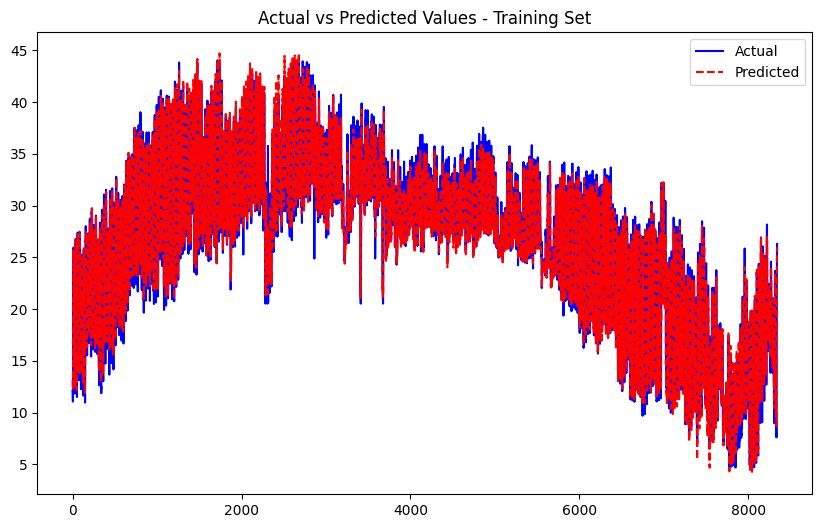

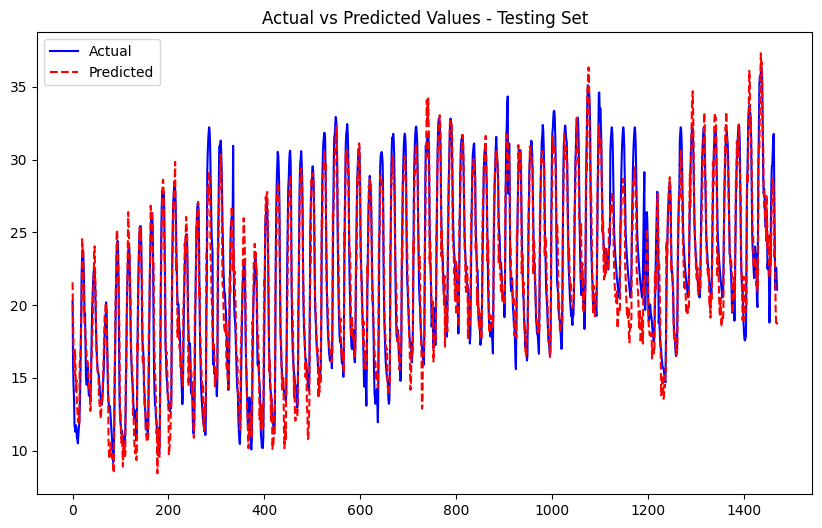

Processing node 27...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0519
Epoch [2/50], Train Loss: 0.0439
Epoch [3/50], Train Loss: 0.0394
Epoch [4/50], Train Loss: 0.0369
Epoch [5/50], Train Loss: 0.0347
Epoch [6/50], Train Loss: 0.0334
Epoch [7/50], Train Loss: 0.0321
Epoch [8/50], Train Loss: 0.0315
Epoch [9/50], Train Loss: 0.0308
Epoch [10/50], Train Loss: 0.0301
Epoch [11/50], Train Loss: 0.0298
Epoch [12/50], Train Loss: 0.0293
Epoch [13/50], Train Loss: 0.0293
Epoch [14/50], Train Loss: 0.0289
Epoch [15/50], Train Loss: 0.0289
Epoch [16/50], Train Loss: 0.0287
Epoch [17/50], Train Loss: 0.0284
Epoch [18/50], Train Loss: 0.0283
Epoch [19/50], Train Loss: 0.0281
Epoch [20/50], Train Loss: 0.0279
Epoch [21/50], Train Loss: 0.0277
Epoch [22/50], Train Loss: 0.0280
Epoch [23/50], Train Loss: 0.0277
Epoch [24/50], Train Loss: 0.0276
Epoch [25/50], Train Loss: 0.0274
Epoch [26/50], Train Loss: 0.0275
Epoch [27/50], Train Loss: 0.0275
Epoch [28/50], Train Loss: 0.0277
Epoch [29/50], Train Loss: 0.0275
Epoch [30/50], Train Lo

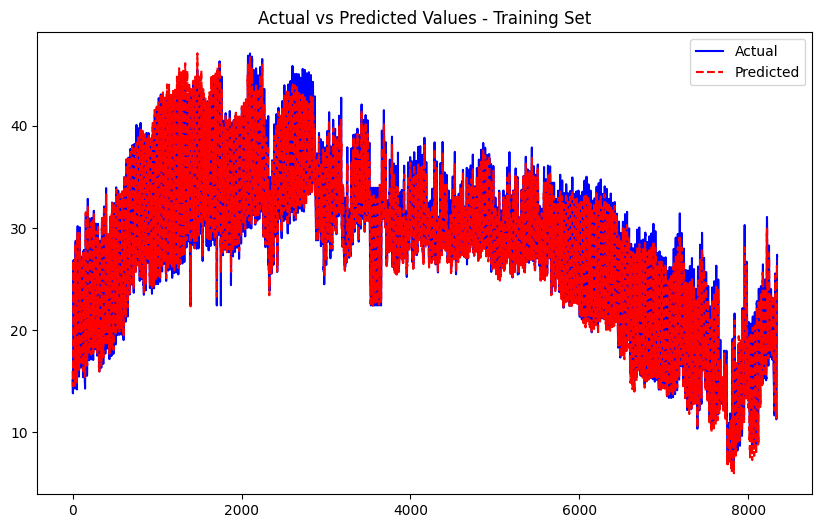

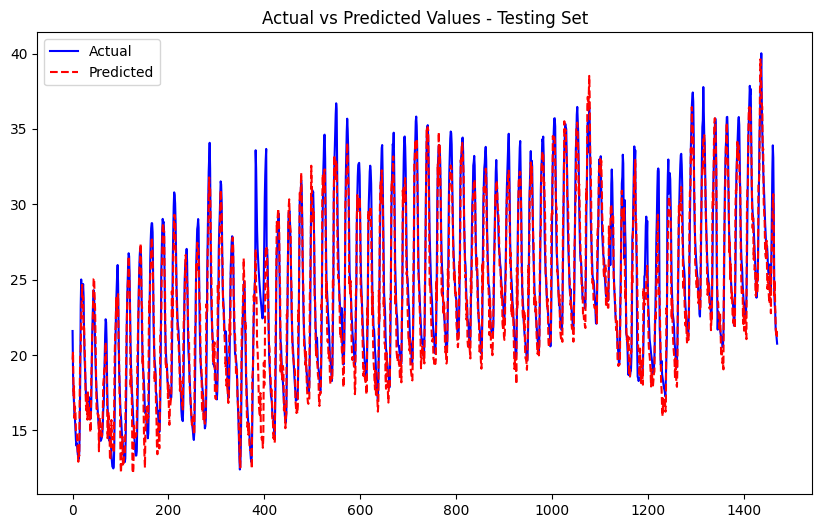

Processing node 28...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0610
Epoch [2/50], Train Loss: 0.0490
Epoch [3/50], Train Loss: 0.0443
Epoch [4/50], Train Loss: 0.0411
Epoch [5/50], Train Loss: 0.0384
Epoch [6/50], Train Loss: 0.0371
Epoch [7/50], Train Loss: 0.0358
Epoch [8/50], Train Loss: 0.0342
Epoch [9/50], Train Loss: 0.0338
Epoch [10/50], Train Loss: 0.0328
Epoch [11/50], Train Loss: 0.0322
Epoch [12/50], Train Loss: 0.0316
Epoch [13/50], Train Loss: 0.0313
Epoch [14/50], Train Loss: 0.0311
Epoch [15/50], Train Loss: 0.0312
Epoch [16/50], Train Loss: 0.0308
Epoch [17/50], Train Loss: 0.0302
Epoch [18/50], Train Loss: 0.0302
Epoch [19/50], Train Loss: 0.0299
Epoch [20/50], Train Loss: 0.0300
Epoch [21/50], Train Loss: 0.0301
Epoch [22/50], Train Loss: 0.0297
Epoch [23/50], Train Loss: 0.0294
Epoch [24/50], Train Loss: 0.0294
Epoch [25/50], Train Loss: 0.0294
Epoch [26/50], Train Loss: 0.0293
Epoch [27/50], Train Loss: 0.0293
Epoch [28/50], Train Loss: 0.0290
Epoch [29/50], Train Loss: 0.0291
Epoch [30/50], Train Lo

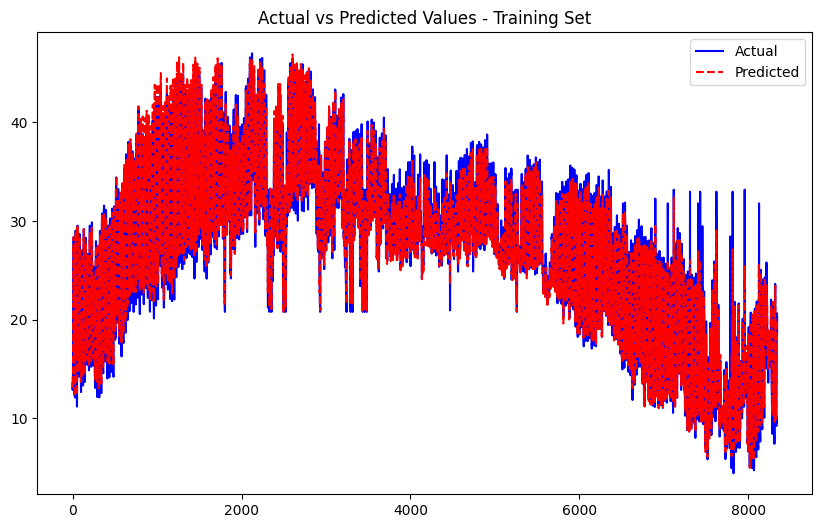

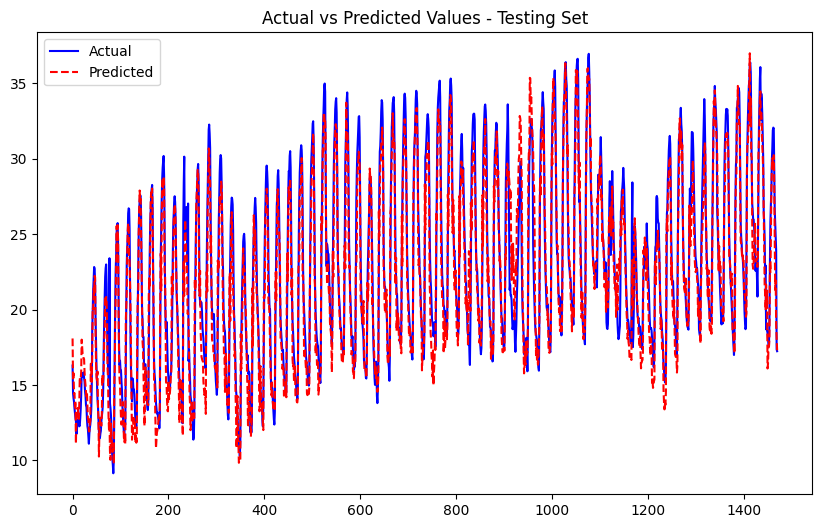

Processing node 29...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0561
Epoch [2/50], Train Loss: 0.0442
Epoch [3/50], Train Loss: 0.0397
Epoch [4/50], Train Loss: 0.0360
Epoch [5/50], Train Loss: 0.0338
Epoch [6/50], Train Loss: 0.0318
Epoch [7/50], Train Loss: 0.0307
Epoch [8/50], Train Loss: 0.0300
Epoch [9/50], Train Loss: 0.0285
Epoch [10/50], Train Loss: 0.0284
Epoch [11/50], Train Loss: 0.0276
Epoch [12/50], Train Loss: 0.0272
Epoch [13/50], Train Loss: 0.0270
Epoch [14/50], Train Loss: 0.0268
Epoch [15/50], Train Loss: 0.0262
Epoch [16/50], Train Loss: 0.0259
Epoch [17/50], Train Loss: 0.0258
Epoch [18/50], Train Loss: 0.0257
Epoch [19/50], Train Loss: 0.0256
Epoch [20/50], Train Loss: 0.0257
Epoch [21/50], Train Loss: 0.0255
Epoch [22/50], Train Loss: 0.0255
Epoch [23/50], Train Loss: 0.0254
Epoch [24/50], Train Loss: 0.0247
Epoch [25/50], Train Loss: 0.0250
Epoch [26/50], Train Loss: 0.0250
Epoch [27/50], Train Loss: 0.0247
Epoch [28/50], Train Loss: 0.0248
Epoch [29/50], Train Loss: 0.0247
Epoch [30/50], Train Lo

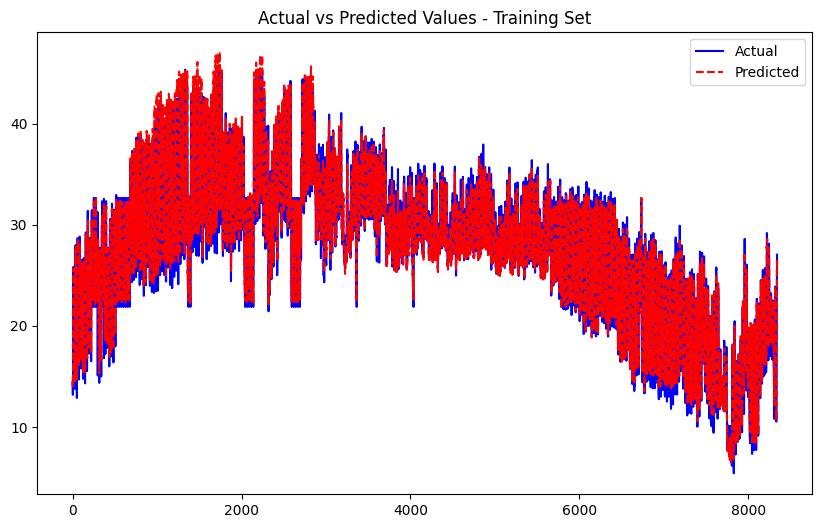

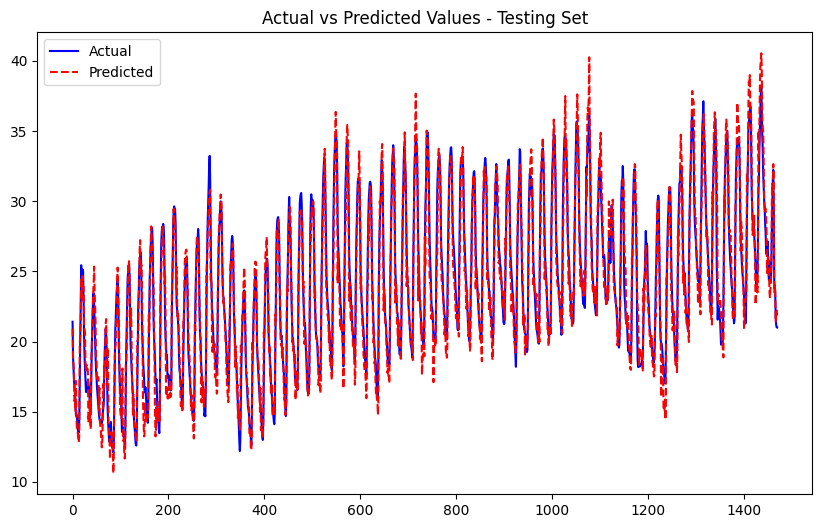

Processing node 30...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0717
Epoch [2/50], Train Loss: 0.0581
Epoch [3/50], Train Loss: 0.0529
Epoch [4/50], Train Loss: 0.0481
Epoch [5/50], Train Loss: 0.0452
Epoch [6/50], Train Loss: 0.0431
Epoch [7/50], Train Loss: 0.0416
Epoch [8/50], Train Loss: 0.0403
Epoch [9/50], Train Loss: 0.0389
Epoch [10/50], Train Loss: 0.0383
Epoch [11/50], Train Loss: 0.0376
Epoch [12/50], Train Loss: 0.0373
Epoch [13/50], Train Loss: 0.0367
Epoch [14/50], Train Loss: 0.0364
Epoch [15/50], Train Loss: 0.0363
Epoch [16/50], Train Loss: 0.0357
Epoch [17/50], Train Loss: 0.0353
Epoch [18/50], Train Loss: 0.0351
Epoch [19/50], Train Loss: 0.0352
Epoch [20/50], Train Loss: 0.0348
Epoch [21/50], Train Loss: 0.0346
Epoch [22/50], Train Loss: 0.0349
Epoch [23/50], Train Loss: 0.0341
Epoch [24/50], Train Loss: 0.0343
Epoch [25/50], Train Loss: 0.0343
Epoch [26/50], Train Loss: 0.0342
Epoch [27/50], Train Loss: 0.0337
Epoch [28/50], Train Loss: 0.0338
Epoch [29/50], Train Loss: 0.0337
Epoch [30/50], Train Lo

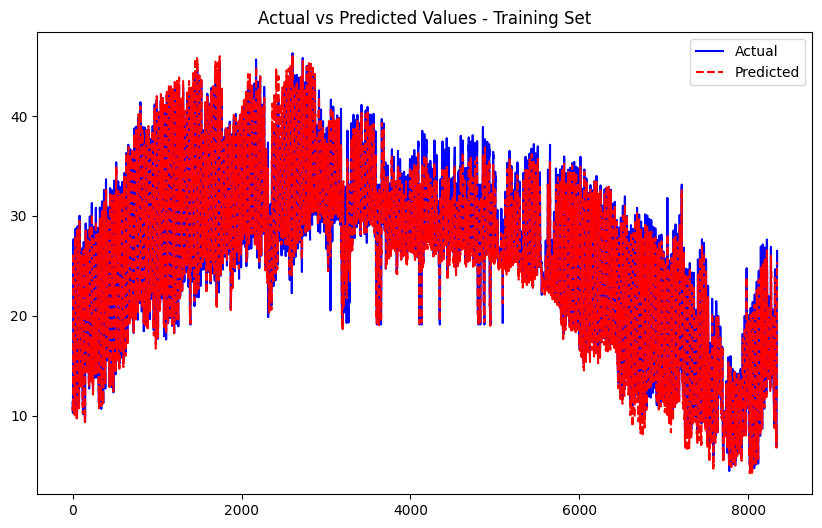

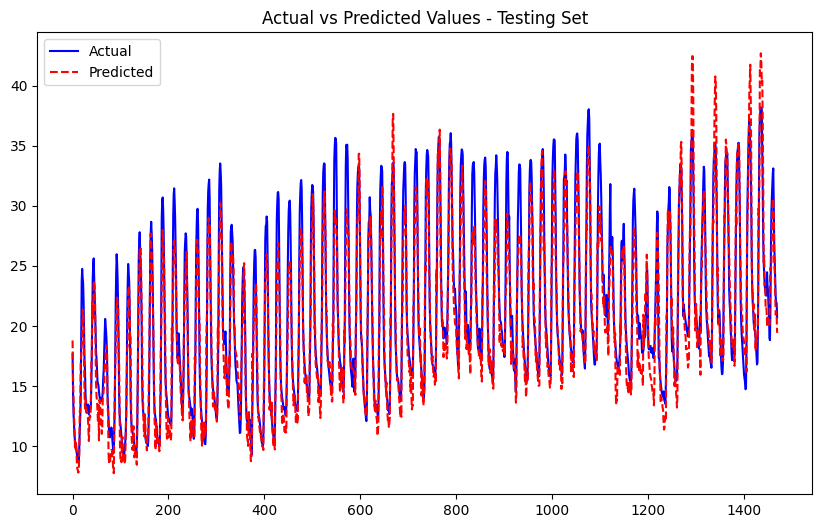

Processing node 31...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0532
Epoch [2/50], Train Loss: 0.0447
Epoch [3/50], Train Loss: 0.0415
Epoch [4/50], Train Loss: 0.0388
Epoch [5/50], Train Loss: 0.0371
Epoch [6/50], Train Loss: 0.0359
Epoch [7/50], Train Loss: 0.0349
Epoch [8/50], Train Loss: 0.0335
Epoch [9/50], Train Loss: 0.0334
Epoch [10/50], Train Loss: 0.0327
Epoch [11/50], Train Loss: 0.0323
Epoch [12/50], Train Loss: 0.0320
Epoch [13/50], Train Loss: 0.0318
Epoch [14/50], Train Loss: 0.0314
Epoch [15/50], Train Loss: 0.0313
Epoch [16/50], Train Loss: 0.0310
Epoch [17/50], Train Loss: 0.0310
Epoch [18/50], Train Loss: 0.0308
Epoch [19/50], Train Loss: 0.0305
Epoch [20/50], Train Loss: 0.0305
Epoch [21/50], Train Loss: 0.0303
Epoch [22/50], Train Loss: 0.0304
Epoch [23/50], Train Loss: 0.0301
Epoch [24/50], Train Loss: 0.0300
Epoch [25/50], Train Loss: 0.0297
Epoch [26/50], Train Loss: 0.0299
Epoch [27/50], Train Loss: 0.0294
Epoch [28/50], Train Loss: 0.0298
Epoch [29/50], Train Loss: 0.0297
Epoch [30/50], Train Lo

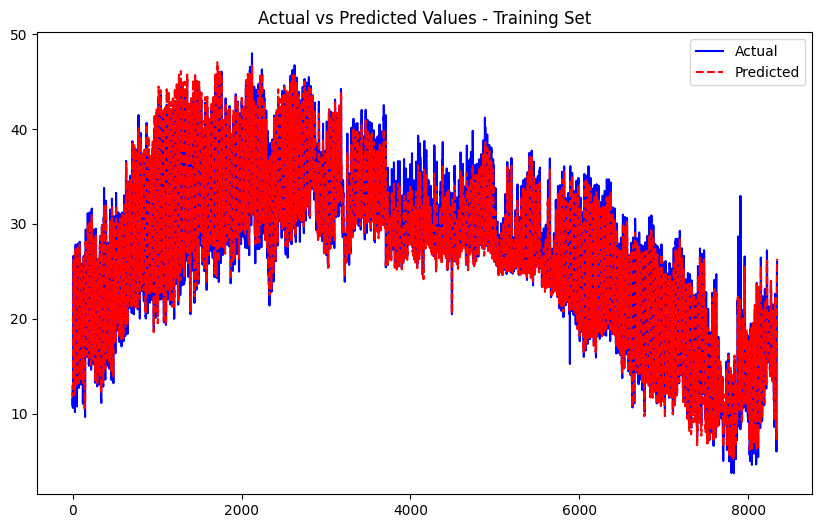

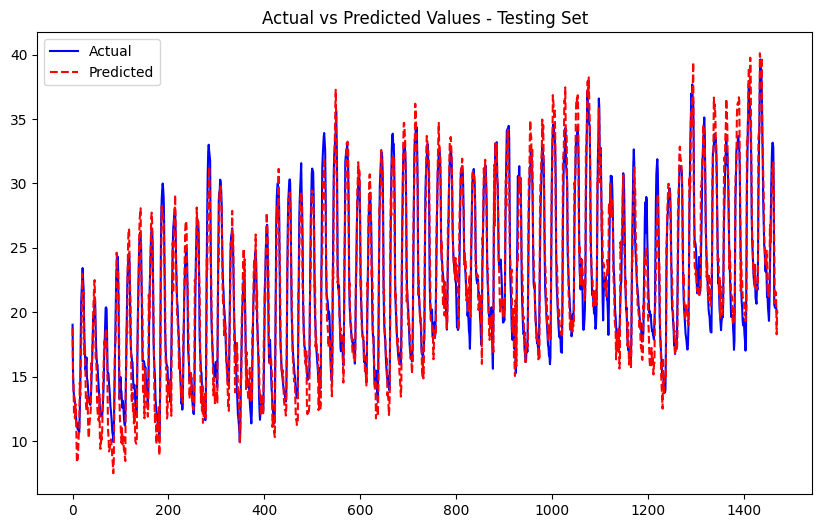

Processing node 32...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0593
Epoch [2/50], Train Loss: 0.0495
Epoch [3/50], Train Loss: 0.0454
Epoch [4/50], Train Loss: 0.0422
Epoch [5/50], Train Loss: 0.0401
Epoch [6/50], Train Loss: 0.0386
Epoch [7/50], Train Loss: 0.0368
Epoch [8/50], Train Loss: 0.0357
Epoch [9/50], Train Loss: 0.0347
Epoch [10/50], Train Loss: 0.0338
Epoch [11/50], Train Loss: 0.0333
Epoch [12/50], Train Loss: 0.0326
Epoch [13/50], Train Loss: 0.0322
Epoch [14/50], Train Loss: 0.0319
Epoch [15/50], Train Loss: 0.0318
Epoch [16/50], Train Loss: 0.0316
Epoch [17/50], Train Loss: 0.0317
Epoch [18/50], Train Loss: 0.0312
Epoch [19/50], Train Loss: 0.0308
Epoch [20/50], Train Loss: 0.0305
Epoch [21/50], Train Loss: 0.0304
Epoch [22/50], Train Loss: 0.0303
Epoch [23/50], Train Loss: 0.0304
Epoch [24/50], Train Loss: 0.0306
Epoch [25/50], Train Loss: 0.0301
Epoch [26/50], Train Loss: 0.0303
Epoch [27/50], Train Loss: 0.0301
Epoch [28/50], Train Loss: 0.0298
Epoch [29/50], Train Loss: 0.0299
Epoch [30/50], Train Lo

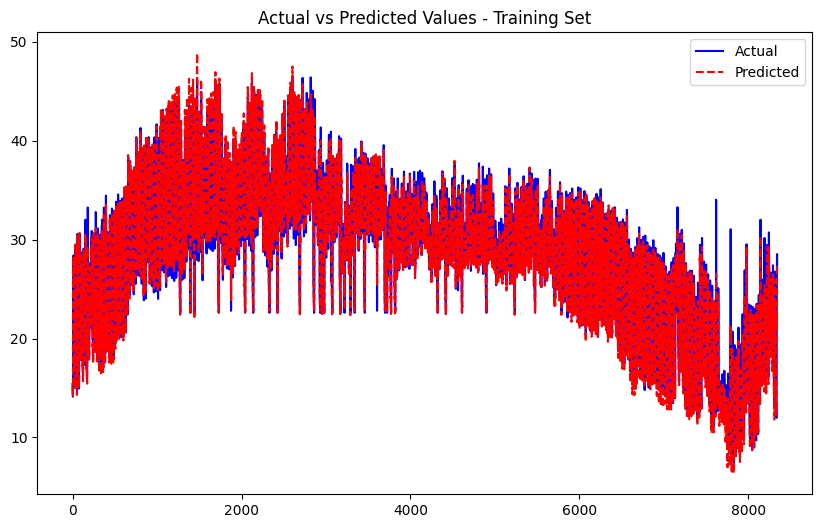

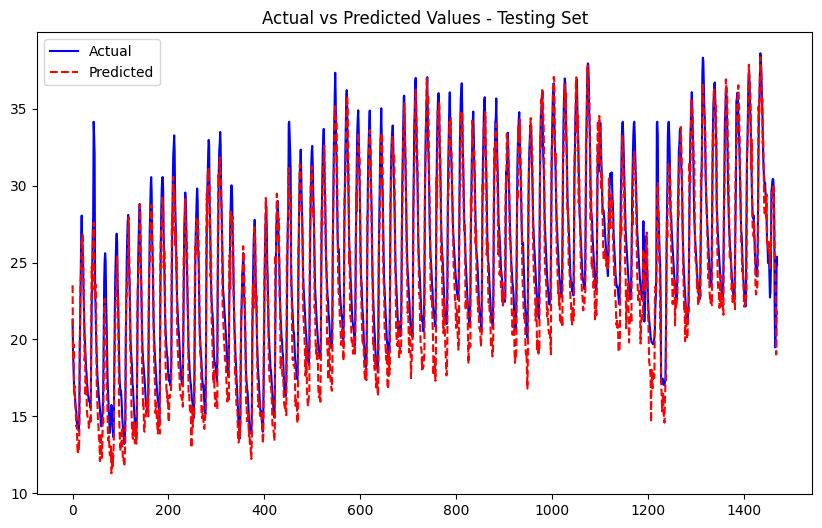

Processing node 33...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0918
Epoch [2/50], Train Loss: 0.0763
Epoch [3/50], Train Loss: 0.0651
Epoch [4/50], Train Loss: 0.0592
Epoch [5/50], Train Loss: 0.0546
Epoch [6/50], Train Loss: 0.0516
Epoch [7/50], Train Loss: 0.0497
Epoch [8/50], Train Loss: 0.0476
Epoch [9/50], Train Loss: 0.0462
Epoch [10/50], Train Loss: 0.0455
Epoch [11/50], Train Loss: 0.0444
Epoch [12/50], Train Loss: 0.0434
Epoch [13/50], Train Loss: 0.0431
Epoch [14/50], Train Loss: 0.0427
Epoch [15/50], Train Loss: 0.0422
Epoch [16/50], Train Loss: 0.0419
Epoch [17/50], Train Loss: 0.0413
Epoch [18/50], Train Loss: 0.0410
Epoch [19/50], Train Loss: 0.0405
Epoch [20/50], Train Loss: 0.0411
Epoch [21/50], Train Loss: 0.0406
Epoch [22/50], Train Loss: 0.0405
Epoch [23/50], Train Loss: 0.0401
Epoch [24/50], Train Loss: 0.0402
Epoch [25/50], Train Loss: 0.0398
Epoch [26/50], Train Loss: 0.0395
Epoch [27/50], Train Loss: 0.0392
Epoch [28/50], Train Loss: 0.0394
Epoch [29/50], Train Loss: 0.0391
Epoch [30/50], Train Lo

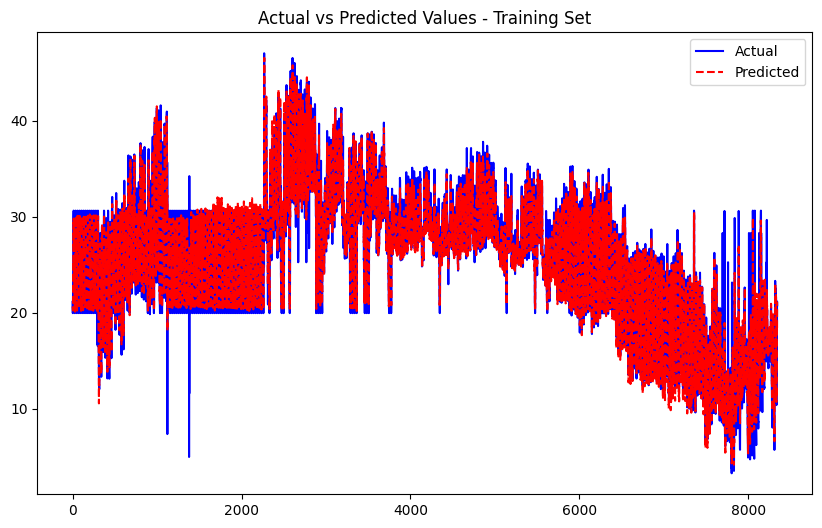

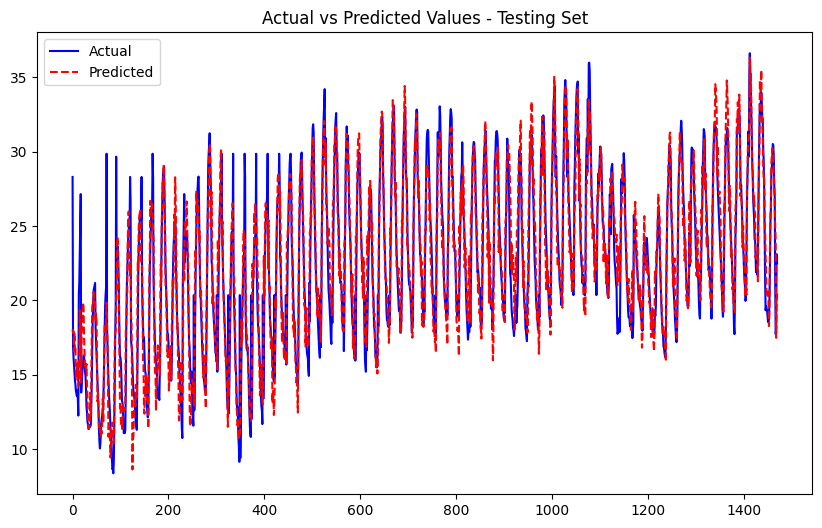

Processing node 34...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1006
Epoch [2/50], Train Loss: 0.0742
Epoch [3/50], Train Loss: 0.0579
Epoch [4/50], Train Loss: 0.0500
Epoch [5/50], Train Loss: 0.0444
Epoch [6/50], Train Loss: 0.0405
Epoch [7/50], Train Loss: 0.0384
Epoch [8/50], Train Loss: 0.0360
Epoch [9/50], Train Loss: 0.0348
Epoch [10/50], Train Loss: 0.0339
Epoch [11/50], Train Loss: 0.0330
Epoch [12/50], Train Loss: 0.0327
Epoch [13/50], Train Loss: 0.0317
Epoch [14/50], Train Loss: 0.0310
Epoch [15/50], Train Loss: 0.0309
Epoch [16/50], Train Loss: 0.0301
Epoch [17/50], Train Loss: 0.0300
Epoch [18/50], Train Loss: 0.0298
Epoch [19/50], Train Loss: 0.0295
Epoch [20/50], Train Loss: 0.0295
Epoch [21/50], Train Loss: 0.0292
Epoch [22/50], Train Loss: 0.0291
Epoch [23/50], Train Loss: 0.0288
Epoch [24/50], Train Loss: 0.0286
Epoch [25/50], Train Loss: 0.0291
Epoch [26/50], Train Loss: 0.0285
Epoch [27/50], Train Loss: 0.0282
Epoch [28/50], Train Loss: 0.0281
Epoch [29/50], Train Loss: 0.0283
Epoch [30/50], Train Lo

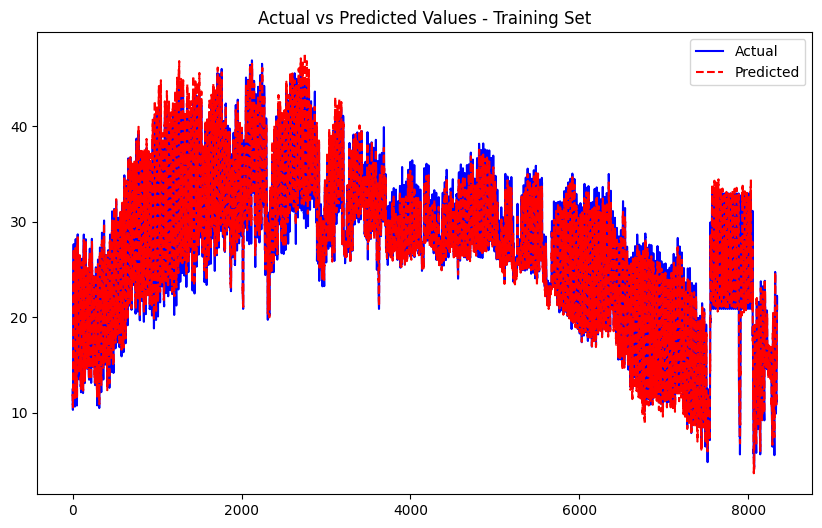

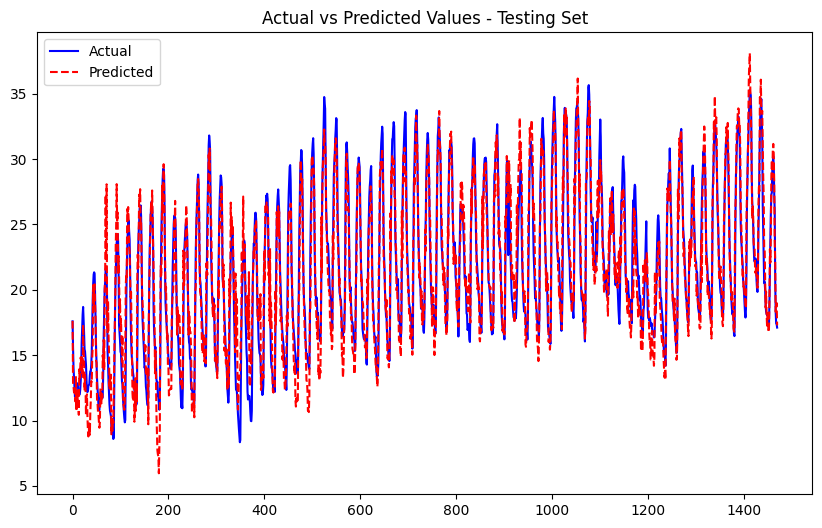

Processing node 35...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0530
Epoch [2/50], Train Loss: 0.0431
Epoch [3/50], Train Loss: 0.0391
Epoch [4/50], Train Loss: 0.0363
Epoch [5/50], Train Loss: 0.0344
Epoch [6/50], Train Loss: 0.0330
Epoch [7/50], Train Loss: 0.0318
Epoch [8/50], Train Loss: 0.0312
Epoch [9/50], Train Loss: 0.0306
Epoch [10/50], Train Loss: 0.0300
Epoch [11/50], Train Loss: 0.0299
Epoch [12/50], Train Loss: 0.0292
Epoch [13/50], Train Loss: 0.0292
Epoch [14/50], Train Loss: 0.0289
Epoch [15/50], Train Loss: 0.0288
Epoch [16/50], Train Loss: 0.0286
Epoch [17/50], Train Loss: 0.0283
Epoch [18/50], Train Loss: 0.0282
Epoch [19/50], Train Loss: 0.0282
Epoch [20/50], Train Loss: 0.0280
Epoch [21/50], Train Loss: 0.0278
Epoch [22/50], Train Loss: 0.0276
Epoch [23/50], Train Loss: 0.0277
Epoch [24/50], Train Loss: 0.0273
Epoch [25/50], Train Loss: 0.0276
Epoch [26/50], Train Loss: 0.0275
Epoch [27/50], Train Loss: 0.0276
Epoch [28/50], Train Loss: 0.0274
Epoch [29/50], Train Loss: 0.0276
Epoch [30/50], Train Lo

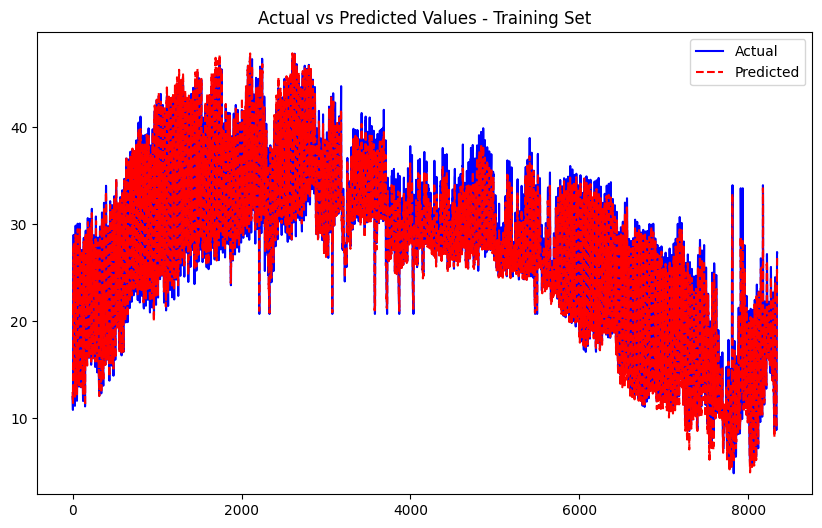

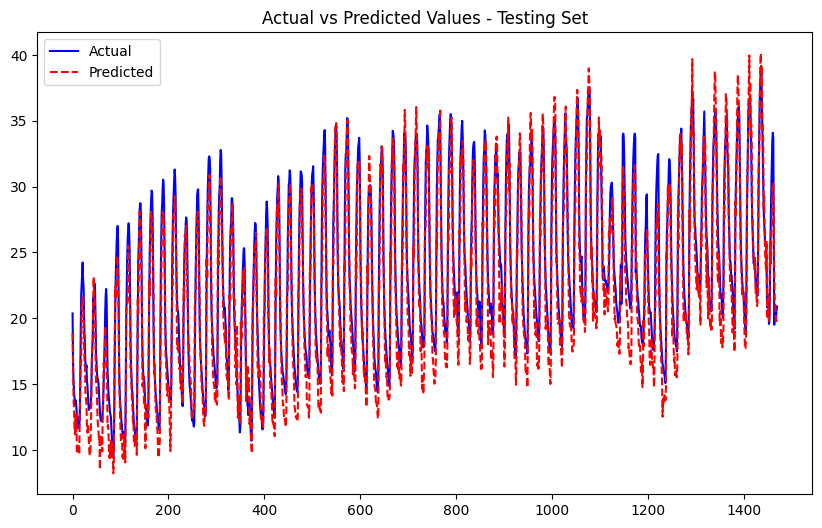

Processing node 36...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0586
Epoch [2/50], Train Loss: 0.0496
Epoch [3/50], Train Loss: 0.0443
Epoch [4/50], Train Loss: 0.0408
Epoch [5/50], Train Loss: 0.0388
Epoch [6/50], Train Loss: 0.0371
Epoch [7/50], Train Loss: 0.0358
Epoch [8/50], Train Loss: 0.0351
Epoch [9/50], Train Loss: 0.0339
Epoch [10/50], Train Loss: 0.0330
Epoch [11/50], Train Loss: 0.0324
Epoch [12/50], Train Loss: 0.0323
Epoch [13/50], Train Loss: 0.0317
Epoch [14/50], Train Loss: 0.0316
Epoch [15/50], Train Loss: 0.0311
Epoch [16/50], Train Loss: 0.0307
Epoch [17/50], Train Loss: 0.0309
Epoch [18/50], Train Loss: 0.0306
Epoch [19/50], Train Loss: 0.0307
Epoch [20/50], Train Loss: 0.0301
Epoch [21/50], Train Loss: 0.0302
Epoch [22/50], Train Loss: 0.0302
Epoch [23/50], Train Loss: 0.0302
Epoch [24/50], Train Loss: 0.0299
Epoch [25/50], Train Loss: 0.0298
Epoch [26/50], Train Loss: 0.0295
Epoch [27/50], Train Loss: 0.0296
Epoch [28/50], Train Loss: 0.0294
Epoch [29/50], Train Loss: 0.0294
Epoch [30/50], Train Lo

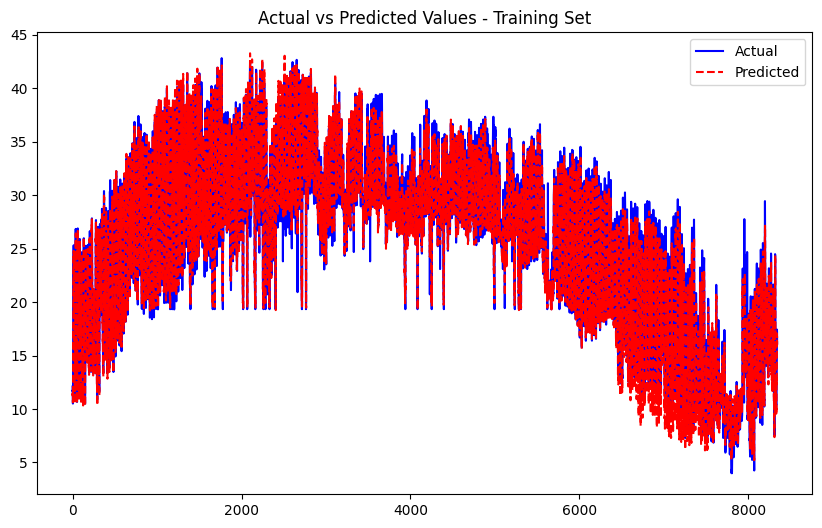

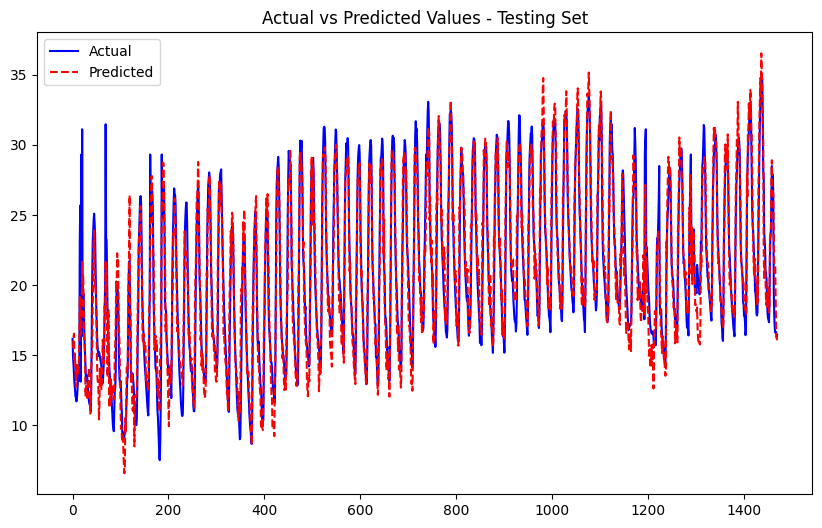

Processing node 37...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0620
Epoch [2/50], Train Loss: 0.0522
Epoch [3/50], Train Loss: 0.0476
Epoch [4/50], Train Loss: 0.0444
Epoch [5/50], Train Loss: 0.0422
Epoch [6/50], Train Loss: 0.0402
Epoch [7/50], Train Loss: 0.0389
Epoch [8/50], Train Loss: 0.0380
Epoch [9/50], Train Loss: 0.0372
Epoch [10/50], Train Loss: 0.0368
Epoch [11/50], Train Loss: 0.0362
Epoch [12/50], Train Loss: 0.0357
Epoch [13/50], Train Loss: 0.0355
Epoch [14/50], Train Loss: 0.0352
Epoch [15/50], Train Loss: 0.0347
Epoch [16/50], Train Loss: 0.0344
Epoch [17/50], Train Loss: 0.0346
Epoch [18/50], Train Loss: 0.0344
Epoch [19/50], Train Loss: 0.0341
Epoch [20/50], Train Loss: 0.0340
Epoch [21/50], Train Loss: 0.0338
Epoch [22/50], Train Loss: 0.0335
Epoch [23/50], Train Loss: 0.0337
Epoch [24/50], Train Loss: 0.0335
Epoch [25/50], Train Loss: 0.0332
Epoch [26/50], Train Loss: 0.0333
Epoch [27/50], Train Loss: 0.0333
Epoch [28/50], Train Loss: 0.0332
Epoch [29/50], Train Loss: 0.0331
Epoch [30/50], Train Lo

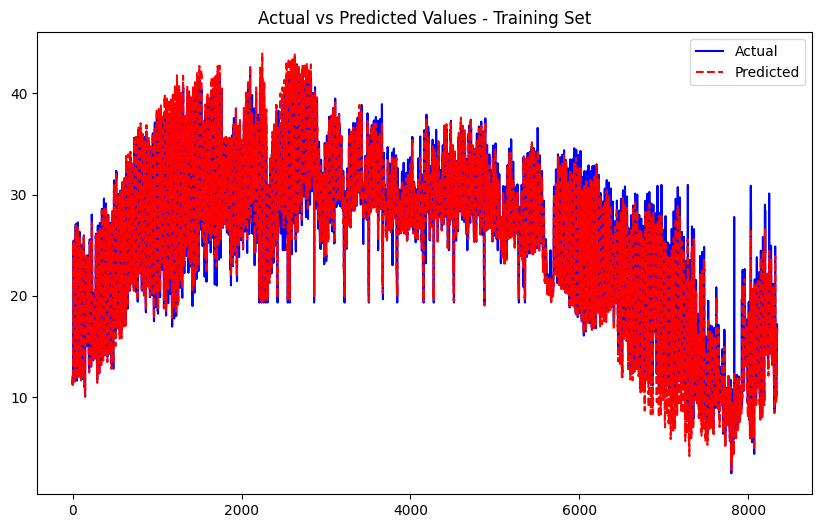

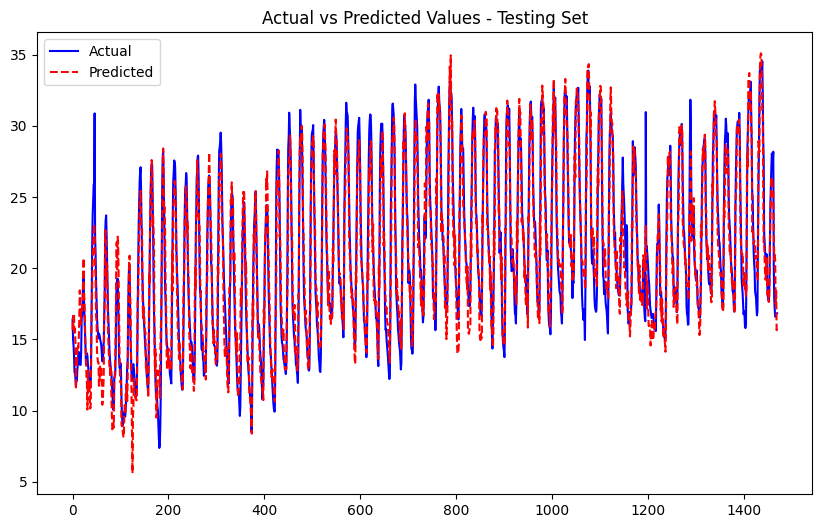

Processing node 38...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0537
Epoch [2/50], Train Loss: 0.0442
Epoch [3/50], Train Loss: 0.0398
Epoch [4/50], Train Loss: 0.0369
Epoch [5/50], Train Loss: 0.0348
Epoch [6/50], Train Loss: 0.0329
Epoch [7/50], Train Loss: 0.0317
Epoch [8/50], Train Loss: 0.0307
Epoch [9/50], Train Loss: 0.0299
Epoch [10/50], Train Loss: 0.0296
Epoch [11/50], Train Loss: 0.0286
Epoch [12/50], Train Loss: 0.0284
Epoch [13/50], Train Loss: 0.0281
Epoch [14/50], Train Loss: 0.0277
Epoch [15/50], Train Loss: 0.0272
Epoch [16/50], Train Loss: 0.0273
Epoch [17/50], Train Loss: 0.0269
Epoch [18/50], Train Loss: 0.0269
Epoch [19/50], Train Loss: 0.0267
Epoch [20/50], Train Loss: 0.0265
Epoch [21/50], Train Loss: 0.0264
Epoch [22/50], Train Loss: 0.0263
Epoch [23/50], Train Loss: 0.0264
Epoch [24/50], Train Loss: 0.0261
Epoch [25/50], Train Loss: 0.0258
Epoch [26/50], Train Loss: 0.0258
Epoch [27/50], Train Loss: 0.0259
Epoch [28/50], Train Loss: 0.0255
Epoch [29/50], Train Loss: 0.0256
Epoch [30/50], Train Lo

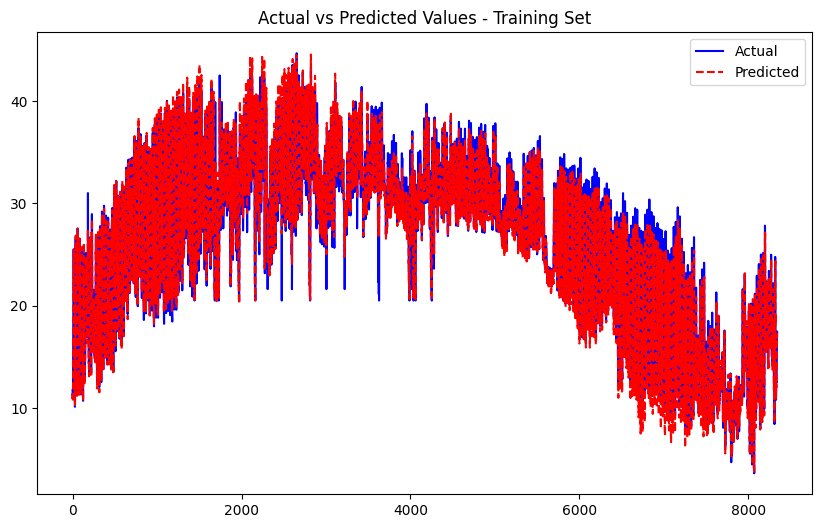

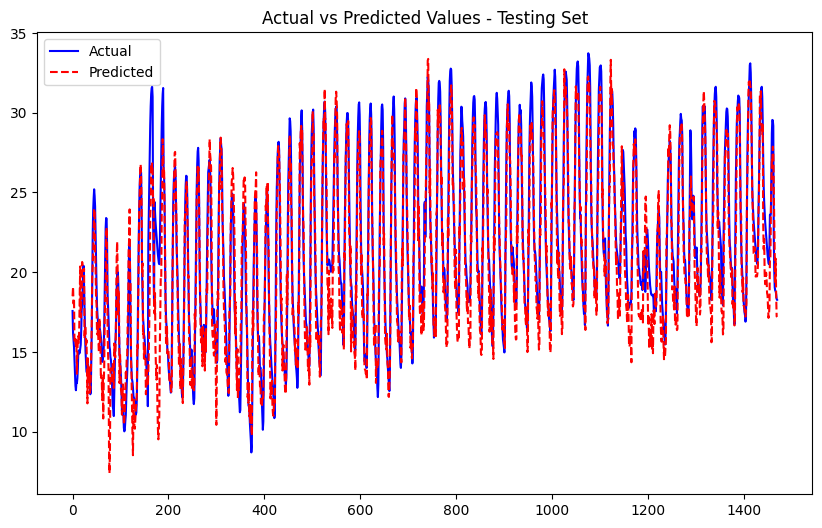

Processing node 39...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1626
Epoch [2/50], Train Loss: 0.1444
Epoch [3/50], Train Loss: 0.1279
Epoch [4/50], Train Loss: 0.1174
Epoch [5/50], Train Loss: 0.1106
Epoch [6/50], Train Loss: 0.1059
Epoch [7/50], Train Loss: 0.1020
Epoch [8/50], Train Loss: 0.0997
Epoch [9/50], Train Loss: 0.0974
Epoch [10/50], Train Loss: 0.0956
Epoch [11/50], Train Loss: 0.0943
Epoch [12/50], Train Loss: 0.0931
Epoch [13/50], Train Loss: 0.0926
Epoch [14/50], Train Loss: 0.0922
Epoch [15/50], Train Loss: 0.0911
Epoch [16/50], Train Loss: 0.0905
Epoch [17/50], Train Loss: 0.0900
Epoch [18/50], Train Loss: 0.0898
Epoch [19/50], Train Loss: 0.0892
Epoch [20/50], Train Loss: 0.0893
Epoch [21/50], Train Loss: 0.0887
Epoch [22/50], Train Loss: 0.0881
Epoch [23/50], Train Loss: 0.0878
Epoch [24/50], Train Loss: 0.0877
Epoch [25/50], Train Loss: 0.0877
Epoch [26/50], Train Loss: 0.0878
Epoch [27/50], Train Loss: 0.0874
Epoch [28/50], Train Loss: 0.0872
Epoch [29/50], Train Loss: 0.0873
Epoch [30/50], Train Lo

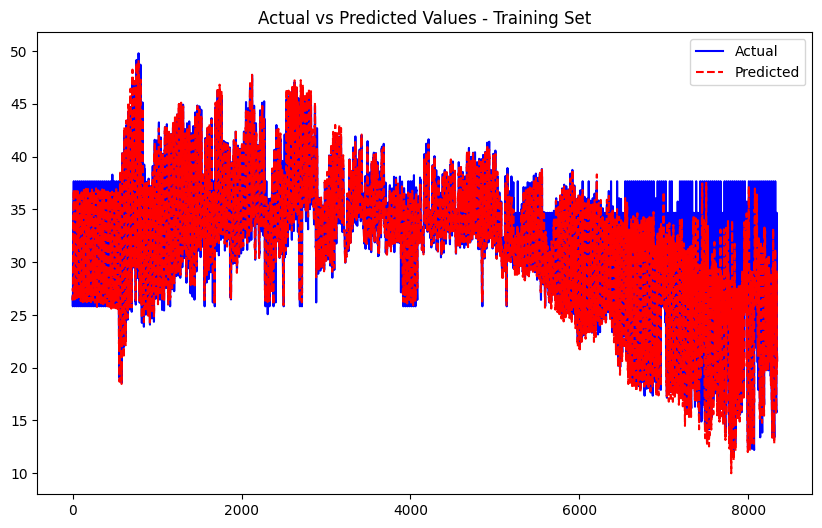

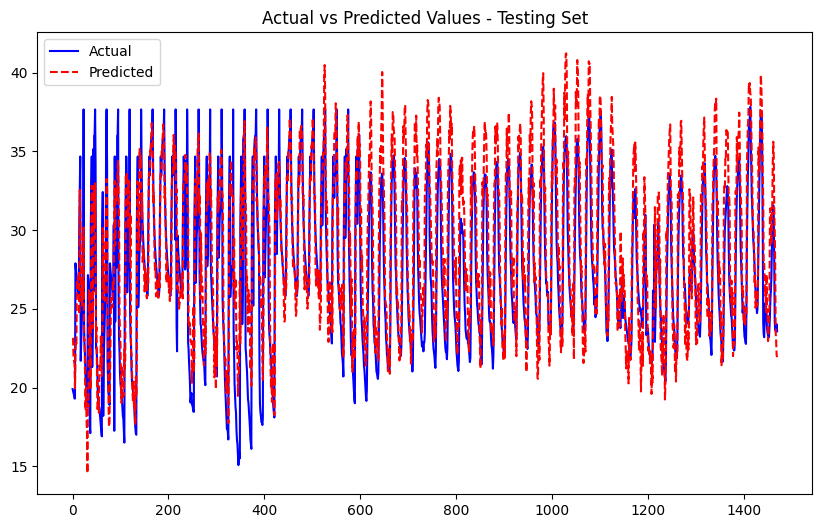

Processing node 40...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2788
Epoch [2/50], Train Loss: 0.1937
Epoch [3/50], Train Loss: 0.1307
Epoch [4/50], Train Loss: 0.0961
Epoch [5/50], Train Loss: 0.0812
Epoch [6/50], Train Loss: 0.0682
Epoch [7/50], Train Loss: 0.0626
Epoch [8/50], Train Loss: 0.0578
Epoch [9/50], Train Loss: 0.0555
Epoch [10/50], Train Loss: 0.0501
Epoch [11/50], Train Loss: 0.0472
Epoch [12/50], Train Loss: 0.0451
Epoch [13/50], Train Loss: 0.0451
Epoch [14/50], Train Loss: 0.0444
Epoch [15/50], Train Loss: 0.0413
Epoch [16/50], Train Loss: 0.0417
Epoch [17/50], Train Loss: 0.0391
Epoch [18/50], Train Loss: 0.0397
Epoch [19/50], Train Loss: 0.0385
Epoch [20/50], Train Loss: 0.0388
Epoch [21/50], Train Loss: 0.0403
Epoch [22/50], Train Loss: 0.0376
Epoch [23/50], Train Loss: 0.0363
Epoch [24/50], Train Loss: 0.0355
Epoch [25/50], Train Loss: 0.0380
Epoch [26/50], Train Loss: 0.0365
Epoch [27/50], Train Loss: 0.0356
Epoch [28/50], Train Loss: 0.0357
Epoch [29/50], Train Loss: 0.0354
Epoch [30/50], Train Lo

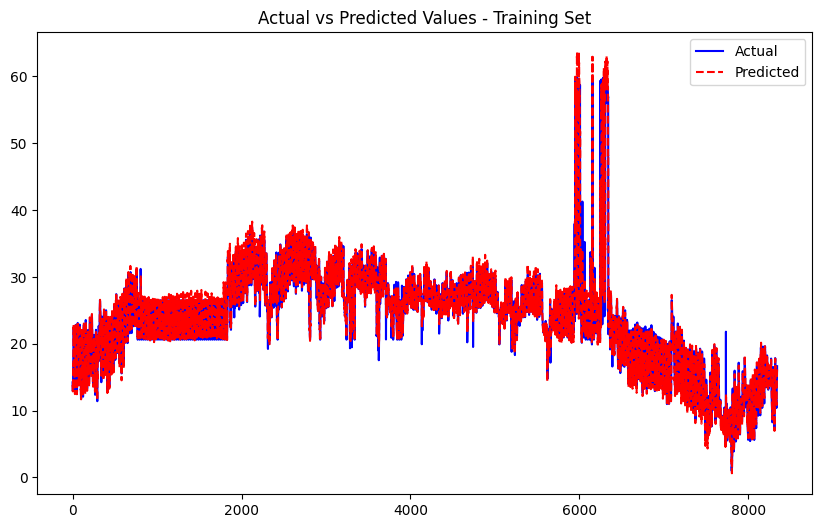

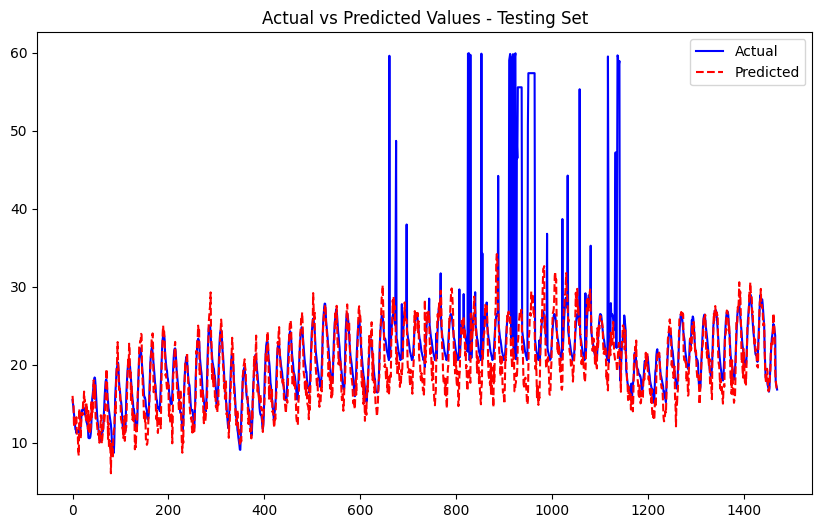

Processing node 41...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0869
Epoch [2/50], Train Loss: 0.0653
Epoch [3/50], Train Loss: 0.0578
Epoch [4/50], Train Loss: 0.0516
Epoch [5/50], Train Loss: 0.0477
Epoch [6/50], Train Loss: 0.0444
Epoch [7/50], Train Loss: 0.0425
Epoch [8/50], Train Loss: 0.0405
Epoch [9/50], Train Loss: 0.0395
Epoch [10/50], Train Loss: 0.0385
Epoch [11/50], Train Loss: 0.0379
Epoch [12/50], Train Loss: 0.0373
Epoch [13/50], Train Loss: 0.0367
Epoch [14/50], Train Loss: 0.0359
Epoch [15/50], Train Loss: 0.0356
Epoch [16/50], Train Loss: 0.0355
Epoch [17/50], Train Loss: 0.0354
Epoch [18/50], Train Loss: 0.0347
Epoch [19/50], Train Loss: 0.0344
Epoch [20/50], Train Loss: 0.0343
Epoch [21/50], Train Loss: 0.0344
Epoch [22/50], Train Loss: 0.0342
Epoch [23/50], Train Loss: 0.0344
Epoch [24/50], Train Loss: 0.0338
Epoch [25/50], Train Loss: 0.0334
Epoch [26/50], Train Loss: 0.0333
Epoch [27/50], Train Loss: 0.0332
Epoch [28/50], Train Loss: 0.0333
Epoch [29/50], Train Loss: 0.0332
Epoch [30/50], Train Lo

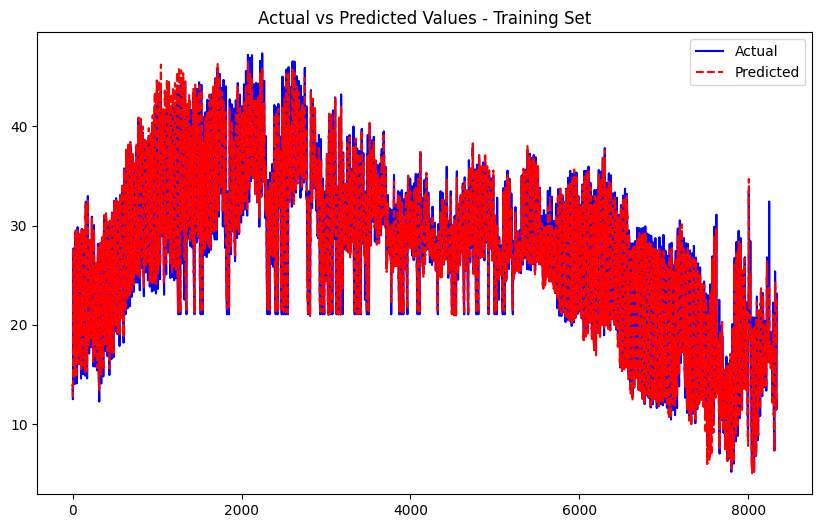

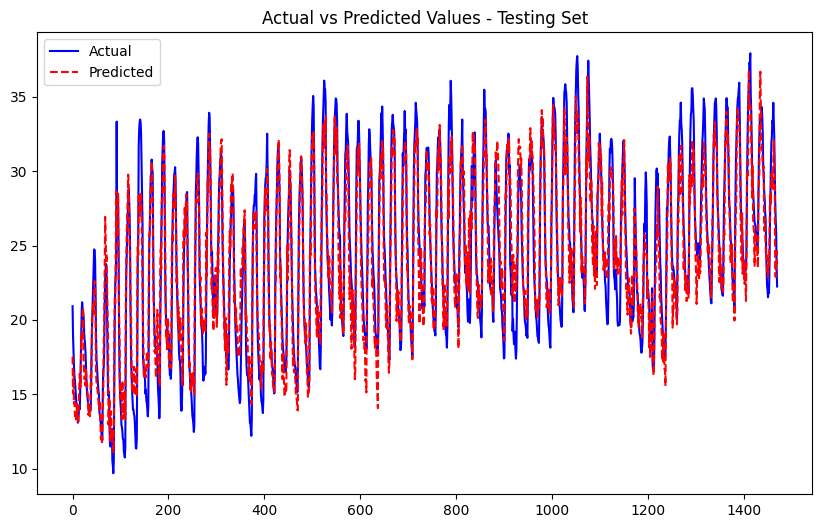

Train GNN and LSTM Imputed HourMean bs 3 sl 3.csv
CSV file 'Train GNN and LSTM Imputed HourMean bs 3 sl 3.csv' created successfully.
Test GNN and LSTM Imputed HourMean bs 3 sl 3.csv
CSV file 'Test GNN and LSTM Imputed HourMean bs 3 sl 3.csv' created successfully.


In [21]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import numpy as np
import torch.optim.lr_scheduler as lr_scheduler

# Define the LSTM Model
class LSTMModel(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, dropout_prob=0.2):
        super(LSTMModel, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        
        # Define the LSTM layer
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)  # One hidden layer
        
        # Dropout layer
        self.dropout = nn.Dropout(dropout_prob)
        
        # Fully connected layer (output layer)
        self.fc = nn.Linear(hidden_size, output_size)
        
        # Activation function
        self.elu = nn.ELU()

    def forward(self, x):
        # Initialize hidden state and cell state with zeros
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)  # 1 layer, batch_size, hidden_size
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)  # 1 layer, batch_size, hidden_size

        # Forward pass through LSTM
        out, _ = self.lstm(x, (h0, c0))  # LSTM returns all outputs (hidden states) and the final states
        
        # Apply ReLU activation function to the last time step output
        out = self.elu(out[:, -1, :])  # out[:, -1, :] -> output from the last time step
        
        # Apply dropout to the hidden layer's output
        out = self.dropout(out)
        
        # Pass the output through the fully connected layer
        out = self.fc(out)
        
        return out


def train_model(model, train_loader, criterion, optimizer, num_epochs):
    model.train()  # Set the model to training mode
    for epoch in range(num_epochs):
        running_loss = 0.0
        
        # Training phase
        for features, targets in train_loader:
            features, targets = features.to(device), targets.to(device)

            # Reshape input for LSTM (batch_size, sequence_length, num_features)
            # features should already be of shape (batch_size, sequence_length, num_features)
            
            # Forward pass
            outputs = model(features)  # LSTM will process the sequence data correctly
            loss = criterion(outputs, targets)  # Compute the loss

            # Backward and optimize
            optimizer.zero_grad()  # Clear previous gradients
            loss.backward()  # Backpropagate the loss
            optimizer.step()  # Update weights

            running_loss += loss.item()   

        # Print training loss after each epoch
        print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {running_loss/len(train_loader):.4f}')
    
    # Switch back to evaluation mode
    model.eval()



def test_model(model, train_loader, test_loader, node_idx):
    model.eval()
    all_actuals = []
    all_predictions = []
    
    # For tracking actuals and predictions for train and test sets separately
    train_actuals = []
    train_predictions = []
    
    test_actuals = []
    test_predictions = []

    
    with torch.no_grad():
        # Predict on training data
        for features, targets in train_loader:
            features, targets = features.to(device), targets.to(device)
            outputs = model(features)

            train_actuals.append(targets.cpu().numpy())
            train_predictions.append(outputs.cpu().numpy())

        # Predict on testing data
        for features, targets in test_loader:
            features, targets = features.to(device), targets.to(device)
            outputs = model(features)

            test_actuals.append(targets.cpu().numpy())
            test_predictions.append(outputs.cpu().numpy())
    
    # Concatenate all sets
    train_actuals = np.concatenate(train_actuals, axis=0)
    test_actuals = np.concatenate(test_actuals, axis=0)
    
    train_predictions = np.concatenate(train_predictions, axis=0)
    test_predictions = np.concatenate(test_predictions, axis=0)

    # Check shapes before proceeding
    print(f"Training actuals shape: {train_actuals.shape}, Predictions shape: {train_predictions.shape}")
    print(f"Testing actuals shape: {test_actuals.shape}, Predictions shape: {test_predictions.shape}")
    
    # Combine them for inverse scaling
    all_actuals = np.concatenate([train_actuals, test_actuals])
    all_predictions = np.concatenate([train_predictions, test_predictions])
    
    # Inverse scaling
    file_name = input_files[node_idx]
    
    if file_name in scalers:
        all_actuals = all_actuals.reshape(-1, 1)
        all_predictions = all_predictions.reshape(-1, 1)
        
        # Apply inverse scaling
        all_actuals_inverse = scalers[file_name].inverse_transform(all_actuals).flatten()
        all_predictions_inverse = scalers[file_name].inverse_transform(all_predictions).flatten()
    else:
        print(f"Scaler not found for {file_name}")
        return
    
    # Split them back into training and test sets
    train_size = len(train_actuals)
    test_size = len(test_actuals)
    
    train_actuals_inverse = all_actuals_inverse[:train_size]
    test_actuals_inverse = all_actuals_inverse[train_size:]
    
    train_predictions_inverse = all_predictions_inverse[:train_size]
    test_predictions_inverse = all_predictions_inverse[train_size:]

    # Verify split sizes
    print(f"Split Training actuals shape: {train_actuals_inverse.shape}, Predictions shape: {train_predictions_inverse.shape}")
    print(f"Split Testing actuals shape: {test_actuals_inverse.shape}, Predictions shape: {test_predictions_inverse.shape}")
    
    # Function to calculate and print metrics
    def calculate_metrics(actuals, predictions, set_name):
        mae = mean_absolute_error(actuals, predictions)
        mse = mean_squared_error(actuals, predictions)
        rmse = np.sqrt(mse)
        r2 = r2_score(actuals, predictions)
        corr_coeff = np.corrcoef(actuals.flatten(), predictions.flatten())[0, 1]
        
        # Print the metrics
        print(f"{set_name} Set Metrics:")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
        print(f"Pearson Correlation Coefficient: {corr_coeff:.4f}")
        print(f"R-squared (R²): {r2:.4f}")
        print("\n" + "-"*40 + "\n")

        if set_name == 'Training':
            train_mae_list.append(mae)
            train_mse_list.append(mse)
            train_rmse_list.append(rmse)
            train_r2_list.append(r2)
            train_corr_list.append(corr_coeff)

        elif set_name == 'Testing':
            test_mae_list.append(mae)
            test_mse_list.append(mse)
            test_rmse_list.append(rmse)
            test_r2_list.append(r2)
            test_corr_list.append(corr_coeff)        
    
    # Calculate and print metrics for each set
    print(f"\nCalculating metrics for Node {node_idx+1} - {file_name}")
    calculate_metrics(train_actuals_inverse, train_predictions_inverse, 'Training')
    calculate_metrics(test_actuals_inverse, test_predictions_inverse, 'Testing')

    print(f"\n\nCalculating Average Metrics for Training:")
    print(f"Mean MAE: {np.mean(train_mae_list):.4f}")
    print(f"Mean MSE: {np.mean(train_mse_list):.4f}")
    print(f"Mean RMSE: {np.mean(train_rmse_list):.4f}")
    print(f"Mean R²: {np.mean(train_r2_list):.4f}")
    print(f"Mean CorrCoeff: {np.mean(train_corr_list):.4f}")

    print(f"\n\nCalculating Average Metrics for Testing:")
    print(f"Mean MAE: {np.mean(test_mae_list):.4f}")
    print(f"Mean MSE: {np.mean(test_mse_list):.4f}")
    print(f"Mean RMSE: {np.mean(test_rmse_list):.4f}")
    print(f"Mean R²: {np.mean(test_r2_list):.4f}")
    print(f"Mean CorrCoeff: {np.mean(test_corr_list):.4f}")    
    
    # Function to plot actual vs predicted values
    def plot_results(actuals, predictions, set_name):
        plt.figure(figsize=(10, 6))
        plt.plot(actuals, label="Actual", color='blue')
        plt.plot(predictions, label="Predicted", color='red', linestyle='dashed')
        plt.title(f'Actual vs Predicted Values - {set_name} Set')
        plt.legend()
        plt.show()
    
    # Plot results for each set
    plot_results(train_actuals_inverse, train_predictions_inverse, 'Training')
    plot_results(test_actuals_inverse, test_predictions_inverse, 'Testing')


def create_dataloaders(features, targets, batch_size, sequence_length):
    # Convert DataFrame to NumPy arrays
    features_np = features.to_numpy()
    targets_np = targets.to_numpy()

    # Prepare sequences of data
    feature_sequences = []
    target_sequences = []

    # Create rolling windows of `sequence_length`
    for i in range(len(features_np) - sequence_length + 1):
        # Get sequence of features and corresponding target
        feature_sequences.append(features_np[i:i+sequence_length])
        target_sequences.append(targets_np[i+sequence_length-1])  # target is the last value of the sequence

    # Convert to NumPy arrays
    feature_sequences = np.array(feature_sequences)
    target_sequences = np.array(target_sequences)

    # Convert to PyTorch tensors
    features_tensor = torch.tensor(feature_sequences, dtype=torch.float32)
    targets_tensor = torch.tensor(target_sequences, dtype=torch.float32)

    # Create a dataset and dataloader
    dataset = torch.utils.data.TensorDataset(features_tensor, targets_tensor)
    return torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=False)

# Initialize the PyTorch model, criterion, and optimizer
input_size = train_features_list[0].shape[1]
hidden_size = 128
num_layers = 2
output_size = 1
num_epochs = 50
learning_rate = 0.0005
batch_size = 3
sequence_length = 3

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = LSTMModel(input_size, hidden_size, num_layers, output_size).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

print(f"For Batch Size= {batch_size} and Sequence Length = {sequence_length}")
train_mae_list = []
train_mse_list = []
train_rmse_list = []
train_r2_list = []
train_corr_list = []

test_mae_list = []
test_mse_list = []
test_rmse_list = []
test_r2_list = []
test_corr_list = []

# Process for each node
for node_idx, (train_features, train_targets, test_features, test_targets) in enumerate(zip(train_features_list, train_target_list, test_features_list, test_target_list)):
    print(f"Processing node {node_idx+1}...")

    # Create dataloaders
    train_loader = create_dataloaders(train_features, train_targets, batch_size, sequence_length)
    test_loader = create_dataloaders(test_features, test_targets, batch_size, sequence_length)

    # Train the model
    train_model(model, train_loader, criterion, optimizer, num_epochs)

    # Test the model and output metrics/plot
    test_model(model, train_loader, test_loader, node_idx)

    # Define function to create DataFrame and save to CSV
def create_metrics_csv(file_name, input_files, mae_list, mse_list, rmse_list, r2_list, corr_list):
    metrics_df = pd.DataFrame({
        "File Name": input_files,
        "MAE": mae_list,
        "MSE": mse_list,
        "RMSE": rmse_list,
        "R2": r2_list,
        "CorrCoeff": corr_list
    })
    metrics_df.to_csv(file_name, index=False)
    print(f"CSV file '{file_name}' created successfully.")

# Create CSV for training set
file_name = "Train GNN and LSTM Imputed HourMean bs 3 sl 3.csv"
print(file_name)
create_metrics_csv(file_name, input_files, train_mae_list, train_mse_list, train_rmse_list, train_r2_list, train_corr_list)

# Create CSV for test set
file_name = "Test GNN and LSTM Imputed HourMean bs 3 sl 3.csv"
print(file_name)
create_metrics_csv(file_name, input_files, test_mae_list, test_mse_list, test_rmse_list, test_r2_list, test_corr_list)    
